In [1]:
import torch
import math
from SC_IPFP.torch.utils import NN, log_kde_pdf_per_point, silvermans_rule
from SC_IPFP.torch.sde_solvers_time import solve_sde_RK


from tqdm.notebook import tqdm

from torch import nn

import itertools
from functools import partial
# np = jax.numpy
import matplotlib.pyplot as plt

In [2]:
def knn_log_prob(xTest, xTrain, k=36, w=0):
    """
    Can use this as an alternative to  log_kde_pdf_per_point, very noisy
    
    Approximate density p(x) ~ 1/kNN(x, {y_i})^d 
    the ln p(x) ~ - d * log kNN(x, {y_i})
    
    where kNN(x, {y_i}) is the distance of the kth nearest neighbour
    
    source: http://faculty.washington.edu/yenchic/18W_425/Lec7_knn_basis.pdf
    
    loss is very noisy, and goes down very slowly and un-monotnically
    
    Theres a lot of studies about these estimates for KL and entropy by Barnabas Poczos
    they might have refinements on the kNNN part. 
    
    w is a windowing parameter to take the mean of the kNN distance going backwards
    to the k-w nearest neighbours, to make things less noisy.    
    """
    k = int(k)
    w = int(min(w, k ))
    
    n, d = xTrain.shape
    
    sq_distances = -2 * torch.mm(xTrain, xTest.T) + torch.sum(xTest**2,axis=1) + torch.sum(xTrain**2,axis=1)[:, None]
    sq_distances = torch.clamp(sq_distances, 0, None)
    sq_distances, _ =  torch.sort(sq_distances,0) #distances sorted in axis 0
    sq_distance = torch.mean(sq_distances[ k,:])
#     print(sq_distance)
    return -(d * 0.5 * torch.log(sq_distance))

In [3]:
from torch import nn
class NN(nn.Module):

    def __init__(self, input_dim=1,  weight_dim_list=[20,20,20]):
        super(NN, self).__init__()

        self.weight_dim_list = [input_dim] + weight_dim_list
        self.layers = [None for i in weight_dim_list]

        for i in range(len(weight_dim_list)):
            setattr(
                self,
                "f" + str(i),
                nn.Linear(
                    self.weight_dim_list[i], self.weight_dim_list[i + 1],
                    bias=True
                )
            )
            self.layers[i]  = getattr(self, "f" + str(i))

            torch.nn.init.xavier_uniform(self.layers[i].weight)
    
    def get_var(self , other=None):
        return torch.tensor([[0]]).double()

    def forward(self, x, var=None):
        functerino = torch.relu
        x_ = x.clone()
        for i_, layer in enumerate(self.layers[:-1]):
            try:
                x = functerino(layer(x))
            except:
                print(x.shape, i_, x_.shape)
                import pdb; pdb.set_trace()
                raise
        try:
            return (self.layers[-1](x))
        except:
            import pdb; pdb.set_trace()
            raise


In [4]:
def solve_sde_RK(alfa=None, beta=None, X0=None, dt=1.0, N=100, t0=0.0,
                theta=None, noise=False, forwards=True):
    """
            Euler Mayurama method
    Syntax:
    ----------
    solve_sde(alfa=None, beta=None, X0=None, dt=None, N=100, t0=0, DW=None)
    Parameters:
    ----------
        alfa  : a  function with two arguments, the X state and the time
                defines the differential equation.
        beta  : a  function with two arguments, the X state and the time
                defines the stochastic part of the SDE.
        X0    : Initial conditions of the SDE. Mandatory for SDEs
                with variables > 1 (default: gaussian np.random)
        dt    : The timestep of the solution
                (default: 1)
        N     : The number of timesteps (defines the length of the timeseries)
                (default: 100)
        t0    : The initial time of the solution
                (default: 0)
    
    """
    
#     print(X0)
       
    if alfa is None or beta is None:
        raise ValueError("Error: SDE not defined.")

    n, d, *_ = X0.shape
    
    T = torch.tensor(dt * N).cuda()
    
    DWs  = torch.empty((n, N-1, d)).normal_(mean=0, std=1).cuda() * math.sqrt(dt)
    
    
    Y, ti = torch.zeros((n, N, d + 1)).double().cuda(), torch.arange(N).double().cuda()*dt + t0
    t0rep =  (
        t0 * torch.ones((X0.shape[0], 1)).double().cuda() if forwards
        else (T-t0) * torch.ones((X0.shape[0], 1)).double().cuda()
    )
#     Y[:, 0, :] =  torch.cat((X0, t0rep), axis=1 )
    Y = torch.cat((X0, t0rep), axis=1 )[:, None, :]

    N = int(N)
    
    T = dt * N
        
    for n in range(N-1):
        t = ti[n]
        a, DW_n = alfa(Y[:,n, :]),  DWs[:,n,:]
        newY = (  
            Y[:,n, :-1] + a * dt + beta * DW_n
        )
        
        trep = (
            t.repeat(newY.shape[0]).reshape(-1,1) if forwards
            else T - t.repeat(newY.shape[0]).reshape(-1,1)
        )
        
        tocat = torch.cat((newY, trep), dim=1)[:, None, :]
        Y = torch.cat((Y,tocat) , dim=1)
    if torch.isnan(Y).any() or torch.isinf(Y).any(): import pdb; pdb.set_trace()
#     import pdb; pdb.set_trace()
    return ti, Y

In [5]:
def divergence(outputs, inputs):
    grads_ = torch.autograd.grad(
            outputs, inputs, torch.ones_like(outputs),
            retain_graph=True, create_graph=True
     )[0]
    return grads_[:,:,:-1].sum(dim=2)

In [6]:
class cIPFP(object):
    
    def __init__(self, X_0, X_1, weights=[100], batch_size=None,  rng = None, rng_b = None, 
                nrng = None, number_time_steps=16, sde_solver=solve_sde_RK, sigma_sq=1, 
                step_size = 0.001, num_epochs = 10, weight_decay = 0.9, create_network=None,
                log_prob=log_kde_pdf_per_point, optimizer=torch.optim.SGD, lrs = None):
        
        self.sde_solver = sde_solver
        
        self.number_time_steps = number_time_steps
        self.dt = 1.0 / number_time_steps
        
        
        self.batch_size_f = X_0.shape[0] if batch_size is None else batch_size
        self.batch_size_b = X_1.shape[0] if batch_size is None else batch_size
        with torch.cuda.device(0):
        
            self.X_0 = X_0.requires_grad_()
            self.X_1 = X_1.requires_grad_()

            self.H_0 = silvermans_rule(X_0)
            self.H_1 = silvermans_rule(X_1)

            _, self.dim = self.X_0.shape

            weights = weights + [self.dim]


            self.b_forward = NN(self.dim + 1, weights).double().cuda()
            self.b_backward = NN(self.dim + 1, weights).double().cuda()

            self.theta_f = list(self.b_forward.parameters())
            self.theta_b = list(self.b_backward.parameters())

            self.sigma = sigma_sq

            self.optimizer_f = optimizer(
                self.theta_f, lr=step_size, weight_decay=weight_decay
            )

            self.optimizer_b = optimizer(
                self.theta_b, lr=step_size, weight_decay=weight_decay
            )
            
            m = 0.1
            lr_lambda = lambda epoch : 1.0 / (1.0 + lrs * epoch)


            self.lrs_f  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_f, lr_lambda, last_epoch=-1)
            self.lrs_b  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_b, lr_lambda, last_epoch=-1)

            num_complete_batches_f, leftover_f = divmod(self.X_0.shape[0], self.batch_size_f)
            self.num_batches_f = num_complete_batches_f + bool(leftover_f)

            num_complete_batches_b, leftover_b = divmod(self.X_1.shape[0], self.batch_size_b)
            self.num_batches_b = num_complete_batches_b + bool(leftover_b)

            self.first_iter_fac = 0.0

            self.log_prob = log_prob

            self.burn_in = False
    
    def data_stream(self, forward=True):
        X = self.X_0 if forward else self.X_1
        
        batch_size = self.batch_size_f if forward else self.batch_size_b
        num_batches = self.num_batches_f if forward else self.num_batches_b
        
        num_train = self.X_0.shape[0] if forward else self.X_1.shape[0]
        while True:
            perm = torch.randperm(X.size()[0])
            for i in range(num_batches):
                batch_idx = perm[i * batch_size:(i + 1) * batch_size]
                yield X[batch_idx] 
        
    def loss_for_trajectory(self, Xt, forwards):
        n_, *_ = Xt.shape
        
#         if not forwards :
#             Xt = Xt.flip(1)
        
        if forwards:
            b_minus  = self.b_backward.forward( Xt)
            b_plus = self.b_forward.forward(Xt)
            div = divergence(b_minus, Xt)
        else:
            b_minus  = self.b_backward.forward(Xt)
            b_plus = self.b_forward.forward(Xt) * self.first_iter_fac 
            div = -divergence(b_plus, Xt) * self.first_iter_fac 

            
        sign = 1.0 if forwards else -1.0
        
        time_integral = (sign *  (b_plus - b_minus))**2 * self.dt 
        out =  0.5 * time_integral.sum(dim=(1,2))  - (div.sum(dim=(1)) *  self.dt )
        
        return out


    def inner_loss_jit(self, batch,  
                       batch_terminal_empirical,
                       forwards):
        
        b = (
            self.b_forward.forward
            if forwards else (lambda X: -self.b_backward.forward(X))
        )
        
        t, Xt, *W = self.sde_solver(
            b, self.sigma, batch, self.dt, 
            self.number_time_steps, 0,
            None, False, forwards
        )
        Ht = silvermans_rule(Xt[:,-1,:-1])
        H = silvermans_rule(batch_terminal_empirical)
        
        main_term = self.loss_for_trajectory(Xt, forwards)

        if not self.burn_in:
#             xx = torch.linspace(-30, 30 , 1000).reshape(-1,1).double().cuda()
#             yy = self.log_prob( xx, batch_terminal_empirical, H)  
#             plt.plot(
#                 xx.detach().cpu().numpy(),
#                 np.exp(yy.detach().cpu().numpy())
#             )
#             plt.show()
            cross_entropy = -self.log_prob( Xt[:,-1,:-1], batch_terminal_empirical, H)             
        else:
            cross_entropy = -self.log_prob(batch_terminal_empirical, Xt[:,-1,:-1], Ht)

        J = torch.mean(main_term +  2.0 * cross_entropy )
        J = torch.squeeze(J)
        return J
    
    def inner_loss(self, batch, forwards=True):
        
        if self. burn_in:
            self.batch_terminal_empirical_burn = next(self.data_stream(forward=forwards))
            self.H_burn = self.H_0 if forwards else self.H_1
#         else:
        batch_terminal_empirical = next(self.data_stream(forward=not(forwards)))
        H = self.H_1 if forwards else self.H_0

        return self.inner_loss_jit(
            batch, batch_terminal_empirical,
            forwards
        )

    def closure(self, X, forwards=True):
        """
        Close method required for pytorches CG and LBFGS optimizers
        :params X[torch.tensor]: nxdim  torch tensor representing dataset
        """
        
        opt = self.optimizer_f if forwards else self.optimizer_b
        
        opt.zero_grad()
        loss = self.inner_loss(X, forwards)
        loss.backward()
        return loss
    
    
    def fit(self, IPFP_iterations=10, sub_iterations=10, plot=False, burn_iterations=7):     
        
        name = str(self.optimizer_f).lower()
        bfgs_cg_flag  = "bfgs" in name or "cg" in name
        close_f, close_b =  [], []

        
        
        if plot: self.plot_trajectories()
        
        self.first_iter_fac = 0.0
        if burn_iterations > 0 : self.burn_in = True
            
        
        batches_f = self.data_stream(forward=True)
        batches_b = self.data_stream(forward=False)
        
        loss_b, loss_f = [], []
        for i in tqdm(range(IPFP_iterations + burn_iterations)):
            
            if i == burn_iterations:
                self.burn_in = False
                self.first_iter_fac = 0.0
            
            
            for k in range(sub_iterations):
                for _ in range(self.num_batches_b):
                    batch_b =  next(batches_b)
                    
                    if bfgs_cg_flag:
                        close_b = [lambda : self.closure(batch_b, False)]
                    lossb = self.inner_loss(
                        batch_b, False
                    )
                    lossb.backward()
                    self.optimizer_b.step(*close_b)
                    self.lrs_b.step()
                print(f"loss b {lossb}")
            loss_b.append(lossb)

            self.first_iter_fac = 1.0
       
            for k in range(sub_iterations):
                for _ in range(self.num_batches_f):
                    batch_f =  next(batches_f)
                    if bfgs_cg_flag:
                        close_f = [lambda : self.closure(batch_f, True)]
                    lossf = self.inner_loss(
                        batch_f, True
                    )
                    
                    lossf.backward()
                    self.optimizer_f.step(*close_f)
                    self.lrs_f.step()
  
                print(f"loss f {lossf}")
            loss_f.append(lossf)


            self.loss_f = loss_f
            self.loss_b = loss_b
            if plot: self.plot_trajectories()

        
        plt.plot(range(IPFP_iterations), loss_f, "g")
        plt.show()
        plt.plot(range(IPFP_iterations), loss_b, "b")
        plt.show()
        
    def plot_trajectories(self):
        bb = lambda X: -self.b_backward(X)

        t, Xts = self.sde_solver(
            self.b_forward.forward, self.sigma,
            self.X_0, self.dt,  self.number_time_steps, 0.0,
            self.theta_f, False, True
        )
        t_, Xts_ = self.sde_solver(
            bb, self.sigma, 
            self.X_1, self.dt, self.number_time_steps, 0.0, 
            self.theta_b, False, False
        )
        
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

        tt = axs[1].get_xticks()
        axs[1].set_xticks(tt.flatten() )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.03,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.03, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)

        plt.show()    
    
    #     @partial(jit, static_argnums=(0,2))
    def transport_batch(self, batch_x, forwards):
        theta = self.theta_f if forwards else self.theta_b    
        b = self.b_forward if forwards else  lambda X, theta: -self.b_backward(X, theta)

        t, Xt = self.sde_solver(
            alfa=b, beta=self.sigma, dt=self.dt, 
            X0=batch_x.reshape(-1,self.dim), N=self.number_time_steps, theta=theta
        )

        return Xt[:,-1,:]
            

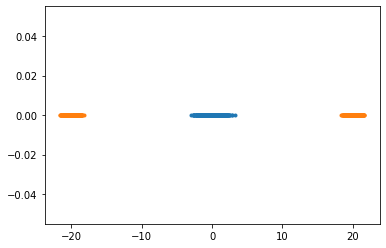

In [7]:
import numpy.random as npr
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

n = 900
n_2 = int(n * 1.0 / 3)
n_2 = int(n * 1.0 / 2.0)


X1 = npr.randn(n).reshape(-1,1) - 0
X21 = 0.6 * npr.randn(n_2).reshape(-1,1) + 20
X22 =  0.6 * npr.randn(n_2).reshape(-1,1) -20
# X23 =  0.6 * npr.randn(n_2).reshape(-1,1) + 20

X2 = np.concatenate((X21, X22), axis=0)
X1, X2 = X2, X1

plt.plot(X2.flatten(), [0] * n, '.')
plt.plot(X1.flatten(), [0] * n, '.')

with torch.cuda.device(0):

    X1 = torch.tensor(X1).cuda()
    X2 = torch.tensor(X2).cuda()

In [10]:


torch.cuda.manual_seed_all(10)
torch.manual_seed(10)

c = cIPFP(
    X1, X2,  number_time_steps=100, batch_size=900 ,
    step_size=1e-3, weights=[20, 20,20], rng = None,
    optimizer=torch.optim.Adgrad, lrs = 0.005, weight_decay=0, log_prob=log_kde_pdf_per_point
)

/anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


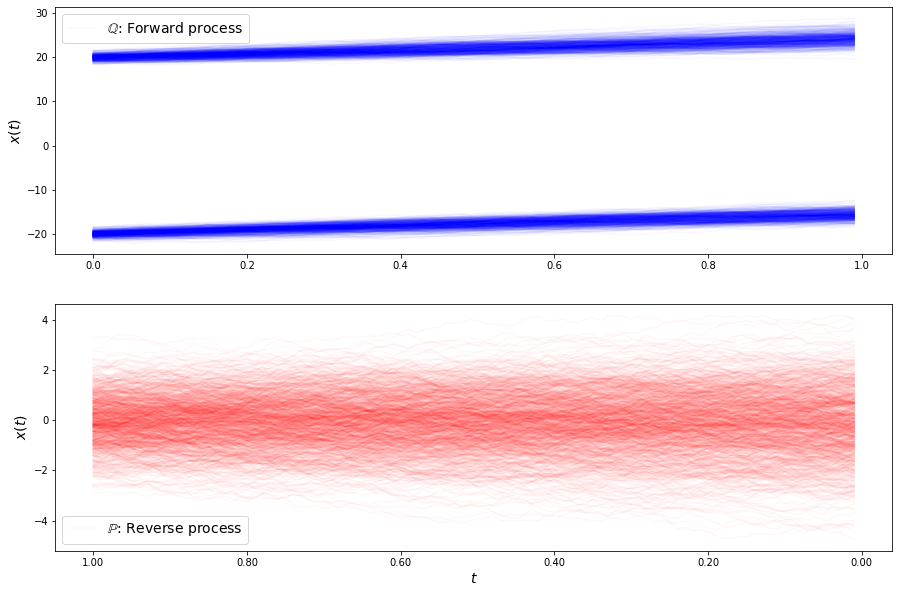

loss b 120.98735201063614
loss b 120.98951715725521
loss b 120.66500147951542
loss b 120.59375562419632
loss b 120.58446059005374
loss b 120.36995556209888
loss b 120.4033902220291
loss b 119.55781963314661
loss b 120.44112385845192
loss b 119.57308195201365
loss b 119.1725256918502
loss b 119.17492338758625
loss b 119.09319136242495
loss b 118.90707188222643
loss b 118.67721035398264
loss b 118.42757775493355
loss b 117.9365572337496
loss b 118.19419357230021
loss b 117.72068897993633
loss b 117.4515760095173
loss b 117.38263225800466
loss b 116.79671311319157
loss b 117.0644754850549
loss b 116.45429887444712
loss b 116.67177616533846
loss b 116.12998558613697
loss b 115.67616055606183
loss b 115.67860616744841
loss b 115.71329301961885
loss b 115.04866855313941
loss f 2311.1747489688264
loss f 2261.2713596263516
loss f 2202.362195265316
loss f 2160.99514373826
loss f 2119.247872940973
loss f 2057.3392614872887
loss f 2023.4198114760413
loss f 1979.611826448513
loss f 1938.1791817170

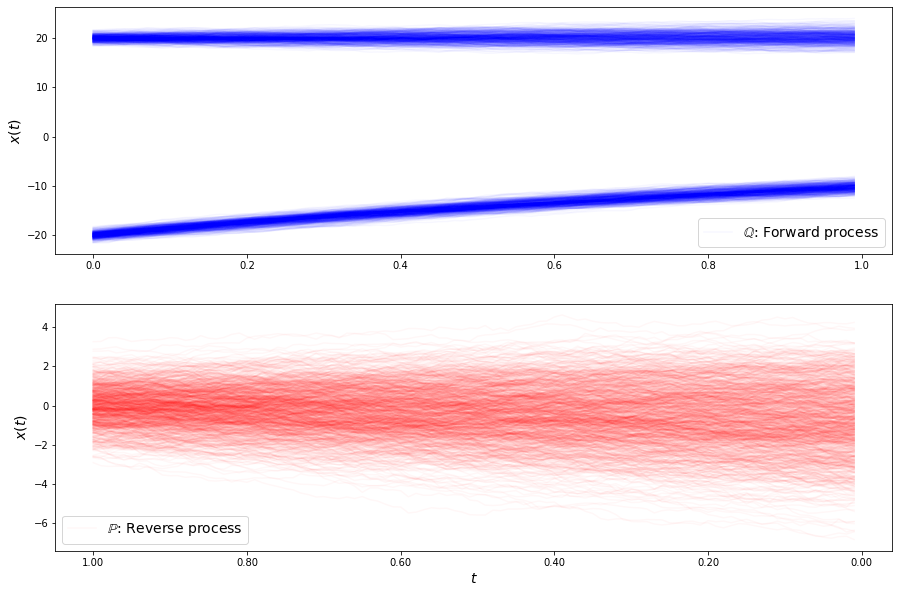

loss b 114.52879295666875
loss b 113.69656585390314
loss b 113.55906525434034
loss b 113.52315718385405
loss b 112.48552889068041
loss b 111.99148310539829
loss b 111.4952621125294
loss b 111.29020544979547
loss b 111.75673284429327
loss b 110.79891112204317
loss b 110.62435326002985
loss b 109.6925508423701
loss b 109.23145475783936
loss b 108.79848611780828
loss b 109.64635748441665
loss b 108.98687320363338
loss b 108.44557750479831
loss b 108.44587299715876
loss b 106.86932630937702
loss b 106.85379863481876
loss b 106.79890486547339
loss b 106.63828931596655
loss b 105.25318139747044
loss b 104.34824207589892
loss b 104.6495057185976
loss b 103.35633405268207
loss b 102.68160025093223
loss b 102.96234098247356
loss b 101.85247620928149
loss b 101.22257703503941
loss f 1277.7195568704296
loss f 1258.9497494013297
loss f 1246.3273541405388
loss f 1227.3857845009586
loss f 1209.444760113754
loss f 1182.098068682422
loss f 1161.0473722684355
loss f 1150.9677158610227
loss f 1141.48414

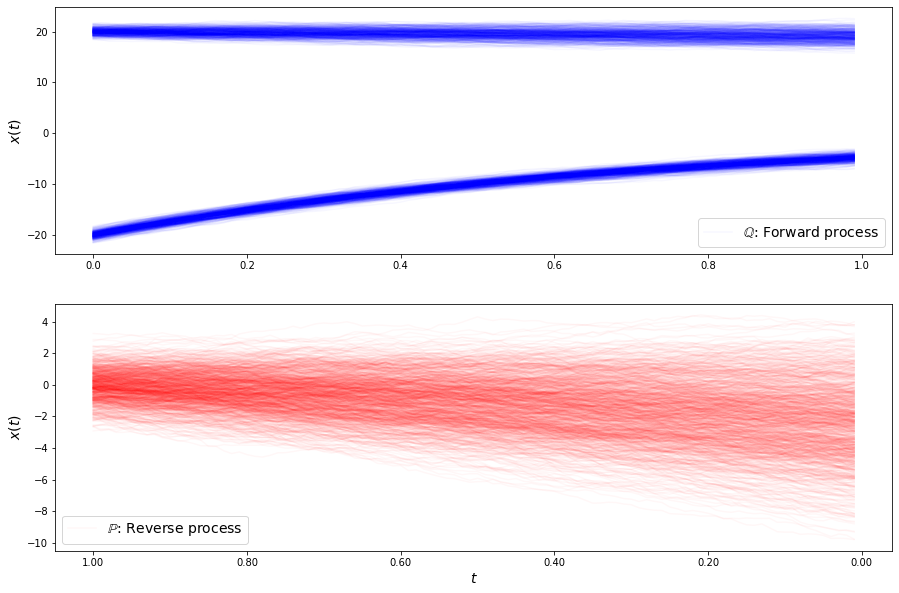

loss b 98.79253538581348
loss b 98.46364784237446
loss b 98.32730162380906
loss b 96.54450931220799
loss b 96.30093864622165
loss b 95.11263399186774
loss b 93.87580083850587
loss b 93.70804408158084
loss b 91.94339405329227
loss b 91.34354679223419
loss b 89.95299717437575
loss b 88.67752568124045
loss b 87.04058124616553
loss b 87.02446641961605
loss b 85.00257017397277
loss b 83.44764896313602
loss b 83.18689048942892
loss b 81.6469723760103
loss b 79.74207361739695
loss b 78.97032406140947
loss b 77.10883809475557
loss b 76.18952532177008
loss b 74.3692053705915
loss b 73.90753420347471
loss b 71.78754345977927
loss b 69.44237372118057
loss b 68.55252458426419
loss b 66.6790424866387
loss b 64.86702057700825
loss b 64.40989334007715
loss f 976.0216106898313
loss f 961.2329177825559
loss f 970.780424693368
loss f 952.4120852195291
loss f 951.8465150606854
loss f 949.6544324945663
loss f 950.3222230949596
loss f 942.0340206297919
loss f 939.2998882553388
loss f 934.7352824679434
loss

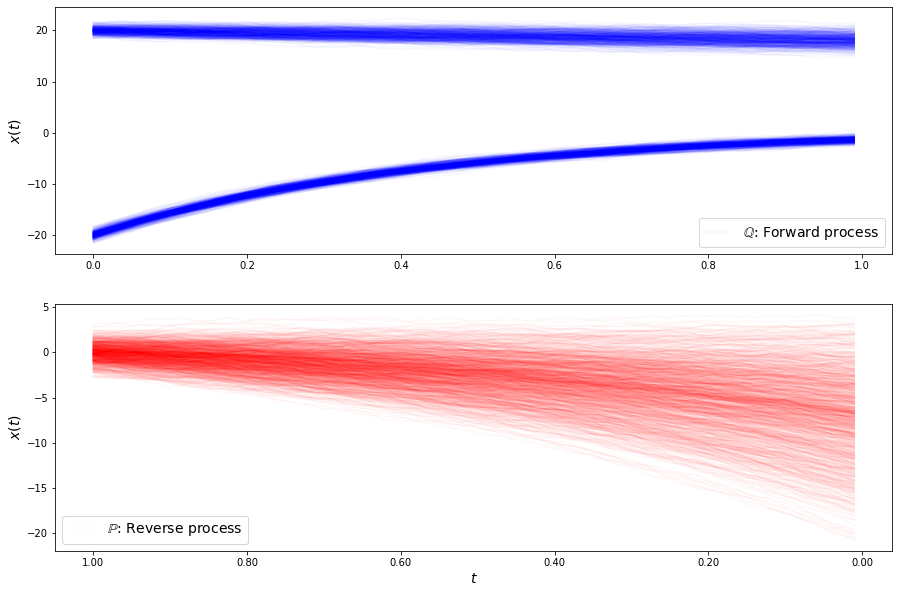

loss b 62.677839690682376
loss b 61.421903113667106
loss b 57.027532432129256
loss b 56.49849324522397
loss b 54.48671130945298
loss b 52.697545996629245
loss b 50.205441012268935
loss b 47.654023251208585
loss b 45.2042995753982
loss b 43.69742470575635
loss b 41.206518864734804
loss b 40.31292500895113
loss b 38.330359008308406
loss b 36.96840491953228
loss b 35.03101142913348
loss b 34.029980771489114
loss b 32.09635583865379
loss b 33.06493469736785
loss b 32.861178697753786
loss b 33.309202605911985
loss b 35.49670848904706
loss b 38.26371044215398
loss b 39.949747148514355
loss b 43.80632406837331
loss b 49.38423421811138
loss b 55.461584306709135
loss b 61.64219022524806
loss b 68.72243977696475
loss b 78.12081195551423
loss b 90.65219904909534
loss f 844.5126958798388
loss f 838.5455835791366
loss f 837.8361648052606
loss f 826.4206854199338
loss f 822.2348374332873
loss f 804.707767071452
loss f 809.5185577988439
loss f 805.0567730852349
loss f 793.2062009215132
loss f 804.937

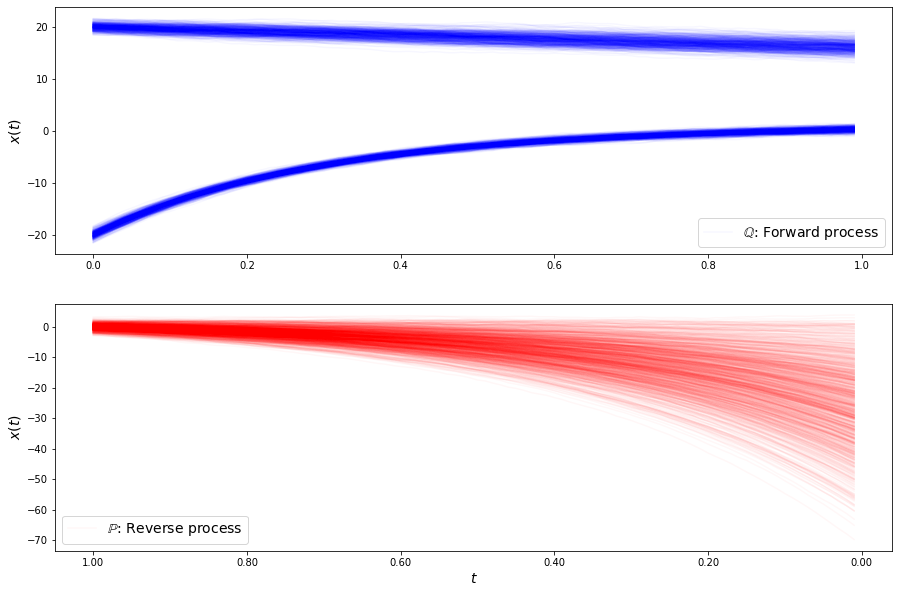

loss b 103.9189942414373
loss b 109.32429707762917
loss b 122.1108466213127
loss b 121.48332962726995
loss b 124.3381718496284
loss b 126.56163995852302
loss b 126.98967948155006
loss b 128.0043463171553
loss b 120.5000160791109
loss b 121.03142091456635
loss b 115.77030470809588
loss b 112.93594278545956
loss b 107.03346196491373
loss b 101.17359365690875
loss b 101.79438740390232
loss b 94.2096349733337
loss b 89.48990219146575
loss b 87.32630948296887
loss b 82.62477902553016
loss b 84.63848885780659
loss b 78.98334702498379
loss b 79.54859902505677
loss b 77.77632497417423
loss b 74.45137759891792
loss b 73.77932279193364
loss b 75.9997655484754
loss b 73.06365585891992
loss b 74.33104760559675
loss b 74.04063655886547
loss b 75.8391999727188
loss f 664.9907071624795
loss f 666.5919415405564
loss f 650.7694510784556
loss f 645.0458640047095
loss f 644.7817801268055
loss f 625.4274279903517
loss f 626.4303771337882
loss f 615.804752528672
loss f 614.0323069201454
loss f 602.56349317

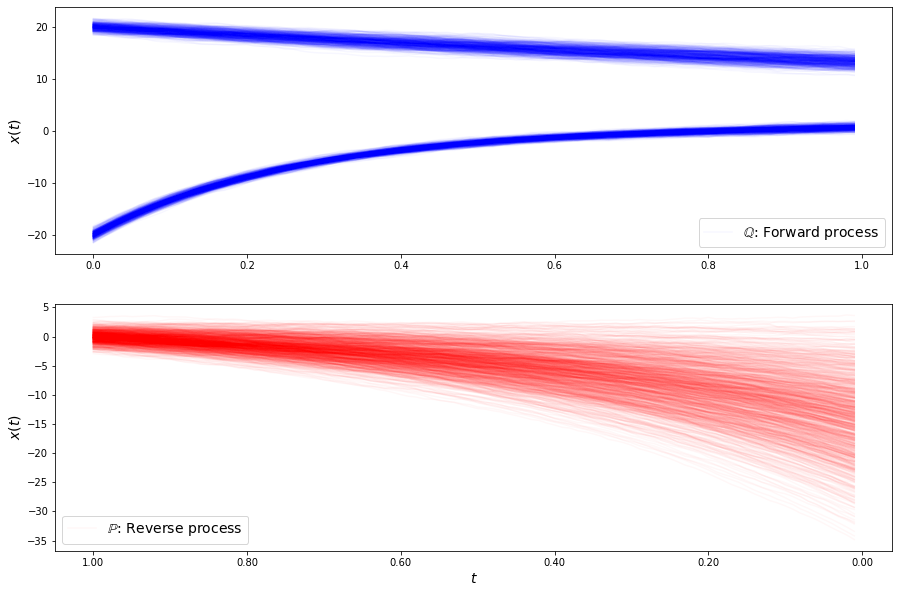

loss b 109.66267085791378
loss b 110.24160012460017
loss b 107.81175374155782
loss b 109.87644092444003
loss b 110.54572662410588
loss b 109.46757905949414
loss b 110.72895048256133
loss b 108.38717350770807
loss b 108.51699982326802
loss b 108.41995890985183
loss b 106.78929537092854
loss b 108.82891307439222
loss b 107.73056681550878
loss b 109.21260656027498
loss b 108.59183700322518
loss b 109.50621124444594
loss b 108.99783163071743
loss b 110.41550608016792
loss b 109.18917181093838
loss b 110.18873526700835
loss b 110.17761955272657
loss b 111.32516847198572
loss b 111.89096457113554
loss b 111.64171321725195
loss b 111.28545444641773
loss b 111.78925920151539
loss b 111.491911274705
loss b 111.3526820649987
loss b 112.61084263591717
loss b 112.4362247130583
loss f 472.4717385673712
loss f 467.6362311969627
loss f 457.27091585322984
loss f 448.12544330419223
loss f 441.0143702470179
loss f 436.71430432876366
loss f 426.7134527807465
loss f 418.1437497871713
loss f 411.8281392875

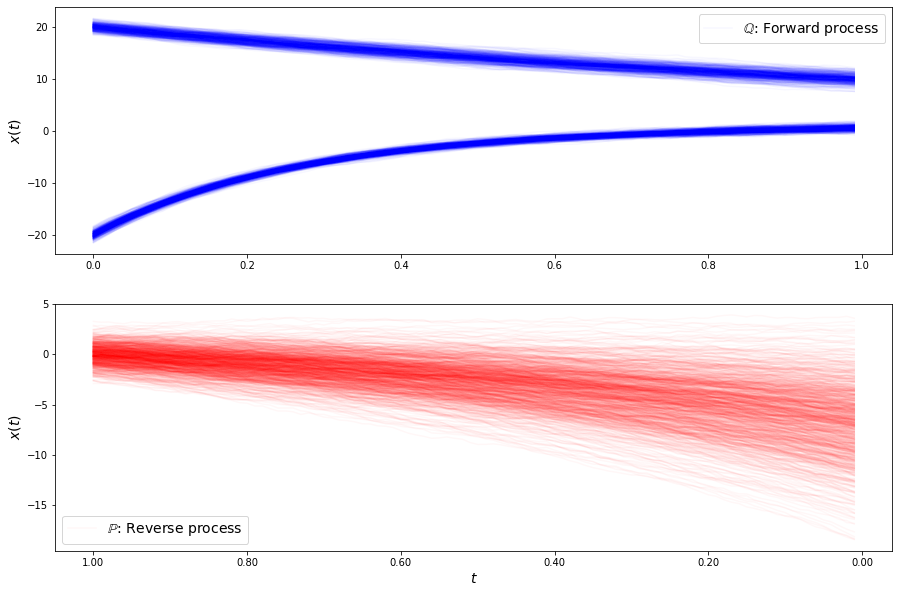

loss b 108.37048351689074
loss b 108.15615401979223
loss b 109.38512323817906
loss b 109.12168198808729
loss b 109.16814538007792
loss b 109.56976520063436
loss b 110.02768471439617
loss b 110.49928596966988
loss b 110.72243071820684
loss b 110.36770185520628
loss b 111.71363871424711
loss b 110.26842854874016
loss b 110.55479641456826
loss b 110.71275069945354
loss b 110.18022058471766
loss b 110.82539329320856
loss b 111.50091206006107
loss b 111.77634802073335
loss b 112.03883035962477
loss b 113.33771310526902
loss b 111.69536005638717
loss b 111.98955681357288
loss b 111.13205833243521
loss b 112.58638143769635
loss b 112.24244051313866
loss b 112.77266173444266
loss b 113.19263599898238
loss b 113.9494899176502
loss b 112.1280576563572
loss b 113.08815921304539
loss f 285.9822601613753
loss f 281.9601652705877
loss f 275.4835569588411
loss f 271.76004312468507
loss f 268.46832764848216
loss f 261.9238157988558
loss f 260.54682940113344
loss f 252.74761958669933
loss f 247.3289620

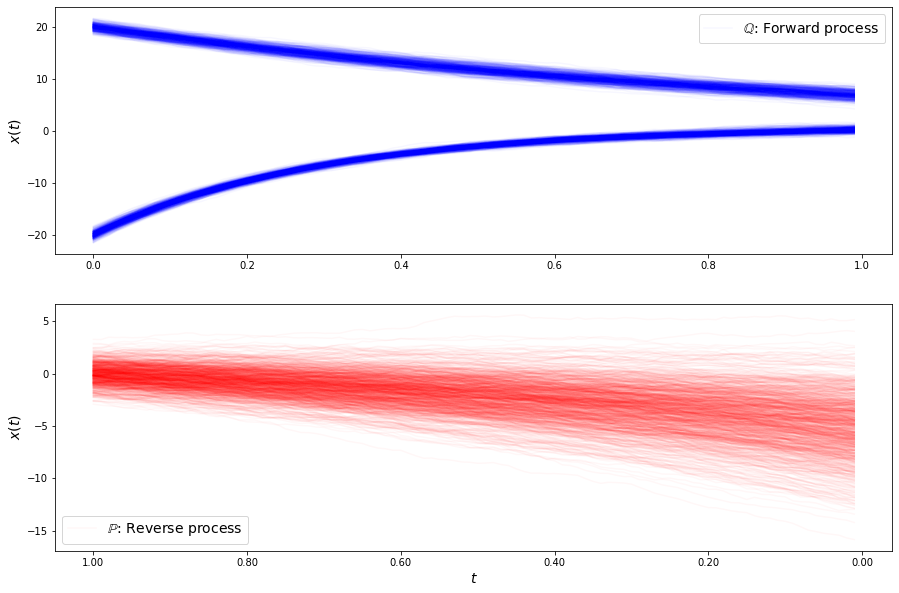

loss b 102.73883841249231
loss b 103.25482370584008
loss b 102.6713306125652
loss b 104.29210793008393
loss b 103.25760323411174
loss b 104.0281312191466
loss b 103.56442427474356
loss b 103.7498777682843
loss b 103.62185107571267
loss b 103.17026112361187
loss b 103.192852263612
loss b 104.09831012008831
loss b 103.42294669393196
loss b 103.30743067783938
loss b 103.11526224603688
loss b 104.27529253701663
loss b 103.95977718139592
loss b 103.51783269273163
loss b 103.86133744039176
loss b 103.31417128830752
loss b 103.07128383934842
loss b 103.21472445972928
loss b 103.03672609106468
loss b 102.37394906575197
loss b 103.19161332227921
loss b 103.17036564694853
loss b 102.62360244870884
loss b 102.04265733638833
loss b 102.24170811791973
loss b 102.28518850939419
loss f 162.23027798404487
loss f 158.47480074364182
loss f 156.52347725260768
loss f 153.45308058256077
loss f 151.3587576906005
loss f 149.97511948504672
loss f 147.8480639120606
loss f 145.8734474930064
loss f 144.389245843

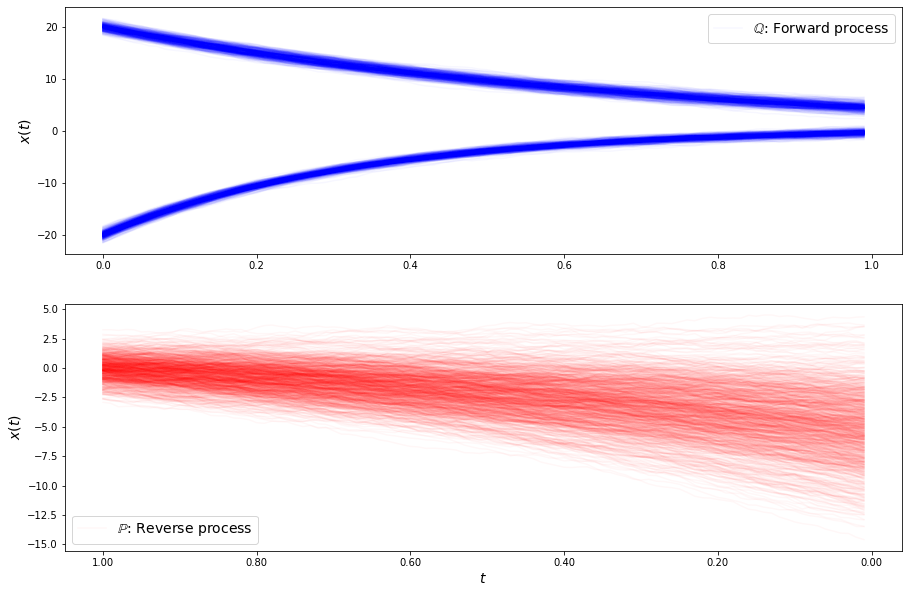

loss b 90.84252600251905
loss b 90.89906816582078
loss b 90.49284913737505
loss b 90.82625252576798
loss b 90.9097315110235
loss b 89.49513748944379
loss b 89.73157711937729
loss b 90.48337585290497
loss b 88.9515261206002
loss b 89.00762693426769
loss b 88.51667431473734
loss b 88.42756165647874
loss b 87.8538366447973
loss b 87.75062826200075
loss b 87.56342406198772
loss b 86.27786732612614
loss b 86.2919493802522
loss b 85.33112871655408
loss b 85.9330299489544
loss b 85.40422283028553
loss b 84.6412267885526
loss b 84.03129519411094
loss b 84.23432474448938
loss b 83.24488042582638
loss b 82.3525811042572
loss b 82.02069890666701
loss b 81.51865804076279
loss b 80.47283475978215
loss b 80.16846592820337
loss b 79.67235958545201
loss f 86.2870233439979
loss f 85.57976506677086
loss f 84.81347495953726
loss f 84.21504459262725
loss f 84.07202826066565
loss f 83.48732546099106
loss f 82.91557041520869
loss f 82.45600604247406
loss f 82.42098003715324
loss f 81.61223771829052
loss f 8

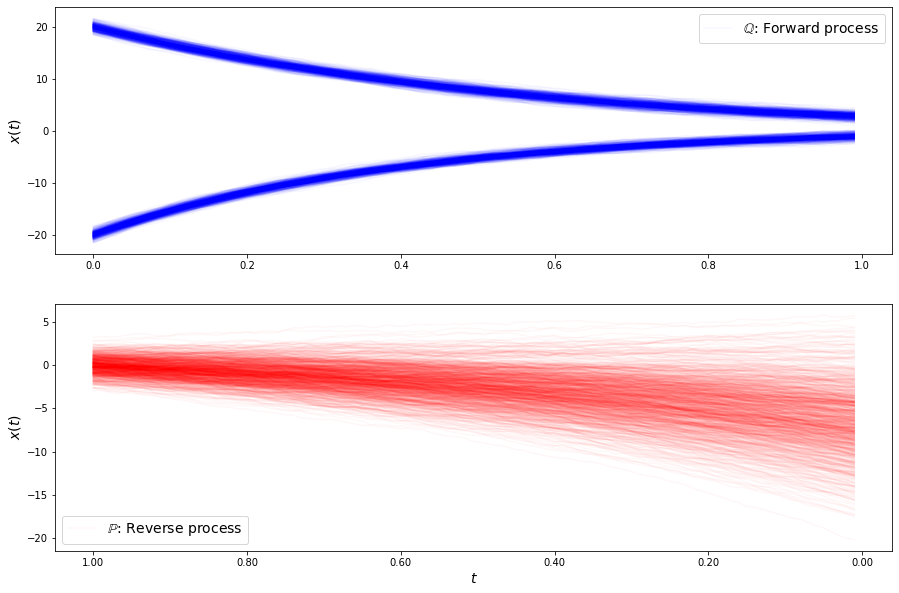

loss b 68.92230707186711
loss b 68.66692922152636
loss b 67.75686817554015
loss b 67.16998647375718
loss b 66.26285436558614
loss b 65.3322662148884
loss b 65.46142636342013
loss b 64.37476581332683
loss b 63.40532917261885
loss b 61.42055251181417
loss b 61.39985009642401
loss b 59.185445769804765
loss b 60.326973090339095
loss b 57.87114071492875
loss b 56.99865980768929
loss b 56.234647679908896
loss b 54.58431350087002
loss b 54.846454460619086
loss b 53.078298691298684
loss b 51.71205973693103
loss b 51.00165754090203
loss b 50.01863294930134
loss b 48.06240079246572
loss b 48.12861455870332
loss b 46.126177358437275
loss b 47.08085861052827
loss b 44.002781911041815
loss b 42.307187442386955
loss b 41.26244566880352
loss b 40.569051514362556
loss f 42.911034594702215
loss f 43.18500752209452
loss f 43.3059821397834
loss f 43.84166225135132
loss f 43.98758542444119
loss f 44.24310676675174
loss f 44.568866193844734
loss f 45.05024666781048
loss f 45.19595776271456
loss f 45.682493

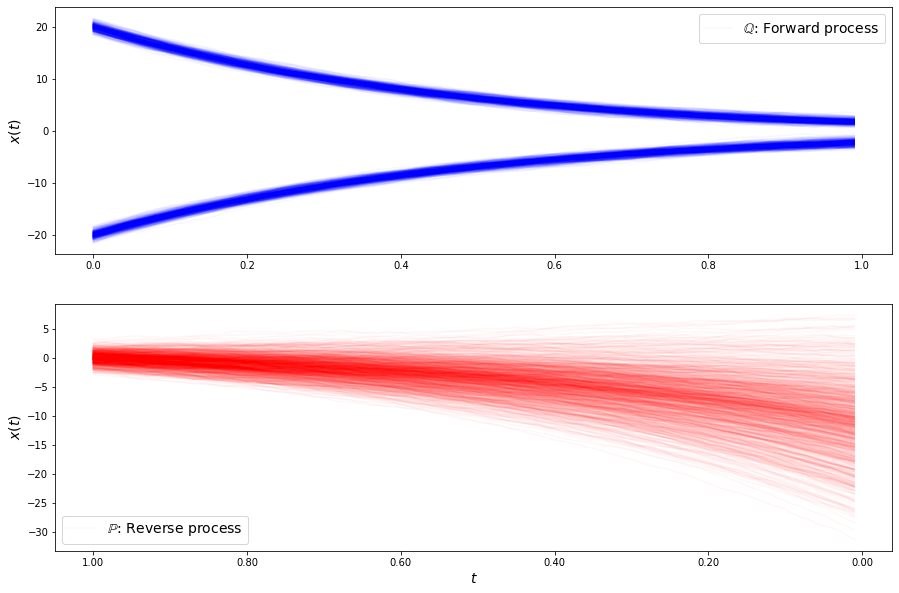

loss b 38.12273949300872
loss b 37.645162966955404
loss b 37.9988037341745
loss b 36.95221179176116
loss b 36.25868122453841
loss b 35.742518900886154
loss b 34.06306984151329
loss b 34.72138209011992
loss b 35.63262752584879
loss b 33.751715093337005
loss b 34.15409157471141
loss b 34.39356117661532
loss b 35.06915843569847
loss b 35.50786513592215
loss b 36.16044053521868
loss b 37.06842552410868
loss b 38.05409540852128
loss b 39.80697990132909
loss b 39.17899264856518
loss b 41.562280250210804
loss b 42.14308580447824
loss b 44.64782723427028
loss b 46.67153481156816
loss b 48.59871518159513
loss b 52.81543103940304
loss b 54.84681303468626
loss b 58.84263491405674
loss b 62.201976213519075
loss b 65.50295845062503
loss b 69.05209246020026
loss f 48.42567353084979
loss f 49.74092583383821
loss f 50.98226213947896
loss f 52.317395668697756
loss f 53.33325964949523
loss f 54.539026837064725
loss f 56.08039167857608
loss f 57.207823765639404
loss f 58.681773331564386
loss f 59.7628585

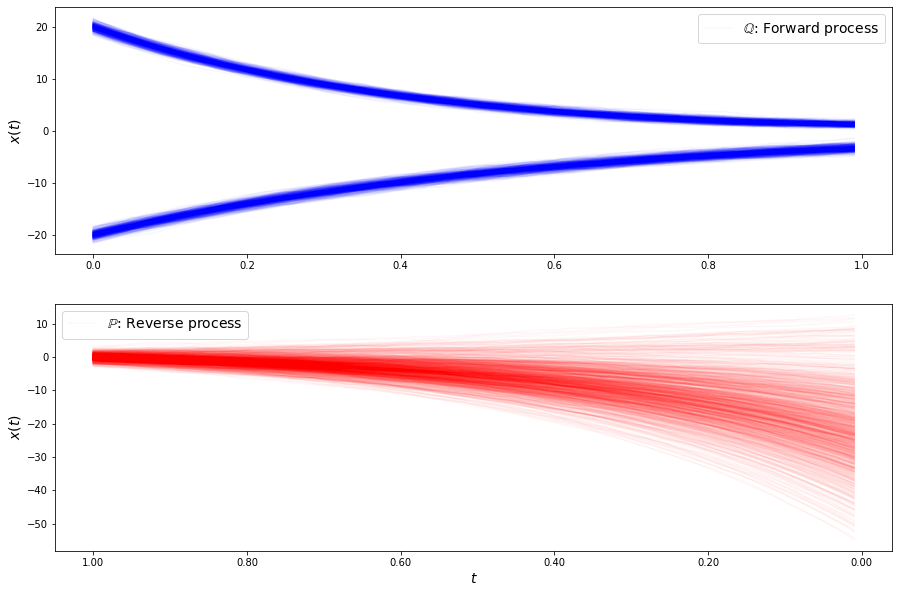

loss b 110.99778885327103
loss b 118.15361605473647
loss b 120.37887643442735
loss b 127.72070277850781
loss b 134.3788403418656
loss b 137.60009087163928
loss b 145.18079251728858
loss b 146.1886137815136
loss b 147.45218851896726
loss b 150.11122101795036
loss b 148.25317062002742
loss b 152.1738327098205
loss b 152.10259624900328
loss b 149.3430141759942
loss b 150.02943673544846
loss b 149.2282307063101
loss b 140.5869385275265
loss b 137.58446010151883
loss b 133.8124901954565
loss b 126.59426512727505
loss b 123.21815252847692
loss b 115.92703809357488
loss b 110.73469755727977
loss b 103.29664204858314
loss b 98.1253896394735
loss b 91.14027630704307
loss b 85.77411773832355
loss b 80.5294720406579
loss b 74.75559659654631
loss b 70.74716973948907
loss f 52.30810926710753
loss f 53.18472146016335
loss f 54.00069189599096
loss f 55.144978896558555
loss f 56.399603352076994
loss f 57.020792746261876
loss f 58.11158078726382
loss f 58.69589344571599
loss f 59.90461433377462
loss f 

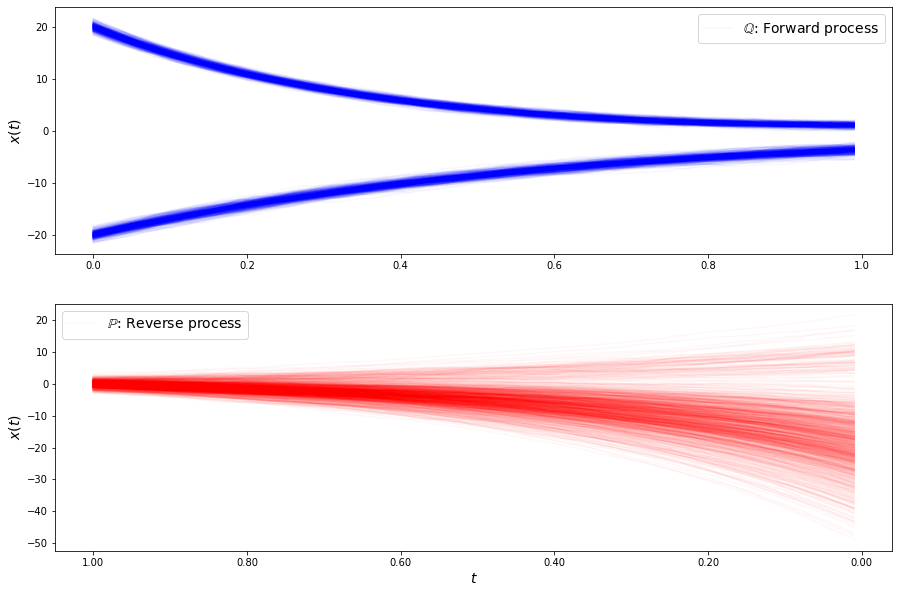

loss b 75.27330887526058
loss b 71.5972591393647
loss b 64.34196920739475
loss b 61.036848482936975
loss b 58.257898929565826
loss b 55.32201599430369
loss b 52.52823760553564
loss b 49.339997676651244
loss b 47.144250523731216
loss b 45.60275303226765
loss b 42.98540523262582
loss b 43.80692550558684
loss b 42.1330596185159
loss b 41.88447278591698
loss b 40.54732370784992
loss b 40.35670665983678
loss b 39.28574949706858
loss b 38.46798506686255
loss b 39.02372216961386
loss b 39.66873232481113
loss b 39.479884424254244
loss b 38.71091538051977
loss b 40.30551033393509
loss b 39.52101487756789
loss b 40.802736207497325
loss b 40.05191336752036
loss b 40.888815707666474
loss b 41.61699508000256
loss b 41.30543560121122
loss b 41.27264440304142
loss f 19.25081601701078
loss f 19.469203149336394
loss f 19.595817733800178
loss f 19.73199075994744
loss f 20.09176557508787
loss f 20.092515229941743
loss f 20.326968868597582
loss f 20.186597520552844
loss f 20.05862664463222
loss f 19.84077

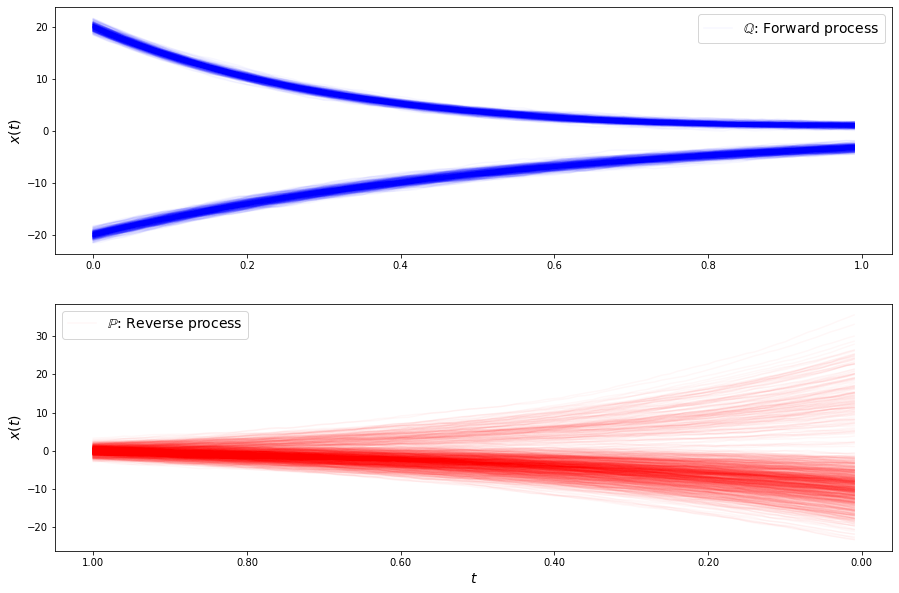

loss b 43.58918647847881
loss b 43.9796887246748
loss b 44.66961071964907
loss b 44.432524461771486
loss b 46.262095696549416
loss b 46.18602371633152
loss b 46.78407053291544
loss b 48.09378602962678
loss b 47.26629093547458
loss b 48.03776601802098
loss b 49.39869647804127
loss b 49.77320518072556
loss b 50.39967268650882
loss b 50.53295222067608
loss b 52.348180985428534
loss b 51.56900743722884
loss b 53.104040365897255
loss b 51.37537669070803
loss b 55.253381188247886
loss b 55.919274826326856
loss b 57.69644348649639
loss b 58.59048616011482
loss b 56.4165215763767
loss b 59.90129750181027
loss b 60.167091068386036
loss b 61.38372338541346
loss b 64.61045616908717
loss b 62.807113576555565
loss b 62.58230048505544
loss b 62.152607146903094
loss f 14.63623155303165
loss f 14.774260163123836
loss f 14.926383756603876
loss f 14.960837511085218
loss f 15.094192082359744
loss f 15.325944829721358
loss f 15.195702257948298
loss f 15.398986914463324
loss f 15.58718931277853
loss f 15.4

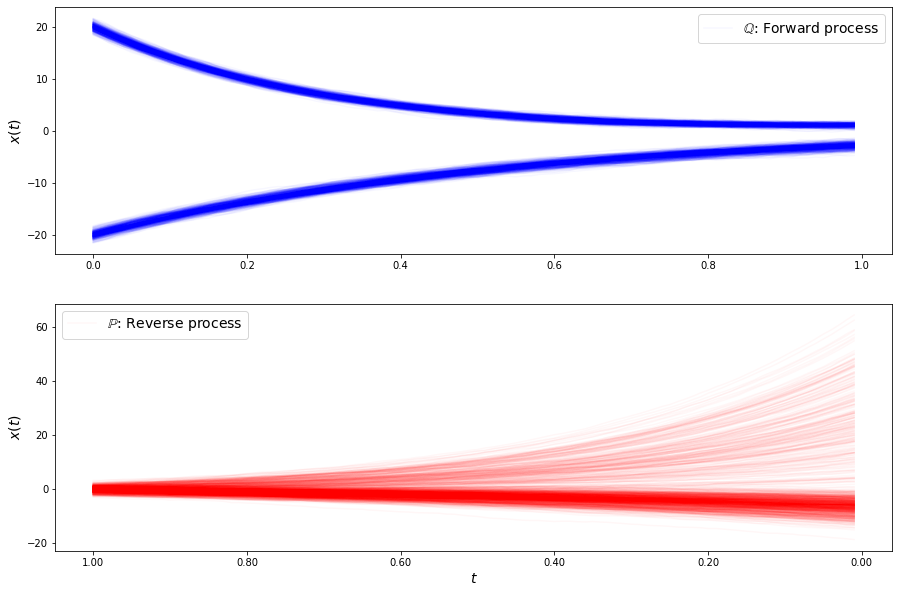

loss b 67.52501556036925
loss b 69.89029254071762
loss b 74.19136119231652
loss b 76.30516504670875
loss b 79.02853959572249
loss b 79.84566155756245
loss b 83.51596185121468
loss b 86.42773716521056
loss b 88.5756923679071
loss b 89.98479614952106
loss b 90.81740936986573
loss b 94.37019971921738
loss b 102.4318106228305
loss b 103.44923966958332
loss b 106.97813874623674
loss b 110.71797363994916
loss b 106.31919659580299
loss b 114.65551874896073
loss b 119.7220357082455
loss b 123.8095525326437
loss b 126.22968924400836
loss b 133.26179394011965
loss b 141.10039875108544
loss b 134.0423770655068
loss b 140.04528683479765
loss b 148.62367121543218
loss b 147.3534932789005
loss b 154.09915177220924
loss b 166.06068081334456
loss b 152.10954326225462
loss f 27.88177491557415
loss f 27.801244710817908
loss f 27.79913396401424
loss f 28.046937507191956
loss f 27.798542103059514
loss f 27.87796235790781
loss f 28.071066126723238
loss f 28.278009581332896
loss f 28.412192104582182
loss f 

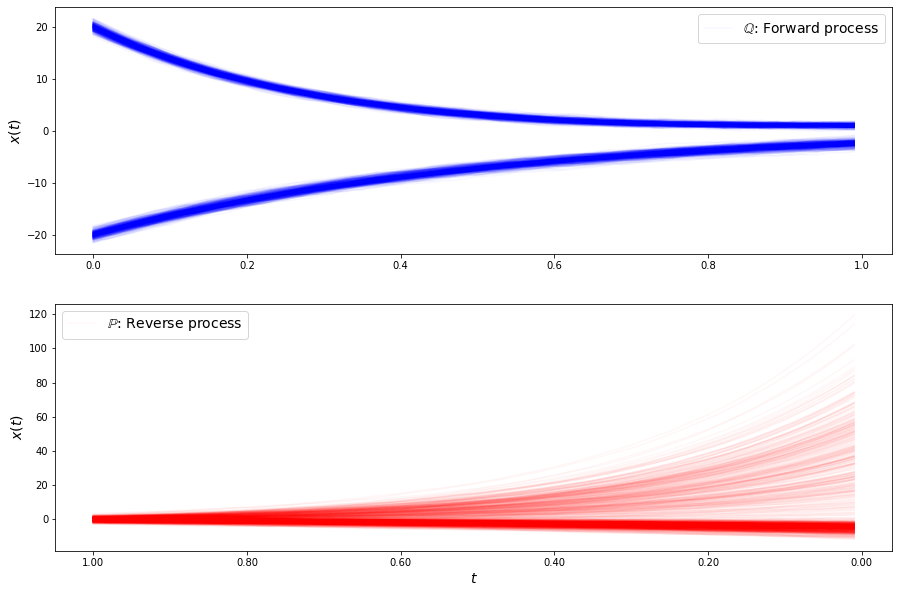

loss b 161.00127196521626
loss b 151.71289401132034
loss b 154.2445994741136
loss b 157.0273766930615
loss b 150.74190973484914
loss b 151.66720373555052
loss b 152.3945514737011
loss b 141.93073319914362
loss b 143.6904095467774
loss b 135.84339823515057
loss b 139.46651621953166
loss b 135.79831149728184
loss b 131.74905816158213
loss b 132.74657114492703
loss b 120.38489232065777
loss b 126.51502027237477
loss b 117.63304852126821
loss b 115.84597977018588
loss b 108.56970595594541
loss b 107.9927535569715
loss b 105.54611850652884
loss b 104.25798574805117
loss b 101.60210811279121
loss b 99.86471931251712
loss b 95.66783599260829
loss b 92.73023364356064
loss b 89.62525862506685
loss b 89.76593157010527
loss b 87.63557660372312
loss b 87.09195626602613
loss f 42.42878878251907
loss f 42.50612963514835
loss f 42.85917054367466
loss f 43.172094049190065
loss f 43.14877144895094
loss f 43.214414387393084
loss f 43.3279829743311
loss f 43.62278956327721
loss f 43.8533767817132
loss f 

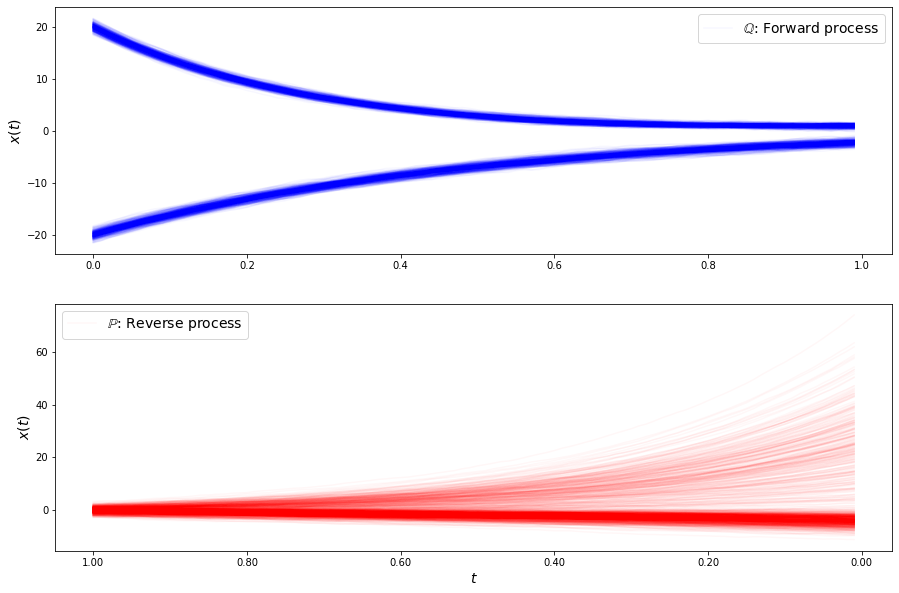

loss b 91.89963946947874
loss b 90.16816213543761
loss b 87.78926510035718
loss b 86.8916299844268
loss b 86.78905286369633
loss b 87.62045727321266
loss b 85.93145012948278
loss b 87.66515047672047
loss b 85.33416106353776
loss b 83.99882407907326
loss b 84.14704949392221
loss b 85.73975148889768
loss b 84.10122466257292
loss b 84.28137485413147
loss b 85.75342828847822
loss b 84.19816808312778
loss b 84.4701309569676
loss b 84.91124775267397
loss b 85.61381400761405
loss b 84.7385188441603
loss b 86.18076319527398
loss b 84.27814557299327
loss b 87.33965288792736
loss b 86.06459021183018
loss b 85.45655800100614
loss b 87.8704438234087
loss b 88.14784331807282
loss b 86.84766678152727
loss b 86.43899249750758
loss b 87.37930815609018
loss f 69.81963549187208
loss f 69.92822355768017
loss f 70.00917425301064
loss f 70.39065308290427
loss f 70.32208269333097
loss f 70.29998810371963
loss f 70.45498599935783
loss f 70.49808828359846
loss f 70.27362070669649
loss f 70.44263616486288
loss

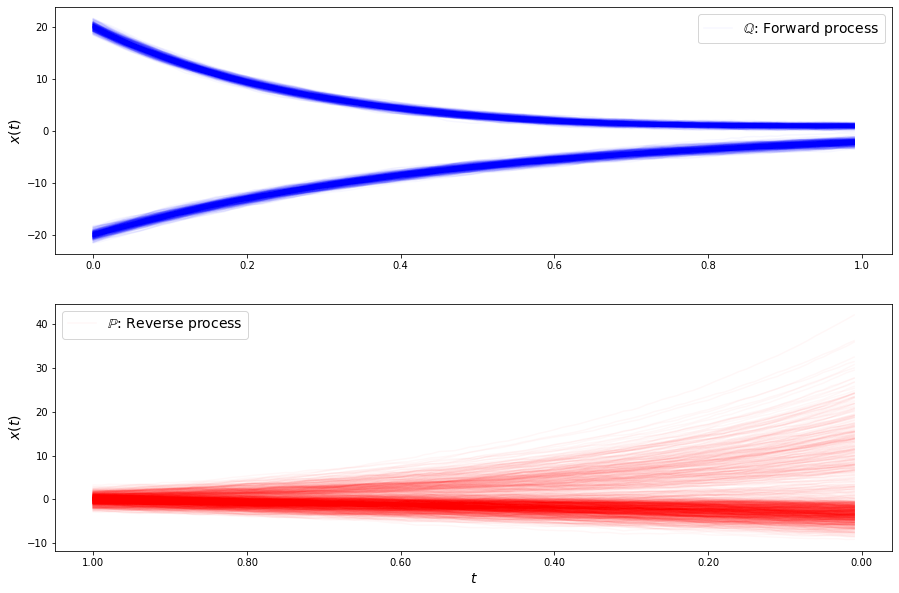

loss b 88.06225477207147
loss b 87.77438630541442
loss b 88.10797162825342
loss b 89.19376757403182
loss b 89.73718180729763
loss b 88.14665258397457
loss b 89.17029405939181
loss b 90.60797501518104
loss b 89.74717935402707
loss b 90.66461544897949
loss b 90.9121921466832
loss b 90.6730490876379
loss b 91.03536857144887
loss b 90.61322233180927
loss b 91.81337667493048
loss b 91.2918786455597
loss b 91.36008942277492
loss b 91.65086179124326
loss b 91.42924893542418
loss b 92.43703835639978
loss b 91.73217440591623
loss b 93.4234982841269
loss b 92.97057785237752
loss b 92.82715358990953
loss b 93.57393839552505
loss b 94.26932412819572
loss b 94.32924796848232
loss b 94.2383239907133
loss b 94.5116423279103
loss b 94.22151660618036
loss f 92.27999533341796
loss f 92.4470369348678
loss f 92.0732201629302
loss f 92.17599943552511
loss f 92.04598334988536
loss f 91.84525952142305
loss f 91.6653811115569
loss f 91.66195328549504
loss f 91.5281044945656
loss f 91.23142667350662
loss f 91.

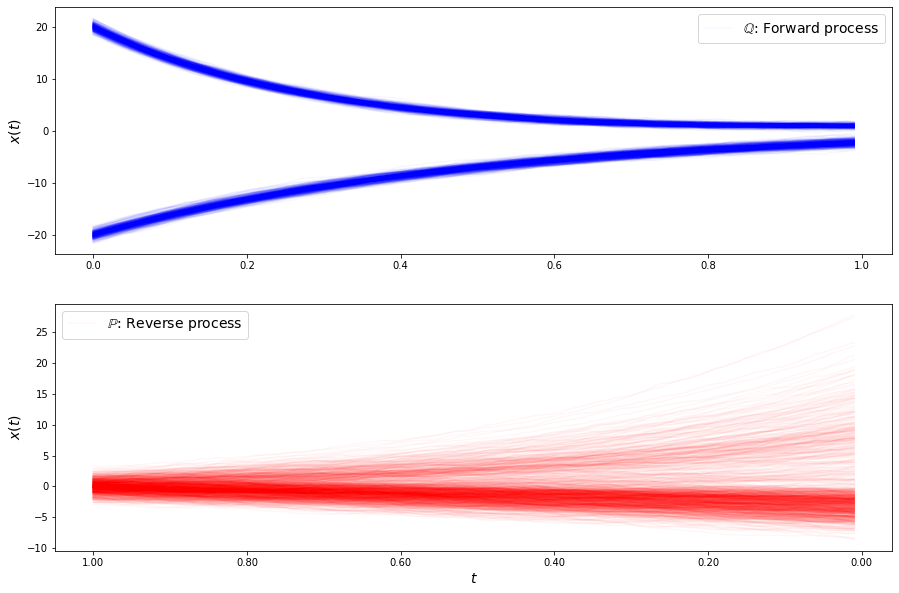

loss b 93.4300935597023
loss b 92.97008922617566
loss b 93.70378263058453
loss b 93.92029837729883
loss b 94.52419757875835
loss b 94.3561426978368
loss b 95.22050437705681
loss b 95.97185887833149
loss b 95.48585914033198
loss b 95.11056122041641
loss b 94.92319363496013
loss b 95.9806215753675
loss b 95.50532774614021
loss b 95.28424861969248
loss b 96.26142773819494
loss b 95.3002291693466
loss b 96.72104028160888
loss b 96.72252406975879
loss b 96.71410662137681
loss b 96.33497298240117
loss b 97.67644992727577
loss b 98.01741169106086
loss b 97.39092267800123
loss b 97.65259638296939
loss b 96.88817376906123
loss b 97.33140195088659
loss b 98.14659015913679
loss b 96.9316746247891
loss b 98.56536757498395
loss b 98.19437187306463
loss f 104.5433391082412
loss f 104.50526494800829
loss f 104.0635868955755
loss f 103.84799242299133
loss f 103.62631082920578
loss f 103.59137519613097
loss f 102.82926261578554
loss f 102.55471067864096
loss f 102.00999160533969
loss f 101.996561082213

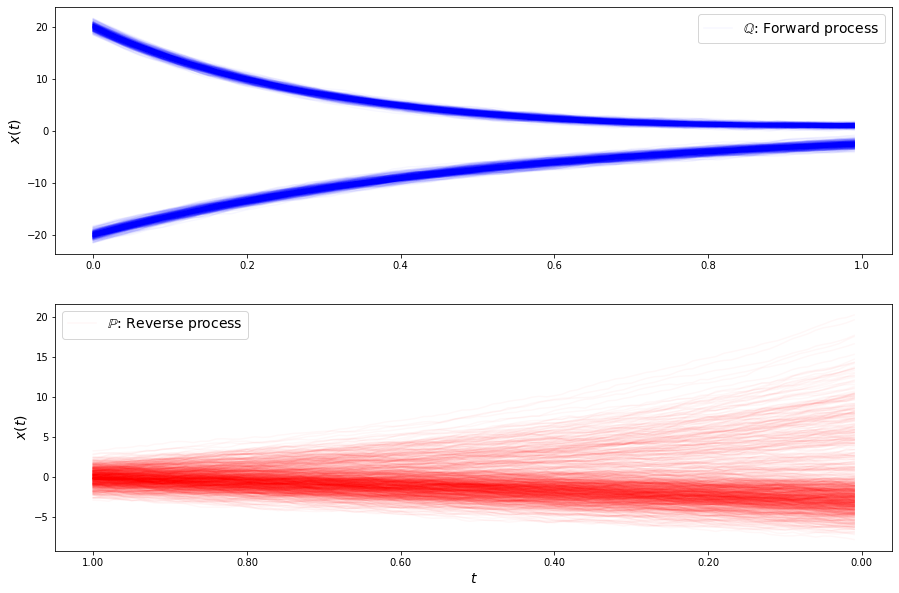

loss b 95.88084704507031
loss b 95.74203032873096
loss b 97.32277200903093
loss b 96.95685146181594
loss b 97.00274309486784
loss b 97.20995970757323
loss b 97.53917543685863
loss b 97.1531107654111
loss b 97.84466637284622
loss b 97.96868359952713
loss b 98.25384963072139
loss b 97.89608411962597
loss b 97.4936814887191
loss b 97.2207889723353
loss b 98.95404595008507
loss b 98.92271159454455
loss b 98.56354110197067
loss b 97.97784203922794
loss b 98.6222115096393
loss b 99.01225684537303
loss b 99.02765995809757
loss b 99.18167558930921
loss b 98.68501082969799
loss b 98.80095106166274
loss b 99.11819753839353
loss b 99.83788856392833
loss b 99.91202734039221
loss b 99.07072723316901
loss b 99.98724280815924
loss b 99.71576455503128
loss f 107.16364091417405
loss f 106.92546251264649
loss f 106.42941344181195
loss f 106.31836447915366
loss f 105.73653674321238
loss f 105.68348265014004
loss f 105.19217256841631
loss f 104.42010169795824
loss f 104.03259643378875
loss f 103.886561528

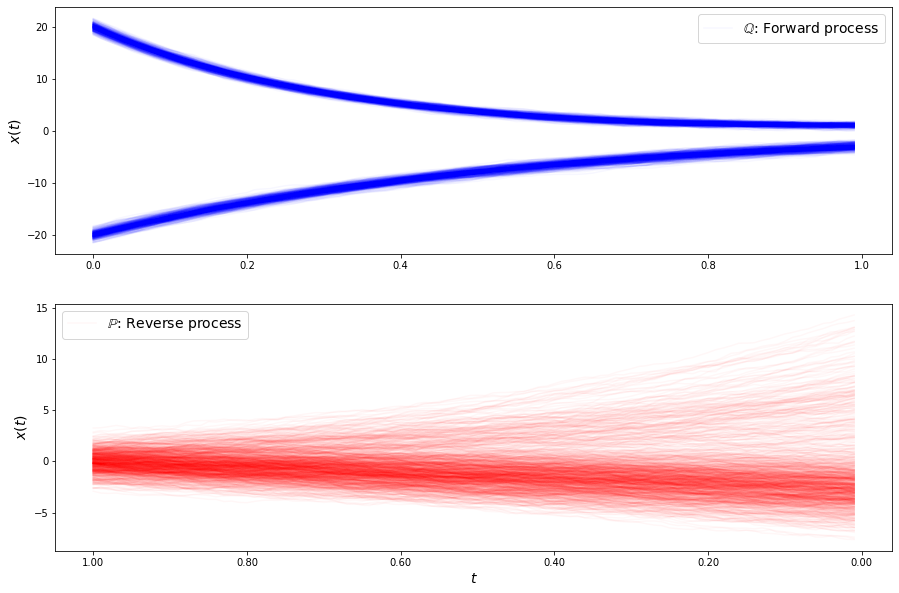

loss b 98.76298906050447
loss b 97.79773513058308
loss b 98.51191821232783
loss b 97.11265721172619
loss b 98.34625291466638
loss b 98.3679854350555
loss b 98.75178349478377
loss b 99.00601040982974
loss b 99.52712685593276
loss b 98.62470550366007
loss b 99.65421839578093
loss b 99.02344067088003
loss b 98.97684970780884
loss b 99.47100600001713
loss b 99.26173655297421
loss b 99.54544616630773
loss b 99.27951510954469
loss b 99.56141320498202
loss b 100.1775231447615
loss b 99.8839780126588
loss b 99.4223399175261
loss b 99.85470985671603
loss b 99.9508030129513
loss b 99.57924353615644
loss b 100.00306149383928
loss b 99.08036033519697
loss b 100.22283199715118
loss b 99.9335009608256
loss b 99.59289436639983
loss b 100.12032831292444
loss f 103.93091694128874
loss f 103.80971707976194
loss f 103.01726151097817
loss f 102.83774064291082
loss f 102.3082521496787
loss f 102.1758974906623
loss f 102.02049537965132
loss f 101.46619300760385
loss f 101.00027524803055
loss f 100.546554096

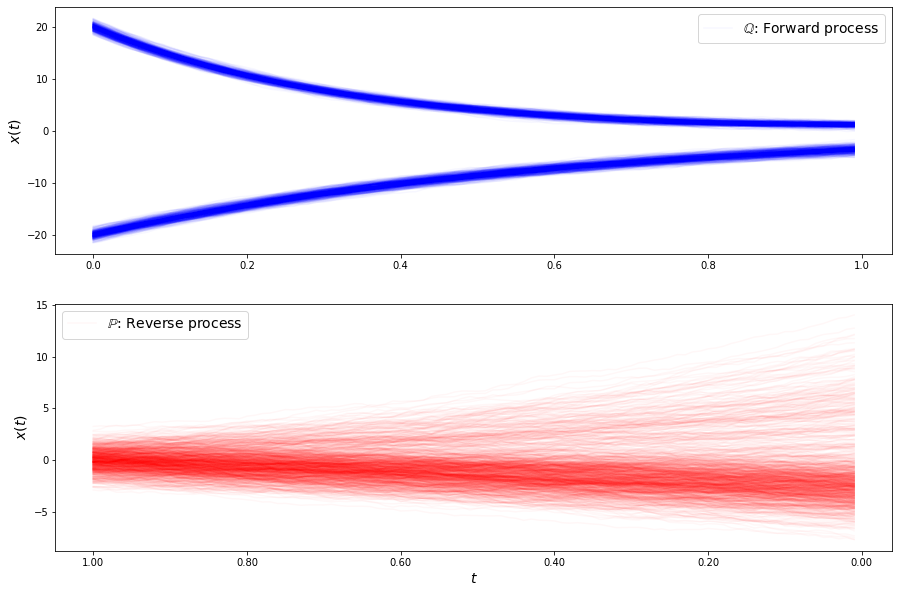

loss b 98.94593623973273
loss b 98.06195824682817
loss b 98.79145636889074
loss b 99.12422247677871
loss b 99.24322867089445
loss b 99.65426860999744
loss b 98.98001550752744
loss b 99.07518614376114
loss b 98.5721173068207
loss b 99.15434975056527
loss b 99.91594238467269
loss b 99.05210403332912
loss b 99.18268305247967
loss b 98.95964295797009
loss b 99.01471519186786
loss b 99.18407137432158
loss b 99.70760332871335
loss b 100.09245617910597
loss b 99.41859403342285
loss b 99.27975575783597
loss b 100.0503435236247
loss b 99.6020825227251
loss b 99.74889597933024
loss b 99.70853916699676
loss b 99.5228806200737
loss b 99.67113192766956
loss b 99.47788099982007
loss b 99.91133129973478
loss b 99.72118332446281
loss b 100.12714718573665
loss f 98.4337648159111
loss f 97.89575385581026
loss f 97.34718438882138
loss f 97.34191256812969
loss f 96.86504866465191
loss f 96.90291156401814
loss f 96.48600754197031
loss f 95.44760108816489
loss f 95.03201716166207
loss f 95.24149335829799
lo

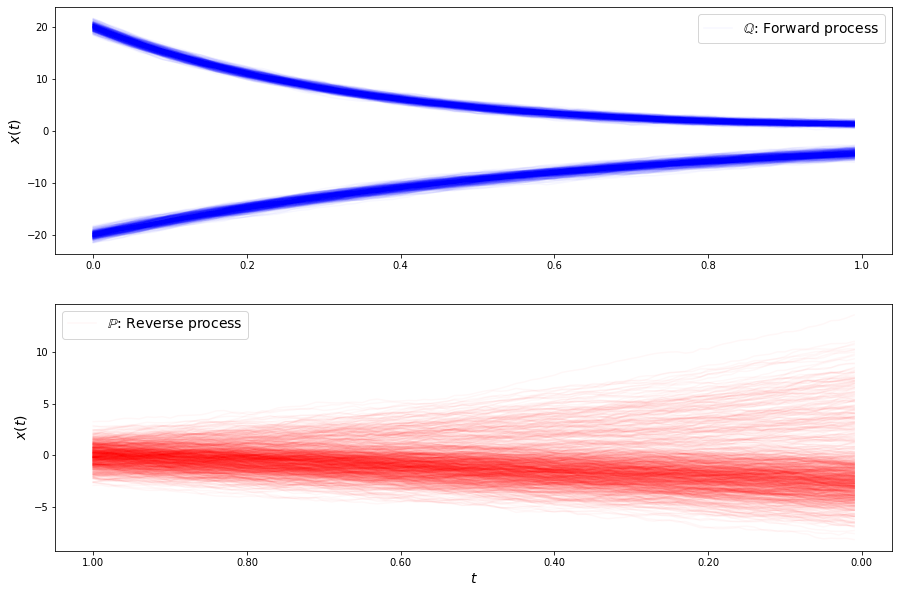

loss b 99.17088282817106
loss b 98.51245146814992
loss b 98.44576984810318
loss b 99.08055107029277
loss b 99.19941327662148
loss b 98.59123091099306
loss b 98.99896176983077
loss b 99.16172393439992
loss b 99.12158612512168
loss b 98.58497654456636
loss b 98.00563717276289
loss b 98.83633861644668
loss b 98.72757258716881
loss b 99.23259321153432
loss b 98.99744746810698
loss b 99.91247556203598
loss b 99.73184381395362
loss b 98.96622465229426
loss b 98.49073557751359
loss b 99.23482561420491
loss b 98.54757119692391
loss b 98.47076283295533
loss b 99.42468804594027
loss b 98.15066785939025
loss b 98.59946983485065
loss b 98.66135166842956
loss b 99.5820383427824
loss b 99.05197214859224
loss b 99.92156869773721
loss b 99.37227889707925
loss f 91.09850921872449
loss f 91.54557691429434
loss f 91.26787776805008
loss f 91.56176355003485
loss f 91.00271077067795
loss f 90.71345845426353
loss f 90.41420375469944
loss f 90.10378912795143
loss f 89.86932293197853
loss f 89.7587512293477
lo

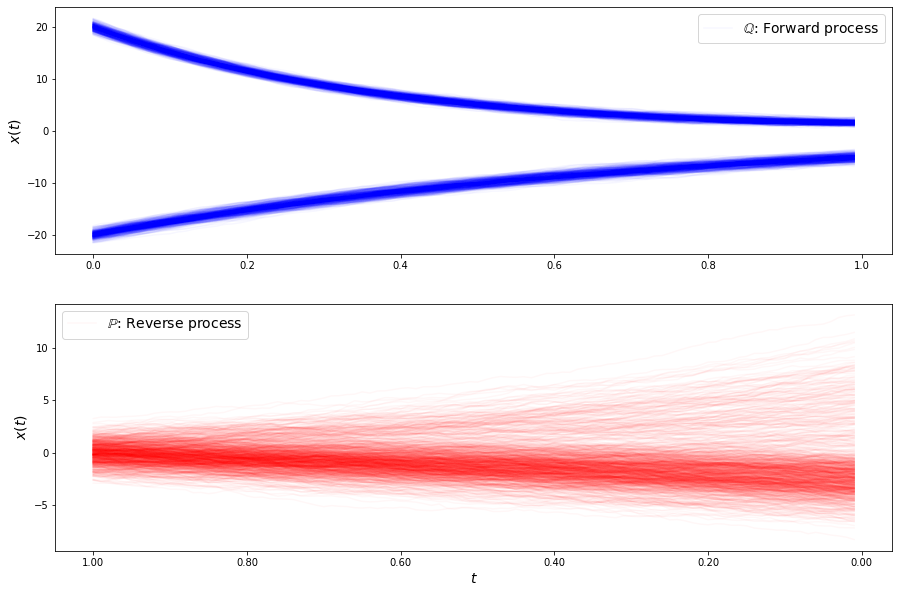

loss b 98.73657368052461
loss b 98.61382159083026
loss b 99.0094603485877
loss b 97.6527862737566
loss b 98.34565652193915
loss b 98.44995129177713
loss b 98.25013615057044
loss b 98.61118744215767
loss b 98.7699351385478
loss b 97.81201919484629
loss b 98.2301473645125
loss b 98.46219080475224
loss b 98.24935271652507
loss b 98.72872851186044
loss b 97.59581122261118
loss b 98.13800149687859
loss b 98.22036339012419
loss b 98.82817935793513
loss b 98.51997242989687
loss b 97.01633838402726
loss b 98.78628443900793
loss b 99.06046169438076
loss b 97.63754622416971
loss b 98.42840779256147
loss b 97.80179271899297
loss b 98.159900985818
loss b 97.62805311168191
loss b 98.23996486053247
loss b 97.77380702340218
loss b 98.38254276260537
loss f 86.28542558949627
loss f 86.65783514808739
loss f 85.9151596868437
loss f 87.27183669544817
loss f 85.8216268662572
loss f 85.56565162601768
loss f 87.37201299591675
loss f 86.36094793589484
loss f 86.77847092609184
loss f 86.13760732029904
loss f 8

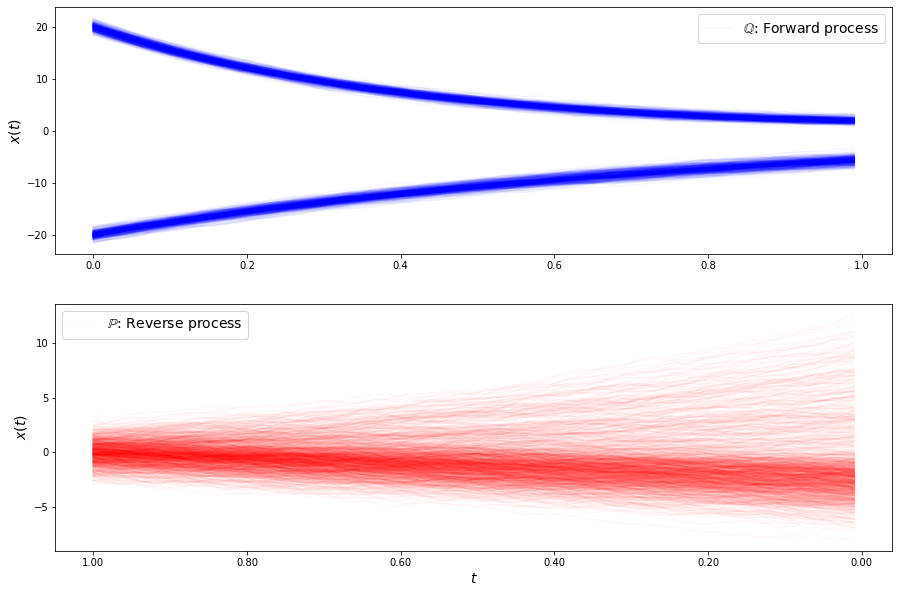

loss b 96.76269201032287
loss b 97.71287461956592
loss b 98.12406715837638
loss b 97.68296827376024
loss b 97.68130709696281
loss b 97.89191283262161
loss b 97.92061823383584
loss b 96.61662463635935
loss b 97.05743067390554
loss b 96.64304976700629
loss b 97.69014037547079
loss b 98.08326634866073
loss b 97.80636526723404
loss b 96.74558147192498
loss b 96.21048006443428
loss b 97.13508879321449
loss b 98.13019310256085
loss b 96.95905538689163
loss b 96.292618100909
loss b 96.8082623430279
loss b 98.06446279444279
loss b 96.4352645247269
loss b 96.22362203580082
loss b 97.15739058089113
loss b 96.49310289247762
loss b 95.97655851572789
loss b 95.92967736732055
loss b 96.15538274703145
loss b 96.04584147015474
loss b 96.76233099395267
loss f 84.88622660592404
loss f 84.04602406866044
loss f 83.68041124851673
loss f 84.397438851261
loss f 82.99153740591633
loss f 83.45246211535456
loss f 83.78618542351924
loss f 84.74004081913797
loss f 82.77990085938005
loss f 83.29430265060029
loss f

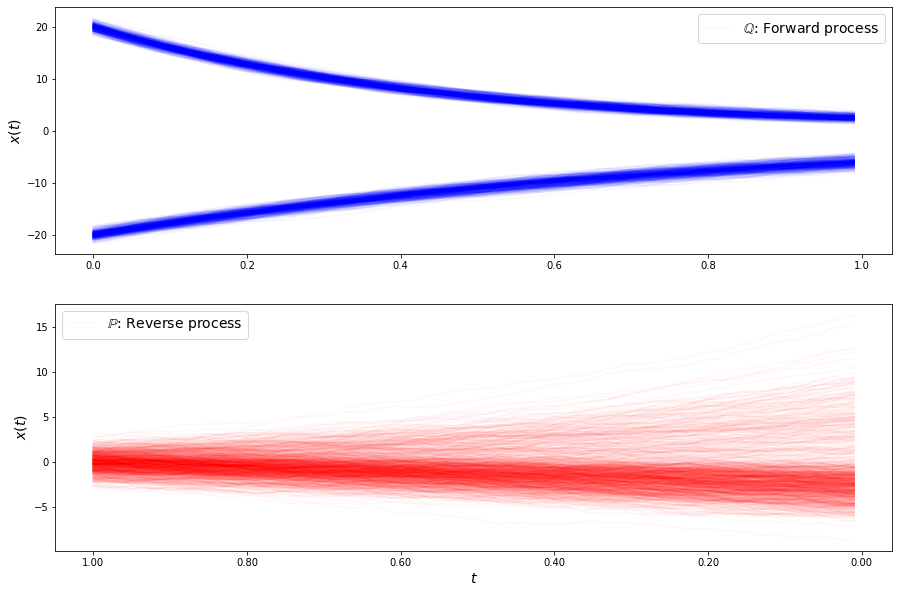

loss b 95.49579288138307
loss b 95.28409350781888
loss b 95.88153359548502
loss b 95.65773790414237
loss b 96.53020156374292
loss b 94.89155066258836
loss b 96.68066275842997
loss b 96.2248139604072
loss b 95.54458062991866
loss b 95.40698254329094
loss b 96.60373339746528
loss b 94.97605050548003
loss b 94.8310491255676
loss b 96.8433150296049
loss b 95.11688654219856
loss b 94.47382434719358
loss b 94.49307685366333
loss b 95.5057064471042
loss b 95.26194197324237
loss b 95.08734726689704
loss b 95.01686924532993
loss b 94.93154836294508
loss b 94.97322633933028
loss b 93.90338852241146
loss b 94.7338539901896
loss b 94.59110696097464
loss b 94.00254724114181
loss b 94.70693488440169
loss b 94.47318671472041
loss b 95.54404762148913
loss f 79.60569277322237
loss f 80.19597148164839
loss f 79.49278231058248
loss f 79.61277046040105
loss f 81.44334496827108
loss f 78.90965121184297
loss f 78.0827934413717
loss f 78.96986543210863
loss f 80.21000038128953
loss f 80.8376349491272
loss f 

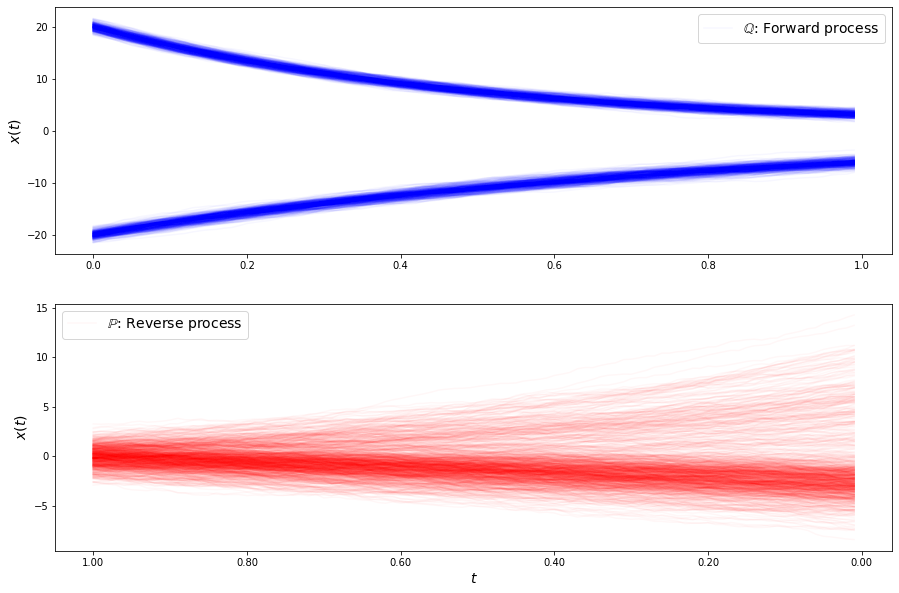

loss b 94.57956565532578
loss b 94.12579241977758
loss b 94.00940433967956
loss b 93.41188219101458
loss b 94.7077916329064
loss b 95.04587567143388
loss b 94.04893716836521
loss b 93.81750731989311
loss b 93.28524337400755
loss b 93.8478056823375
loss b 93.97308675183216
loss b 93.79189086967648
loss b 92.97387922861876
loss b 93.02687687921886
loss b 93.61162898196505
loss b 92.96103997297517
loss b 92.89029550749332
loss b 93.36668053264819
loss b 93.6128109811589
loss b 92.42883923765329
loss b 92.6037337209396
loss b 91.95228569814165
loss b 92.84784400998402
loss b 92.17140322814357
loss b 92.14702342161482
loss b 93.16111489242698
loss b 93.26326863188474
loss b 92.55086161590098
loss b 92.24694326207177
loss b 91.54974395439247
loss f 72.99273037090094
loss f 72.17530076405896
loss f 72.35938441064224
loss f 73.38880592273821
loss f 72.59109578801613
loss f 72.45691492871006
loss f 72.52156529527427
loss f 72.07818841977362
loss f 72.35201677604636
loss f 72.63945822631678
loss

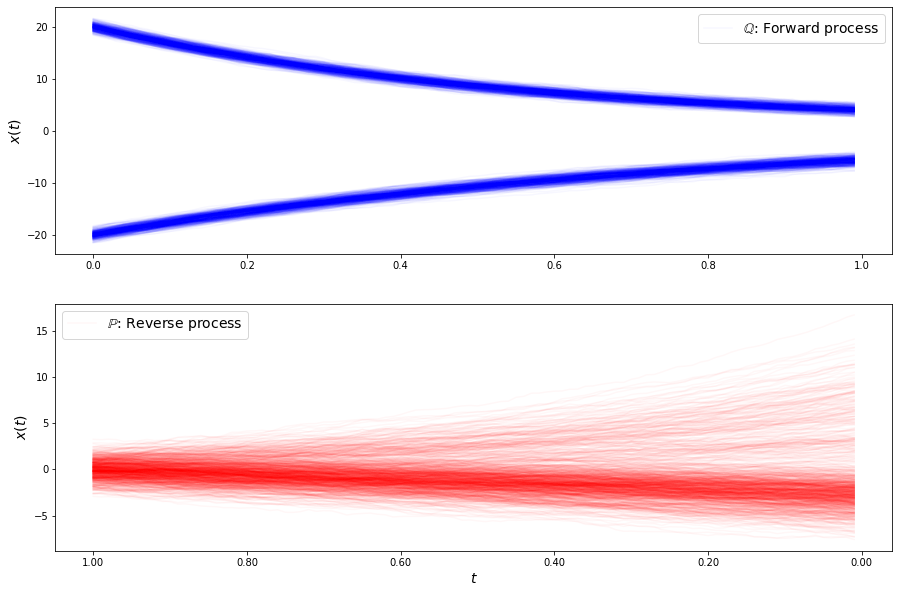

loss b 92.93869817439223
loss b 91.85795622115224
loss b 92.721559941211
loss b 92.50041970731807
loss b 91.88341435558354
loss b 91.22487672472069
loss b 91.04095147687143
loss b 92.08163051522807
loss b 91.97765526448799
loss b 92.00806399485157
loss b 91.08450206260696
loss b 91.88750340490081
loss b 91.07948165378146
loss b 90.73581901536573
loss b 92.59235332607619
loss b 90.62258007078886
loss b 90.5736063143101
loss b 90.89332156564392
loss b 91.70738049558098
loss b 90.90077223742607
loss b 91.49628862237924
loss b 90.97617244765813
loss b 90.46893210558387
loss b 90.64258055292876
loss b 90.39799688560484
loss b 90.22885207081893
loss b 90.60228837531385
loss b 90.97732167787743
loss b 90.18330592543661
loss b 91.33241657526767
loss f 69.7355759067824
loss f 67.9982182772781
loss f 69.98829032999956
loss f 68.5183727746545
loss f 68.53213504503161
loss f 68.53322792033153
loss f 68.70504969744738
loss f 68.86192564967742
loss f 70.20171090187776
loss f 68.71884265616181
loss f

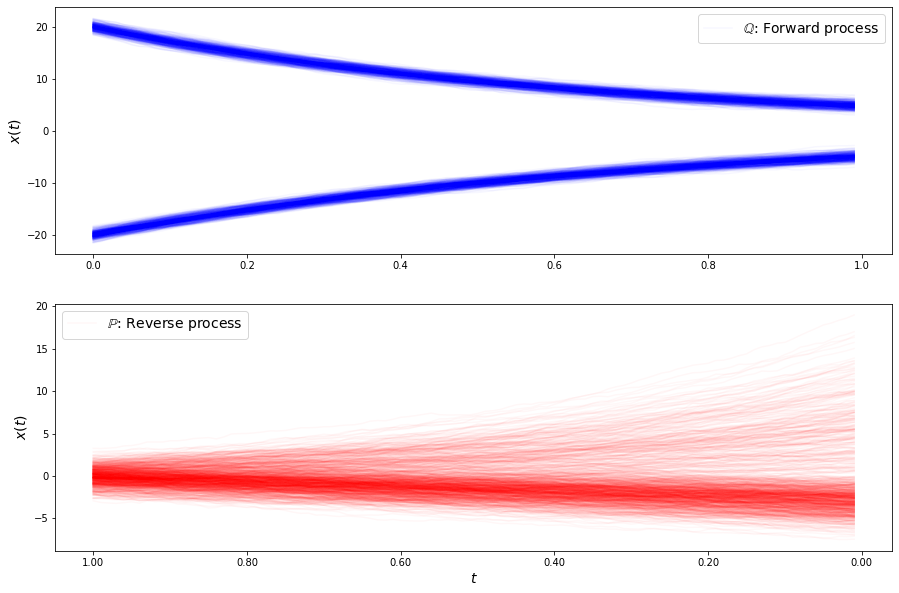

loss b 91.24727956263182
loss b 91.43798177576663
loss b 90.28393221692545
loss b 89.35554092302925
loss b 91.0861073122522
loss b 90.06984324634304
loss b 90.44719775246567
loss b 90.47045092976137
loss b 89.64753920121231
loss b 88.24611530949909
loss b 89.99635114562821
loss b 89.77749008827371
loss b 89.61015409097715
loss b 89.3710631706912
loss b 89.09872053426915
loss b 89.29313471897268
loss b 89.4972372285185
loss b 89.02467301243232
loss b 89.08880817224822
loss b 88.87406283359711
loss b 87.54251696359542
loss b 89.60396641005649
loss b 87.93091354362352
loss b 88.62443555386542
loss b 88.76290064020642
loss b 88.63194288464639
loss b 88.1591120716836
loss b 89.05973194700448
loss b 88.46898163456201
loss b 88.21585174628906
loss f 73.58799877765448
loss f 73.3000409877232
loss f 74.91277820195677
loss f 74.33377318067153
loss f 74.24434010671247
loss f 75.61022530409707
loss f 75.59998125080067
loss f 75.52486890452566
loss f 77.03515612213735
loss f 75.71720453325719
loss 

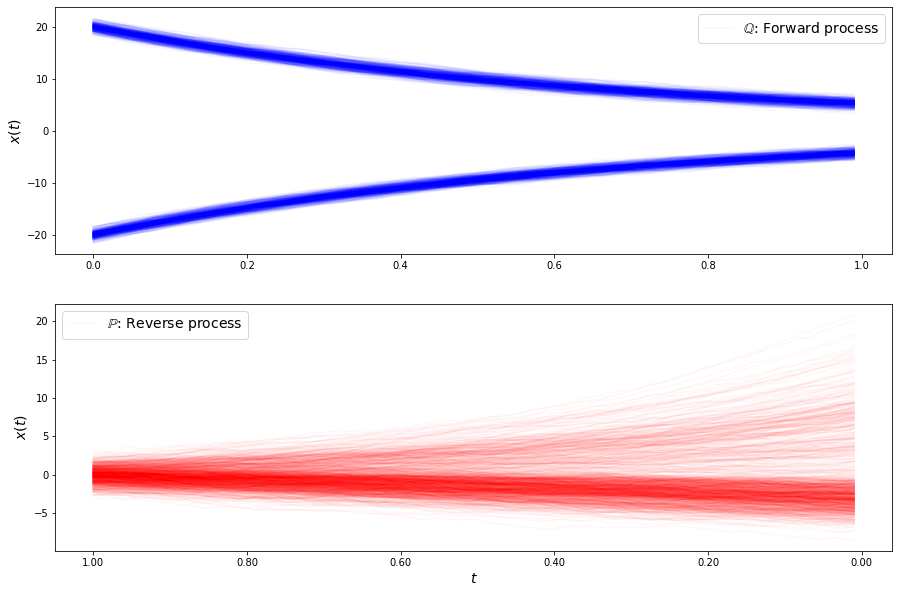

loss b 88.86355694465703
loss b 88.13924908427283
loss b 88.03882630708894
loss b 87.82276605335444
loss b 88.79105603515984
loss b 88.42939536220979
loss b 88.37003105694075
loss b 88.00493655719603
loss b 86.52933100261261
loss b 87.4901575494174
loss b 88.7824218008388
loss b 87.36508010449812
loss b 87.20537304759833
loss b 86.43480249983112
loss b 87.59034324659895
loss b 87.8767802766312
loss b 86.53809051187015
loss b 86.49786789011769
loss b 88.74632488753028
loss b 87.29327484146044
loss b 88.2182222029366
loss b 86.89385155629115
loss b 86.41192300745705
loss b 86.1193735790084
loss b 85.73394475385975
loss b 86.09901277502156
loss b 86.75627383637244
loss b 85.96377484220947
loss b 85.669906403726
loss b 86.29879667822715
loss f 81.53727238387216
loss f 82.28819436929844
loss f 82.5024711206424
loss f 82.72675537558447
loss f 82.87238832011282
loss f 82.44754793978598
loss f 81.5530304557133
loss f 83.14104111957342
loss f 81.80174430104576
loss f 82.52690869848712
loss f 82

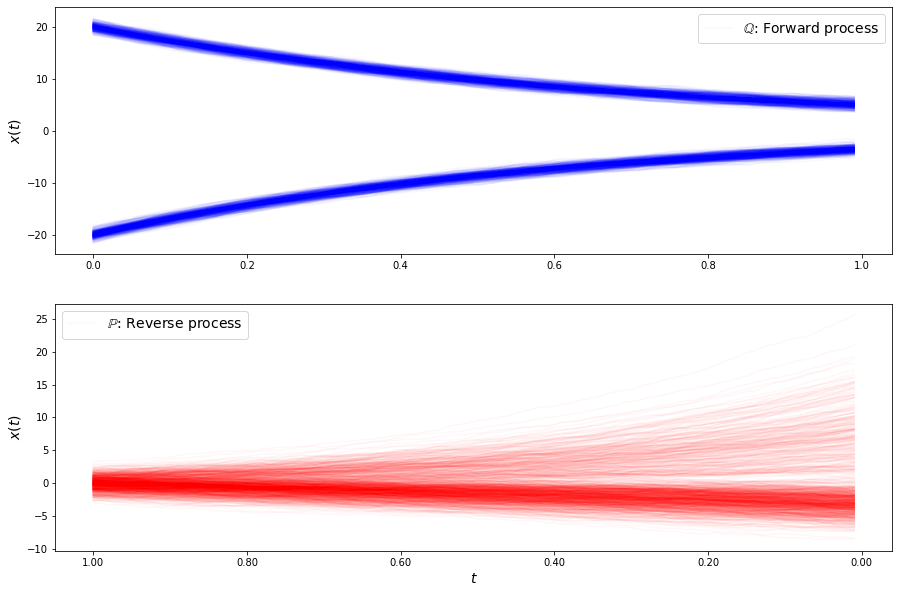

loss b 86.12469948780029
loss b 86.56228656270714
loss b 86.40453052752515
loss b 85.69303363924605
loss b 85.63618070575009
loss b 85.97716530837612
loss b 84.769075735224
loss b 86.28412874944205
loss b 85.46642945993638
loss b 85.39329761011508
loss b 85.660066182264
loss b 85.82210241843327
loss b 85.02244272032557
loss b 85.41862221950582
loss b 84.60578960248769
loss b 85.27662331640788
loss b 84.75842266157788
loss b 84.66958860393888
loss b 84.92903636205799
loss b 84.45034100706137
loss b 85.29080975285694
loss b 85.35056627773255
loss b 84.1115618906616
loss b 84.39430769510874
loss b 84.5652190859521
loss b 85.50904415541216
loss b 85.29471213559172
loss b 83.91511030317375
loss b 83.83527014933425
loss b 83.58673114437353
loss f 79.48373466901721
loss f 79.43397611313111
loss f 78.75158411252218
loss f 79.78777410812731
loss f 78.09526816073
loss f 78.23795578851754
loss f 76.67404536334794
loss f 78.17403203869063
loss f 76.2687758246537
loss f 76.31236870207925
loss f 75.

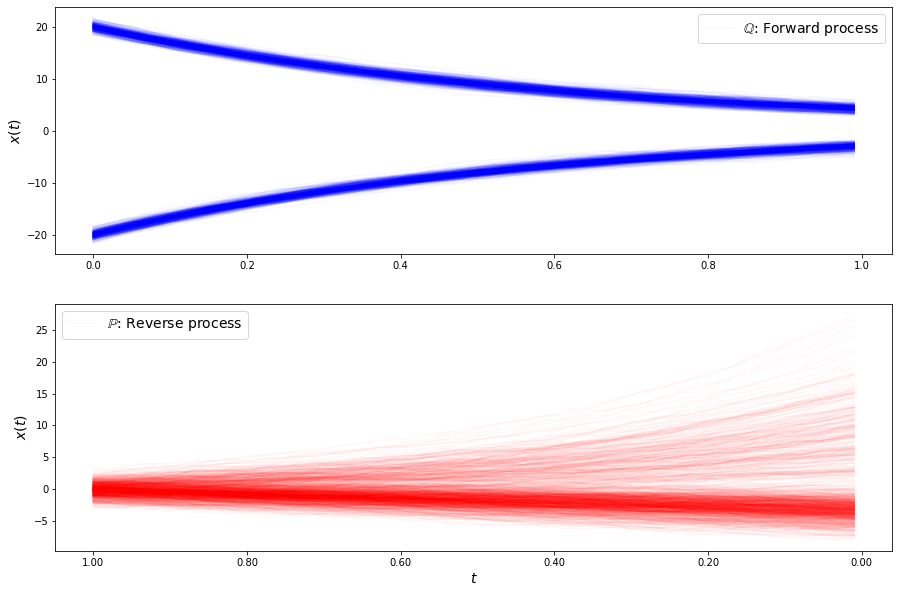

loss b 84.20218098108343
loss b 83.2729271485121
loss b 83.2003351116512
loss b 83.01427023089148
loss b 83.7190873878512
loss b 82.89023271692544
loss b 82.34404994410528
loss b 83.57951939170367
loss b 82.32402080765894
loss b 82.53714676742983
loss b 82.75506797607318
loss b 82.47894774978502
loss b 81.83065654408381
loss b 80.90826867680758
loss b 82.72427557192265
loss b 81.9799921702069
loss b 82.23985588735492
loss b 81.77331769014728
loss b 81.2960544800211
loss b 82.46283096317407
loss b 82.24000643598819
loss b 81.80995243823507
loss b 81.63055917010269
loss b 81.80008989602473
loss b 81.67626065183309
loss b 80.77546965807862
loss b 81.9164940670093
loss b 80.60803452728697
loss b 82.12994278394024
loss b 82.50896044358076
loss f 68.03654504670396
loss f 66.9532364297218
loss f 66.51521420014124
loss f 66.34407249794671
loss f 66.68561356647243
loss f 65.58168974978352
loss f 65.18626138512249
loss f 65.19100575635214
loss f 64.77483737201284
loss f 64.54667783414092
loss f 

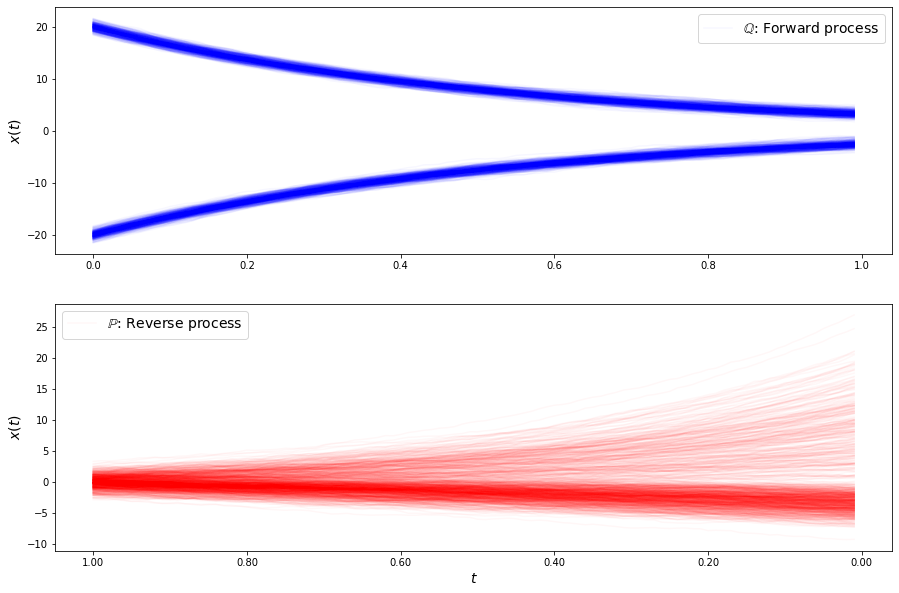

loss b 80.66630427016118
loss b 80.53972307739609
loss b 80.52163126515792
loss b 79.95848439475905
loss b 79.90367202299673
loss b 79.81623737343028
loss b 79.67518085266941
loss b 80.17402937290443
loss b 78.96610400385042
loss b 79.57284949764995
loss b 80.24899157418484
loss b 79.4740516246818
loss b 79.30150236138807
loss b 80.00281137658794
loss b 78.7882098062132
loss b 79.30494586446471
loss b 80.00508251303918
loss b 78.37243504196728
loss b 79.6850526710332
loss b 79.11368069528035
loss b 80.0342421929106
loss b 78.04403360396442
loss b 78.75005290778826
loss b 77.6547745052819
loss b 79.58760091554814
loss b 77.38738349248742
loss b 78.17821852425269
loss b 79.1650390573477
loss b 77.9902038953617
loss b 79.72489773685284
loss f 57.87552271413236
loss f 57.408650810352434
loss f 57.316665244799886
loss f 57.26757041768284
loss f 57.4280379884243
loss f 56.95309397108871
loss f 57.022558840665994
loss f 56.51864163744106
loss f 56.235603006171694
loss f 56.442615490589915
los

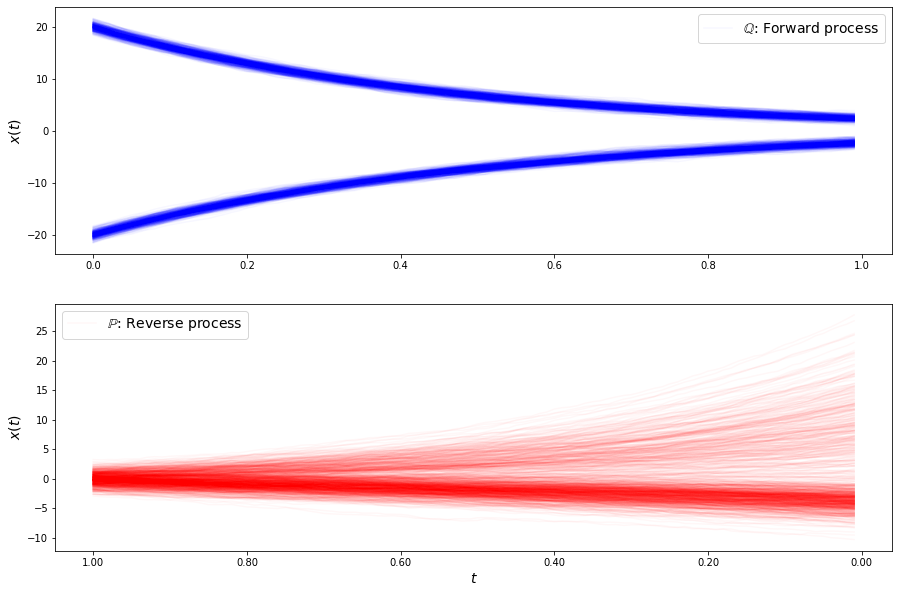

loss b 76.33879805719579
loss b 77.73538909741217
loss b 77.62768385991643
loss b 77.11712529707691
loss b 77.0828984310586
loss b 76.8700875379641
loss b 76.63132383640549
loss b 75.19593991381419
loss b 77.0866619310023
loss b 77.26965504946615
loss b 76.72841141064087
loss b 76.13878061223859
loss b 76.03098971119557
loss b 76.69610308335498
loss b 75.97301020221386
loss b 75.79646485729232
loss b 77.35026628804913
loss b 76.09137816211292
loss b 77.08036783385272
loss b 76.25313278816247
loss b 74.84028408874508
loss b 75.71326464569684
loss b 74.82889732347891
loss b 74.46094691576728
loss b 77.03486584123291
loss b 74.63198307631463
loss b 74.63013501590811
loss b 73.44818061951698
loss b 74.4339449636995
loss b 74.94262970214226
loss f 53.04986338042471
loss f 52.871949350415406
loss f 52.7959928211135
loss f 52.903443714524585
loss f 53.11872551868643
loss f 52.97632418685595
loss f 52.95487178843635
loss f 52.96937246714549
loss f 52.80415257177044
loss f 53.235617554968
loss 

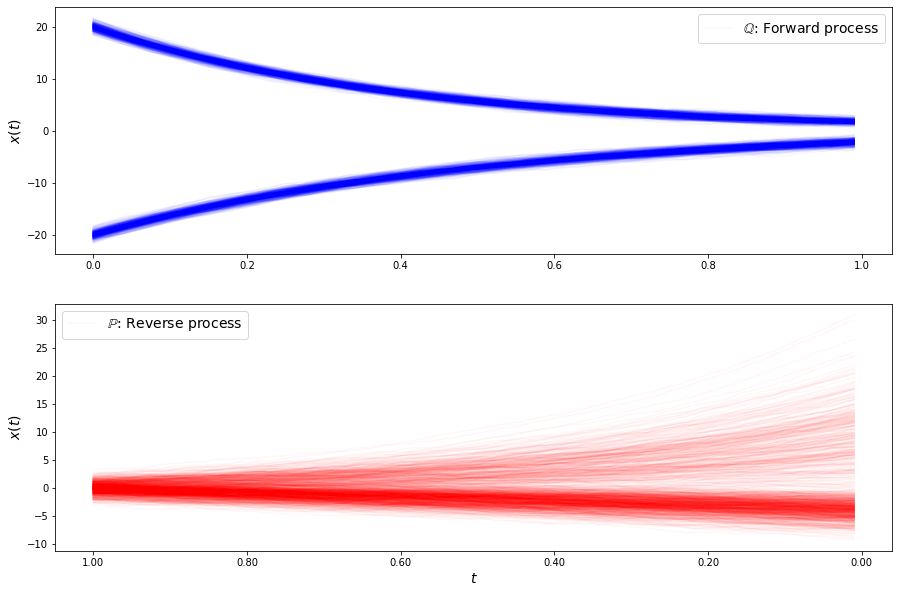

loss b 74.67937369007372
loss b 73.74018962132766
loss b 75.01101561826175
loss b 75.12163188702121
loss b 74.64415437703737
loss b 74.4273967102161
loss b 74.84267684010354
loss b 74.58392699160142
loss b 73.96826197947651
loss b 72.47196718105057
loss b 73.91933096158877
loss b 74.06212091177972
loss b 74.23927540699025
loss b 72.59554864482331
loss b 73.39320212097803
loss b 72.60921644368398
loss b 73.00764911879436
loss b 72.95368482559833
loss b 71.90670027186957
loss b 72.03285448577391
loss b 73.54628562250865
loss b 72.38171347520776
loss b 72.87947987229802
loss b 71.79706351413463
loss b 72.27673956591298
loss b 72.4978276301218
loss b 72.82441745896676
loss b 72.56078424527378
loss b 72.80121031107494
loss b 71.98550144486146
loss f 51.32754349004618
loss f 51.171956072454755
loss f 51.592721387940685
loss f 51.688524989630366
loss f 51.68171170716238
loss f 51.8881893684996
loss f 51.78350370226054
loss f 52.24513956686207
loss f 52.2412741022244
loss f 52.134697528069424


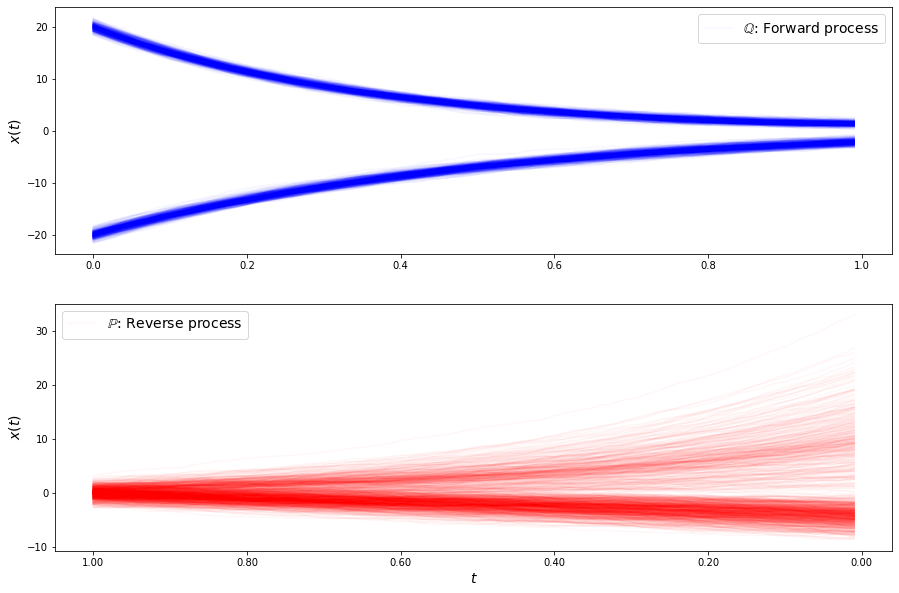

loss b 73.31509015888209
loss b 73.17450281785496
loss b 71.87695643766229
loss b 72.32216238949604
loss b 72.88109211534031
loss b 71.86098704605813
loss b 72.51208916110562
loss b 72.63126997889935
loss b 71.38727667839656
loss b 71.01747377849689
loss b 71.34153654653774
loss b 70.10040243682643
loss b 70.85220016275491
loss b 70.5566987512637
loss b 70.23559782300931
loss b 70.03297953903953
loss b 70.03995457747307
loss b 70.46000098473937
loss b 69.70533349336313
loss b 69.82881726427131
loss b 71.13273548646494
loss b 68.97728765052112
loss b 69.58581049419975
loss b 68.51044764836502
loss b 70.96197156494397
loss b 69.57805909306485
loss b 71.05034383580538
loss b 69.14995153321854
loss b 67.76938058939405
loss b 69.38936588285678
loss f 50.48232892554094
loss f 50.50897778142147
loss f 50.55659682028381
loss f 50.91449637073831
loss f 50.895083885107574
loss f 51.08543904669406
loss f 51.30061239750802
loss f 51.22286582112169
loss f 51.665191235614195
loss f 51.32169022823298

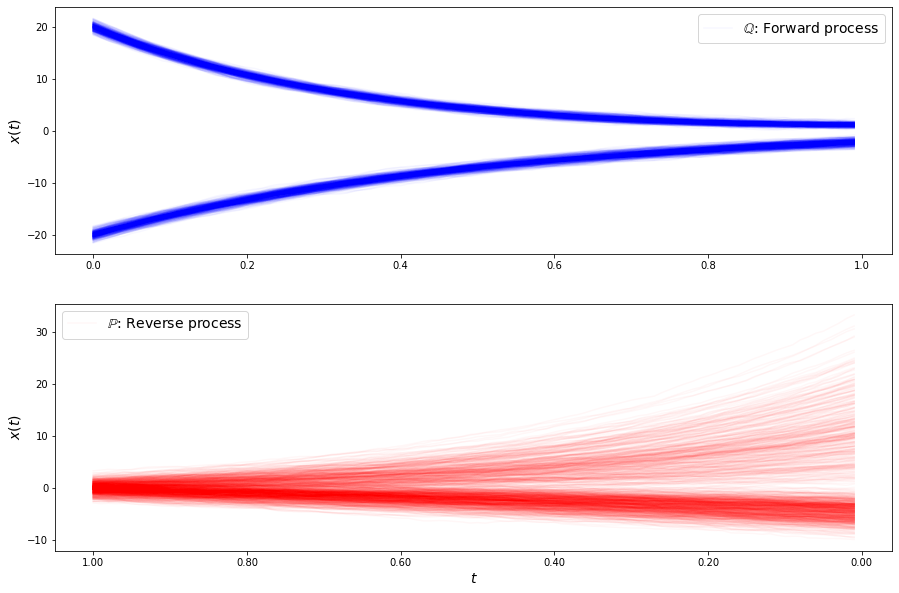

loss b 68.93283775929069
loss b 70.70962494287846
loss b 69.21858136302397
loss b 69.80678244457646
loss b 70.53471286235195
loss b 69.21441551557727
loss b 70.56767511333395
loss b 69.40378496587921
loss b 68.68648996540783
loss b 69.74801102347467
loss b 69.01202896917526
loss b 68.68418141393951
loss b 68.75929555746406
loss b 67.99157720891088
loss b 68.37989172541603
loss b 67.85260400647587
loss b 67.73065188434127
loss b 67.97490511403113
loss b 68.8032347443011
loss b 67.40308345622697
loss b 67.11439129627871
loss b 68.69543371836782
loss b 66.07851069626338
loss b 66.40313180506887
loss b 67.18260072069334
loss b 66.31321874967682
loss b 65.99352078691956
loss b 65.98893480610833
loss b 66.81908361133057
loss b 65.40315832673129
loss f 48.52552637408117
loss f 48.69529039245825
loss f 48.49852576935914
loss f 48.88678699408597
loss f 48.82754369709136
loss f 49.027541772101145
loss f 49.28959311330855
loss f 49.20437277729538
loss f 49.27414438464159
loss f 49.28106106039622


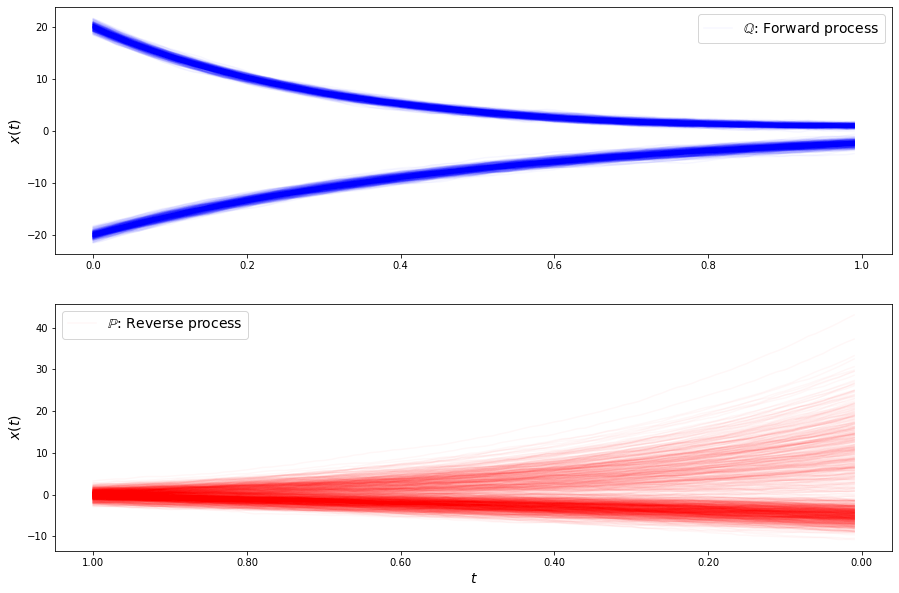

loss b 67.99793419833529
loss b 67.77223733451426
loss b 67.70951879886728
loss b 67.00349968625393
loss b 67.4304092663212
loss b 67.50860736719774
loss b 68.60116607915491
loss b 66.25644527843616
loss b 66.75289937152289
loss b 66.62140556226053
loss b 66.63976924067434
loss b 65.33505038513891
loss b 65.99892569636691
loss b 67.71907226920088
loss b 64.46011156534804
loss b 65.9118983006659
loss b 65.07665972103052
loss b 65.57116005981112
loss b 65.9164474639034
loss b 65.88137348188125
loss b 64.65842305650241
loss b 64.70071367685061
loss b 63.78303844623542
loss b 64.55784245238281
loss b 65.15929704100685
loss b 64.367344868686
loss b 62.744875712699375
loss b 63.342781115858195
loss b 63.72538708840939
loss b 62.51072393472945
loss f 44.56711467059244
loss f 44.68278202221038
loss f 44.987225130191035
loss f 45.08842423798029
loss f 44.910906071786066
loss f 45.00907020020609
loss f 45.15264425985165
loss f 45.16058532855356
loss f 45.29124318102226
loss f 45.10838107345129
l

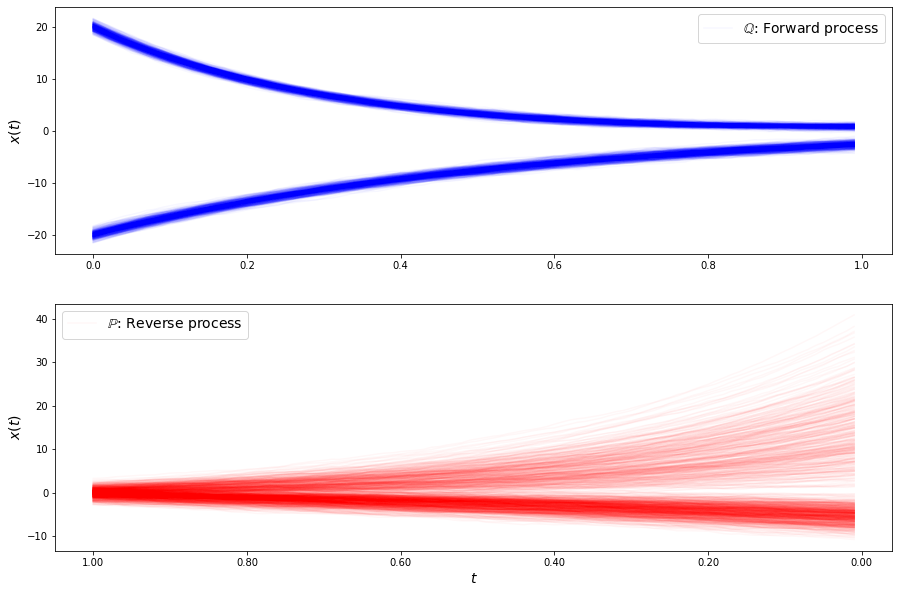

loss b 65.90359311966081
loss b 65.34750144531979
loss b 65.75742419691952
loss b 65.73814364115256
loss b 66.32698387268545
loss b 65.3674401527699
loss b 64.84330409659731
loss b 64.78961104741691
loss b 65.69728295543624
loss b 64.63647457060821
loss b 65.12090015839479
loss b 63.36258226679851
loss b 64.71496483929012
loss b 63.958545489390225
loss b 63.19270833363785
loss b 64.31502328810976
loss b 62.71708556051119
loss b 64.61424269435103
loss b 63.71451050382278
loss b 62.90660288976329
loss b 63.62381345639608
loss b 64.00560653198269
loss b 62.29702058981274
loss b 62.75731427675763
loss b 61.69180144751232
loss b 61.989410674340895
loss b 61.431130358974976
loss b 62.5050144174912
loss b 61.685076587321745
loss b 62.181784678645585
loss f 38.80874089026108
loss f 38.83195606732007
loss f 38.653618777257705
loss f 39.03701659282886
loss f 38.91069803816544
loss f 38.73583552421431
loss f 38.72441478047679
loss f 38.97895032163061
loss f 39.089498149690044
loss f 38.9684258376

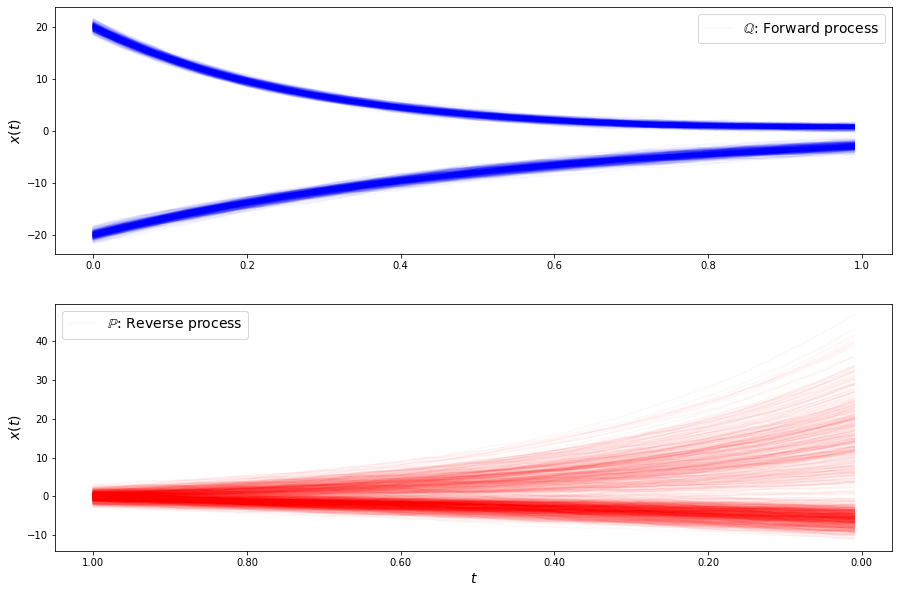

loss b 65.34401923698456
loss b 63.56824761468423
loss b 65.32703606142512
loss b 63.91164043515974
loss b 64.51933844376022
loss b 62.120559204276496
loss b 62.83448669539353
loss b 62.31520916616326
loss b 62.83071557220107
loss b 64.8571941235738
loss b 63.722924657249855
loss b 63.8066288461434
loss b 62.36780395066398
loss b 62.94695655108324
loss b 63.93357365969632
loss b 62.97592937208799
loss b 60.777955474558944
loss b 64.12504317880592
loss b 62.986523678379804
loss b 64.2520669007421
loss b 62.02823377395586
loss b 62.53393628634614
loss b 62.22292913144657
loss b 63.73155071191216
loss b 62.69970063438646
loss b 63.34174922301435
loss b 60.99239958539508
loss b 60.613397745890154
loss b 62.93285247805016
loss b 62.42660649843862
loss f 31.886611518419226
loss f 31.862389714898224
loss f 32.074980718635096
loss f 31.60603223287141
loss f 31.642891744449525
loss f 31.754623793214915
loss f 31.635982825619745
loss f 31.834466583124655
loss f 31.577562746988168
loss f 31.81744

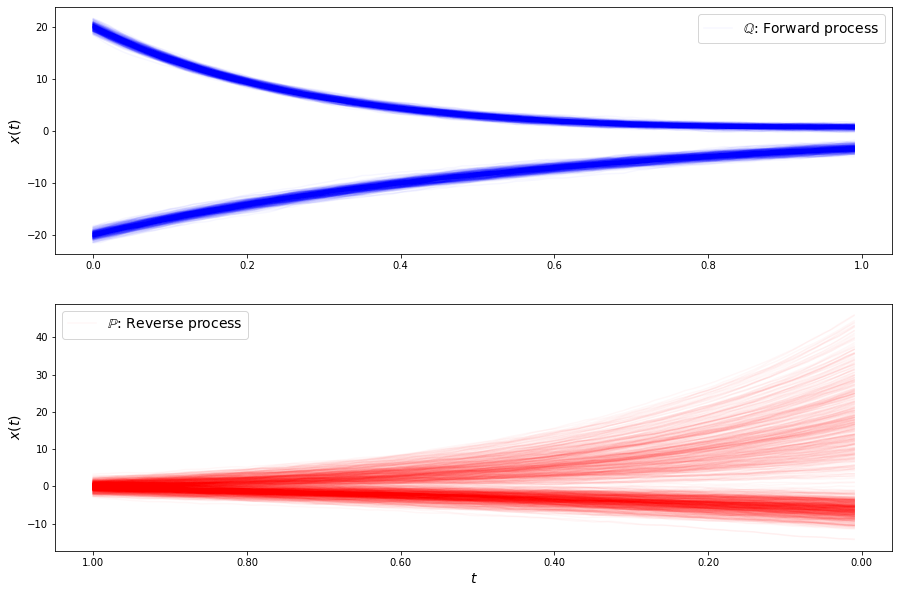

loss b 62.88794565130028
loss b 62.57762245588687
loss b 64.95584143383712
loss b 63.96886400451548
loss b 63.01975495478833
loss b 62.65548298100122
loss b 63.03402214506999
loss b 63.19473736115451
loss b 63.82354739361241
loss b 62.70128953279257
loss b 64.71334169690586
loss b 65.5813739780652
loss b 63.22625483660349
loss b 63.653826396760174
loss b 63.27750384608255
loss b 65.31929311459999
loss b 62.35334439072775
loss b 66.1539547555615
loss b 64.34505667468373
loss b 62.71204031024921
loss b 64.82898321599977
loss b 66.3046448795814
loss b 65.71957714932815
loss b 64.39276739229709
loss b 66.77829045647715
loss b 64.82057943841872
loss b 65.36789547930839
loss b 66.80386630513962
loss b 64.83614741249265
loss b 65.24911618727167
loss f 24.870144752309027
loss f 25.33844783200324
loss f 24.867183829117998
loss f 25.110924427811746
loss f 24.998146308527858
loss f 24.97525679103034
loss f 24.81281599868168
loss f 25.043481507712613
loss f 25.231804707780054
loss f 25.21124591357

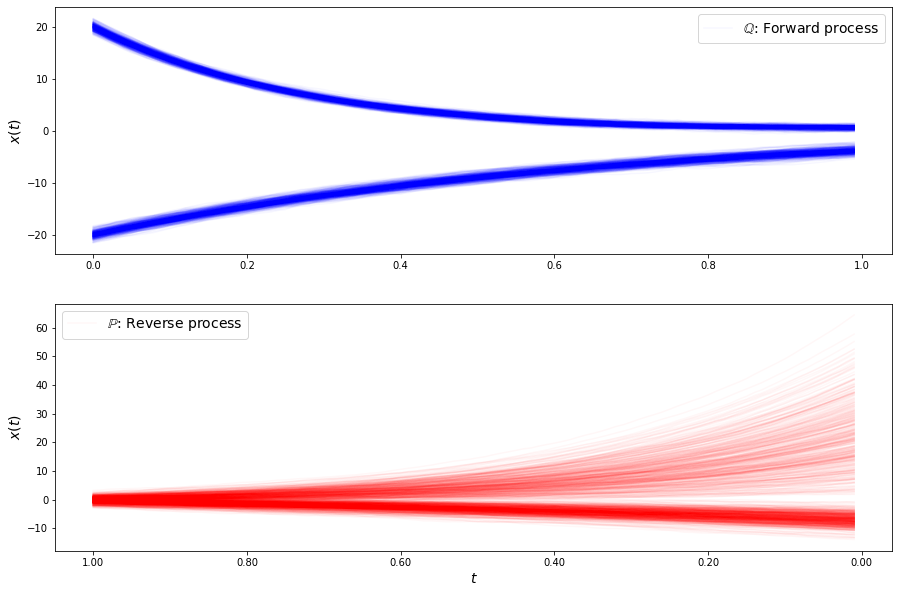

loss b 69.3154832465853
loss b 65.63445568035283
loss b 66.67485744289749
loss b 66.99627536854328
loss b 67.91171679218102
loss b 68.21364123185421
loss b 69.54296829049758
loss b 66.31444995472854
loss b 63.07019174182122
loss b 69.0079657448997
loss b 67.56851356305216
loss b 70.42647057884176
loss b 72.10076664595859
loss b 67.69886301076087
loss b 67.96703274830234
loss b 69.69763450591812
loss b 71.08992062364804
loss b 68.77539970255361
loss b 71.54230819742796
loss b 67.72141397820715
loss b 71.24347598177152
loss b 70.04099705873504
loss b 72.08126015849817
loss b 73.15337860069359
loss b 71.18236119727526
loss b 72.5229934500381
loss b 74.78648786435922
loss b 70.43655276138226
loss b 71.45882803341557
loss b 76.63346484984207
loss f 20.47598906073077
loss f 21.045761020177295
loss f 20.777940190676745
loss f 20.862608644958815
loss f 20.50981369511898
loss f 20.962337958685488
loss f 20.957673268368644
loss f 20.720398735258545
loss f 21.545958665458535
loss f 20.92744146575

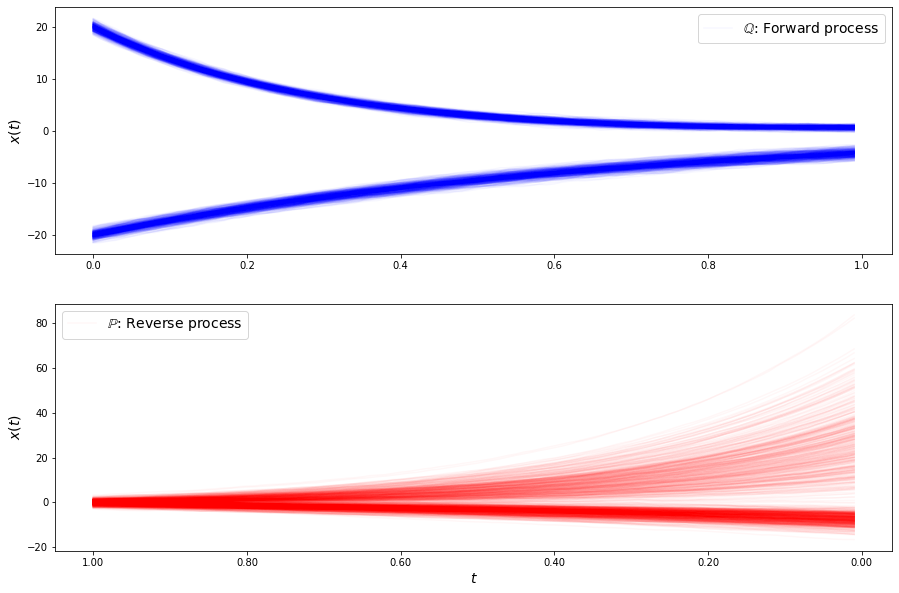

loss b 72.13926755779289
loss b 73.68634726182111
loss b 72.25752438139462
loss b 74.10860153469817
loss b 77.19830191789457
loss b 74.42415369996009
loss b 72.19487214264932
loss b 73.7225074111157
loss b 76.87013635489494
loss b 74.6161310710991
loss b 80.93026296772392
loss b 80.6167298069001
loss b 77.40780560615472
loss b 76.83901289060415
loss b 79.35140688002771
loss b 77.26289832757537
loss b 75.05371232009838
loss b 79.73677040858537
loss b 78.86409307919672
loss b 74.10238391265854
loss b 76.97751251551209
loss b 82.01489286073684
loss b 81.04824121771881
loss b 80.35237732651923
loss b 76.58948123358499
loss b 74.90592903810114
loss b 86.2796466224796
loss b 81.6683511700994
loss b 87.9973755208671
loss b 83.67620287308681
loss f 20.12107391059849
loss f 19.731172948010745
loss f 20.492867970204976
loss f 19.895628398013134
loss f 20.964440273257978
loss f 20.546206752123737
loss f 20.779973983446126
loss f 20.650779573956918
loss f 21.008779557095988
loss f 21.1843417344594

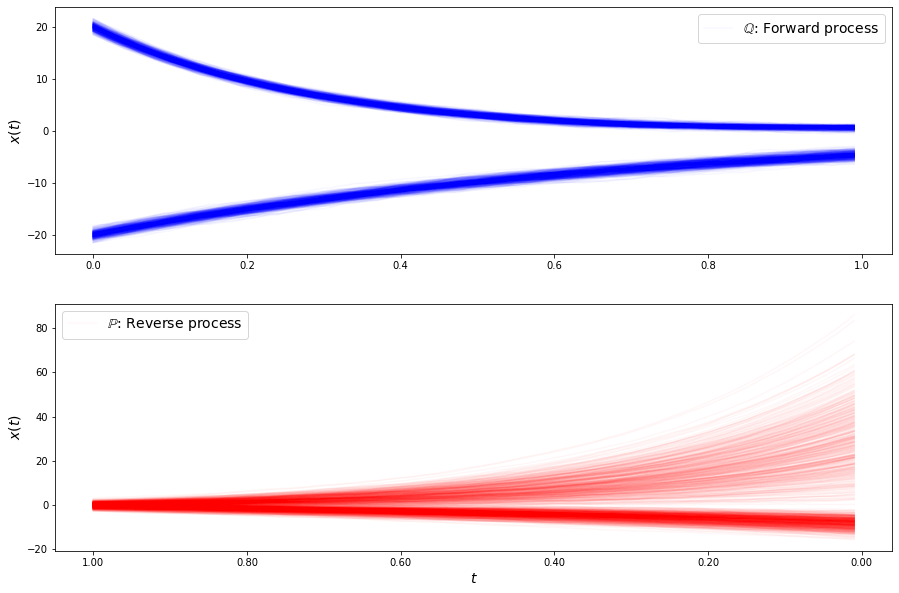

loss b 80.79786811343229
loss b 82.34991718445987
loss b 79.74982893944532
loss b 83.2023573948883
loss b 79.52074492235587
loss b 82.4096118217042
loss b 85.18935250340772
loss b 79.35673980867944
loss b 83.05779848687179
loss b 81.88611181490619
loss b 84.47994721240512
loss b 79.61364894321518
loss b 82.38092044623345
loss b 81.24227237591843
loss b 84.59092683363048
loss b 77.98906687739327
loss b 80.52333820388591
loss b 79.19588318520074
loss b 83.97479917744005
loss b 83.31538733760138
loss b 80.9235114757165
loss b 85.05173648267348
loss b 85.10035822482003
loss b 82.24690009677342
loss b 82.14751294847225
loss b 81.61295891527543
loss b 78.36283098599709
loss b 85.26435715239023
loss b 82.5480328675814
loss b 78.49959270093863
loss f 22.346343913141332
loss f 23.159137559071887
loss f 22.428652874705588
loss f 23.014709032581877
loss f 22.54555563806741
loss f 23.546967488466173
loss f 23.29100737511003
loss f 22.964463633070093
loss f 23.884816210753886
loss f 23.874670780763

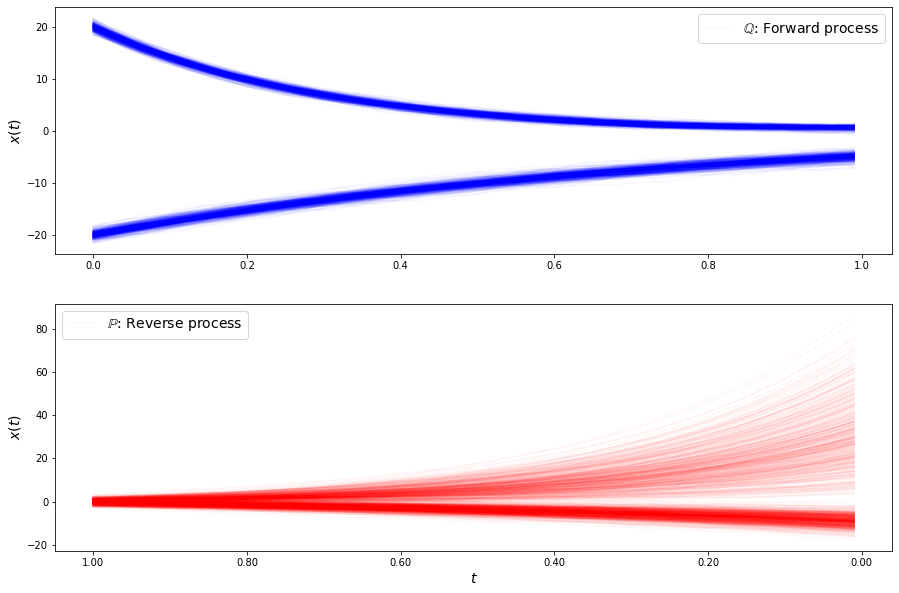

loss b 82.87328660560942
loss b 78.03965454963345
loss b 78.10712450046617
loss b 77.05239246145625
loss b 79.0657738462477
loss b 76.68682324451326
loss b 74.51495554944084
loss b 78.17861304227858
loss b 76.5029139850806
loss b 77.386036267102
loss b 73.42570487361061
loss b 73.12898301361164
loss b 71.13821872697847
loss b 73.89366218828478
loss b 71.59718590809635
loss b 67.94396556427371
loss b 73.34054699903788
loss b 73.33738608372568
loss b 70.57093675519224
loss b 70.66493003854195
loss b 68.09785450402734
loss b 68.64280601191474
loss b 67.28749493193
loss b 69.1837004078934
loss b 67.26455274844379
loss b 65.91574022266248
loss b 64.80995614167973
loss b 66.29342399341839
loss b 63.88176357914711
loss b 59.8609101507281
loss f 26.24073283535937
loss f 27.39671310555666
loss f 25.62605489636387
loss f 26.7375902790258
loss f 27.094749021627457
loss f 26.828637897051298
loss f 26.04566423578606
loss f 26.623633324099355
loss f 26.587263284080933
loss f 26.732386128717067
loss 

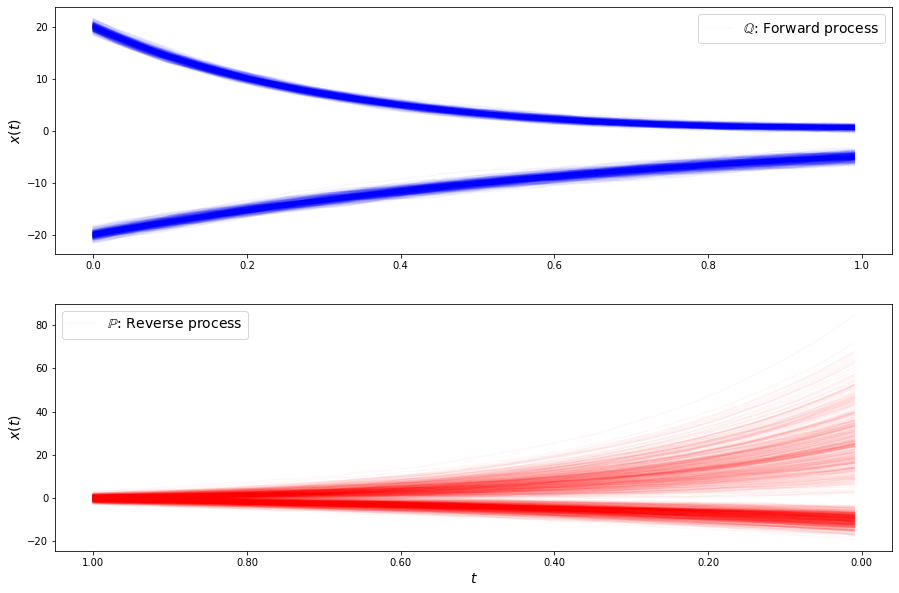

loss b 65.016594288423
loss b 58.24316410346588
loss b 61.19685558863142
loss b 59.81588219416918
loss b 51.97509460753395
loss b 57.46709677699589
loss b 58.27350116084106
loss b 55.90553012075351
loss b 54.377975924853274
loss b 58.50252687426531
loss b 55.81437754971341
loss b 55.0148526031922
loss b 53.87341542950487
loss b 53.02114628169139
loss b 49.99923381403987
loss b 51.53312927439618
loss b 51.63764263164522
loss b 50.26830943212987
loss b 50.81066427053411
loss b 47.81748534584136
loss b 50.790009031186486
loss b 48.75089580845047
loss b 48.233259597211465
loss b 47.0582899902493
loss b 45.42189109912968
loss b 46.81257395215757
loss b 45.43614001387341
loss b 46.901133941204584
loss b 47.385465681865085
loss b 44.53482873221293
loss f 28.943032082862615
loss f 28.505026434437305
loss f 28.219894437004484
loss f 27.803192616332506
loss f 27.817996549801748
loss f 27.71085342624084
loss f 28.066441780689665
loss f 27.27576003228517
loss f 26.80814150767037
loss f 27.92017049

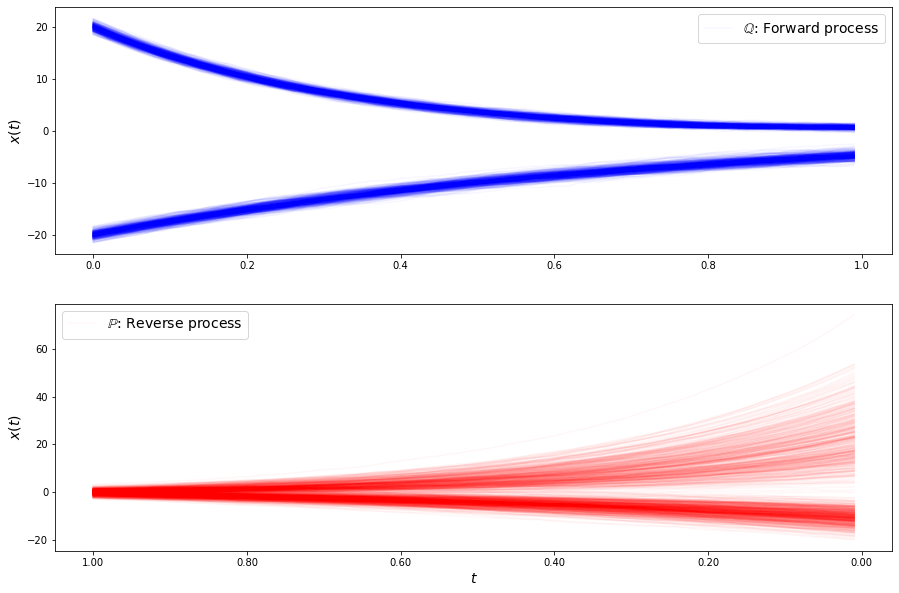

loss b 41.719160376114765
loss b 42.49579303675095
loss b 42.449039346090125
loss b 43.33309103291279
loss b 42.70023891162963
loss b 42.21435329888877
loss b 43.84680236743987
loss b 42.39598079963847
loss b 39.68365503428464
loss b 37.69089470224402
loss b 40.6674455083936
loss b 41.031634812361425
loss b 39.41942423376054
loss b 40.84390867829714
loss b 38.2082634271778
loss b 39.470544136074444
loss b 37.525148008879015
loss b 38.45318587861827
loss b 38.933778840574725
loss b 36.14032052843461
loss b 36.9331789811127
loss b 37.668127685240805
loss b 34.72783632018713
loss b 38.61263328961241
loss b 36.99567934198608
loss b 36.89244146309402
loss b 36.566275050847445
loss b 36.514575328818694
loss b 35.01908360249202
loss b 37.34012673728667
loss f 27.11668286870299
loss f 26.8266805589139
loss f 26.07551204155219
loss f 26.675481188983277
loss f 25.18808285407767
loss f 25.925655274071353
loss f 25.635936338849078
loss f 25.312780196243647
loss f 24.51583068805743
loss f 24.832811

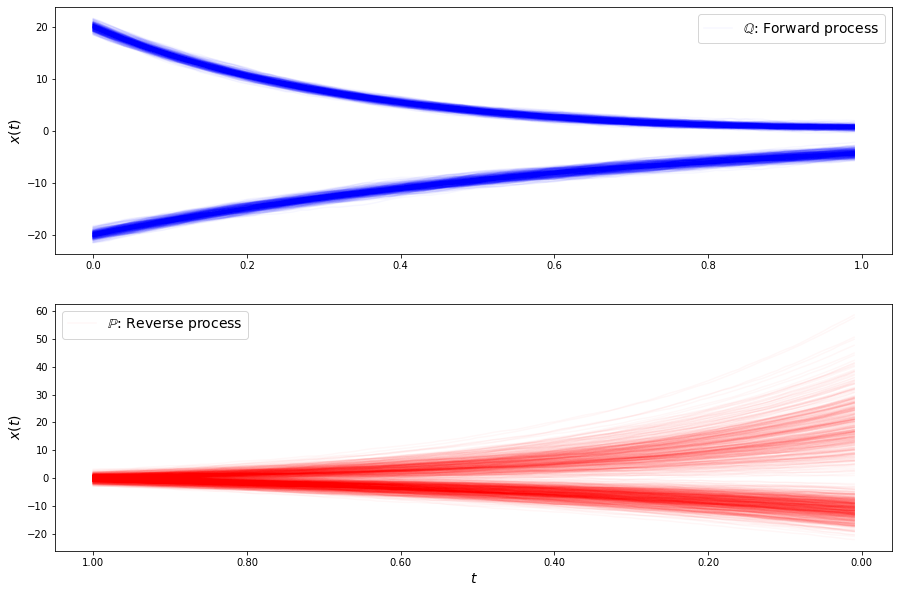

loss b 34.51133270781821
loss b 33.776398935996774
loss b 33.70015149826316
loss b 33.74107442055544
loss b 33.07835909625712
loss b 32.0559769885857
loss b 31.914540162600524
loss b 32.829867662338934
loss b 32.23555717331289
loss b 33.442705035519246
loss b 31.476141359906553
loss b 31.79362021456687
loss b 33.430758655568034
loss b 30.99035023979323
loss b 31.782564924778
loss b 32.83753343380294
loss b 31.528828237812835
loss b 32.94745080662744
loss b 30.461957907099343
loss b 29.603397436205174
loss b 31.35413947933614
loss b 31.28491136592858
loss b 30.710886991710908
loss b 30.940923379935217
loss b 31.619453898072823
loss b 32.146325928116525
loss b 31.416512975399385
loss b 30.781281823917244
loss b 32.35821426966728
loss b 30.526450536794513
loss f 23.073773687742207
loss f 22.751346315776054
loss f 22.614378450954522
loss f 22.2236739072998
loss f 21.65155229162975
loss f 21.84913800196628
loss f 20.330207951317984
loss f 20.498924141214594
loss f 20.34184297621548
loss f 2

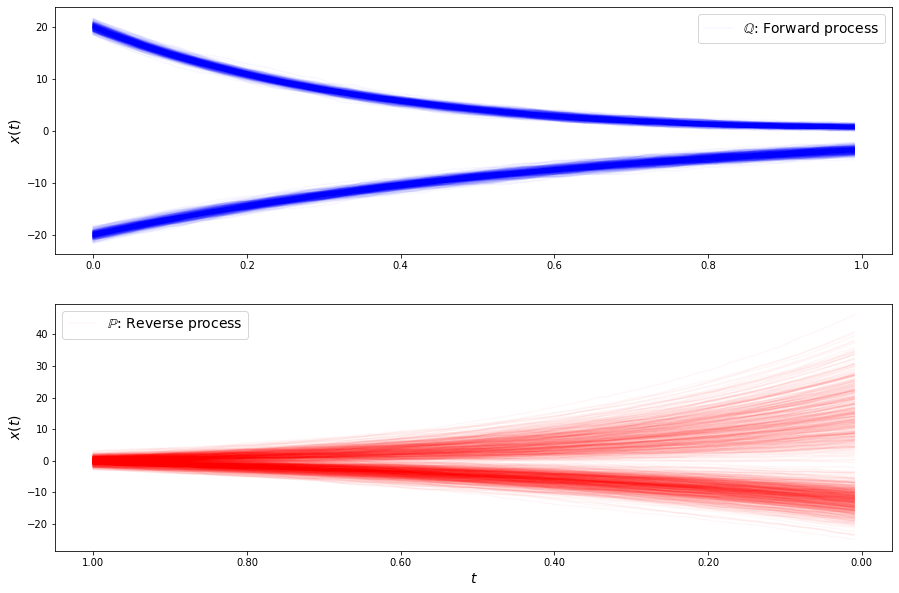

loss b 28.36168206231727
loss b 27.404521282286467
loss b 28.030670738096667
loss b 28.107131576152334
loss b 28.067097130680956
loss b 27.499035113499357
loss b 27.703519867268017
loss b 28.342559781372366
loss b 28.436358998569126
loss b 28.394432381254013
loss b 29.06558948958569
loss b 28.9120557326622
loss b 28.17608088635264
loss b 28.307963181901037
loss b 27.864549531892948
loss b 28.303520606706567
loss b 28.351670701026183
loss b 27.92846423289772
loss b 28.142371364086678
loss b 28.467141167875827
loss b 26.999395410538387
loss b 28.006749130084255
loss b 27.50536070499959
loss b 28.898534288611074
loss b 29.03036283491775
loss b 27.878643832747315
loss b 27.81920995465144
loss b 28.754741450843603
loss b 29.49671999375946
loss b 27.553455463658704
loss f 18.154393709526193
loss f 17.850137525504767
loss f 17.362863277230392
loss f 17.39738209821614
loss f 17.312719411973184
loss f 16.865286885273562
loss f 16.671150355127974
loss f 16.244971691619984
loss f 16.0032549771053

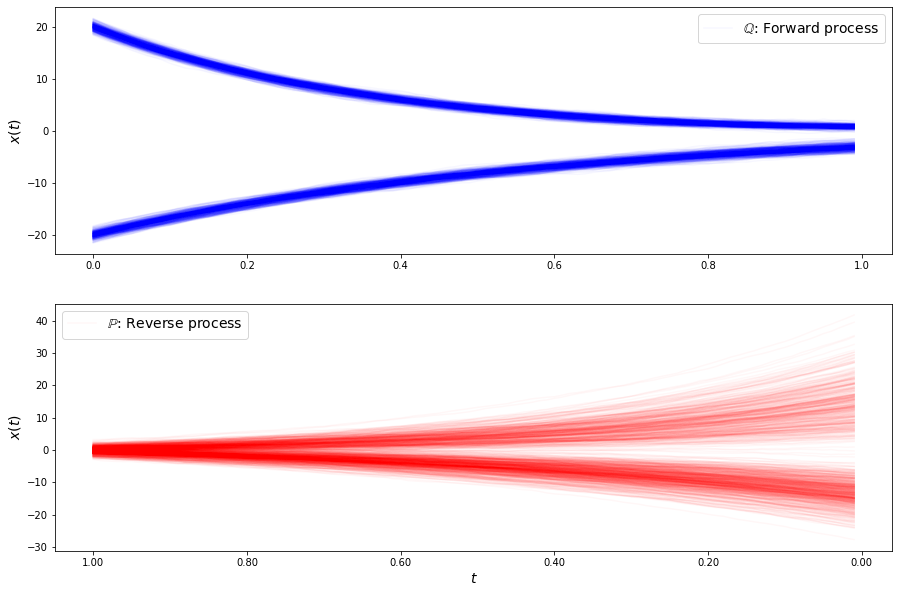

loss b 25.566814926446973
loss b 25.97731671948939
loss b 25.853457960645315
loss b 26.312155512825736
loss b 25.90368866419546
loss b 25.794358425463848
loss b 25.06998220079395
loss b 25.11941360968135
loss b 25.479311072791006
loss b 24.45299620936798
loss b 26.30351087072263
loss b 26.16781836276271
loss b 25.10754098786644
loss b 26.122148204351028
loss b 24.906107267369908
loss b 25.600798889996433
loss b 25.955930177397306
loss b 26.495734745396277
loss b 25.685476234623753
loss b 25.456142559775078
loss b 25.528483930592024
loss b 25.133281644695327
loss b 25.55589820060769
loss b 25.452592724420278
loss b 25.398459338762724
loss b 25.690957877610845
loss b 25.861013083077754
loss b 26.07772174308879
loss b 25.509836711851765
loss b 25.962499878486422
loss f 14.76997805874862
loss f 14.143652109440083
loss f 14.059384497682444
loss f 14.01085110221677
loss f 13.76407243966183
loss f 13.479912807972779
loss f 13.121813261040568
loss f 13.087652436595345
loss f 12.90053604347438


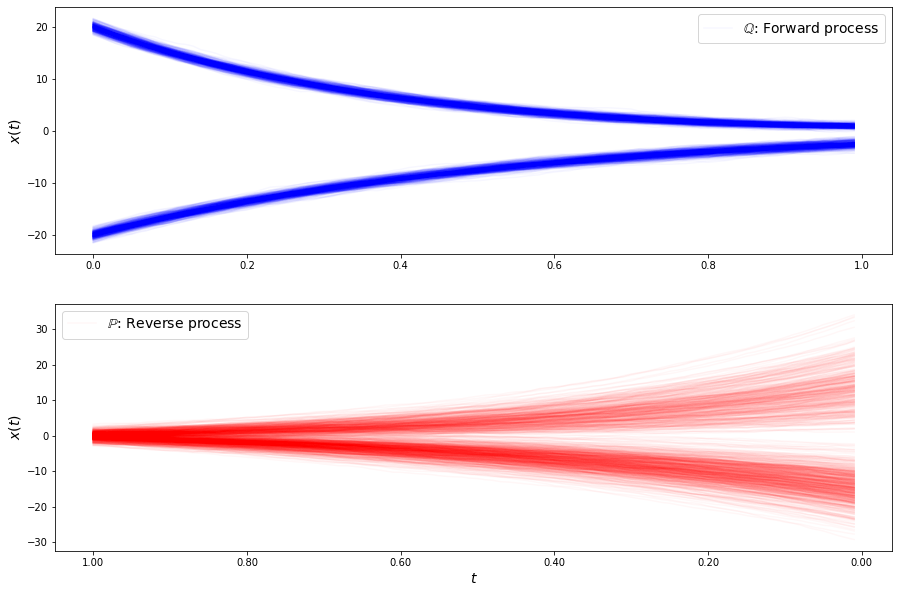

loss b 23.56883596022278
loss b 23.324277521736366
loss b 24.188728590010207
loss b 24.82258469839101
loss b 23.14101062304862
loss b 22.863238663449728
loss b 24.102226788127282
loss b 22.88282751562601
loss b 22.79668002719295
loss b 22.766584324403226
loss b 24.550122422641742
loss b 24.10784340672941
loss b 23.940921081252707
loss b 22.400383657743394
loss b 23.255644184436964
loss b 23.302363892221262
loss b 24.77147697261115
loss b 23.44306683494917
loss b 23.66514676566247
loss b 23.887446323636983
loss b 24.429189448586765
loss b 24.466124214955396
loss b 23.520447568254
loss b 24.236736253507623
loss b 24.21013335275593
loss b 23.41754844606734
loss b 23.472135140964266
loss b 24.742096960180405
loss b 24.758842831299933
loss b 23.921337295539818
loss f 11.814693230545442
loss f 11.759667904921386
loss f 11.623188808402391
loss f 11.358195994550663
loss f 11.186047561747857
loss f 11.182547210324548
loss f 10.848729644585362
loss f 10.75175332190699
loss f 10.666242482728675
l

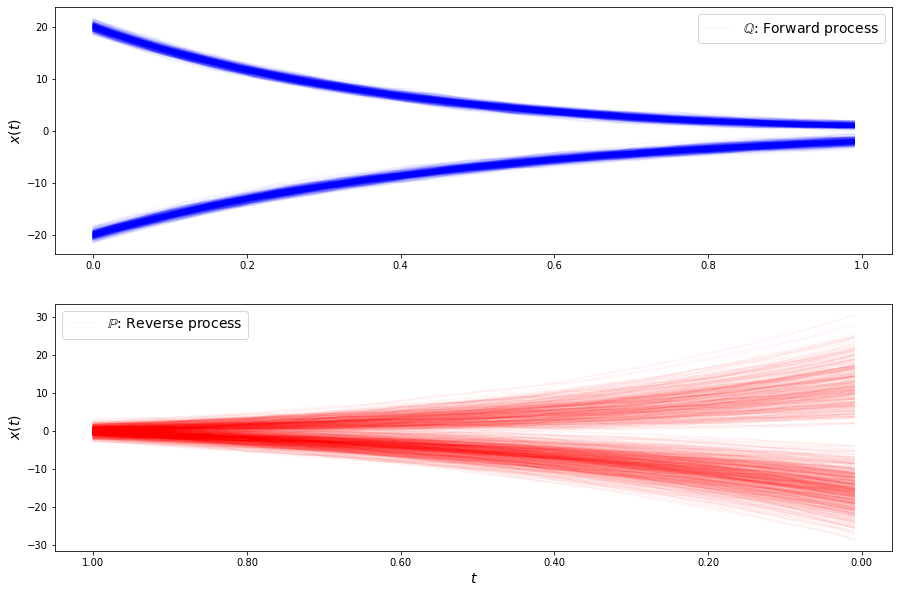

loss b 22.04605452503441
loss b 22.09835620239701
loss b 22.944955825768588
loss b 22.557836479960226
loss b 22.106160324673393
loss b 21.735262530726636
loss b 21.434823627430465
loss b 21.328740786802943
loss b 22.42004797420196
loss b 23.39828283627499
loss b 22.37759486540211
loss b 23.2919892569043
loss b 21.915302202245112
loss b 21.983433930954327
loss b 23.09714991506095
loss b 22.872057661197907
loss b 22.38039883618261
loss b 22.142158831589096
loss b 22.147314036796008
loss b 22.28808089693689
loss b 21.85502435657529
loss b 22.136138019267698
loss b 23.14238365149401
loss b 22.33699968996112
loss b 23.186262656055593
loss b 23.145077799168426
loss b 22.609387693053645
loss b 22.545281955968385
loss b 22.49520850024876
loss b 22.4241271675927
loss f 9.930878542480018
loss f 9.819845289270345
loss f 9.749440406234957
loss f 9.646084184075203
loss f 9.472739988132645
loss f 9.416420803179628
loss f 9.33062332580332
loss f 9.147382980282789
loss f 9.07517105342195
loss f 9.0270

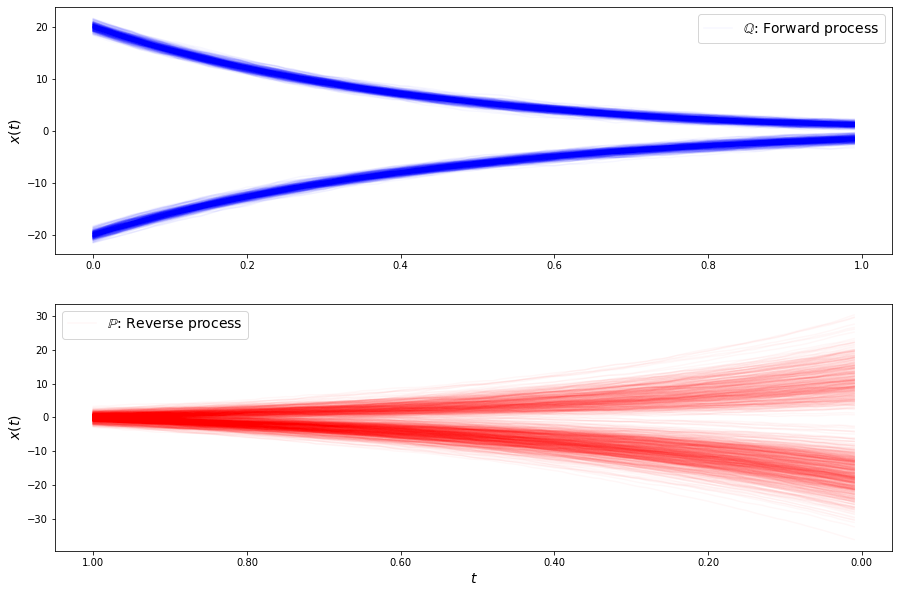

loss b 22.1871341656754
loss b 21.473102129949318
loss b 21.44349663787601
loss b 21.59076421264422
loss b 21.79238214634259
loss b 22.27859049089492
loss b 22.296804312691535
loss b 23.01704864550843
loss b 22.583785539179193
loss b 21.754605370322263
loss b 22.46982635927192
loss b 21.5378426470003
loss b 21.999292991431492
loss b 21.835609431896064
loss b 22.035960679312815
loss b 21.373825725336893
loss b 21.328802066765626
loss b 21.52544444903659
loss b 22.27149244386234
loss b 22.022413463133525
loss b 21.64037170188321
loss b 22.06509559088063
loss b 22.962351665339504
loss b 22.738855706487133
loss b 22.188748264634537
loss b 21.95270614884618
loss b 21.997478895210808
loss b 22.56581766765478
loss b 21.86252646825854
loss b 23.196118773531115
loss f 8.535764066664742
loss f 8.424905147965191
loss f 8.360108991014203
loss f 8.265210402060019
loss f 8.219886195446293
loss f 8.181825292178987
loss f 8.042361679303328
loss f 8.021083953425983
loss f 7.972647128856771
loss f 7.851

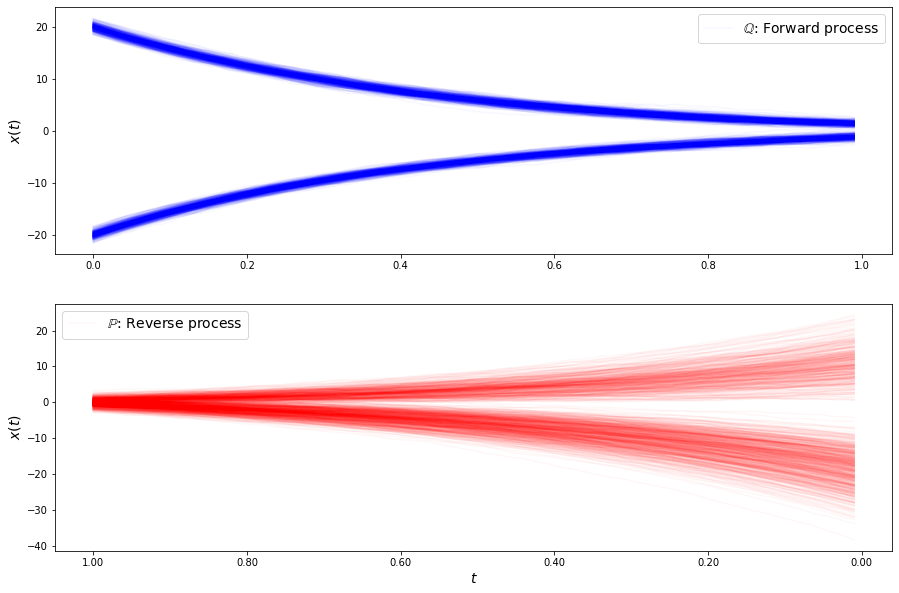

loss b 22.760172371801442
loss b 23.062824590624924
loss b 23.004511620429554
loss b 23.546199087575463
loss b 23.88801838386638
loss b 23.44669428182319
loss b 22.5293468568326
loss b 23.533021780381166
loss b 22.386289447817525
loss b 23.25788820037979
loss b 24.558473230437087
loss b 23.10514174728018
loss b 23.401583205110295
loss b 23.62023485928544
loss b 23.735240650140753
loss b 24.22322602912397
loss b 24.52081016088611
loss b 23.629463575399612
loss b 23.2357802553358
loss b 23.854840242426853
loss b 22.498172637475548
loss b 23.247177192408174
loss b 24.404055089371273
loss b 23.933634399187156
loss b 23.521472141103168
loss b 23.530331050490314
loss b 24.855977324093388
loss b 23.244023214383727
loss b 23.34642627216748
loss b 22.573895599012133
loss f 7.506653847444343
loss f 7.488341384363773
loss f 7.40854007040737
loss f 7.300603052028214
loss f 7.288161666833959
loss f 7.282806649187611
loss f 7.247234903652588
loss f 7.145359946181414
loss f 7.258070479619596
loss f 7

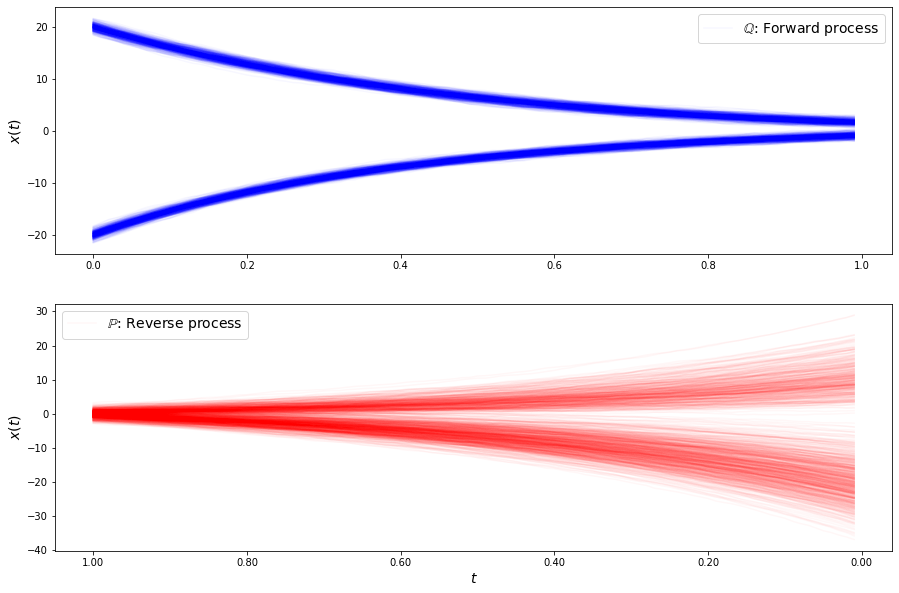

loss b 26.76282369545918
loss b 26.391744005360323
loss b 25.76972574352248
loss b 26.68716935990877
loss b 26.451793021274202
loss b 26.749587550019015
loss b 27.195941905869926
loss b 27.317100691935646
loss b 27.65001701173676
loss b 25.503970340124337
loss b 26.060273135019155
loss b 26.75675496536594
loss b 27.509684876640023
loss b 26.87167663338449
loss b 27.507793512675974
loss b 26.198748495499228
loss b 27.361230832608495
loss b 28.44282283665334
loss b 26.4336576798349
loss b 27.85825897156339
loss b 28.81675261134248
loss b 27.562946062176707
loss b 26.75672572564224
loss b 27.8828232235323
loss b 26.73694496115211
loss b 28.152553867322094
loss b 28.986582104742457
loss b 27.927026103726316
loss b 28.051776950357155
loss b 28.44588591830423
loss f 7.002069727681947
loss f 6.931028155793932
loss f 6.895004645859014
loss f 6.911030710181263
loss f 6.882673236656936
loss f 6.958372164737723
loss f 6.955183977843712
loss f 6.913667883165005
loss f 6.9028554506315425
loss f 6.9

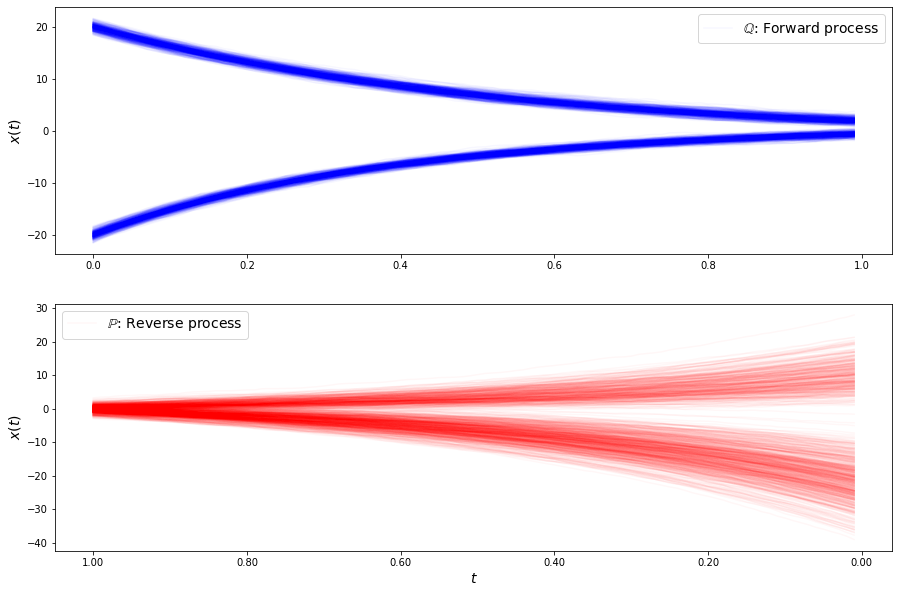

loss b 30.62712597452018
loss b 32.22970837259329
loss b 30.3918658904327
loss b 32.064901561138335
loss b 32.646745389825604
loss b 31.396706579517762
loss b 31.54290177156083
loss b 31.75622630824748
loss b 31.560882395092055
loss b 32.600783056212954
loss b 32.6860474199861
loss b 31.432249970085756
loss b 32.34566252324035
loss b 32.037709553313476
loss b 32.028714859853274
loss b 33.09317212991153
loss b 32.27561286465832
loss b 32.03792407436263
loss b 33.26066992450289
loss b 33.12396641230286
loss b 35.34119980734975
loss b 31.723059458258128
loss b 33.60391259918942
loss b 33.082046194776865
loss b 33.274913191705124
loss b 32.39179365782068
loss b 34.65886487603029
loss b 33.40399624258502
loss b 33.599413381006784
loss b 33.52301461216829
loss f 6.989197378150515
loss f 7.0909646873045835
loss f 7.149737756655664
loss f 7.144617081373405
loss f 7.1874935632270525
loss f 7.238208699975942
loss f 7.248465981120751
loss f 7.280282875925344
loss f 7.337359081968369
loss f 7.2695

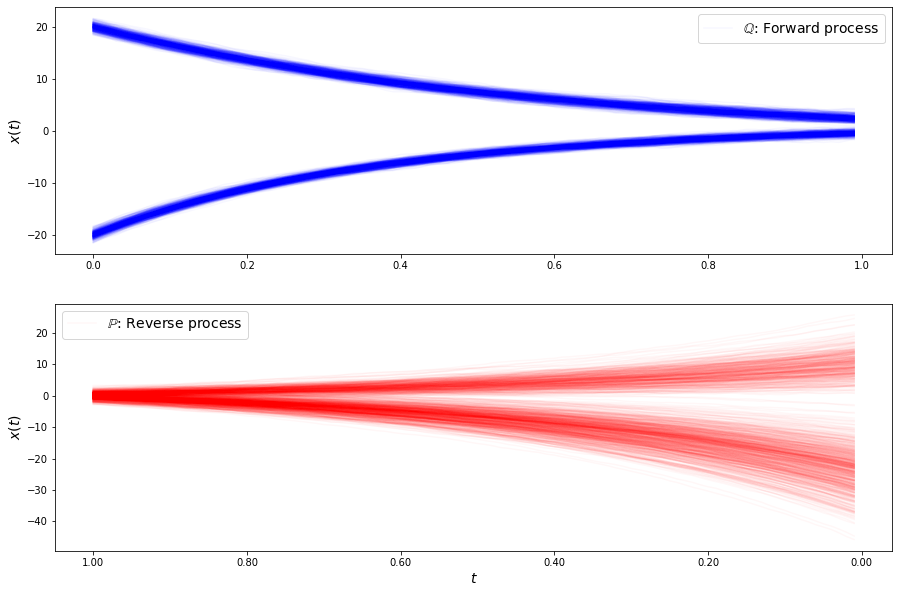

loss b 38.60903747030737
loss b 38.724137651973834
loss b 39.04777329620108
loss b 37.60380679190872
loss b 40.03064559675389
loss b 38.038442115005864
loss b 39.100060494190515
loss b 37.86305936867264
loss b 41.12891528679386
loss b 38.83702351677204
loss b 39.93727920548538
loss b 40.23479287208762
loss b 39.25583623137655
loss b 39.91460081194781
loss b 40.42702427366805
loss b 40.66078586243428
loss b 38.97677125249131
loss b 40.47955257725209
loss b 40.185545190038845
loss b 41.540655133822405
loss b 40.81624756641909
loss b 41.79558443080465
loss b 41.49090319499935
loss b 41.52851117221027
loss b 43.58200071048428
loss b 41.70489699190494
loss b 41.3511982971575
loss b 44.28299111950075
loss b 41.33135100305349
loss b 43.129336435607755
loss f 7.932219449308939
loss f 7.9106720277998654
loss f 7.991786990611519
loss f 8.017024529073083
loss f 8.227805884749882
loss f 8.287015159571371
loss f 8.353567729276442
loss f 8.345612293236588
loss f 8.410974553700935
loss f 8.4652086066

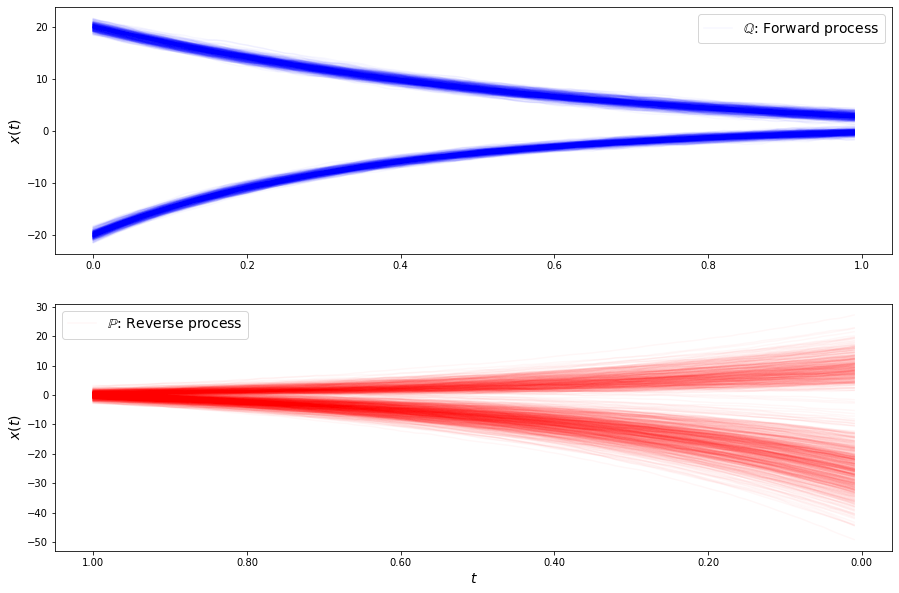

loss b 46.829282880453185
loss b 49.58694357519838
loss b 47.37767671452144
loss b 47.819466761503435
loss b 48.341679509707326
loss b 47.60766684933484
loss b 48.96398602109792
loss b 49.263211092993195
loss b 48.28655696102972
loss b 48.585696058219746
loss b 49.471411741442644
loss b 49.502206541721826
loss b 49.3012336058714
loss b 49.22789869496129
loss b 49.44561367507473
loss b 48.42975717272552
loss b 50.4600204836423
loss b 50.716343315711775
loss b 51.34171045395286
loss b 50.902340456604016
loss b 48.05261689747487
loss b 49.28790191653316
loss b 50.839964558044706
loss b 51.05378853453975
loss b 52.12136643522859
loss b 50.881922786356114
loss b 50.634797151605284
loss b 53.724048931964276
loss b 53.74779805115729
loss b 54.066990771184194
loss f 9.52890228661373
loss f 9.688214070810504
loss f 9.848766967301001
loss f 9.924577856632839
loss f 10.013789584897049
loss f 10.097526100639211
loss f 10.198006400878977
loss f 10.445447812938434
loss f 10.435425793119471
loss f 10

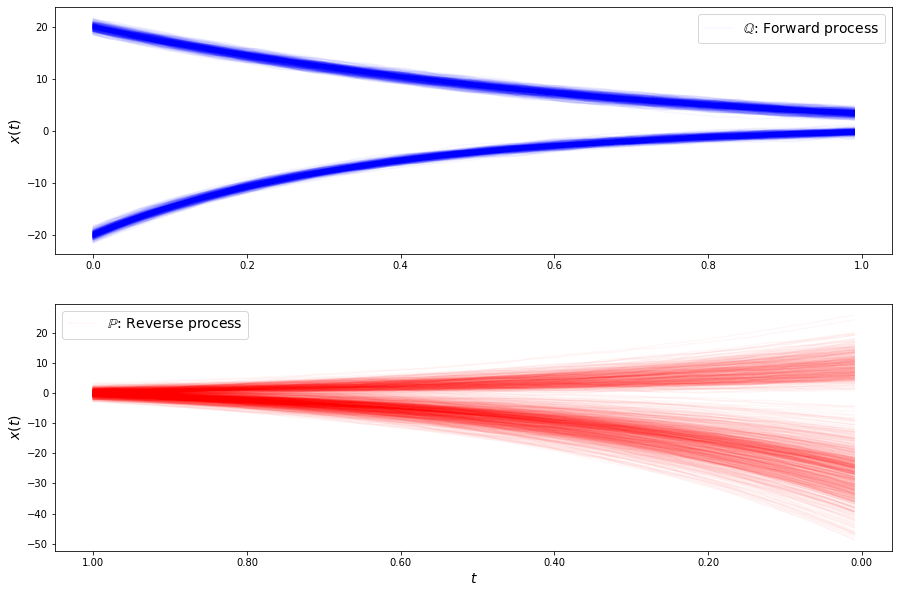

loss b 58.68353051971911
loss b 55.97845005919862
loss b 57.10752961093986
loss b 58.18360719768556
loss b 56.4094457657826
loss b 57.155043343526216
loss b 57.76753516420324
loss b 58.86084399155272
loss b 60.94670931642252
loss b 58.96961058613627
loss b 59.94751752980728
loss b 59.18532701751108
loss b 58.620743102204884
loss b 60.03349387576123
loss b 59.86252631239304
loss b 58.948985107127534
loss b 60.29304392794215
loss b 61.50816353572525
loss b 59.86517909431204
loss b 63.13824615433093
loss b 62.20550082457417
loss b 62.50988084454784
loss b 62.05153960823674
loss b 63.01569161026007
loss b 62.898098446318286
loss b 62.54534992743123
loss b 64.19737815664222
loss b 62.02366139492
loss b 61.57644418464248
loss b 62.030989623156636
loss f 12.3846442358378
loss f 12.445777001833209
loss f 12.40501176252753
loss f 12.833783984956389
loss f 12.713295737765078
loss f 12.930006391102678
loss f 13.073477720685982
loss f 13.317946114382679
loss f 13.292343570775241
loss f 13.49979145

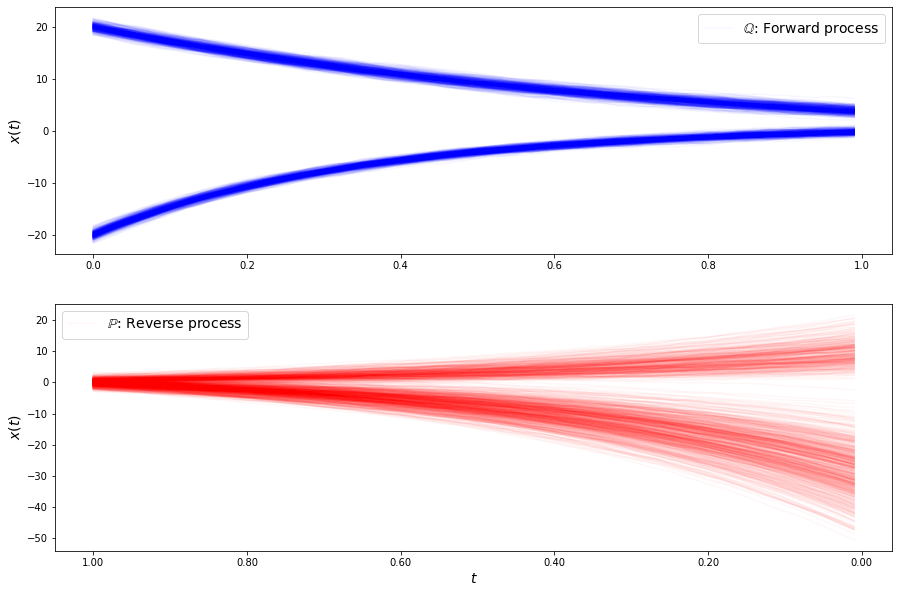

loss b 63.62303380174302
loss b 63.62057060513151
loss b 62.53358627896194
loss b 65.4140041629713
loss b 65.7928866713228
loss b 66.98461386463397
loss b 64.92597935150091
loss b 66.81837072259255
loss b 66.85951804170374
loss b 65.9594507771414
loss b 67.73931522810236
loss b 66.74139827829737
loss b 68.97964400349629
loss b 68.7096568795533
loss b 65.57246482842824
loss b 68.32316281426081
loss b 68.15148973343864
loss b 67.25404681223864
loss b 70.82944954878154
loss b 67.85488380972915
loss b 67.23796422246285
loss b 67.7453418540051
loss b 67.80546592036326
loss b 73.1043011038691
loss b 71.44983504247408
loss b 71.48212590982064
loss b 71.49081819523457
loss b 71.05218592555745
loss b 71.10661534547361
loss b 72.232957617703
loss f 15.48579690671658
loss f 15.602512179820922
loss f 15.973253188122971
loss f 15.954637720815562
loss f 16.187885316753555
loss f 16.22329395806817
loss f 16.21529569526113
loss f 16.499291778762338
loss f 16.641924581815523
loss f 16.678941607588534
l

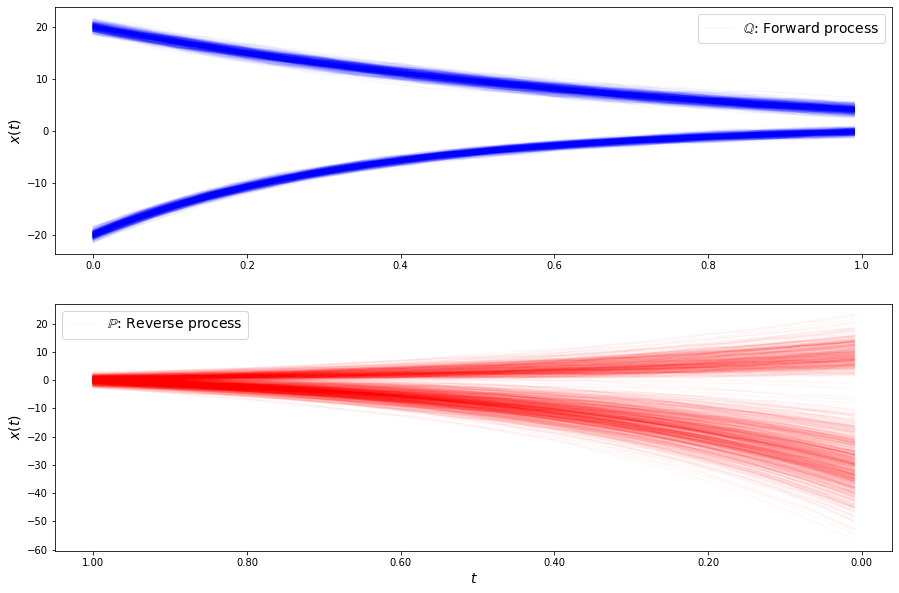

loss b 70.48446861585786
loss b 70.59201775942272
loss b 68.384106840303
loss b 70.27017601544189
loss b 70.02921603280676
loss b 71.24871252065296
loss b 72.9078646188374
loss b 70.23553859020913
loss b 69.8764553900962
loss b 71.59479129139869
loss b 72.32552395003364
loss b 71.21765011646342
loss b 72.77677948070948
loss b 72.06072005109874
loss b 71.38582198893525
loss b 75.37622203099143
loss b 74.4808122417969
loss b 71.38797749357518
loss b 70.75906383231599
loss b 72.14004459520899
loss b 73.49675782758607
loss b 75.17415537350362
loss b 75.6982917687781
loss b 71.43481501340628
loss b 73.51382982545806
loss b 72.24081043972006
loss b 74.16590042120197
loss b 73.0667041083872
loss b 72.64562109427484
loss b 72.63429529726568
loss f 18.43371802030011
loss f 18.49827505417969
loss f 18.2758660870294
loss f 18.81945964708736
loss f 18.737587995264
loss f 18.474303381881214
loss f 18.90828178911998
loss f 19.047702388159813
loss f 18.668161776097914
loss f 19.2875471815977
loss f 1

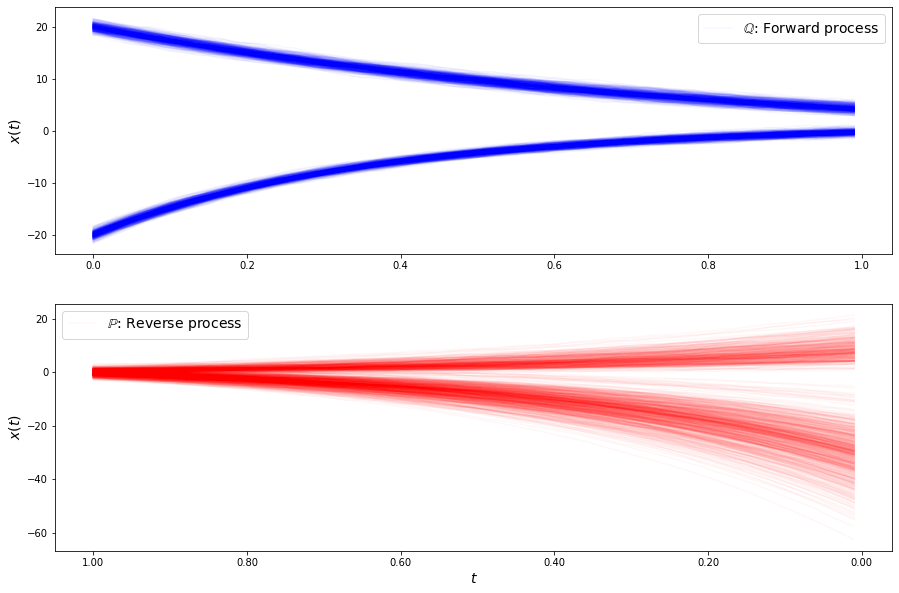

loss b 70.52717468834699
loss b 71.87184127402982
loss b 68.95718011674799
loss b 72.05826323893027
loss b 72.19499111567922
loss b 72.91352687521572
loss b 71.41702602619543
loss b 70.37363408169745
loss b 71.8609933714336
loss b 73.66470933538757
loss b 73.23028024474701
loss b 72.16286231486899
loss b 67.18219041051789
loss b 72.3392753717841
loss b 75.386223113819
loss b 68.38439863336072
loss b 74.39542425780974
loss b 70.86270673890444
loss b 69.29935714729898
loss b 72.08370033912202
loss b 69.931960148492
loss b 70.85628242409965
loss b 70.6362838187024
loss b 71.2844704485388
loss b 71.65051749356688
loss b 72.35387849693525
loss b 72.84836326256058
loss b 71.79011732992574
loss b 70.48044821143881
loss b 74.26398922849485
loss f 18.8029596625644
loss f 18.49486389755947
loss f 18.97492866834718
loss f 18.686540297851046
loss f 18.50234801113869
loss f 18.675019302339816
loss f 18.54115826595416
loss f 18.774861208299892
loss f 18.663540864601046
loss f 18.485884349109373
loss

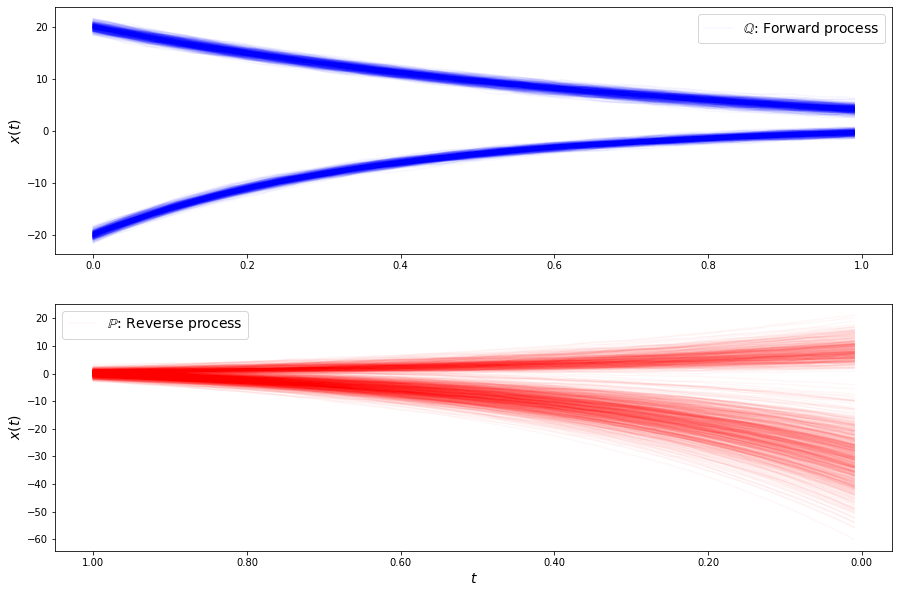

loss b 67.81250973739957
loss b 65.96531250609154
loss b 70.09936702711282
loss b 69.98323514741134
loss b 70.17966834134076
loss b 66.30148271793574
loss b 67.38416623222052
loss b 67.3052081413651
loss b 69.00734846566205
loss b 69.11745435808788
loss b 67.99764212888627
loss b 67.74989643735225
loss b 68.41901723156438
loss b 66.65947291807863
loss b 65.69226224183512
loss b 67.29958984262232
loss b 66.14449447406868
loss b 68.35721544642958
loss b 64.90059448018535
loss b 64.80788422228798
loss b 65.67234011508182
loss b 67.52112024346113
loss b 64.1180028950046
loss b 64.56582041740045
loss b 67.34297934387698
loss b 64.75433043876528
loss b 66.37815236993623
loss b 66.23116536901006
loss b 66.20292854785978
loss b 65.47462257718269
loss f 16.49361670070153
loss f 16.377877805899193
loss f 16.781693838939894
loss f 16.586400969640945
loss f 16.355335903190902
loss f 16.256654793346282
loss f 16.00664914407501
loss f 16.140336400499404
loss f 15.60733969197117
loss f 15.54951551938

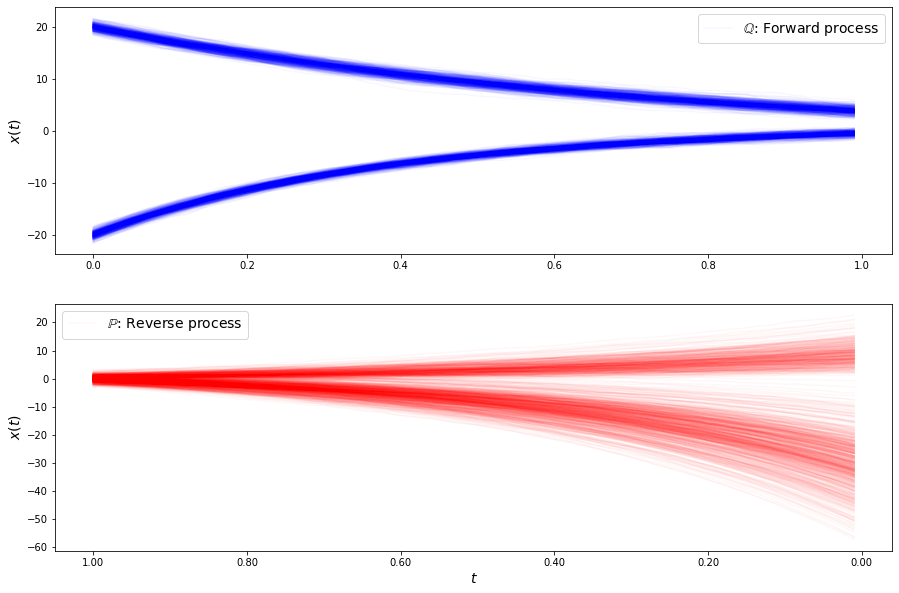

loss b 62.40781838400029
loss b 62.07946614728385
loss b 62.655241432690985
loss b 62.03077208511266
loss b 60.30162779097007
loss b 63.4533100722503
loss b 62.85863127057911
loss b 60.02375708698355
loss b 60.74910055819411
loss b 60.85638450168439
loss b 59.50105809983344
loss b 59.4456497200266
loss b 61.99844014812261
loss b 59.786781565222256
loss b 59.973586893848555
loss b 58.331743137929436
loss b 59.65116690762335
loss b 59.654278856726364
loss b 60.27053819500995
loss b 58.209805925176724
loss b 57.45328237019141
loss b 57.80247445635379
loss b 59.87635045101087
loss b 59.70136527893614
loss b 57.59131142643199
loss b 56.46758395286692
loss b 58.64335660134958
loss b 57.29861405122994
loss b 59.46108759521671
loss b 56.50632235913278
loss f 12.951715713724443
loss f 12.830771146810955
loss f 12.444048776982969
loss f 12.639279660178484
loss f 12.70610938037275
loss f 12.71616594312024
loss f 12.5202366932461
loss f 12.731891082679336
loss f 12.18111373275309
loss f 11.9117141

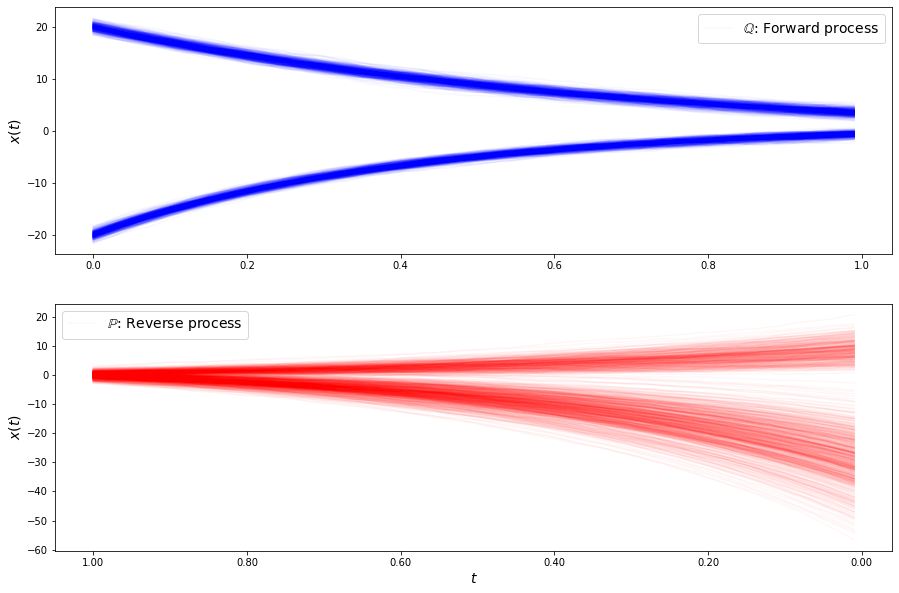

loss b 54.17879943771603
loss b 54.99151202814462
loss b 54.994140670362526
loss b 54.20003236007434
loss b 55.88972001589588
loss b 55.10263293632391
loss b 53.7110086807818
loss b 54.625657165595996
loss b 53.57438454874899
loss b 52.9836546945573
loss b 55.34148794709266
loss b 54.221448672115635
loss b 53.7559719026624
loss b 51.640477606041834
loss b 54.67657869962486
loss b 52.19528338598947
loss b 51.50991151442323
loss b 54.58733700867961
loss b 51.26189399664191
loss b 51.16849114751702
loss b 49.01384234773033
loss b 51.72467504600968
loss b 50.55130369847363
loss b 50.47771552444616
loss b 50.1083518339418
loss b 50.49270832941892
loss b 50.55296474628034
loss b 48.21107885276637
loss b 49.040221131728586
loss b 47.92187316278294
loss f 10.178127627816767
loss f 10.28528556962786
loss f 10.171056192957904
loss f 9.945184866261027
loss f 10.013596179527898
loss f 9.949145779892815
loss f 10.007235443509872
loss f 9.92212455026059
loss f 10.019432440122937
loss f 9.86271809722

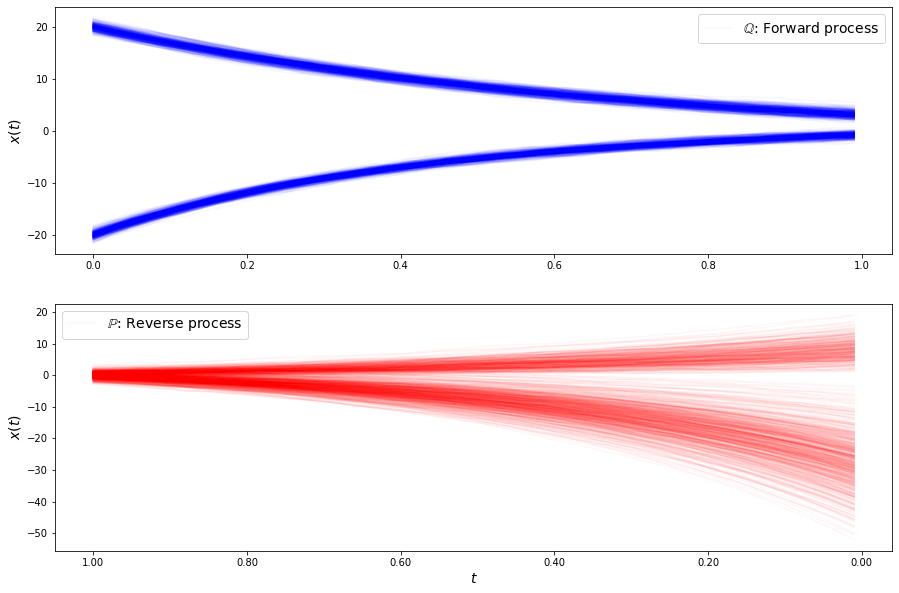

loss b 47.693519864316
loss b 46.16816459550903
loss b 46.447354516473865
loss b 45.29422434285322
loss b 45.719074417157465
loss b 47.62760124343879
loss b 46.99578070787116
loss b 46.23343333175475
loss b 44.88415960902159
loss b 44.50934294635724
loss b 44.9817763291806
loss b 45.14916545588414
loss b 43.800461934689025
loss b 45.7008579981075
loss b 43.84895000999531
loss b 45.98053459776548
loss b 43.72492067486036
loss b 43.98041533532062
loss b 43.41424277726044
loss b 43.10474388248137
loss b 43.31959994160615
loss b 42.42071027356931
loss b 42.24089621572003
loss b 40.62232833889597
loss b 45.27017272686374
loss b 42.151866158379306
loss b 40.746968843761756
loss b 40.08012014463051
loss b 41.67386555975842
loss b 40.10363117549896
loss f 8.807125501009395
loss f 9.198824422531667
loss f 8.864338812075196
loss f 9.048154980337303
loss f 9.07173806456924
loss f 8.985429629939116
loss f 8.96012194070781
loss f 8.914063227337948
loss f 9.023431586894263
loss f 8.992970455054515
l

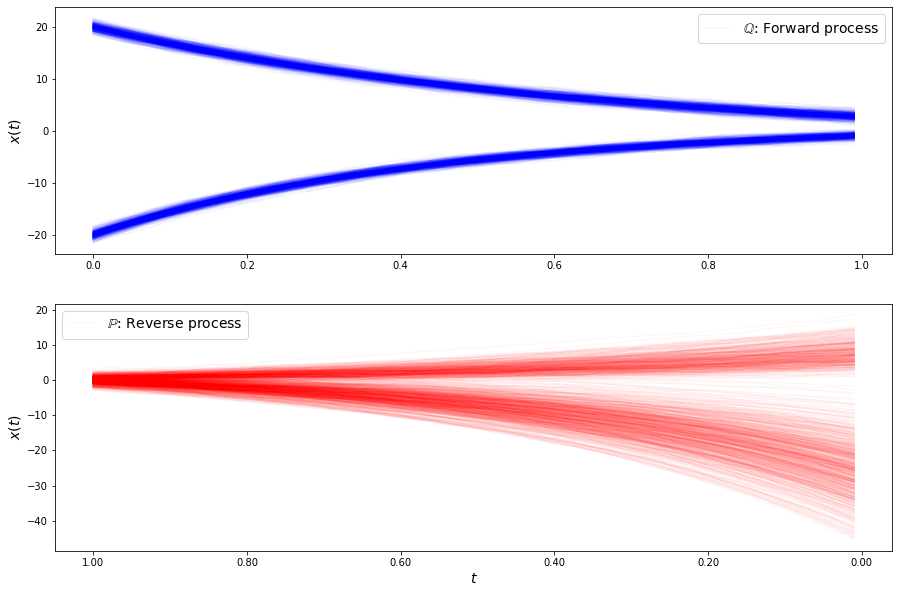

loss b 41.169851180515835
loss b 39.08152985785991
loss b 40.01893650095263
loss b 39.933041058031826
loss b 41.21757334535038
loss b 39.67025469159294
loss b 39.16454264757258
loss b 39.3388800234358
loss b 39.515553704744995
loss b 38.810708737604294
loss b 40.49342939951957
loss b 37.16670638681699
loss b 37.09023795023321
loss b 38.24613089224368
loss b 38.44843255098035
loss b 37.259924005113746
loss b 37.13661673018675
loss b 37.44450454412676
loss b 37.48271208699515
loss b 37.703213978312256
loss b 36.45952140777731
loss b 37.07357367426885
loss b 37.58430628689901
loss b 36.95391426595502
loss b 34.895606246588045
loss b 36.247701534477656
loss b 38.605308675807905
loss b 36.5265664273185
loss b 35.88597156567689
loss b 36.74080736974265
loss f 8.844293961884011
loss f 8.902894663449851
loss f 8.961475055650256
loss f 8.987111424489877
loss f 8.962241430375112
loss f 9.0489502254617
loss f 9.013478938893964
loss f 8.938401255366864
loss f 9.070692337690323
loss f 9.05560611882

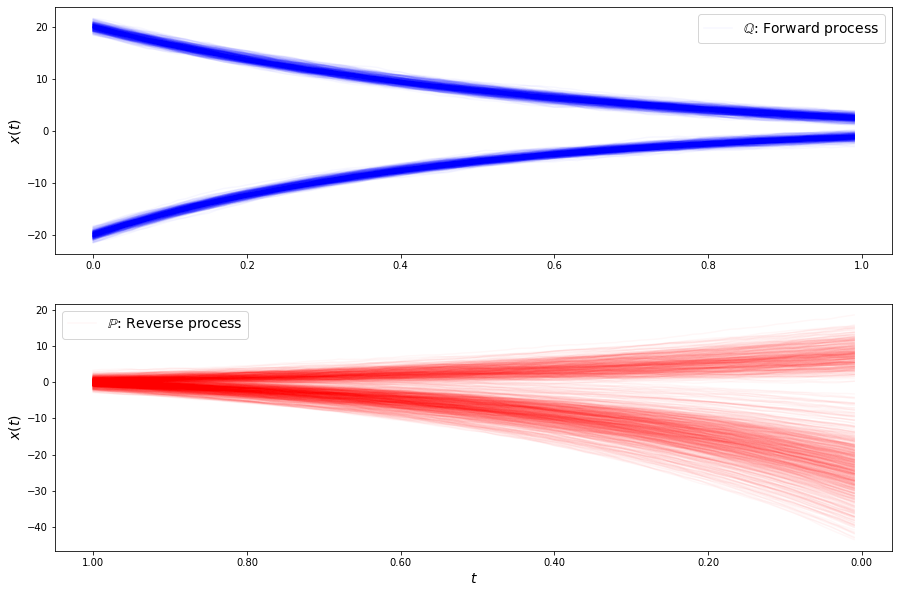

loss b 35.64761585022646
loss b 36.8082085272391
loss b 36.16849716905385
loss b 35.705173568558074
loss b 35.493574544442694
loss b 34.93131100312989
loss b 33.74323139932963
loss b 35.47169284291241
loss b 34.97038045253693
loss b 34.79171384661151
loss b 34.97640067192889
loss b 33.99468250463819
loss b 36.1168889845552
loss b 34.167601744359324
loss b 32.78918165706288
loss b 33.83139167758374
loss b 35.03274761839385
loss b 34.17456002357888
loss b 32.45282025149911
loss b 34.288144540530034
loss b 32.659891420576926
loss b 34.011567483602086
loss b 33.09585502681608
loss b 32.592000537099956
loss b 32.30113023869804
loss b 33.01401216732245
loss b 32.65066296831968
loss b 32.120368206298465
loss b 32.94158114053705
loss b 31.97586171287825
loss f 9.320981339890338
loss f 9.38714748202794
loss f 9.45576340499111
loss f 9.475512772429596
loss f 9.60718844870414
loss f 9.500842751721219
loss f 9.5589120476584
loss f 9.73106523978011
loss f 9.71223219485409
loss f 9.707979190667869
l

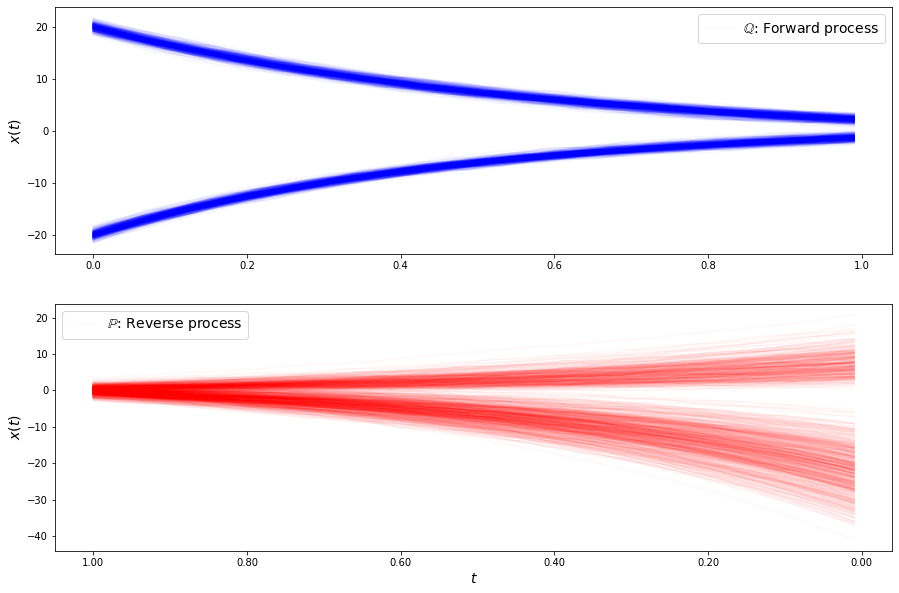

loss b 32.833648664373094
loss b 32.868237257657064
loss b 33.12424069788311
loss b 30.999812226782876
loss b 33.297350831264396
loss b 30.597924016826845
loss b 32.34695721841303
loss b 30.49254734414383
loss b 32.56744246571931
loss b 31.790290683209736
loss b 31.395090979291194
loss b 33.01604235437829
loss b 32.18451791890232
loss b 31.532125803364266
loss b 31.302078920586638
loss b 32.15450870190754
loss b 31.55116332936384
loss b 31.002940236987193
loss b 29.831885727282316
loss b 29.712035182733413
loss b 30.66003700133564
loss b 30.430320870325563
loss b 29.59896261106064
loss b 30.50952360963118
loss b 29.808382206415082
loss b 29.28345115427057
loss b 30.202218919291184
loss b 29.78105932919255
loss b 30.48540862684183
loss b 30.198932267418076
loss f 10.068892818409438
loss f 10.053833616816254
loss f 10.049267955276177
loss f 10.139443966147441
loss f 10.115612462385974
loss f 10.285882029431235
loss f 10.290391026614408
loss f 10.330723742751642
loss f 10.345641219806824


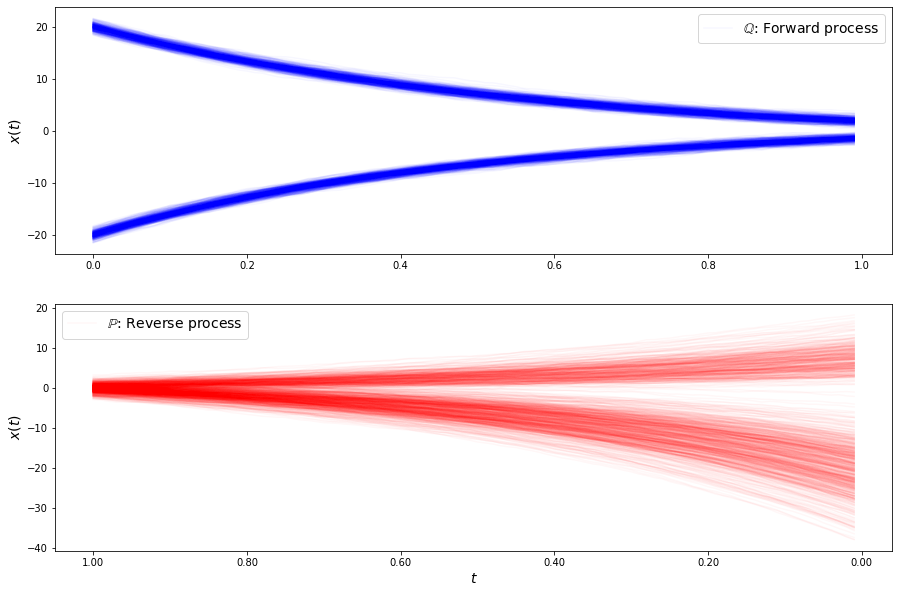

loss b 30.540685634556624
loss b 30.670529910103053
loss b 30.880550998978595
loss b 31.31109977417137
loss b 31.32564985532385
loss b 30.427578444617062
loss b 28.70846558325687
loss b 30.75867750974678
loss b 29.849041793789073
loss b 31.26536626874039
loss b 30.213858957997864
loss b 30.72686237943981
loss b 30.115467576094144
loss b 30.289717115241864
loss b 30.188761863856133
loss b 29.203550330189515
loss b 30.60096877407819
loss b 30.492222285156465
loss b 29.512598547923698
loss b 28.999108091180602
loss b 29.769786705234978
loss b 30.844791550077858
loss b 29.64533999208073
loss b 30.26647027200006
loss b 30.277043876612368
loss b 29.115928999571665
loss b 29.668724080195553
loss b 30.611746176002715
loss b 29.286049903972604
loss b 31.574814477785896
loss f 10.716114869885079
loss f 10.739257907298407
loss f 10.799752146784373
loss f 10.92221752345431
loss f 10.86994276677255
loss f 10.93444415911796
loss f 11.068742647396208
loss f 11.035407199098106
loss f 11.11078627848812

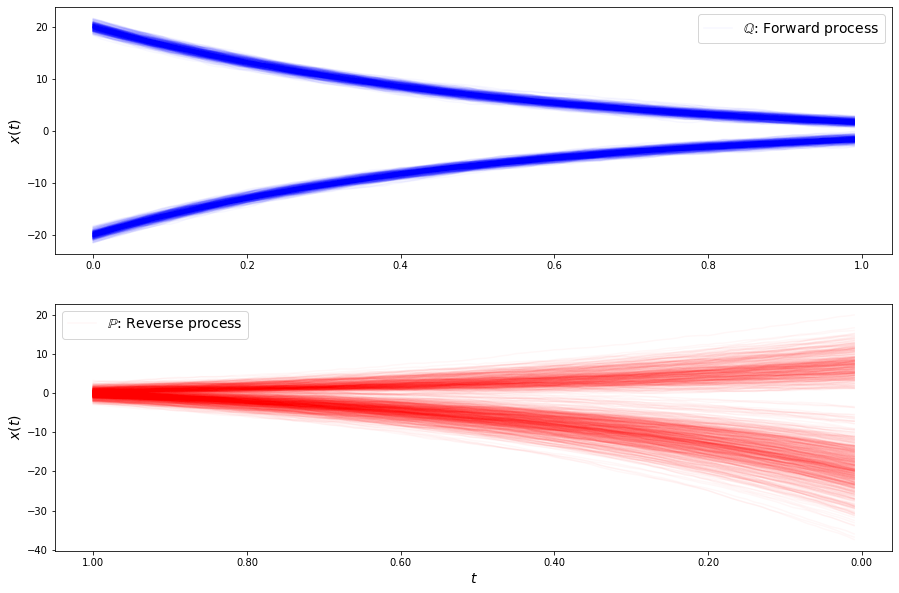

loss b 29.590459269310763
loss b 29.660958721762935
loss b 29.591677952304863
loss b 29.959585374261273
loss b 29.974984893098966
loss b 29.617972384796996
loss b 29.390063760510554
loss b 31.129045308073145
loss b 29.357808154855196
loss b 29.298438025903625
loss b 30.304959709373506
loss b 29.577743981291324
loss b 29.37996422529146
loss b 29.39532066384435
loss b 28.69356540816976
loss b 29.167732059692366
loss b 29.244626358517504
loss b 29.553597764294874
loss b 29.38446227006307
loss b 29.029185724463286
loss b 28.442607378074023
loss b 28.752707944490577
loss b 29.369210838887973
loss b 29.26804607568196
loss b 30.358654567088095
loss b 29.81045254682035
loss b 30.744704324159425
loss b 28.90746288840292
loss b 29.72856824267714
loss b 28.27587876610305
loss f 11.325107991288617
loss f 11.381569429712588
loss f 11.478369984723534
loss f 11.52140570611205
loss f 11.575937360508808
loss f 11.545824278479673
loss f 11.543059471703838
loss f 11.560217995214066
loss f 11.725286078890

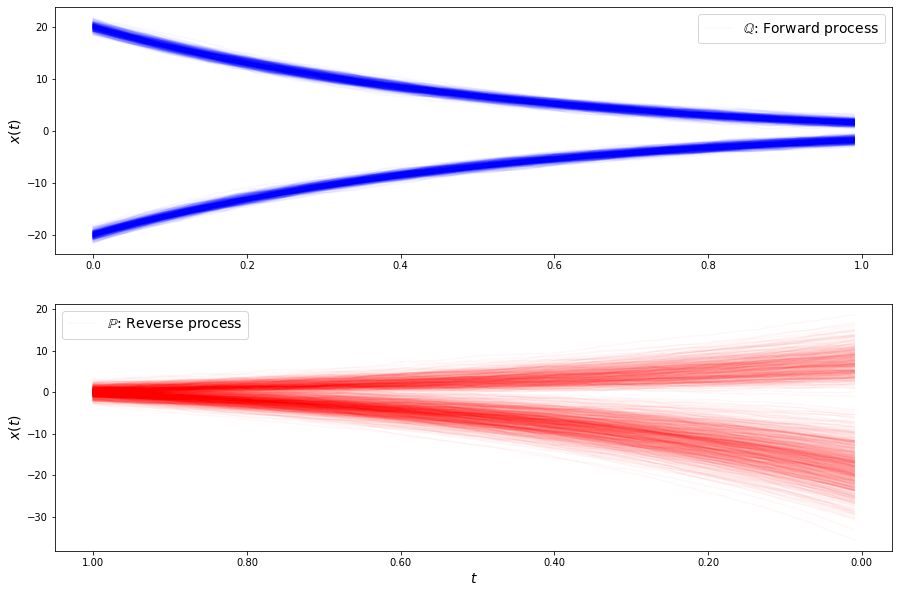

loss b 30.04168275103554
loss b 30.65752338832001
loss b 29.761271027327613
loss b 30.65341266421919
loss b 30.39202759473451
loss b 28.96509763570219
loss b 29.969019134167876
loss b 29.38430542733061
loss b 30.809936020535954
loss b 28.680914559037987
loss b 29.454955149947804
loss b 29.849812992192767
loss b 29.62001697497055
loss b 29.623481046789852
loss b 30.409502628828317
loss b 29.043772885676447
loss b 29.945252382760742
loss b 29.824700158161882
loss b 30.74912227052268
loss b 29.971380998332073
loss b 29.004316519860314
loss b 29.90373275165911
loss b 30.94186541080909
loss b 29.41709136527126
loss b 29.37854834166171
loss b 29.18094401895204
loss b 29.776973543103992
loss b 29.933890115401308
loss b 29.054143462247342
loss b 30.14884626021604
loss f 11.791930450514291
loss f 11.947035653489008
loss f 11.928527756330691
loss f 11.912379322725409
loss f 12.090187608315949
loss f 11.995370546907422
loss f 12.030663996808594
loss f 12.130857199195955
loss f 12.106037233505427


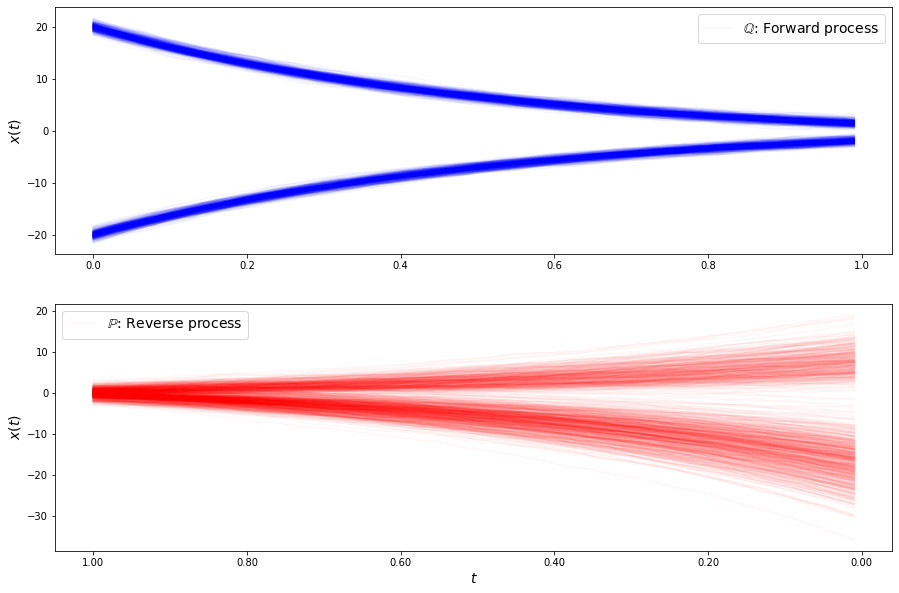

loss b 30.59661791749751
loss b 31.12226305893969
loss b 30.040812090387732
loss b 29.91193220832349
loss b 30.47125911288988
loss b 29.490026338292623
loss b 31.123596941144825
loss b 30.825303936935065
loss b 30.694153468960504
loss b 30.220387813060064
loss b 29.61116226822234
loss b 29.015350770049995
loss b 28.746674064729195
loss b 29.89399610428768
loss b 30.386582068921193
loss b 29.71025138539591
loss b 30.142103300643306
loss b 30.344701673996216
loss b 30.980966505637582
loss b 30.067083608971537
loss b 30.470120005895435
loss b 30.43423229383829
loss b 31.044991478745246
loss b 29.535908470094743
loss b 30.487279841039022
loss b 30.232735439957626
loss b 29.84070088407945
loss b 29.755270681836116
loss b 29.67335145336229
loss b 30.81396125774417
loss f 12.088704266009913
loss f 12.20500565569427
loss f 12.228249445200433
loss f 12.277197166380994
loss f 12.235007090070846
loss f 12.288410360901134
loss f 12.272272839705002
loss f 12.387934689777511
loss f 12.39518628037266

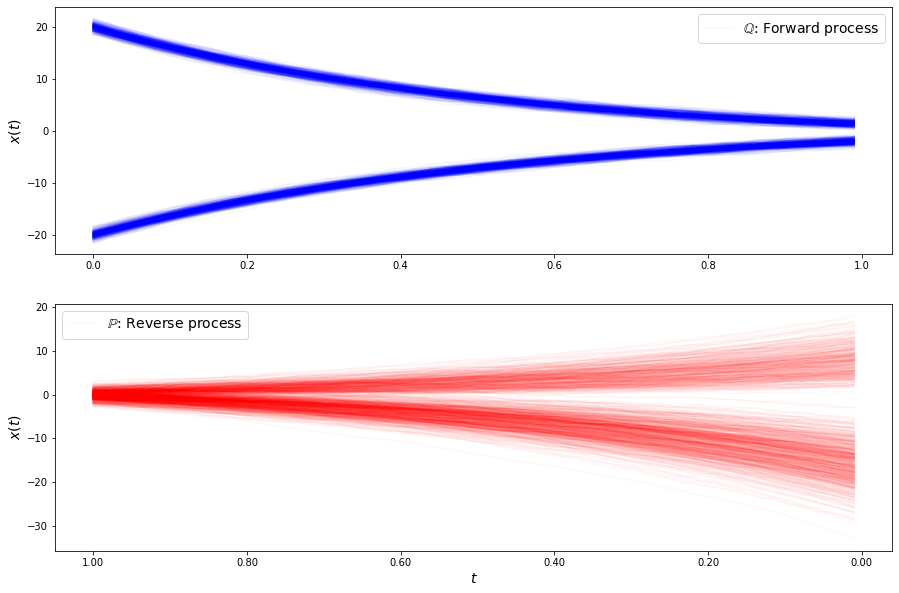

loss b 30.775160561031125
loss b 30.957071515770142
loss b 31.580704799544172
loss b 30.89812200095285
loss b 30.539548752336067
loss b 30.41150214956986
loss b 30.639037769776
loss b 30.45454577234435
loss b 30.746824778454574
loss b 30.294069153851616
loss b 29.952050897144215
loss b 30.45915922046626
loss b 31.484534737193556
loss b 31.41337658037134
loss b 30.51799218139788
loss b 30.930296008023653
loss b 30.541687216614175
loss b 30.974151258477455
loss b 29.67570497954671
loss b 30.652419273984787
loss b 29.881472914196166
loss b 31.208399288703596
loss b 30.69694123056287
loss b 31.40409817462477
loss b 30.77267084912025
loss b 31.05686247710008
loss b 30.41580500514049
loss b 31.447492577056664
loss b 31.15002118320784
loss b 31.587398420959477
loss f 12.03295422077994
loss f 12.121604816610125
loss f 12.038838298675856
loss f 12.20988630862317
loss f 12.024779559813108
loss f 12.147817261452193
loss f 12.123976045495631
loss f 12.23707675564481
loss f 12.101146444355965
loss 

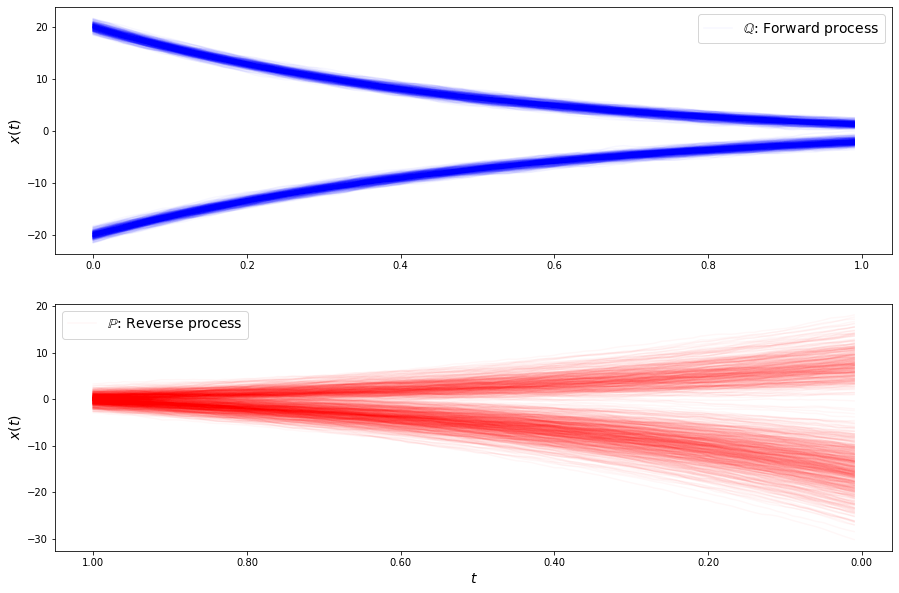

loss b 31.62710135464398
loss b 30.61824894266151
loss b 32.185414011786435
loss b 31.799199690083572
loss b 30.625711120993365
loss b 30.333339147151637
loss b 30.864151717554726
loss b 30.732861184686726
loss b 30.94601334295743
loss b 31.10227448882451
loss b 30.936674249798116
loss b 30.31329698568705
loss b 31.790496412249144
loss b 31.28658504921555
loss b 31.636080234680833
loss b 31.246492111196815
loss b 30.942903410346105
loss b 30.261380920872753
loss b 30.566130758426205
loss b 31.37948667619323
loss b 31.438596224484098
loss b 31.13718806841787
loss b 31.604044406644267
loss b 30.99772378370036
loss b 31.723214080142082
loss b 31.302926257267668
loss b 31.270393052051485
loss b 30.453281165818026
loss b 31.61825943571908
loss b 31.33460781107247
loss f 11.62492619031866
loss f 11.54606390082406
loss f 11.637098342863055
loss f 11.600775766679785
loss f 11.570454709533081
loss f 11.657056215225493
loss f 11.635052304437808
loss f 11.637994292125521
loss f 11.618120638289573

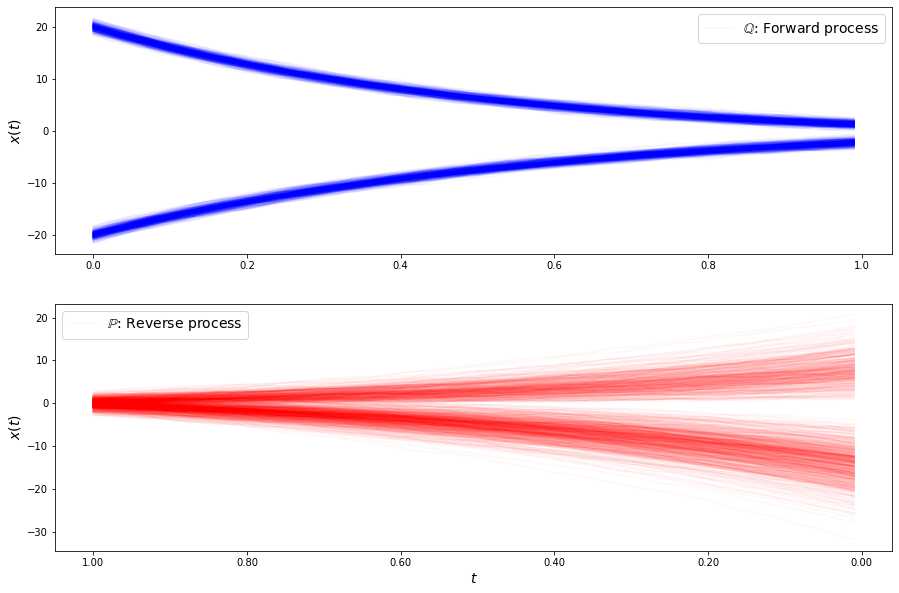

loss b 30.944511396580115
loss b 31.50077657982217
loss b 31.331613732903207
loss b 31.321707467582584
loss b 31.02427726117979
loss b 32.127469218535666
loss b 31.657115093782096
loss b 32.05577325654692
loss b 31.744955874042336
loss b 31.30897392748607
loss b 31.884375349240635
loss b 31.277795652730564
loss b 31.184760603377136
loss b 31.405247978322016
loss b 31.098645520431816
loss b 30.972046946387547
loss b 32.34417005354239
loss b 29.933452274797396
loss b 31.70961200472257
loss b 31.76640415055091
loss b 30.782108735106426
loss b 31.763048720571227
loss b 30.883963651427198
loss b 32.453568371687034
loss b 31.822244221722087
loss b 31.585341534025094
loss b 31.404747171045027
loss b 31.65380484464208
loss b 31.1743043265237
loss b 31.594242807449213
loss f 10.721098340631276
loss f 10.713039765869901
loss f 10.703053892166448
loss f 10.704670386629902
loss f 10.788625248240441
loss f 10.779804600360693
loss f 10.748781220657541
loss f 10.747688802579184
loss f 10.752084862102

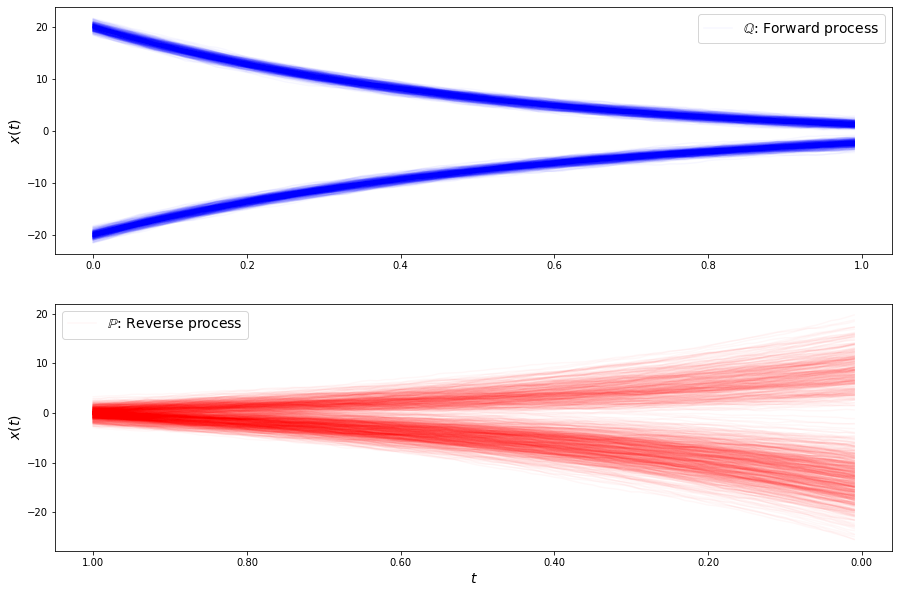

loss b 31.08404643421256
loss b 31.531970758622318
loss b 30.60704468690098
loss b 32.1459552089797
loss b 31.927824278288664
loss b 31.81315611733569
loss b 30.789283915387788
loss b 31.78030599819622
loss b 31.041874440825566
loss b 32.4788942077838
loss b 30.822971186147683
loss b 31.68922991829559
loss b 31.540920480374833
loss b 31.03065192027641
loss b 30.51483728133164
loss b 31.171881023346067
loss b 32.44790616576427
loss b 30.896751579361155
loss b 31.423942925732884
loss b 32.00159405253506
loss b 31.505204555395014
loss b 31.615601228476965
loss b 30.598189192719293
loss b 31.674204001431537
loss b 31.98030754265354
loss b 31.1668021767201
loss b 31.381797130307675
loss b 30.994514946854395
loss b 31.58609493151587
loss b 30.591203681711182
loss f 9.609866654896821
loss f 9.67879532837496
loss f 9.65361569313176
loss f 9.711899934744595
loss f 9.683115298977087
loss f 9.656425720587515
loss f 9.678559988614383
loss f 9.590418700875372
loss f 9.734026042814886
loss f 9.82023

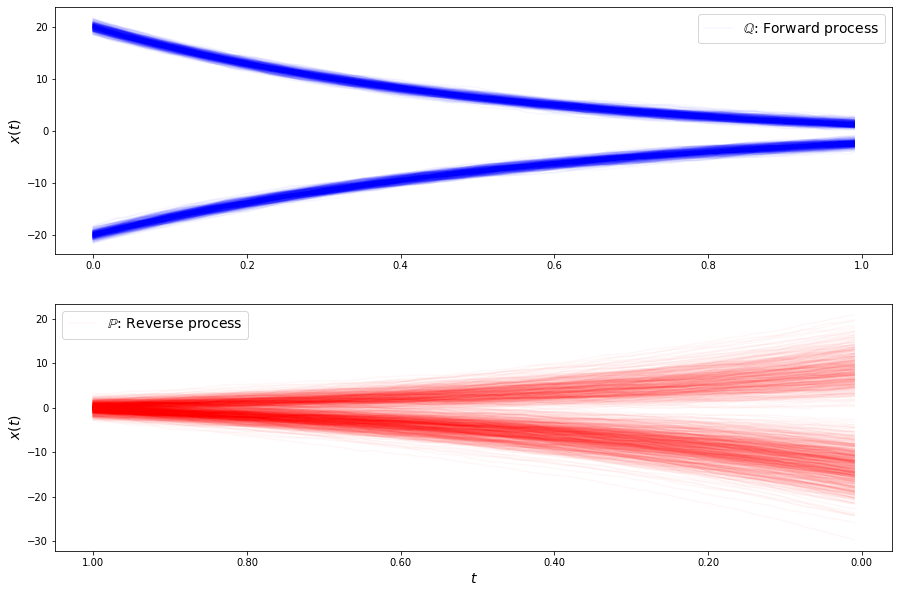

loss b 31.427269341140214
loss b 32.17020527895415
loss b 30.965391915725185
loss b 31.05910059541344
loss b 31.16084472159006
loss b 31.986104727363657
loss b 30.908869335139382
loss b 31.174417330197173
loss b 30.862548258669083
loss b 31.878659525673985
loss b 31.44962333294266
loss b 30.540283057887173
loss b 31.713683894608092
loss b 31.236719959454465
loss b 31.56097704560488
loss b 31.019840941322727
loss b 31.4711520677906
loss b 31.24159003615931
loss b 30.455222919556682
loss b 31.31361405290345
loss b 31.219371874847553
loss b 31.554023180289935
loss b 30.638005942177053
loss b 32.16277577706595
loss b 30.50447486673552
loss b 31.17743735508359
loss b 30.48507642143364
loss b 32.44875439266111
loss b 31.039639228423745
loss b 31.156398828448747
loss f 8.561953489766614
loss f 8.611365481571326
loss f 8.568649587266094
loss f 8.573645619899164
loss f 8.443448185333995
loss f 8.378408656003115
loss f 8.65149380035061
loss f 8.541201856267921
loss f 8.562988363587422
loss f 8.5

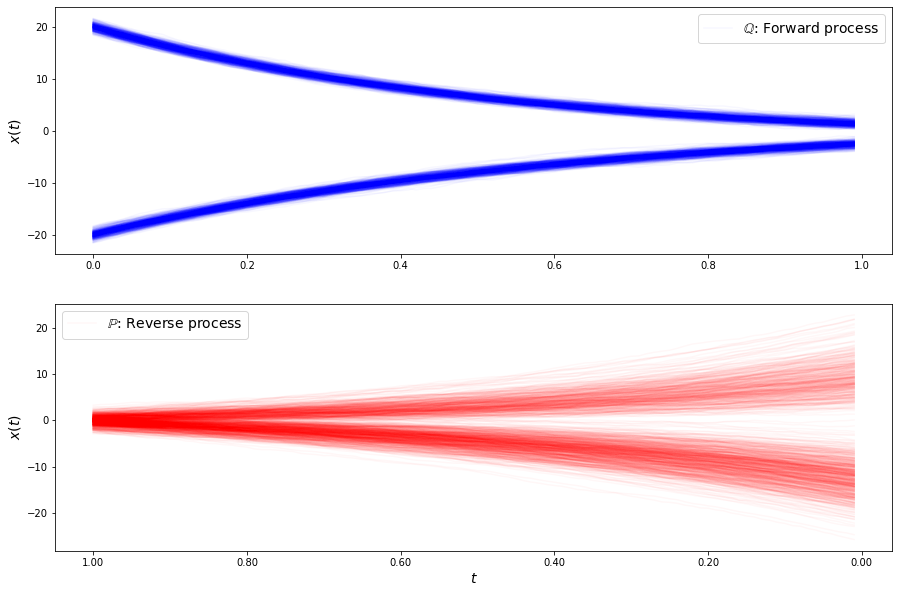

loss b 31.027995191465052
loss b 31.09157578827572
loss b 31.848687867066584
loss b 30.29562975905327
loss b 30.34963953505387
loss b 31.755562482562063
loss b 31.02672969201906
loss b 30.45603257577811
loss b 31.321298819907028
loss b 31.722513753908633
loss b 31.049467945608487
loss b 30.51451911458186
loss b 30.612127046815324
loss b 29.671920737461818
loss b 31.214501364016257
loss b 31.119426995211143
loss b 31.74830560808951
loss b 30.98821237063074
loss b 30.782417683130827
loss b 30.20661940089745
loss b 30.8177925018794
loss b 30.94952994823699
loss b 30.196902646206983
loss b 30.282766936813385
loss b 31.165915176782672
loss b 30.773570428688547
loss b 30.18567944250584
loss b 31.010550053697592
loss b 30.39615165383253
loss b 30.976176912296594
loss f 7.604130800616479
loss f 7.562221851137249
loss f 7.671244291435252
loss f 7.568083309961
loss f 7.5268014715502085
loss f 7.668066214950299
loss f 7.636369467337439
loss f 7.412114173334805
loss f 7.588502155976454
loss f 7.60

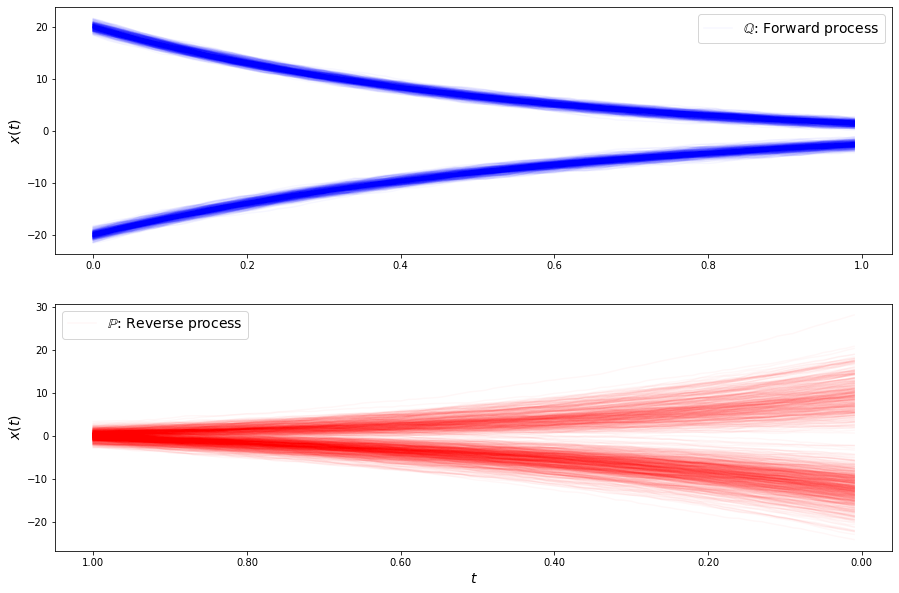

loss b 31.21310434539104
loss b 30.280604357382455
loss b 29.976126722790312
loss b 30.67719981896816
loss b 31.1463623796998
loss b 29.993820375573343
loss b 30.934127866827318
loss b 30.847274013975298
loss b 30.297858682220994
loss b 31.073876370551435
loss b 29.788623905234587
loss b 30.087736081877278
loss b 29.780487860988256
loss b 29.746742962389604
loss b 30.87837812353407
loss b 31.57869184039068
loss b 30.65798229347805
loss b 30.5032226431443
loss b 31.42756479251217
loss b 30.343058483636455
loss b 30.9062045551717
loss b 29.955527271791468
loss b 30.72437810935683
loss b 30.70716131154769
loss b 30.66586312208948
loss b 30.6099456999796
loss b 30.71060595376742
loss b 29.56831119220878
loss b 30.996333111703926
loss b 29.649809163682036
loss f 6.96049686639772
loss f 7.192552399736943
loss f 7.074808963163262
loss f 7.07476478147569
loss f 7.0158299243799656
loss f 6.9773874636063855
loss f 6.98071651160064
loss f 7.094836671071831
loss f 7.111208500317861
loss f 7.021883

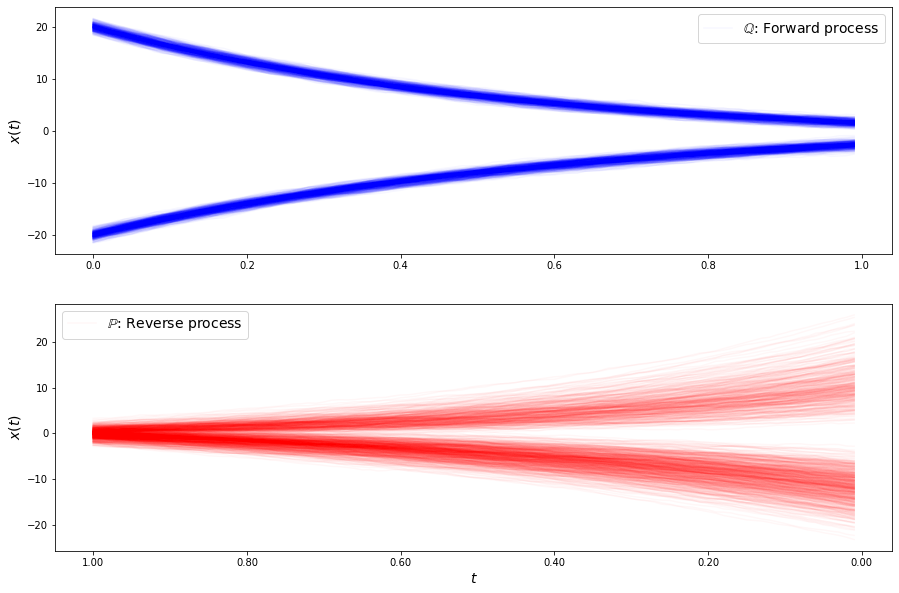

loss b 30.447374751450887
loss b 30.29774269999154
loss b 30.04651103801957
loss b 29.614972683368165
loss b 30.651561473798587
loss b 30.482509945276554
loss b 29.127169634498102
loss b 30.48146919185946
loss b 29.642971120185926
loss b 30.13944870735222
loss b 30.34430222293175
loss b 30.2704736841187
loss b 30.82340575043296
loss b 30.349066124783036
loss b 30.322173144124456
loss b 29.750507619215085
loss b 30.181968955159515
loss b 29.44931722958082
loss b 30.961768603778143
loss b 30.426777320706375
loss b 29.59066528473757
loss b 30.093942875222343
loss b 29.323542574122182
loss b 30.052298505618797
loss b 29.582182751822486
loss b 30.212116486130537
loss b 29.921828994968035
loss b 30.18629948538358
loss b 29.685448582755917
loss b 29.03077020620591
loss f 7.071739926898662
loss f 7.229292382389953
loss f 7.032574036568905
loss f 7.095160620362718
loss f 6.915063836327609
loss f 7.0467149542508185
loss f 6.953643298351853
loss f 7.227259506935821
loss f 7.001635799920696
loss f

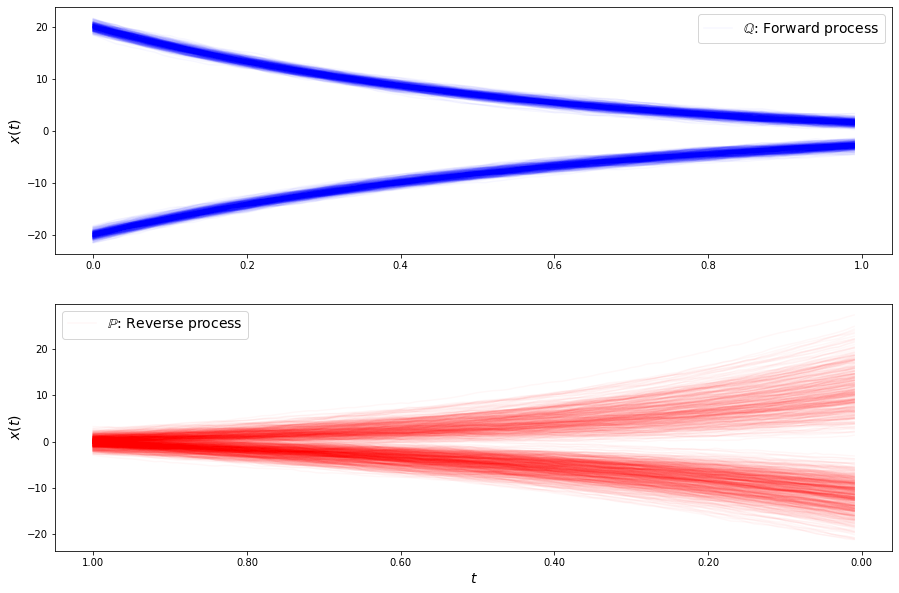

loss b 30.368199828111702
loss b 29.377769421420968
loss b 30.237807213250004
loss b 29.835418700545755
loss b 29.93023604684274
loss b 29.834159496363423
loss b 29.968690374534873
loss b 29.615333715410063
loss b 30.101040383042264
loss b 30.416856880573526
loss b 29.891218752573625
loss b 28.224447867378633
loss b 29.80406941551824
loss b 28.981778802455075
loss b 29.56419589295984
loss b 29.697840264371383
loss b 29.22307127754682
loss b 29.680975575505027
loss b 30.082174593766435
loss b 29.86400827655088
loss b 29.40038155186124
loss b 29.21330044765085
loss b 30.07214494363267
loss b 29.505118812813297
loss b 29.848108327816096
loss b 29.468034080503926
loss b 29.367418877161843
loss b 29.931300003826422
loss b 30.1386070598452
loss b 28.62648047910579
loss f 7.692173931254841
loss f 7.556754269348738
loss f 7.619927490775008
loss f 7.7899563122860584
loss f 7.615844084206221
loss f 7.640265195591343
loss f 7.905519495210096
loss f 7.687091009964373
loss f 7.641727208532842
loss 

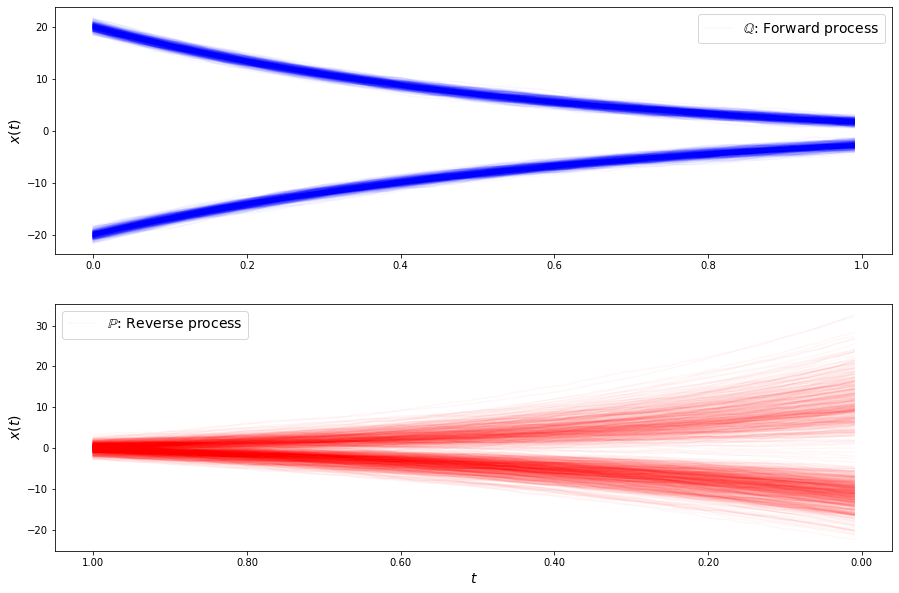

loss b 29.654969060820854
loss b 30.1514857889316
loss b 29.145176963682246
loss b 28.938388931572103
loss b 30.13399065872875
loss b 30.42884645953459
loss b 30.031301475953175
loss b 30.012450155267377
loss b 29.45567589077209
loss b 28.754668073652628
loss b 29.73377362430886
loss b 29.73420332570873
loss b 29.966922314390402
loss b 30.11193617596199
loss b 29.744748220708843
loss b 29.687194550596292
loss b 29.687183510949446
loss b 29.255789073032908
loss b 29.30559233484764
loss b 28.503121744014006
loss b 30.07711899243652
loss b 28.951608092202306
loss b 29.0321609818702
loss b 29.371517644116512
loss b 30.53892806004745
loss b 29.472931420429557
loss b 29.057006956091723
loss b 29.96091059409656
loss b 29.90554152981203
loss b 29.42325786107289
loss f 8.871483431082632
loss f 8.883381469218877
loss f 8.728875283789368
loss f 8.832975283325105
loss f 8.874554070947932
loss f 8.945853123099235
loss f 8.945195236833108
loss f 8.872489193109091
loss f 8.995523682921563
loss f 8.98

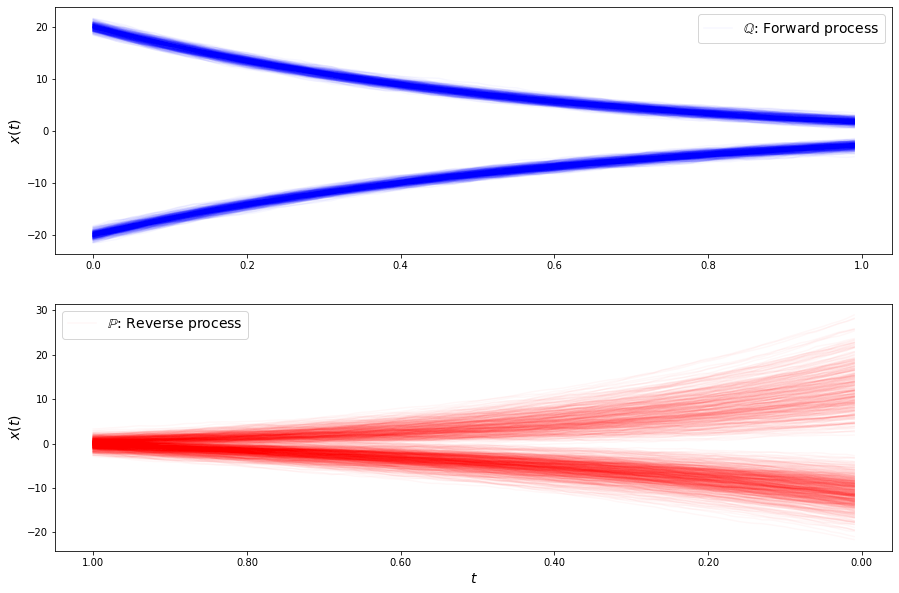

loss b 29.588938675697428
loss b 29.176599684308922
loss b 29.170999582105715
loss b 28.761235703420923
loss b 30.068811027074194
loss b 30.32301861719537
loss b 29.10896538883617
loss b 30.573060247109755
loss b 30.336210094037455
loss b 29.592838219997947
loss b 29.93702266531354
loss b 30.5168241996026
loss b 29.26232141603991
loss b 30.294094138742913
loss b 28.891262789037388
loss b 30.46005384204799
loss b 30.497304348312987
loss b 29.935195059767132
loss b 30.04765245044412
loss b 29.403912153759062
loss b 29.32838529672556
loss b 28.169848536126555
loss b 28.744221770160948
loss b 29.706221743161876
loss b 29.107224999927876
loss b 29.757994180162765
loss b 30.023916021522723
loss b 29.737276503582862
loss b 30.27775685546332
loss b 29.648482503250985
loss f 10.490972336900091
loss f 10.358790194134338
loss f 10.545143682070096
loss f 10.695189677615474
loss f 10.678983834293106
loss f 10.575703566994635
loss f 10.764182121270489
loss f 10.742804546226054
loss f 10.752039557322

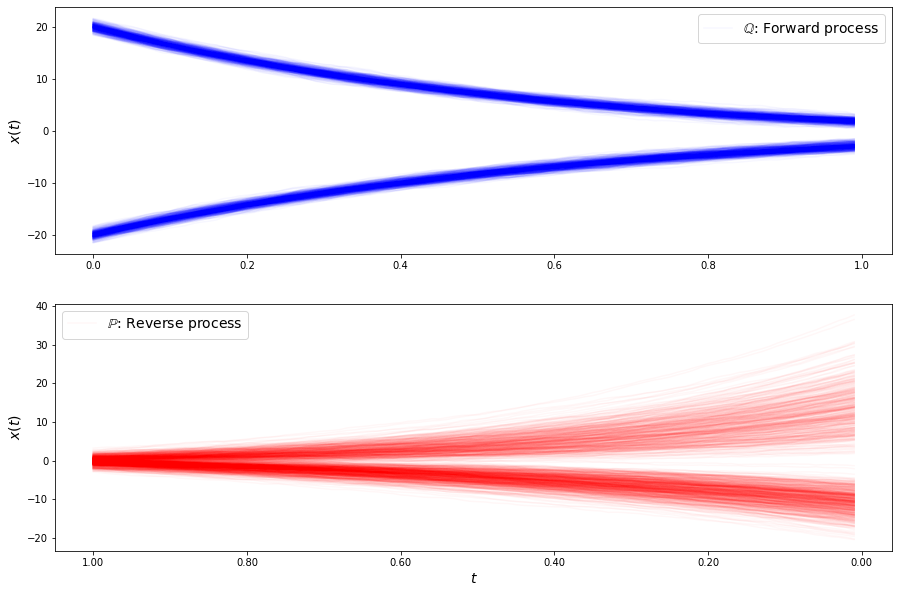

loss b 30.448839955384056
loss b 30.011461636843258
loss b 30.22306875765308
loss b 29.988455917658182
loss b 30.024131837534817
loss b 31.002889393694122
loss b 29.428592727154065
loss b 30.40649499735066
loss b 30.422481630993055
loss b 30.220518839203738
loss b 30.67016118612203
loss b 29.474254733613115
loss b 30.11904901102817
loss b 30.12184803148015
loss b 30.541911308271555
loss b 30.649199184662066
loss b 31.693167295738945
loss b 29.631218116412107
loss b 30.99759143581393
loss b 30.44770331626752
loss b 29.65315842458039
loss b 30.820655273405155
loss b 29.972545990544592
loss b 30.13935726635896
loss b 30.34127579434656
loss b 30.057922543694804
loss b 30.71802772203894
loss b 30.628310798078257
loss b 30.14952375166268
loss b 29.955850389797277
loss f 12.452525831699889
loss f 12.510435947609428
loss f 12.507687915170406
loss f 12.770250237109591
loss f 12.47178484687969
loss f 12.616579403217905
loss f 12.451376001915992
loss f 12.744518598096452
loss f 12.470876083211577

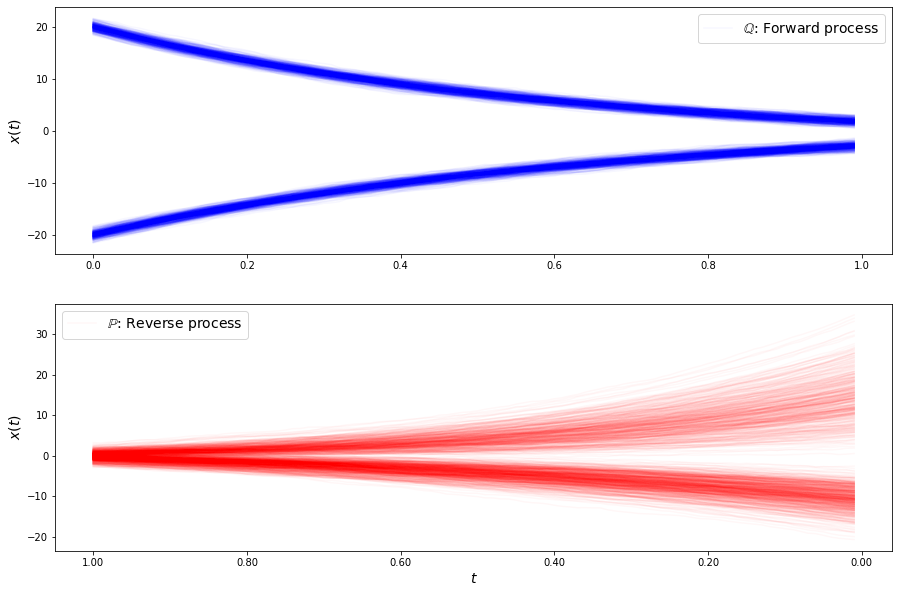

loss b 30.499259388767715
loss b 30.787744751231777
loss b 30.894455418715157
loss b 30.370198215554527
loss b 30.966200990839894
loss b 30.421675365211268
loss b 30.502880246379092
loss b 31.064707149120864
loss b 31.44947544905683
loss b 31.44313969142803
loss b 31.550168014248854
loss b 31.2580911610255
loss b 30.567962241307132
loss b 29.891061332465146
loss b 31.177721673166925
loss b 30.515729145508963
loss b 31.570750954930084
loss b 30.55175297096133
loss b 30.40619997464895
loss b 31.76801192062923
loss b 31.159467648227608
loss b 31.21267320617749
loss b 32.78198551254704
loss b 31.61865074879563
loss b 31.866898991667973
loss b 31.285729206185877
loss b 30.865897504231715
loss b 31.36885799170747
loss b 31.77178158411393
loss b 30.390801051799727
loss f 14.400599699739937
loss f 14.182057155155313
loss f 13.988990848851923
loss f 14.31158983406637
loss f 14.420010692095001
loss f 14.209009961263126
loss f 14.24352713772145
loss f 14.051565168925876
loss f 13.943828104212868


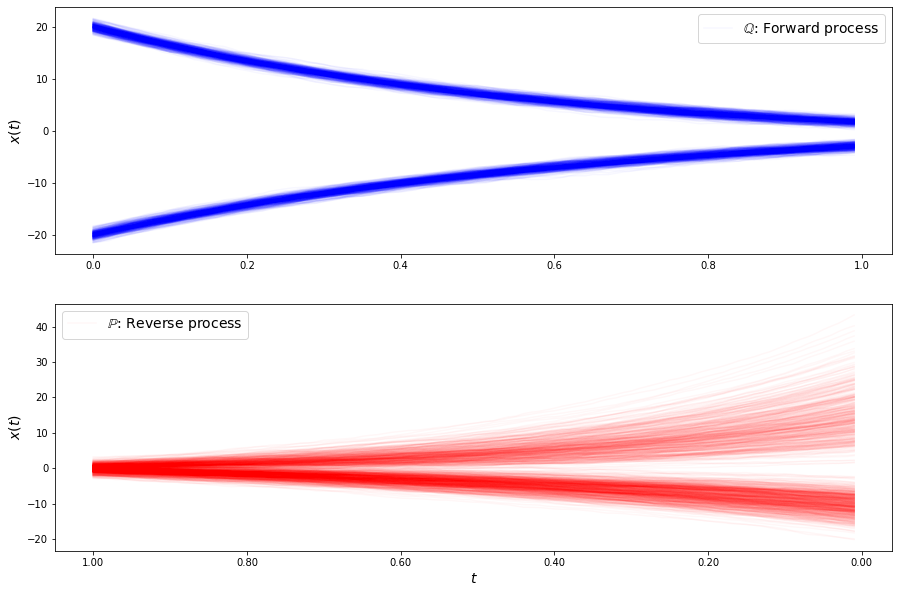

loss b 31.067663211964774
loss b 31.2838216716986
loss b 31.668932510802644
loss b 31.136931801853546
loss b 31.367557572559058
loss b 31.213625935293816
loss b 31.211803214083574
loss b 31.03356521821117
loss b 31.092504328693746
loss b 32.06670290633506
loss b 31.778764844590828
loss b 31.622594208587156
loss b 31.650161285276848
loss b 32.4203311389726
loss b 32.26614473025276
loss b 32.49214185783169
loss b 31.43284840162453
loss b 32.49043134869989
loss b 32.0395111225054
loss b 31.40069824823961
loss b 31.872669788296918
loss b 31.966752154984356
loss b 31.849314906426052
loss b 31.622674440898166
loss b 32.2861269021391
loss b 33.048863098425194
loss b 32.25850663049723
loss b 32.25178451738909
loss b 32.61436280919313
loss b 33.133980073790994
loss f 15.382767034729822
loss f 15.512879234477897
loss f 15.180025413874878
loss f 15.147807944828033
loss f 15.007979630964753
loss f 15.094995736033045
loss f 15.060297429828081
loss f 14.931985842499637
loss f 14.91723839426364
loss 

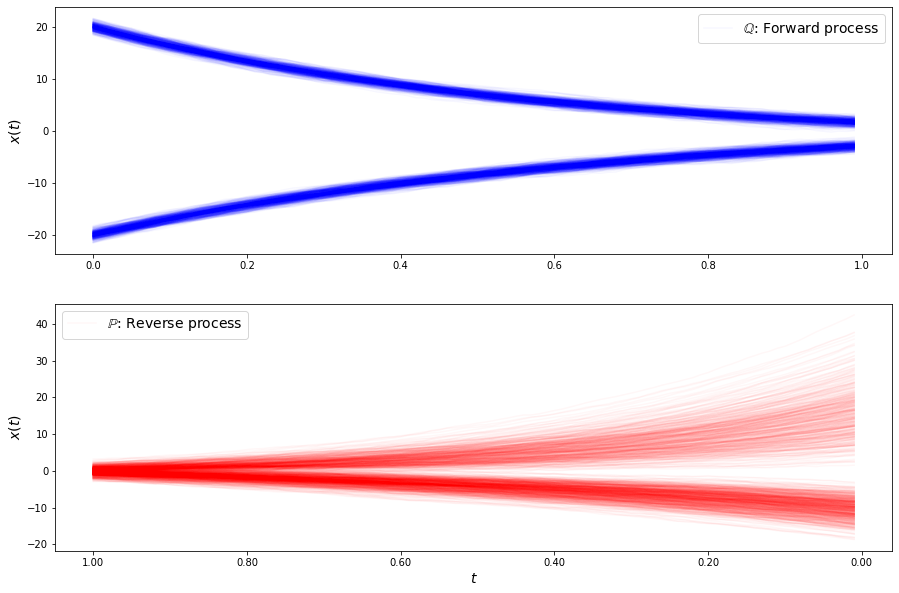

loss b 31.852709253975032
loss b 32.43206307724633
loss b 31.767816096407223
loss b 31.807740157008762
loss b 33.168578011135054
loss b 31.859169632934893
loss b 32.01156545770121
loss b 32.09585429533934
loss b 31.4601475468063
loss b 32.26144744338607
loss b 32.026646339006156
loss b 33.26746032061228
loss b 33.12136725358522
loss b 33.21303994758566
loss b 33.81647357374768
loss b 32.64208820761757
loss b 33.16502320543642
loss b 33.18646684365957
loss b 33.09422274473535
loss b 32.909547077419475
loss b 32.20771355057193
loss b 33.32281262010304
loss b 33.70592822811076
loss b 33.39571520890236
loss b 32.88952268621121
loss b 33.50221501522687
loss b 33.60621227732878
loss b 33.6032273838732
loss b 33.1238468675664
loss b 32.97347413990347
loss f 15.471254663382553
loss f 15.539890913487321
loss f 15.496262457818206
loss f 15.427784491628506
loss f 15.552360887824662
loss f 15.160160134174669
loss f 15.04295327917166
loss f 15.101712188506779
loss f 15.13737054445163
loss f 15.0145

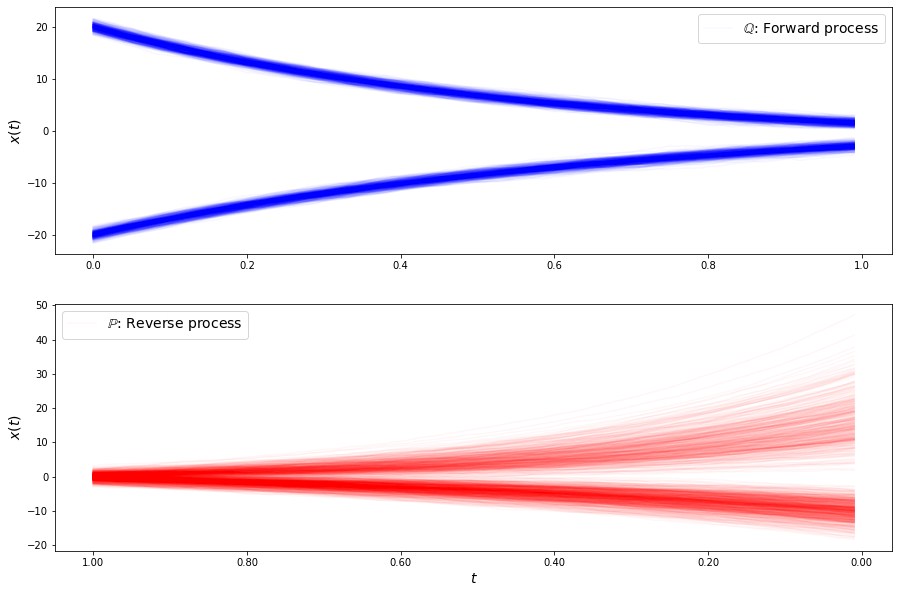

loss b 33.581964832509186
loss b 32.383069502463805
loss b 33.96830072051366
loss b 33.30032752087588
loss b 33.486948965680746
loss b 32.419495885987985
loss b 33.663929137450545
loss b 31.800967366602936
loss b 32.94646191134149
loss b 33.53210944670292
loss b 31.780345634567656
loss b 33.14666714916955
loss b 32.43737305362011
loss b 32.89095002817291
loss b 34.20632683933635
loss b 34.41369343538746
loss b 32.78361053278933
loss b 32.57818477549673
loss b 33.25563902415834
loss b 32.93276965970129
loss b 33.262649204150186
loss b 33.37044090156546
loss b 33.97552405926836
loss b 33.92761523526561
loss b 32.98920985280977
loss b 33.9743285605801
loss b 33.06156176876782
loss b 34.6359237550083
loss b 33.80460026458316
loss b 33.22189235879175
loss f 15.068917309162396
loss f 14.847782338964551
loss f 14.88203321396716
loss f 14.421473366221528
loss f 14.812439351077417
loss f 14.78768443027761
loss f 14.438044022950917
loss f 14.31264256742601
loss f 14.325711129165967
loss f 14.105

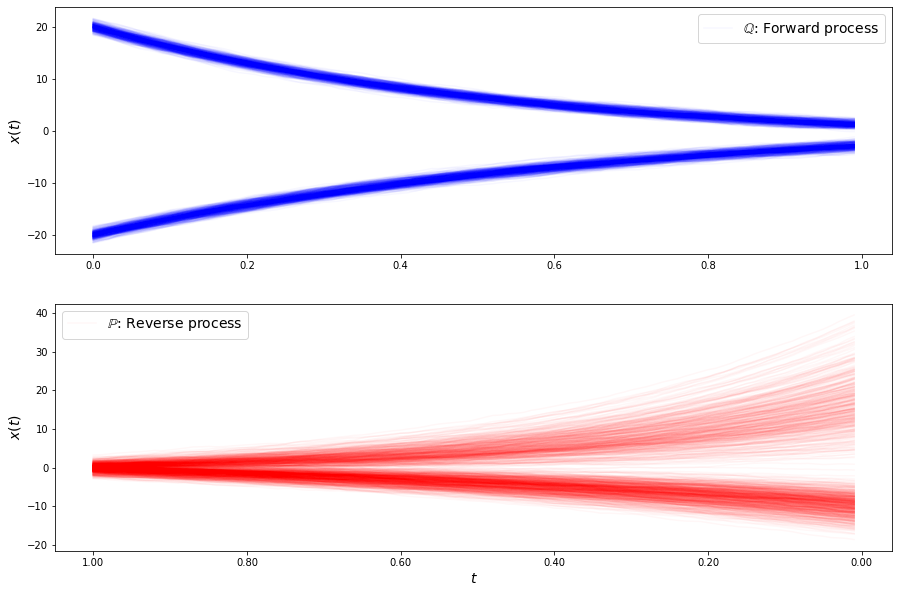

loss b 32.7583705958097
loss b 32.3522911368555
loss b 32.26056646303693
loss b 33.40652685469299
loss b 31.84327923502419
loss b 34.35536670851604
loss b 32.65922617535798
loss b 33.13974803723837
loss b 33.86671215140172
loss b 31.97762619147431
loss b 33.15639226275505
loss b 33.03843070000798
loss b 33.602377965446074
loss b 33.34290381767463
loss b 33.530858239927845
loss b 33.41251296856709
loss b 34.63441389735814
loss b 33.25624831513249
loss b 33.10860465172514
loss b 32.403589946431644
loss b 32.238901809529246
loss b 32.61572684602434
loss b 32.87190032203775
loss b 33.303222367033705
loss b 33.849581402201025
loss b 33.71517931807504
loss b 33.54288386562728
loss b 33.17271137795738
loss b 33.93294912294763
loss b 32.34613551499704
loss f 13.596515103027645
loss f 13.4277805390976
loss f 13.372513484370408
loss f 13.484138871961031
loss f 13.415975789046005
loss f 13.111328945730524
loss f 13.212966917609572
loss f 13.101880601661671
loss f 12.801719247384892
loss f 12.7743

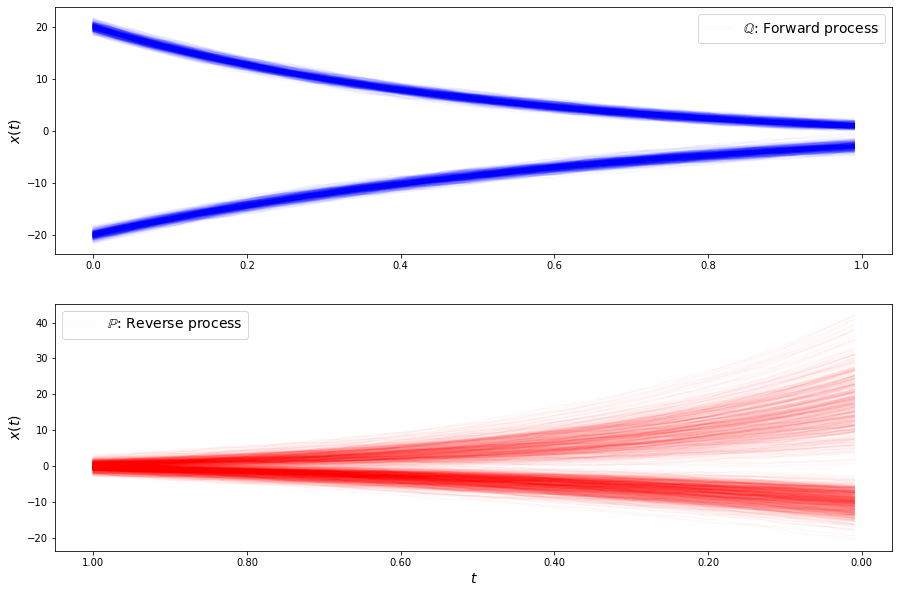

loss b 32.58710992050446
loss b 32.56501705741673
loss b 32.7365654466287
loss b 33.00519974750908
loss b 32.57903397817719
loss b 33.323736023376966
loss b 32.74374307036341
loss b 32.854066411916875
loss b 33.110178849299565
loss b 33.396469699323546
loss b 33.44088069558251
loss b 32.976780740561274
loss b 32.94187029582219
loss b 34.051519863891606
loss b 33.260170174146666
loss b 33.45822231245563
loss b 32.490349817387546
loss b 33.77153952775677
loss b 32.61154557360226
loss b 33.00552652010174
loss b 33.60163471276944
loss b 33.52547837167839
loss b 33.47662634388562
loss b 34.384018493232496
loss b 33.35562399822056
loss b 33.35412868121557
loss b 32.39725169384994
loss b 32.02463792998743
loss b 32.59193631281503
loss b 33.7760823648969
loss f 12.02352025331229
loss f 11.873185224793007
loss f 11.898152404195358
loss f 11.87825033232712
loss f 11.70687631782356
loss f 11.632722248685575
loss f 11.525638654783435
loss f 11.330278283005438
loss f 11.083134562975275
loss f 11.39

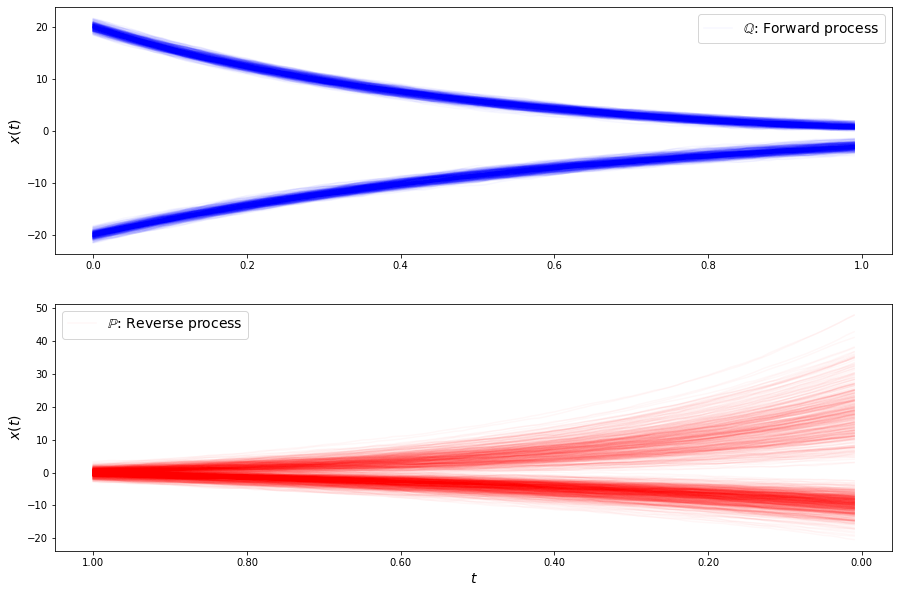

loss b 32.3253196830738
loss b 32.419034487266096
loss b 32.53983694505306
loss b 32.48269790379162
loss b 31.750781005237673
loss b 32.319562513742994
loss b 32.61339156400364
loss b 32.27827212417304
loss b 32.95445578182424
loss b 32.24616296592792
loss b 32.80652412009015
loss b 32.57661501025965
loss b 32.36399594026706
loss b 33.21177141174171
loss b 33.63137012805792
loss b 33.121183245889746
loss b 32.44347725033812
loss b 32.9216914857777
loss b 32.214235840622344
loss b 33.28338637478098
loss b 33.00151970320215
loss b 32.958112037185685
loss b 32.75854895544194
loss b 33.20782350191014
loss b 32.84414649863884
loss b 33.30924659580847
loss b 32.61451551884457
loss b 33.67858821224132
loss b 33.07305036310489
loss b 32.4299534147622
loss f 10.688669662558334
loss f 10.522178527517895
loss f 10.464782727744423
loss f 10.3872249483656
loss f 10.312952026573004
loss f 10.596111182343153
loss f 10.403250738465049
loss f 10.293602648294577
loss f 10.191833400430518
loss f 10.34768

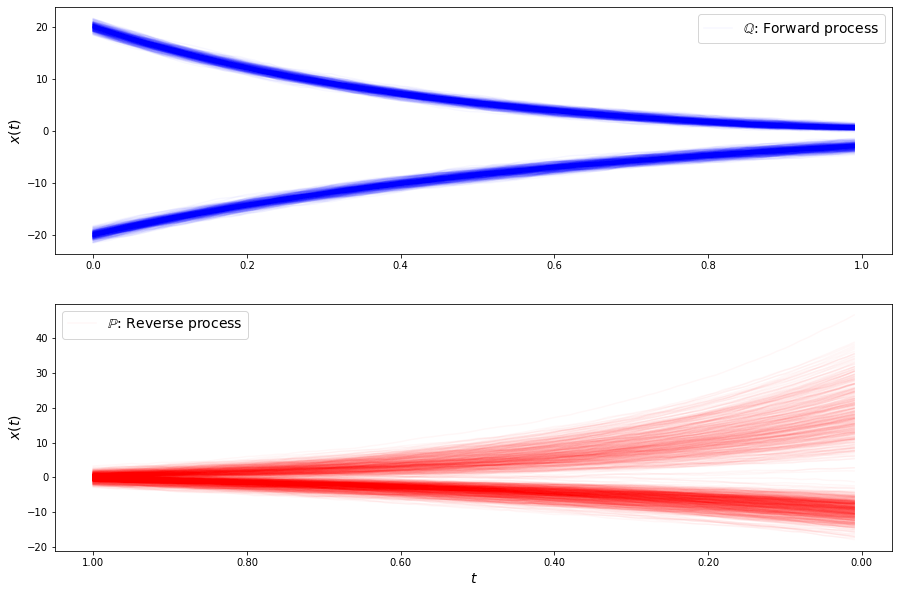

loss b 31.788745956661405
loss b 30.366426264009256
loss b 32.16898132771735
loss b 32.76683388294516
loss b 31.456104520184848
loss b 32.08733144513333
loss b 32.57032057686312
loss b 32.16671758217274
loss b 32.13319825417848
loss b 32.241567136060915
loss b 32.355192803985815
loss b 31.960540232835864
loss b 31.3788578527173
loss b 32.531097853809186
loss b 32.01914051472428
loss b 32.2932115013898
loss b 32.12295119431706
loss b 32.046641171039234
loss b 32.2869319266149
loss b 32.235050962977645
loss b 31.923978759003212
loss b 32.84428012483388
loss b 33.98181335707062
loss b 32.19035646836597
loss b 32.39655335017267
loss b 32.37242086604257
loss b 33.08464946616754
loss b 32.92592195087774
loss b 33.428289170057305
loss b 32.57656141522827
loss f 9.62269708126927
loss f 9.62782467926035
loss f 9.600862951007294
loss f 9.708481633865501
loss f 9.632368834903863
loss f 9.580295128941069
loss f 9.497364865189773
loss f 9.40095763717516
loss f 9.491379639948962
loss f 9.27255263490

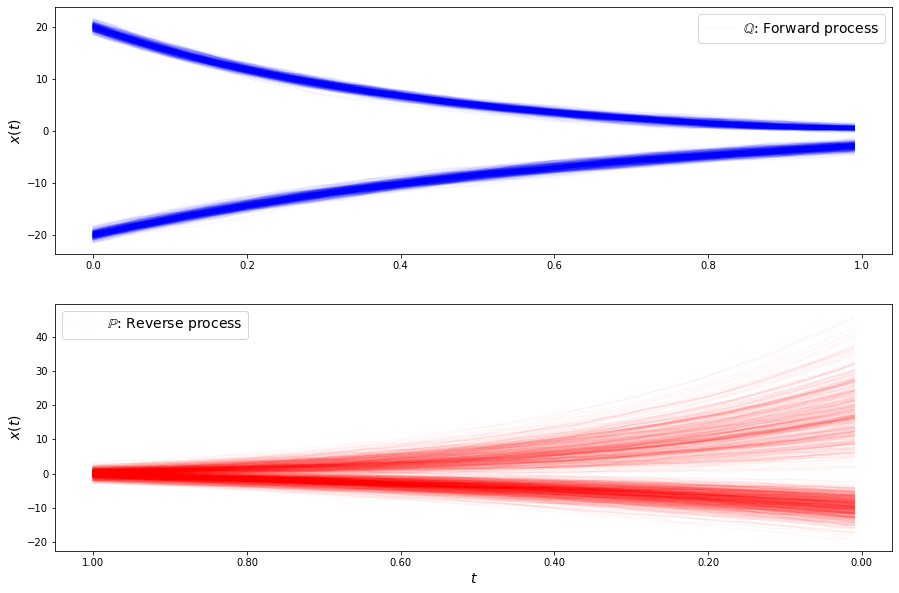

loss b 33.203275937361745
loss b 32.856648459919064
loss b 31.986068333423606
loss b 33.12913398027366
loss b 32.42955760889266
loss b 32.075160390584095
loss b 32.12190384735051
loss b 32.20136757396435
loss b 31.770448922409106
loss b 32.15365949634685
loss b 32.253560658464544
loss b 31.476946015801918
loss b 32.9695820310294
loss b 31.78823370583636
loss b 32.088819634193165
loss b 31.873201248903896
loss b 32.909871265755946
loss b 31.9633529981327
loss b 32.44268391614846
loss b 32.91211529016691
loss b 30.60967131914624
loss b 32.304407463909186
loss b 32.158113128667765
loss b 32.73658631716024
loss b 31.89232439797216
loss b 32.077593228309645
loss b 32.89809936104909
loss b 31.429647544803434
loss b 33.177888994112536
loss b 32.186372978053896
loss f 9.452141185429424
loss f 9.186732183336822
loss f 9.316045192944738
loss f 9.30805521217002
loss f 9.327245048327189
loss f 9.37319067127919
loss f 9.335237433723249
loss f 9.331533288208389
loss f 9.348671207985566
loss f 9.4180

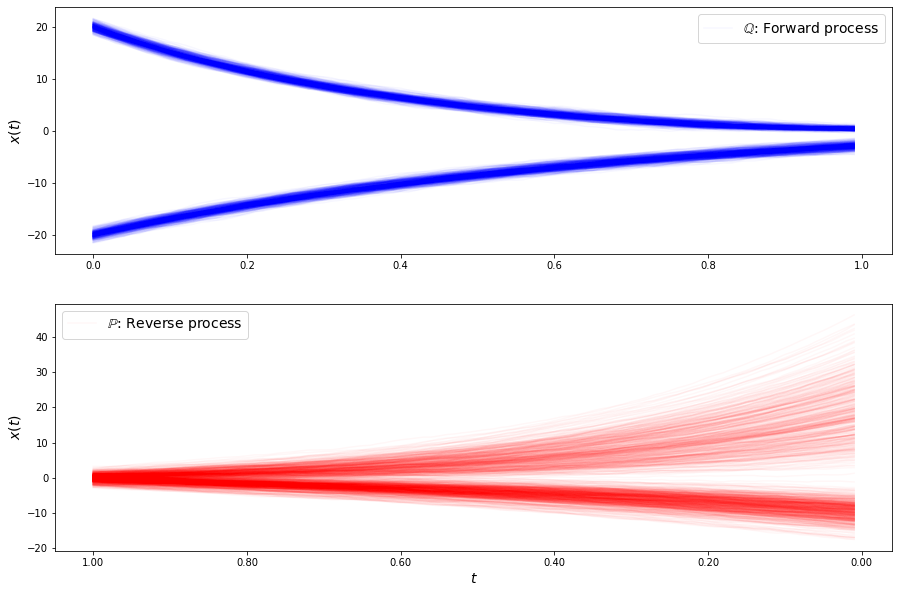

loss b 33.377433328476464
loss b 32.53734088118356
loss b 32.48982456222803
loss b 32.74345594060579
loss b 32.632449655711895
loss b 32.89298536305185
loss b 32.3051046178624
loss b 33.45950957671809
loss b 32.28755809341251
loss b 34.09219872538497
loss b 33.29148656291485
loss b 33.01191498364979
loss b 33.340102188244515
loss b 33.516194668333824
loss b 33.180698026676886
loss b 32.997990460097704
loss b 32.763387487305444
loss b 32.26664813577309
loss b 32.558476158484865
loss b 32.898287461257596
loss b 32.93156475447822
loss b 31.75222644427102
loss b 33.653352147934065
loss b 32.42681403905304
loss b 31.38994482571819
loss b 31.61038232987487
loss b 32.825540780974215
loss b 32.29704884708771
loss b 33.766405597198535
loss b 33.10321058642196
loss f 9.665913363397712
loss f 9.67501253729437
loss f 9.640673246981308
loss f 9.51407445577931
loss f 9.858991543428724
loss f 9.514997345325476
loss f 9.635100351332543
loss f 9.6833141044151
loss f 9.617210623615907
loss f 9.461514575

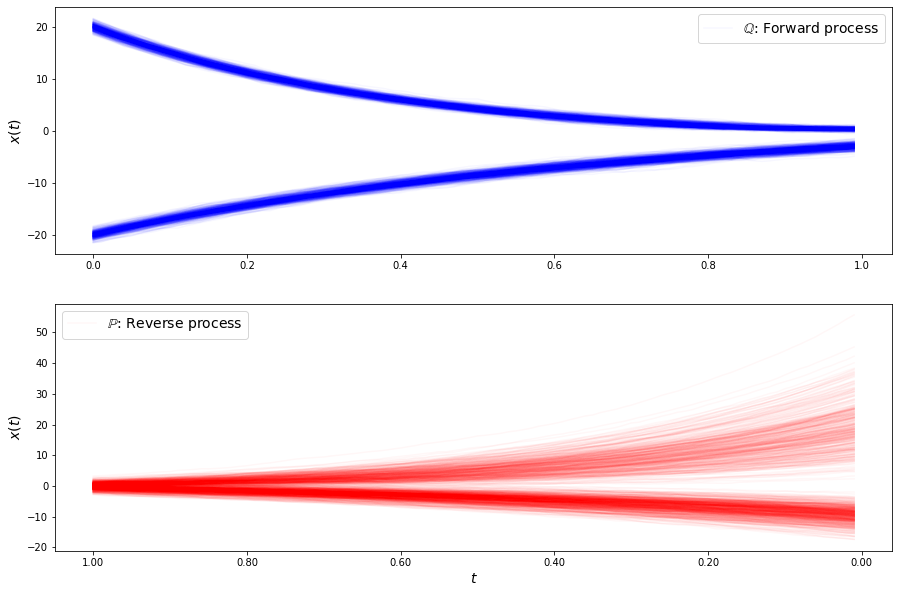

loss b 32.92878834087755
loss b 33.48381725087058
loss b 33.976470178310414
loss b 33.12581452599262
loss b 32.836006907468175
loss b 32.90201583591768
loss b 32.97339501949709
loss b 33.21411739801337
loss b 33.770816825832526
loss b 33.4462346732067
loss b 32.57684278326158
loss b 33.24123047649856
loss b 32.8546133850527
loss b 34.154996918680396
loss b 32.79593367536535
loss b 32.47446107901008
loss b 33.74162942961746
loss b 33.493447427657216
loss b 33.22805064453572
loss b 34.92489700613934
loss b 33.641331356478034
loss b 32.51600077880083
loss b 33.43943883537461
loss b 33.29318870182006
loss b 34.14369300667534
loss b 33.40410088963807
loss b 33.70699914388629
loss b 32.990552083062695
loss b 33.02567985811393
loss b 33.19225988873956
loss f 10.017111878597985
loss f 10.30520234747301
loss f 10.263177423218439
loss f 10.212386610432034
loss f 10.145865966776837
loss f 10.250861145422848
loss f 10.515400518938067
loss f 10.34035469167015
loss f 10.383294063728389
loss f 10.560

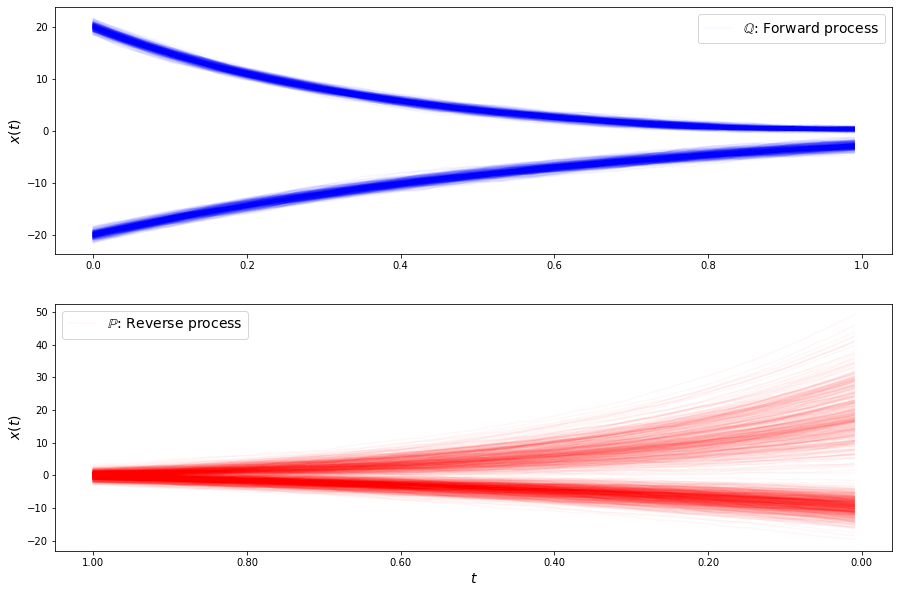

loss b 34.22170530826976
loss b 34.5806294320445
loss b 34.19384537503085
loss b 34.63600352656213
loss b 33.98034340384683
loss b 34.75592210157746
loss b 34.27163485631248
loss b 34.449373382286915
loss b 34.08119188766548
loss b 33.83931749261673
loss b 34.39036763414198
loss b 33.852996399989216
loss b 34.47189551215861
loss b 35.02487480333397
loss b 34.81545389477147
loss b 34.51965907938995
loss b 34.21245272643908
loss b 35.18160011023203
loss b 35.128921285307456
loss b 34.879819858874164
loss b 34.829671112238344
loss b 34.86327478526246
loss b 34.76765355946947
loss b 35.616601130847286
loss b 33.98896079209937
loss b 34.72243370143408
loss b 34.01296540376117
loss b 35.54292821705152
loss b 34.5369511792306
loss b 34.64597949150513
loss f 11.290084087454492
loss f 11.284557131011905
loss f 11.301916389338787
loss f 11.47262955057346
loss f 11.278915299755043
loss f 11.505202765514223
loss f 11.584478920055242
loss f 11.52417601181502
loss f 11.511994867549284
loss f 11.6584

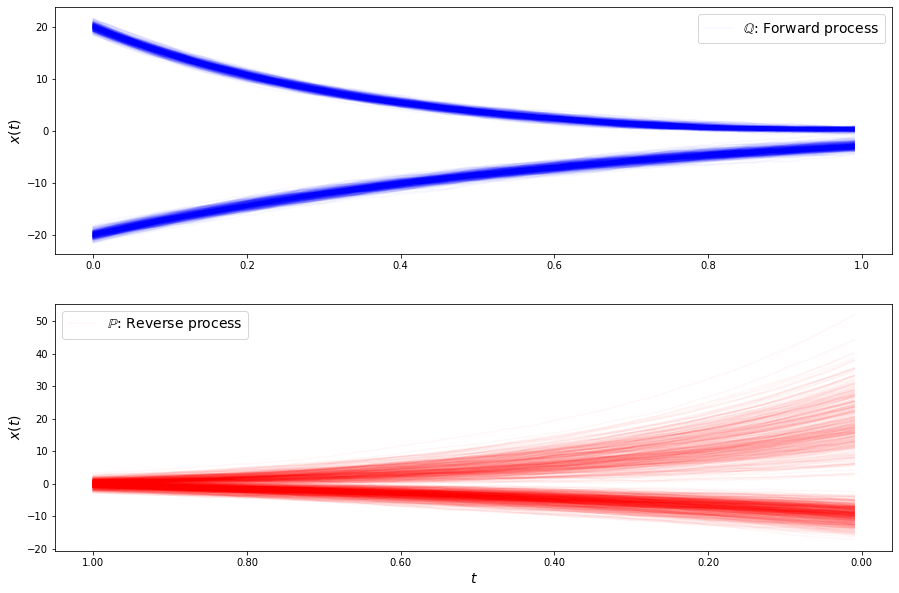

loss b 36.240189212280285
loss b 36.11563998436055
loss b 35.613742838164804
loss b 36.469933391865446
loss b 35.07477526988576
loss b 36.72786830720204
loss b 35.48005295883259
loss b 35.418221754014866
loss b 35.65535245379406
loss b 36.25217548803514
loss b 36.299176248814376
loss b 34.3254580815394
loss b 36.15427550742663
loss b 36.55980946301612
loss b 35.33670036936912
loss b 36.59308866793452
loss b 35.681212496087284
loss b 35.52354038292444
loss b 34.85957929312066
loss b 35.280861006079704
loss b 34.719659072040926
loss b 36.54968672281415
loss b 36.243713097946525
loss b 35.39400799710601
loss b 35.685834820595225
loss b 36.089104941034805
loss b 35.431927059177106
loss b 36.37750657521103
loss b 36.754073023240025
loss b 36.62755484620171
loss f 12.35486324659767
loss f 12.48983694381527
loss f 12.601322168740664
loss f 12.515176793846702
loss f 12.501785868491474
loss f 12.501241037375967
loss f 12.528661181767205
loss f 12.534744083914722
loss f 12.73538536855745
loss f 

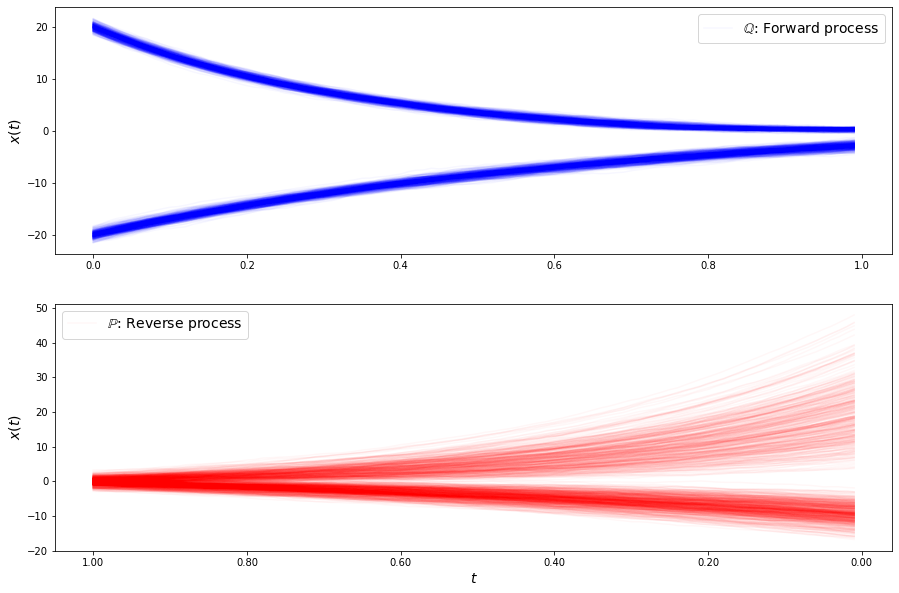

loss b 37.22936254149316
loss b 37.11109320519702
loss b 37.422946640446376
loss b 37.224370814229225
loss b 37.469284150573245
loss b 37.72062057079629
loss b 36.687045917338615
loss b 35.98098484769931
loss b 36.91946997381195
loss b 38.3047417434385
loss b 37.461931324730685
loss b 38.65002065022083
loss b 37.85361668122829
loss b 37.53644255336754
loss b 38.764705041272634
loss b 37.00943484512632
loss b 36.998869715340994
loss b 36.39524165816711
loss b 36.482305883333474
loss b 37.56424893176824
loss b 37.29559820886279
loss b 37.110047198273556
loss b 37.42601573272485
loss b 38.064575031264376
loss b 38.10280757842119
loss b 38.13774236144687
loss b 37.8597082410697
loss b 38.53211859496819
loss b 36.71878185910512
loss b 37.55293409348607
loss f 13.537445180393101
loss f 13.425640263994408
loss f 13.3250851966691
loss f 13.542270523508149
loss f 13.472377559503391
loss f 13.382059708015571
loss f 13.550216401451161
loss f 13.615290014326284
loss f 13.53862682804712
loss f 13.6

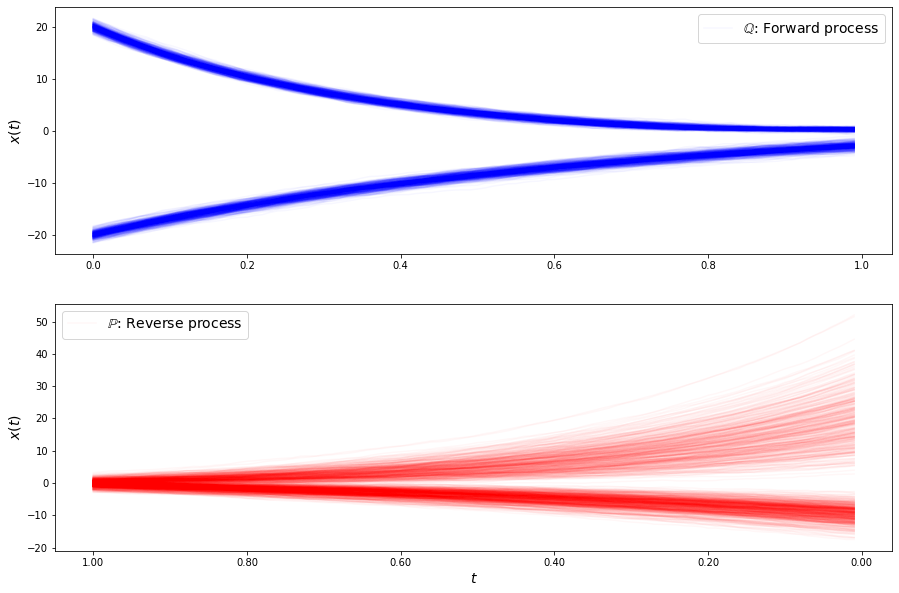

loss b 37.73093929953388
loss b 38.24755956029242
loss b 38.46454756722007
loss b 39.3266252675428
loss b 38.58893664105426
loss b 39.10661321154902
loss b 38.58362755176878
loss b 38.58374515642216
loss b 38.15250278172593
loss b 39.22376850475499
loss b 38.794223305611396
loss b 38.55442345390007
loss b 38.2567544193527
loss b 38.9314415045406
loss b 39.72990743827876
loss b 39.508222118729414
loss b 38.73262107163623
loss b 38.40542627371309
loss b 38.73970054328645
loss b 38.66411815295068
loss b 39.14302215090284
loss b 38.7318493944754
loss b 37.649820363372136
loss b 38.4964630205607
loss b 37.9627090795726
loss b 39.62431926317464
loss b 38.69432653417617
loss b 37.95928898457772
loss b 39.10497947532974
loss b 38.241332769171706
loss f 14.331801592147954
loss f 14.304655988278398
loss f 14.368553027686385
loss f 14.143980591038455
loss f 14.410889280024548
loss f 14.324786204487905
loss f 14.2866449449072
loss f 14.58442678512758
loss f 14.431818124574505
loss f 14.66327958288

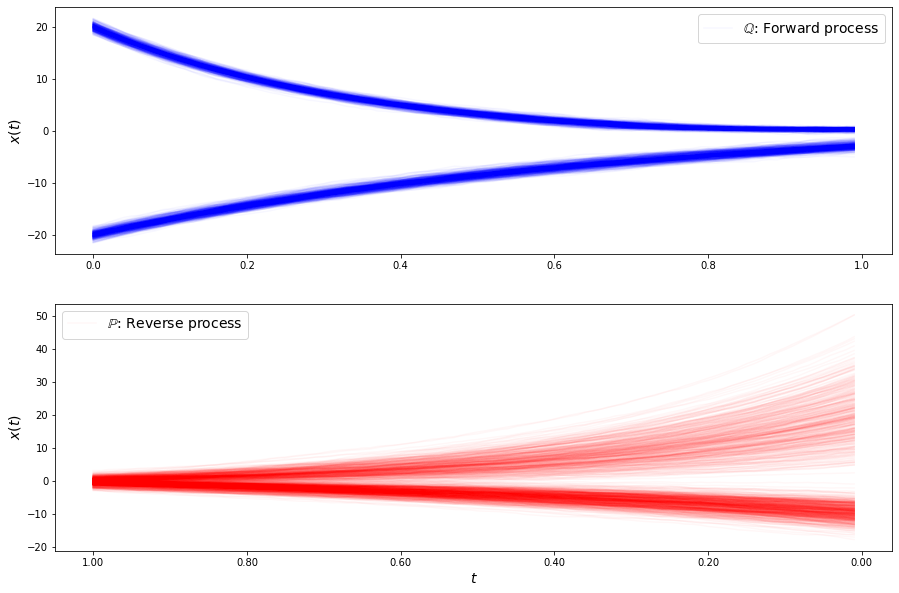

loss b 39.427833748558776
loss b 40.37121254860488
loss b 40.148335491659424
loss b 39.69600671029492
loss b 39.93945831396147
loss b 39.176645266959696
loss b 40.7244482328367
loss b 40.76381054907968
loss b 40.13392165975615
loss b 38.85312502674221
loss b 39.73660757839864
loss b 39.570736007217796
loss b 40.545097813200215
loss b 38.504498936805305
loss b 40.342191554404614
loss b 38.99165259962392
loss b 39.77462929065105
loss b 41.22676156270068
loss b 40.056168847732835
loss b 40.735315094292694
loss b 38.79298692451287
loss b 39.97022418939489
loss b 40.648813732452766
loss b 39.26499201296171
loss b 38.59311395518269
loss b 38.9566483210988
loss b 39.08619419065566
loss b 41.292719497870586
loss b 40.76266212477874
loss b 40.87168089361592
loss f 14.540102229732254
loss f 14.633650138404036
loss f 14.725748626592287
loss f 14.782492930893829
loss f 14.706141185662133
loss f 14.764072579219734
loss f 14.71733686283598
loss f 14.866371989261856
loss f 14.924320793924627
loss f 1

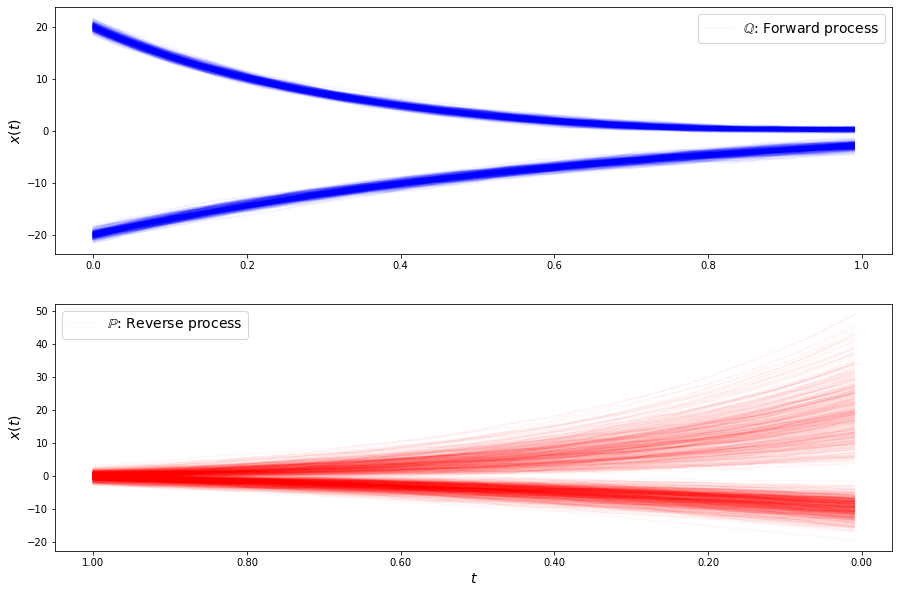

loss b 38.9323572289035
loss b 39.92902251156891
loss b 41.886730931757064
loss b 41.1811187221739
loss b 39.215814998835405
loss b 40.87376572556483
loss b 40.433350483811125
loss b 39.51467078737515
loss b 39.599718787945385
loss b 39.46754637705595
loss b 41.36479959649883
loss b 40.895624839068226
loss b 40.12885404153082
loss b 41.214641562954256
loss b 40.56939235719982
loss b 41.12682389429248
loss b 39.52350801374836
loss b 41.131683165831035
loss b 40.89628473273291
loss b 40.56619908085552
loss b 40.476694416375395
loss b 40.632561847600364
loss b 40.14935112154251
loss b 41.16946310598506
loss b 39.91145747227577
loss b 40.751511256894304
loss b 39.87975003140227
loss b 41.20334599052335
loss b 40.34513733987842
loss b 40.98559328192424
loss f 14.927794895727548
loss f 14.881488551341867
loss f 14.805431877235177
loss f 14.696077759658948
loss f 14.712455543601909
loss f 15.087808483105617
loss f 14.81026423984733
loss f 14.832880855577727
loss f 14.808930618680785
loss f 14

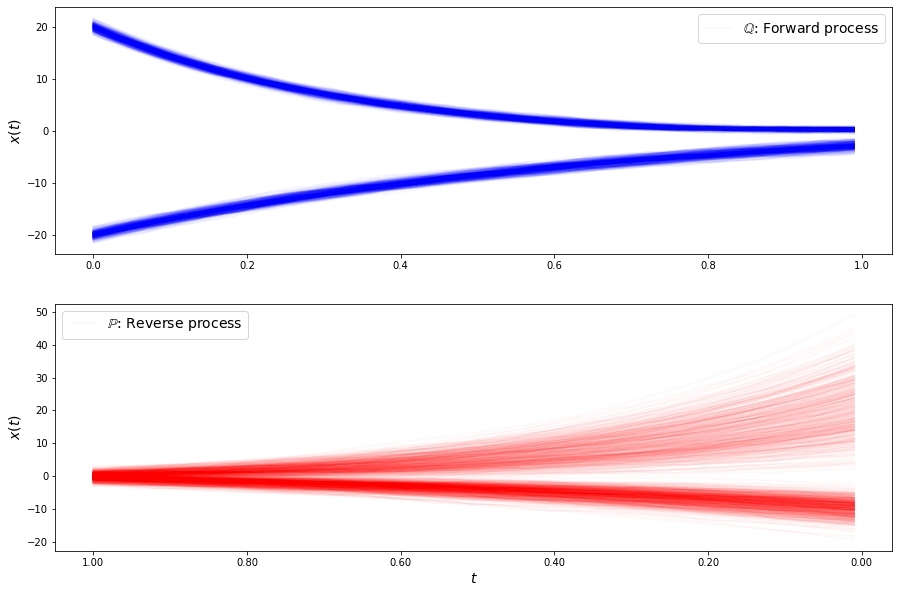

loss b 40.80563199119149
loss b 40.72110441769044
loss b 40.84156912035864
loss b 40.10594759056694
loss b 40.0229351890761
loss b 39.8117900617173
loss b 39.61547642414322
loss b 41.03756596531962
loss b 40.12076894840484
loss b 40.34977928310147
loss b 40.725512974721234
loss b 40.55271282267201
loss b 40.27866296531956
loss b 39.833873184820696
loss b 40.21331297908194
loss b 39.59237954663535
loss b 40.083815557669794
loss b 39.82601238815567
loss b 40.99983630707153
loss b 40.28065464024902
loss b 41.58849120011265
loss b 40.73961548658563
loss b 39.93867813565508
loss b 40.56998856073974
loss b 39.96092058001369
loss b 39.78324817302797
loss b 40.94217920105219
loss b 40.976723881614895
loss b 40.5476179523953
loss b 41.60143653585134
loss f 14.342447668277089
loss f 14.435059374803677
loss f 14.425636213917198
loss f 14.562578540763523
loss f 14.462696433999573
loss f 14.276877381561857
loss f 14.35153724197445
loss f 14.401513084126893
loss f 14.29771178837072
loss f 14.3237487

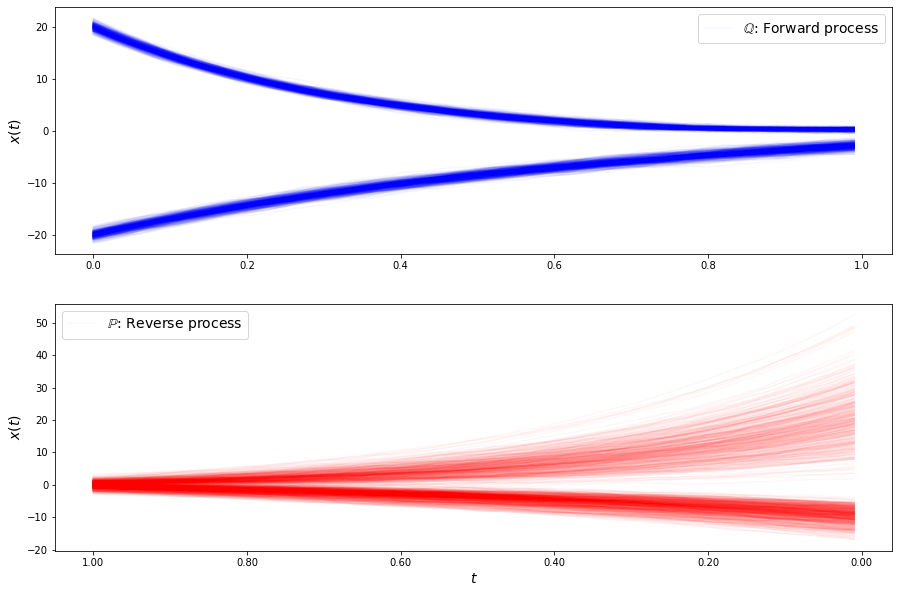

loss b 40.27100719494422
loss b 40.09222374889476
loss b 42.76639649341998
loss b 40.82418206917251
loss b 40.99438381469275
loss b 38.97561912556272
loss b 40.72129011855012
loss b 41.11071818393118
loss b 39.29810580020586
loss b 40.70827288839153
loss b 39.49850231885962
loss b 39.271849426454466
loss b 40.585653880682905
loss b 40.59179614881695
loss b 40.64084098838374
loss b 39.94577399478936
loss b 40.96778669257302
loss b 39.51200027683681
loss b 39.3790824771335
loss b 40.78561625831821
loss b 39.473599651291934
loss b 39.39378568475553
loss b 38.837522462708684
loss b 41.184643084893516
loss b 39.64220966911222
loss b 39.990137448867294
loss b 39.99801724244534
loss b 41.246674561553085
loss b 39.75872401272085
loss b 41.5002103247952
loss f 13.48705616436721
loss f 13.443723990700933
loss f 13.495761536043732
loss f 13.734326232779337
loss f 13.698994115643591
loss f 13.674580544589832
loss f 13.551348037322166
loss f 13.564583455397637
loss f 13.422556834175042
loss f 13.57

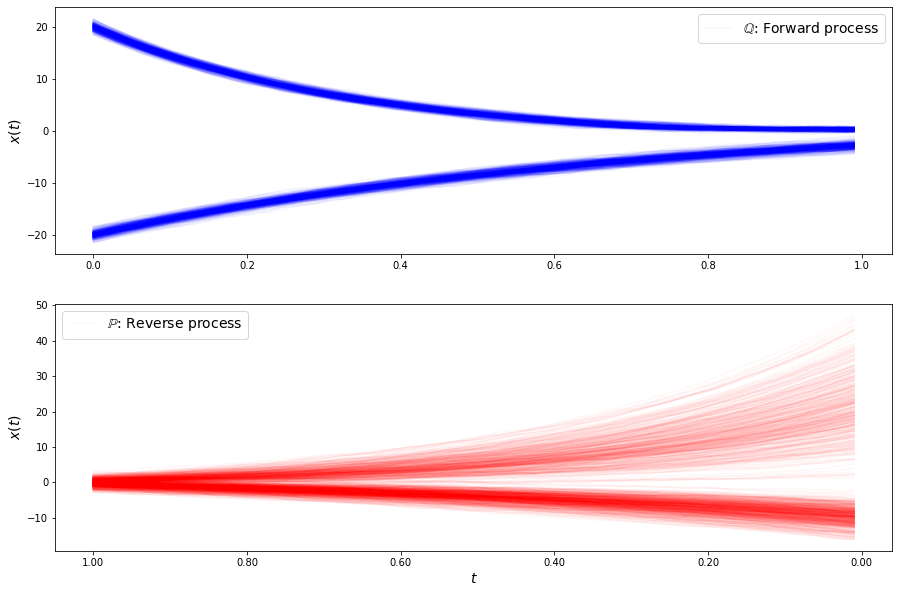

loss b 38.63616536115364
loss b 40.0660263416772
loss b 40.27827005632768
loss b 40.01460324685187
loss b 38.339130240321694
loss b 39.571389973791995
loss b 39.05595778646968
loss b 38.412839142724856
loss b 38.84941653183039
loss b 41.05113626735909
loss b 38.47500832916815
loss b 40.63888500179218
loss b 40.45778220296297
loss b 39.37127949962224
loss b 39.90066245922611
loss b 38.61119152564227
loss b 39.42465196377701
loss b 39.03527143441574
loss b 38.300223651119424
loss b 40.84602821034409
loss b 38.96893080835341
loss b 38.6741656238757
loss b 38.59784534993526
loss b 38.96912983161196
loss b 39.34783736577793
loss b 39.13852138025307
loss b 40.44841243444687
loss f 12.664210479444911
loss f 12.45546273564269
loss f 12.771348001632068
loss f 12.50613866964511
loss f 12.712011267380866
loss f 12.545717582297868
loss f 12.520851321577364
loss f 12.588531886836755
loss f 12.433964025156406
loss f 12.408726231736374
loss f 12.68080922388947
loss f 12.494648544659182
loss f 12.4822

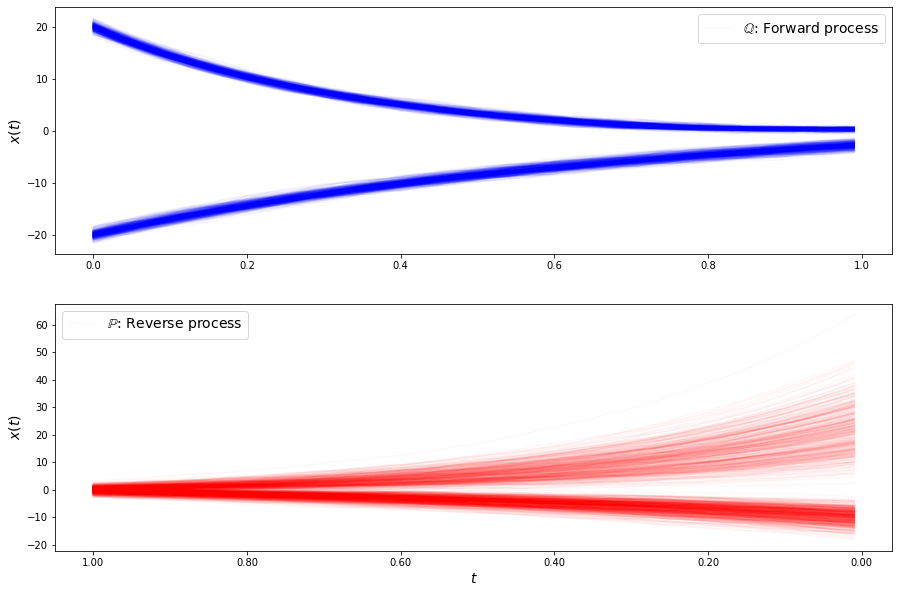

loss b 38.01550594992633
loss b 38.665842969593584
loss b 38.75226492156849
loss b 40.00315743361055
loss b 39.32428518500535
loss b 37.743019441503414
loss b 37.02548315885311
loss b 39.212681089821864
loss b 37.46287650491138
loss b 38.67508763728957
loss b 38.9678450019295
loss b 38.79313997668081
loss b 38.90329518864144
loss b 37.981192257515524
loss b 39.80061377783907
loss b 39.934396485576976
loss b 38.675019228842686
loss b 38.486169115437896
loss b 39.296963842982464
loss b 36.62985563734411
loss b 39.82741405854858
loss b 38.347885239044494
loss b 39.24988532022163
loss b 40.47755915551845
loss b 39.42270255819813
loss b 38.503481061484116
loss b 38.77337911039488
loss b 38.21817756867378
loss b 37.99471847175763
loss b 40.12394566116259
loss f 11.574934812827909
loss f 11.267342623378466
loss f 11.295960286138852
loss f 11.175546228027201
loss f 11.275534924605255
loss f 11.249381161801093
loss f 11.219973020595562
loss f 11.316969524878285
loss f 11.228553162852005
loss f 

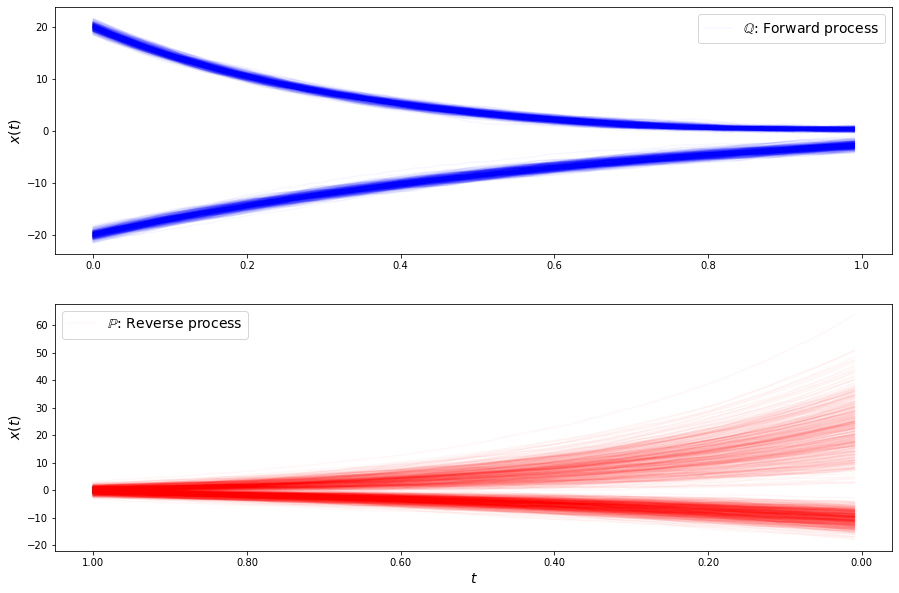

loss b 35.94923225933939
loss b 37.92217248834311
loss b 36.32810737327146
loss b 38.796415715780434
loss b 38.43131603528772
loss b 36.76100472251987
loss b 38.47914179788147
loss b 38.68375967008385
loss b 35.4326088315317
loss b 38.35953118032051
loss b 38.492296436392834
loss b 39.209055969862106
loss b 37.715445240434626
loss b 35.96639039004627
loss b 37.8544741832181
loss b 38.95685022015007
loss b 37.939521922651544
loss b 39.073999746572255
loss b 38.57227834655798
loss b 38.9019808168108
loss b 37.014339518548134
loss b 39.0743684981567
loss b 39.795532328197176
loss b 37.809856677573386
loss b 36.44388114720082
loss b 37.80883631388113
loss b 37.99543867195466
loss b 38.076746248736065
loss b 38.15605377878898
loss b 37.103688117804026
loss f 10.452834162809324
loss f 10.245837045833895
loss f 9.88409948955461
loss f 10.234464242173164
loss f 10.048581801319884
loss f 10.066982238818069
loss f 10.187630069778553
loss f 10.121001205271105
loss f 10.055132874957438
loss f 9.83

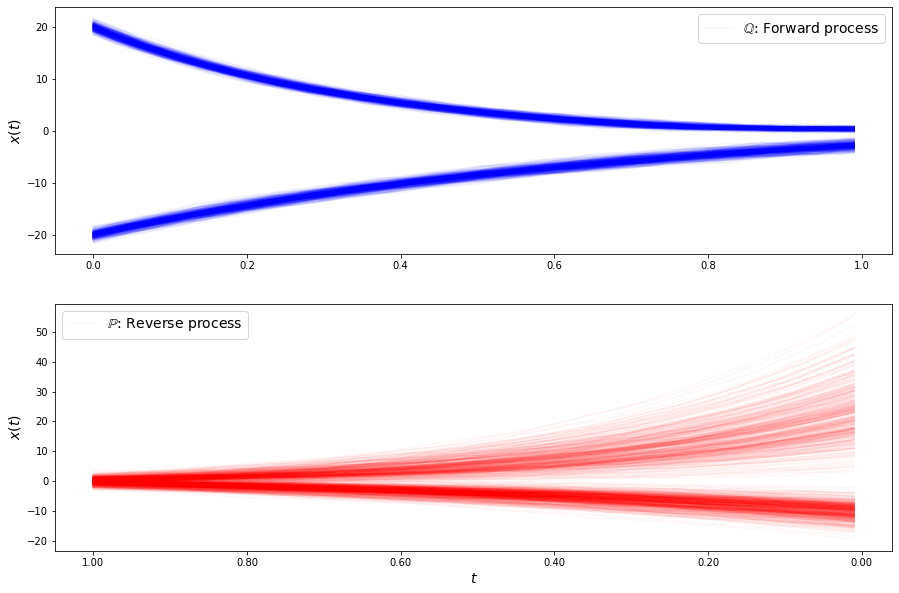

loss b 36.351224932440665
loss b 36.89042658837854
loss b 35.00954731896967
loss b 37.19690421823198
loss b 36.90664651073335
loss b 36.909946245520636
loss b 36.11280752490728
loss b 36.094907836161994
loss b 36.53676099254454
loss b 35.74093146005186
loss b 36.44325628490316
loss b 38.213213701511194
loss b 36.48625366295887
loss b 36.442230586253686
loss b 38.235408662646684
loss b 35.85882873885242
loss b 36.01964556356258
loss b 36.95235843173952
loss b 36.133051145832454
loss b 36.22453132071159
loss b 36.92261794348141
loss b 36.326729464747885
loss b 37.32515984123711
loss b 36.6661545715189
loss b 36.440864146119516
loss b 35.92051267575107
loss b 36.65412685339892
loss b 36.447072553518325
loss b 37.953671333059845
loss b 37.22994789305147
loss f 9.110357690345317
loss f 9.022598208936612
loss f 8.9403482762052
loss f 9.016055599304089
loss f 8.925829540683555
loss f 8.991847393925179
loss f 8.936559676976476
loss f 8.853321959647095
loss f 9.050913771120527
loss f 8.91238635

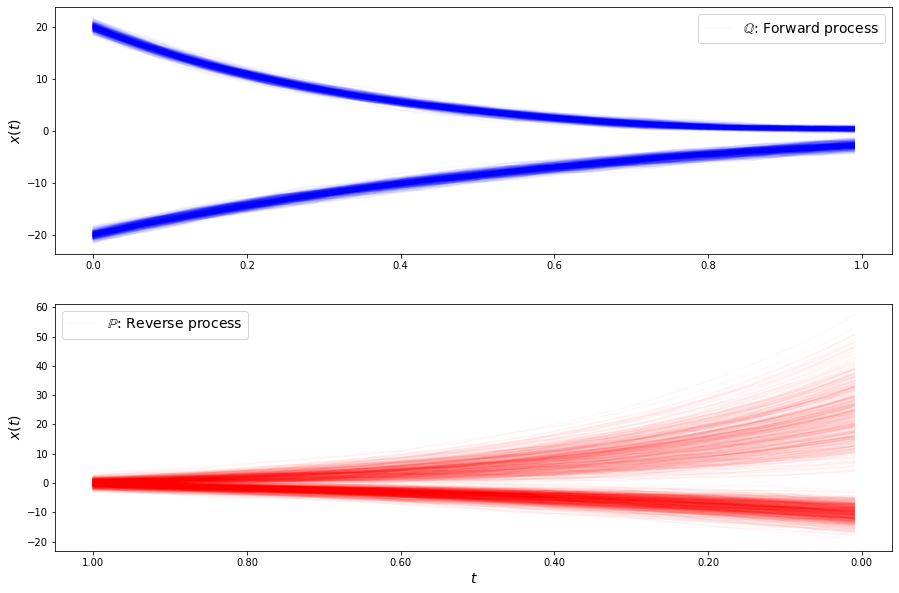

loss b 35.56017058088517
loss b 34.55671843817988
loss b 37.376989161003955
loss b 35.456569690519956
loss b 36.19308816356747
loss b 34.705940970568456
loss b 36.1342134740143
loss b 36.36247801894689
loss b 35.412533016728894
loss b 36.65198301112855
loss b 34.58858392463826
loss b 36.42693248288859
loss b 34.174470238582416
loss b 36.028045100016186
loss b 35.290893166859604
loss b 35.525210689065126
loss b 36.13200586415004
loss b 35.93420428093877
loss b 36.87303563471356
loss b 36.17384688115926
loss b 35.541169030796475
loss b 37.08446841068711
loss b 36.473828665701014
loss b 34.879427095672575
loss b 34.65090742377434
loss b 35.08203318706331
loss b 34.47550821142032
loss b 35.83612345607605
loss b 37.42809845475897
loss b 35.592037695256124
loss f 8.13922795471147
loss f 8.272076001601123
loss f 8.095551710220805
loss f 8.112089075308138
loss f 8.258292738902488
loss f 8.14510991412941
loss f 7.965482924945633
loss f 8.166377115212109
loss f 8.087563366795115
loss f 8.1309132

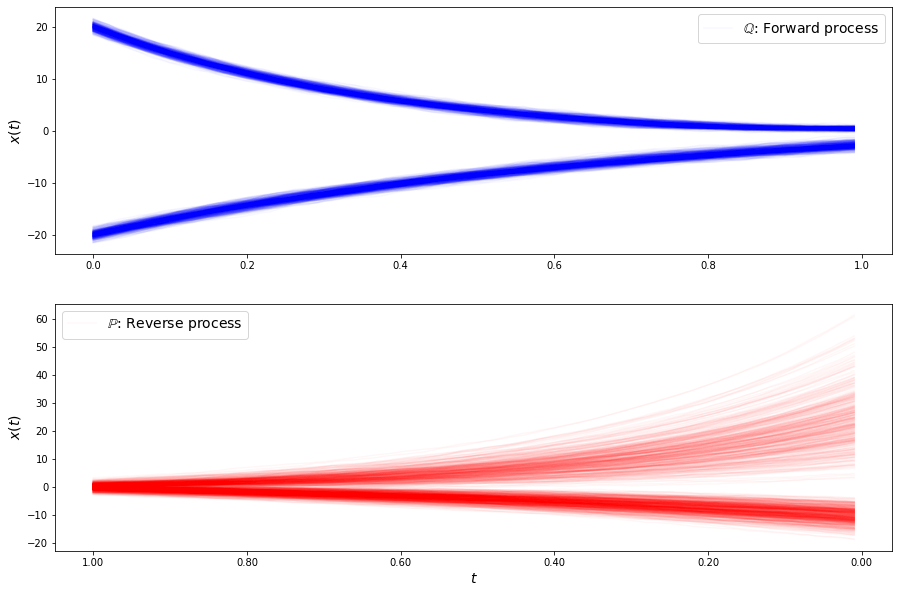

loss b 35.48981803235423
loss b 36.92507002944024
loss b 34.124919017685585
loss b 35.25001216123478
loss b 35.36629600140361
loss b 35.584349232026526
loss b 35.07064425785977
loss b 35.318508915318986
loss b 36.19327433239981
loss b 33.945590331431106
loss b 35.602586889812656
loss b 35.099168371768535
loss b 34.79887025768181
loss b 35.09466687452659
loss b 35.256399636001746
loss b 35.22360845137936
loss b 34.59931768171584
loss b 36.14722676967998
loss b 35.640928697526974
loss b 33.720539142167596
loss b 33.066024664588916
loss b 34.73390474177824
loss b 36.0996423572667
loss b 36.16676715446665
loss b 33.98896492419278
loss b 35.08363622270695
loss b 34.867601758185224
loss b 35.63854877457676
loss b 33.839109770235844
loss b 34.97153707893195
loss f 7.5555026006811215
loss f 7.770240430094722
loss f 7.450789499616617
loss f 7.456689211568852
loss f 7.6416296850589145
loss f 7.616304059089214
loss f 7.513507164776346
loss f 7.632791857905694
loss f 7.741336118789864
loss f 7.585

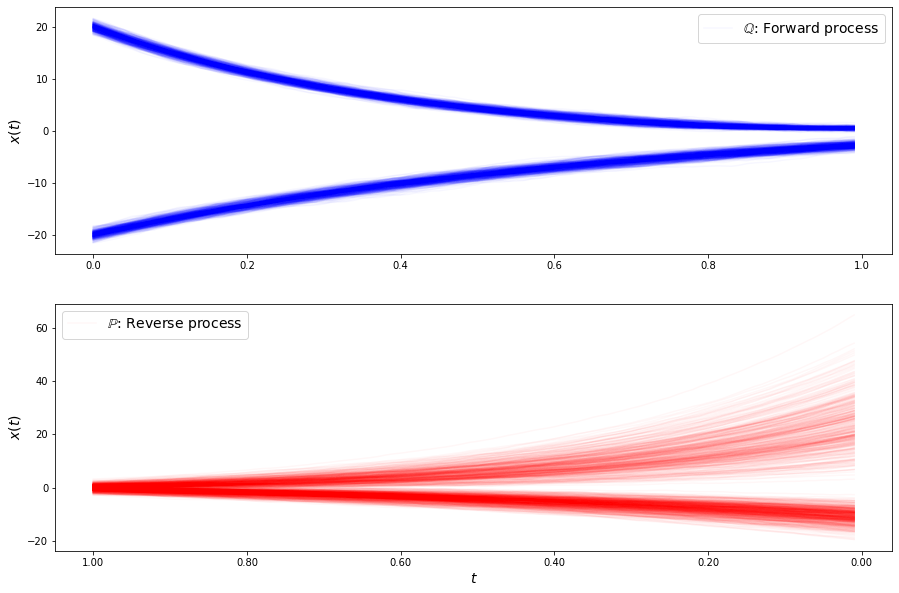

loss b 35.522974776982224
loss b 35.72556346181536
loss b 35.205432155183615
loss b 34.86952118657819
loss b 35.303341067911965
loss b 35.39045933290128
loss b 33.58736769757791
loss b 34.36390821721304
loss b 37.007491953557725
loss b 35.848887220491136
loss b 35.4030227183513
loss b 34.18318889564893
loss b 34.72106913890108
loss b 34.587054213725736
loss b 33.96994975421635
loss b 34.24638707104949
loss b 34.00913123867603
loss b 34.49441678718485
loss b 32.317600701476074
loss b 34.43769667981244
loss b 32.593155823694666
loss b 33.213277270018786
loss b 32.04437592195794
loss b 34.275970456480984
loss b 34.42722136503884
loss b 34.17587914410664
loss b 35.25308448280279
loss b 34.08836709688686
loss b 34.474815934220224
loss b 34.75153972442402
loss f 7.3604817106152876
loss f 7.273211283753114
loss f 7.237997384526451
loss f 7.26759628426719
loss f 7.37016205005162
loss f 7.295327508966321
loss f 7.4459207256413595
loss f 7.426910451228944
loss f 7.214633686157672
loss f 7.339899

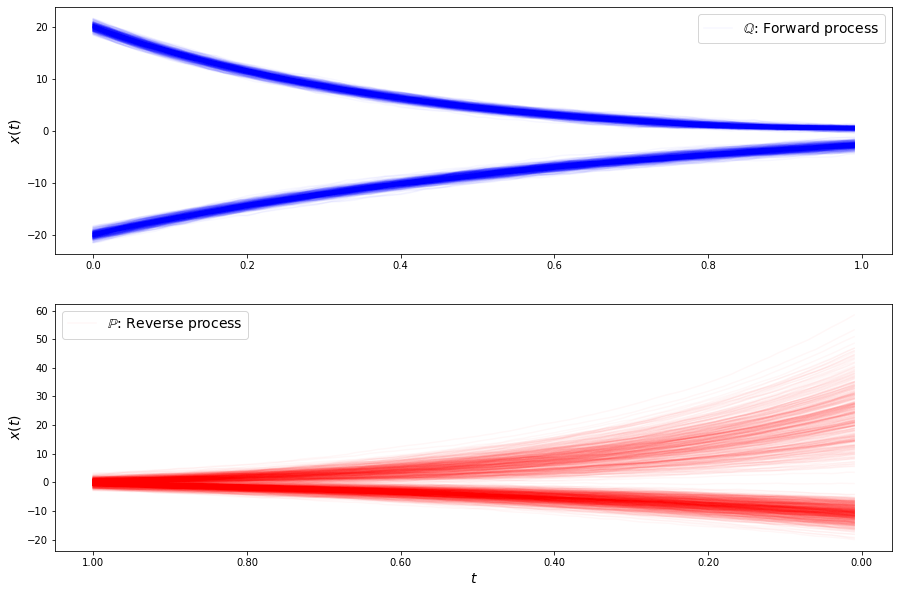

loss b 34.351974321219465
loss b 34.17331560772327
loss b 32.89021098908574
loss b 35.32002302166771
loss b 34.755359886738134
loss b 32.201197726419856
loss b 34.29460468854628
loss b 33.67451605653355
loss b 32.875674690155144
loss b 33.56758325940907
loss b 32.199660513349606
loss b 34.14687130082221
loss b 34.515797646474255
loss b 33.325604885086534
loss b 34.55358652316424
loss b 34.55682938180595
loss b 32.212948801653845
loss b 35.10098752366191
loss b 34.754036151932226
loss b 33.17898652323301
loss b 32.957652635782196
loss b 33.109935147112175
loss b 34.65760575058424
loss b 32.47420214847409
loss b 31.098502991306546
loss b 33.94940587643649
loss b 33.74691876897972
loss b 31.966019389454928
loss b 31.704245231308676
loss b 33.438478951524424
loss f 7.153989789831353
loss f 6.985391821566316
loss f 7.284792751120187
loss f 7.387774565612152
loss f 7.384383166937788
loss f 7.029806109518234
loss f 7.140712715417246
loss f 7.308039261824193
loss f 7.212867373288062
loss f 7.4

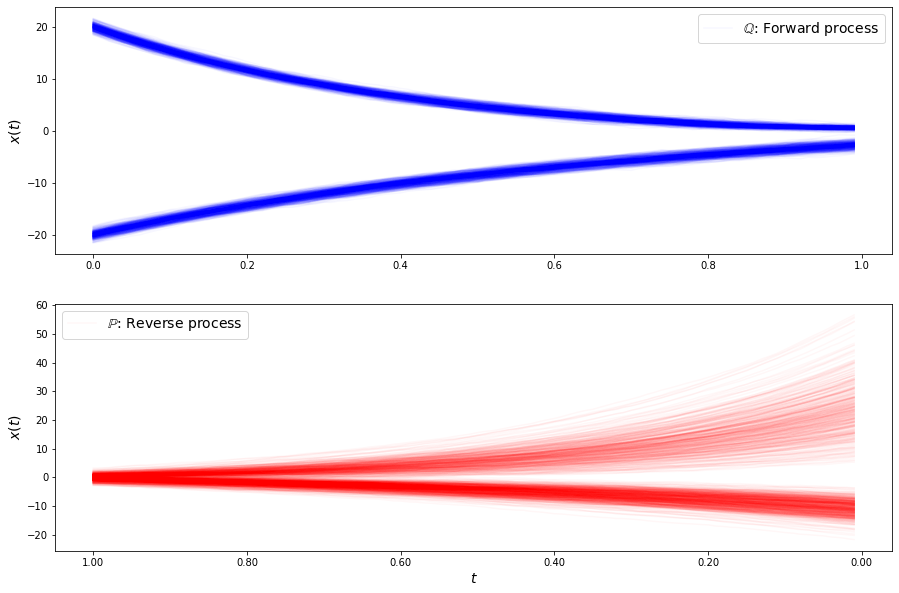

loss b 32.626922217165564
loss b 33.93116896969187
loss b 32.8885247806439
loss b 33.962999093111996
loss b 32.05767322612373
loss b 33.596574440979644
loss b 32.95095744927501
loss b 31.91674496526065
loss b 32.844460826220725
loss b 34.485122155759505
loss b 33.080580701740374
loss b 30.881176301315453
loss b 31.61235486761173
loss b 32.18910182808646
loss b 31.61274537336723
loss b 32.95623460821581
loss b 32.33192781336734
loss b 32.29171759394072
loss b 31.75768369685835
loss b 32.67087530955552
loss b 30.795602336985755
loss b 31.897988639710334
loss b 30.32265966162527
loss b 31.015089848123466
loss b 31.90988408329168
loss b 30.859981531607012
loss b 31.20726484543051
loss b 31.127580203833705
loss b 31.033324345404626
loss b 30.437050625188665
loss f 7.411067832630919
loss f 6.985351728332424
loss f 7.012692838020305
loss f 7.316546081897619
loss f 6.9997381840014254
loss f 7.279011178460194
loss f 7.046623688031723
loss f 7.090654020870289
loss f 7.469696994123261
loss f 7.20

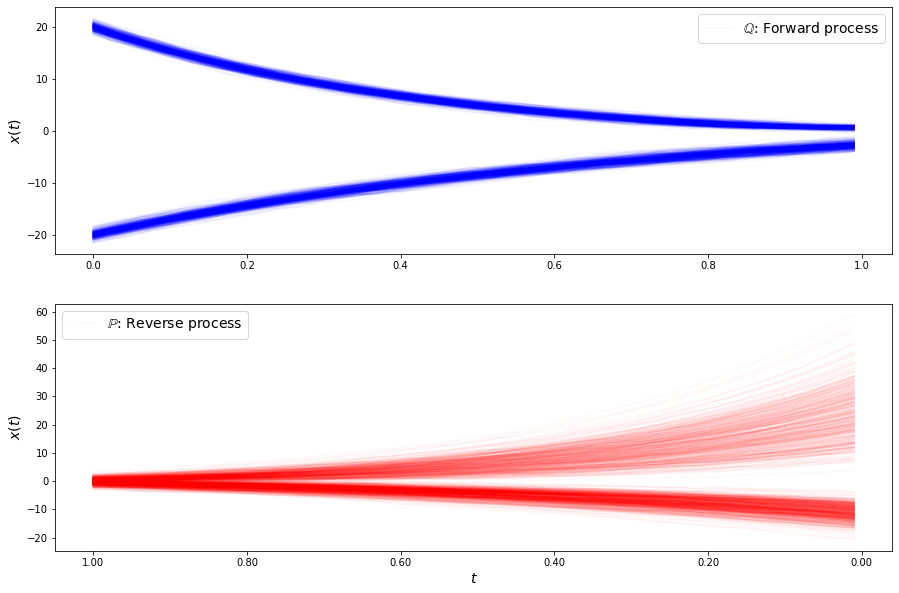

loss b 31.588978375655575
loss b 31.96016217441794
loss b 31.794954249437012
loss b 30.858237571151868
loss b 30.619966537499977
loss b 31.85353043038702
loss b 30.720917941053663
loss b 29.96251439979647
loss b 30.114250818222928
loss b 30.238167796389988
loss b 30.26043827831068
loss b 30.6085781539344
loss b 29.194397306763484
loss b 29.472747936404346
loss b 31.07422507813975
loss b 29.415002145459066
loss b 30.439281202888214
loss b 30.217094905832077
loss b 30.841482745706703
loss b 29.87876544017719
loss b 29.763124213668526
loss b 29.70396678125858
loss b 29.994486314114635
loss b 28.633226373914113
loss b 30.914090606903287
loss b 28.988555797668532
loss b 30.03244776277215
loss b 28.432511941534532
loss b 28.68246541885044
loss b 28.19020773380104
loss f 6.883133693843619
loss f 7.031999862084127
loss f 7.068176168580453
loss f 7.114678324367049
loss f 7.230745694193138
loss f 7.002848673787985
loss f 7.008773002880191
loss f 7.174952873199521
loss f 7.012752253134527
loss f 

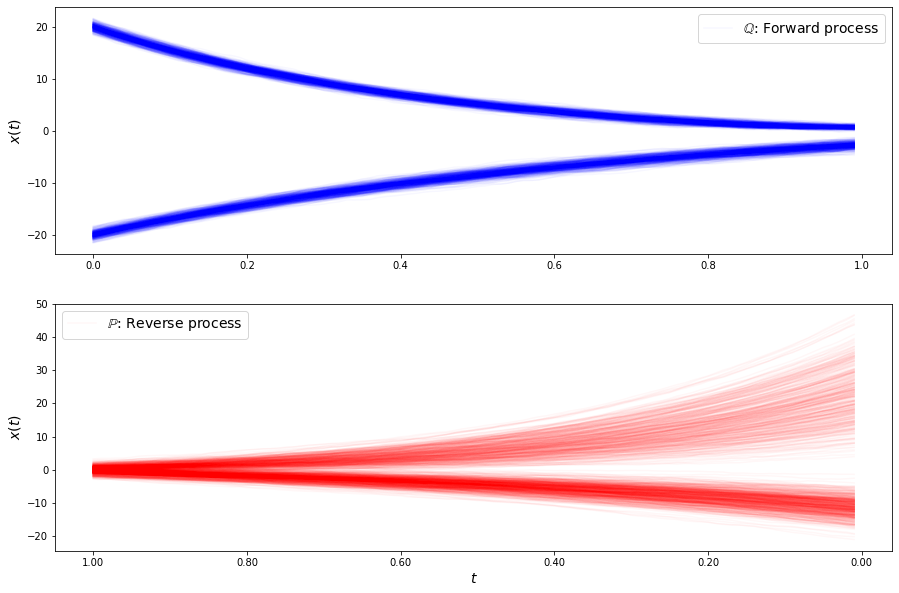

loss b 29.68940088647216
loss b 30.663614559947877
loss b 29.14105198514741
loss b 29.158204972844775
loss b 29.7759504345277
loss b 28.39411925210454
loss b 28.22030204169473
loss b 29.85530155313751
loss b 29.966940422909165
loss b 27.898622522511328
loss b 28.21992837001536
loss b 27.300342333006576
loss b 27.303705736830228
loss b 27.395984044622587
loss b 27.5547638912778
loss b 27.20352071336891
loss b 28.832186694474753
loss b 27.48048759619991
loss b 26.582882277604465
loss b 26.676176354830552
loss b 26.362464344666954
loss b 26.532023316375245
loss b 27.51456220109047
loss b 26.248121714420893
loss b 28.21327202947039
loss b 26.44684979173965
loss b 26.470442905874407
loss b 27.478295171484056
loss b 25.417525160408886
loss b 28.105692188183255
loss f 6.904621073656943
loss f 6.935195294559683
loss f 6.767659763216613
loss f 6.751535121383058
loss f 6.803920821550503
loss f 6.911830885901055
loss f 6.9835497032132565
loss f 6.917509049798812
loss f 7.038606801102084
loss f 6.

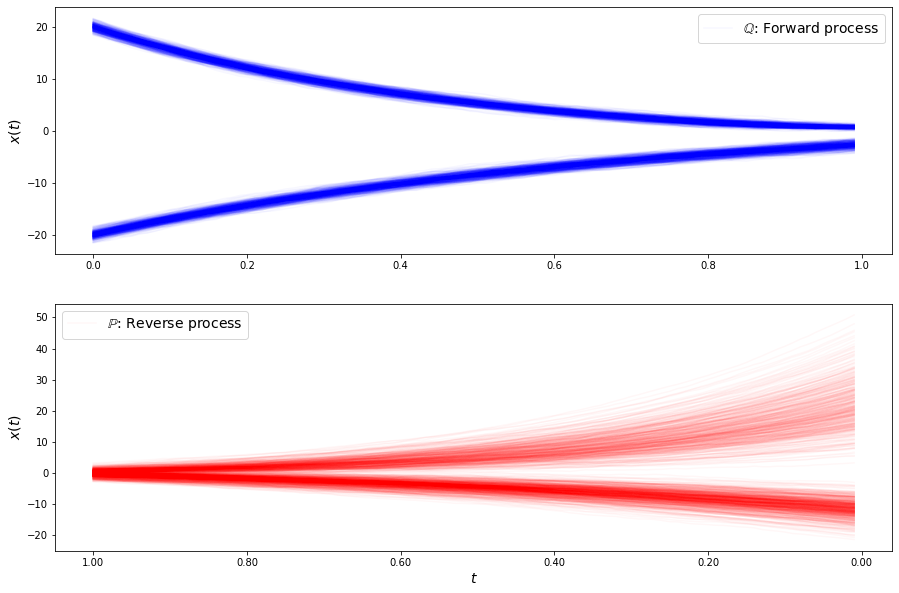

loss b 26.91530944025334
loss b 26.762248503353046
loss b 26.56643507811652
loss b 26.98755283662981
loss b 26.54926859300396
loss b 25.596169728509896
loss b 27.05694634343762
loss b 26.017468807881144
loss b 26.018096927441277
loss b 26.99995519010033
loss b 26.011365492523982
loss b 25.225813804421335
loss b 25.57328904384709
loss b 25.35252831881228
loss b 26.73435014455647
loss b 25.68007838327621
loss b 25.400920960759922
loss b 25.673890166934168
loss b 25.47111705945411
loss b 25.398755441748744
loss b 25.980638448284044
loss b 26.474693105029772
loss b 25.73106851712702
loss b 25.37224718418443
loss b 25.09764322854615
loss b 23.155034719315935
loss b 24.31360353085374
loss b 23.758728620886373
loss b 23.77011718759351
loss b 24.937337004624837
loss f 6.637599265765038
loss f 6.50189912880637
loss f 6.626431696608601
loss f 6.699480245098859
loss f 6.630901510757224
loss f 6.512579759304985
loss f 6.564287848281415
loss f 6.500646465508308
loss f 6.555519332387835
loss f 6.591

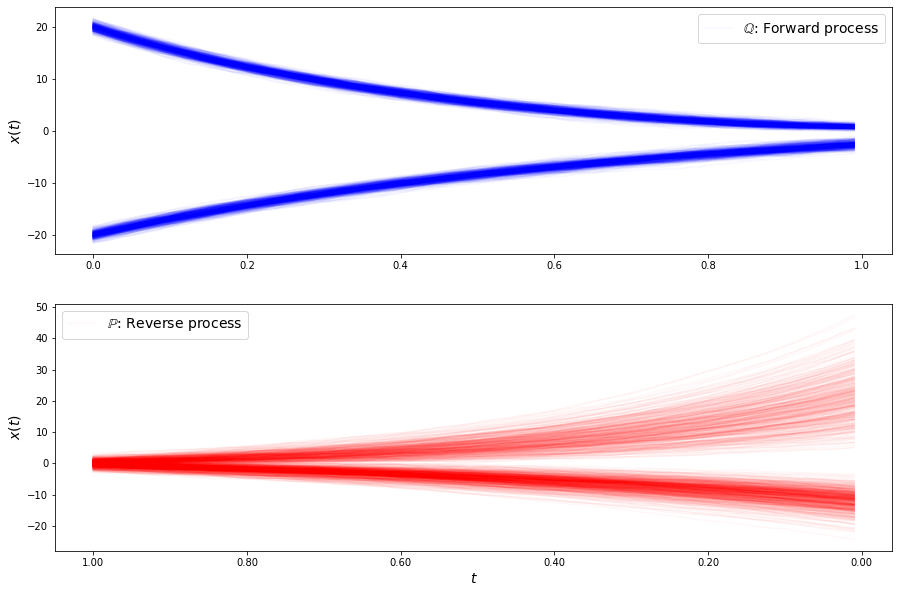

loss b 24.989957305395073
loss b 24.804275966993245
loss b 23.389633378456317
loss b 23.84939199814541
loss b 23.691131634354058
loss b 25.22396052140614
loss b 24.20099540180961
loss b 23.945897087426786
loss b 24.276937941282284
loss b 23.198716340677123
loss b 23.067819933240457
loss b 23.57213779155315
loss b 24.511385234817492
loss b 23.01566189817117
loss b 23.635475595238617
loss b 24.281420335464496
loss b 22.783545525984444
loss b 23.15746909802188
loss b 22.88668819446257
loss b 22.949210775616272
loss b 21.629363211748302
loss b 23.855629448419258
loss b 22.485950168991575
loss b 23.264239113972195
loss b 22.674267142976834
loss b 21.56041973700846
loss b 21.875011855831413
loss b 22.508360533870235
loss b 22.344809039780515
loss b 22.087937055868004
loss f 6.141980937494816
loss f 6.1880623591728785
loss f 6.254506277382826
loss f 6.185112078185717
loss f 6.3135907747139175
loss f 6.179953621010974
loss f 6.345214792175592
loss f 6.294124586968521
loss f 6.2131055968263675


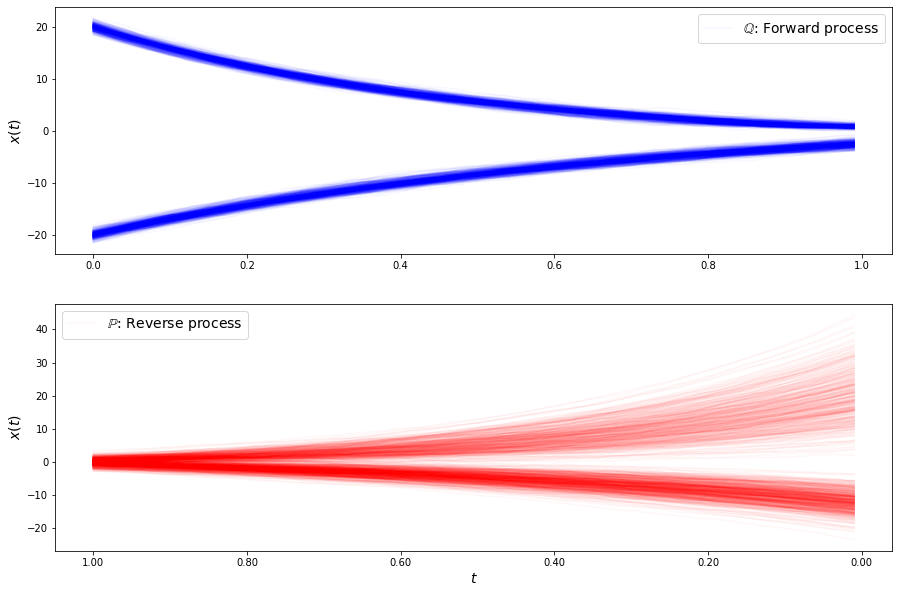

loss b 22.803428740879863
loss b 22.338838571012438
loss b 21.785159875452972
loss b 21.81373182936059
loss b 21.865321440001257
loss b 22.632036575264447
loss b 21.961817682264062
loss b 23.090150548387392
loss b 21.37133249736258
loss b 21.959321603542584
loss b 21.67714205434408
loss b 21.26266702724778
loss b 21.412476602514772
loss b 22.24329412684285
loss b 21.88351270490358
loss b 21.484925538833675
loss b 21.33360700654267
loss b 20.60736360663343
loss b 21.129459167151307
loss b 21.3435394944195
loss b 20.81600861294134
loss b 20.843425518273133
loss b 21.43201402007928
loss b 20.990118390692864
loss b 20.978836355400432
loss b 22.054998401448643
loss b 21.2618396297273
loss b 21.15853212868156
loss b 21.458115270714085
loss b 20.81474575588997
loss f 5.952442725524642
loss f 5.843709372685101
loss f 5.777193180072022
loss f 5.716955373728317
loss f 5.894816076700814
loss f 5.815222650031822
loss f 5.829521694347457
loss f 5.9153159733699745
loss f 5.978561750649117
loss f 5.9

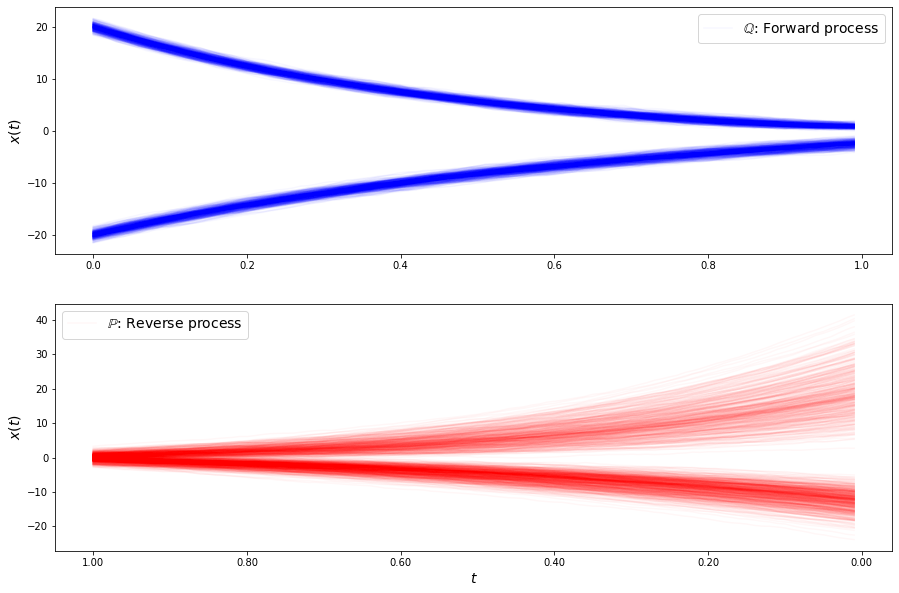

loss b 20.30851943243955
loss b 21.160037078638382
loss b 20.312104141337226
loss b 20.56273476253597
loss b 20.93727668017671
loss b 20.864143815441953
loss b 19.552370262276963
loss b 21.245515997987976
loss b 20.24153616528272
loss b 20.963964178811953
loss b 20.91986903940378
loss b 19.510157989124192
loss b 20.226472342657715
loss b 19.46184524025568
loss b 19.979893473170776
loss b 20.36155501468935
loss b 20.236106129132455
loss b 20.516489686518828
loss b 19.555588402974887
loss b 19.829955173749898
loss b 19.327955915144802
loss b 19.66536597120615
loss b 19.61823488008792
loss b 19.751271085872578
loss b 19.826457871811893
loss b 19.670201466445423
loss b 19.68738946580642
loss b 20.236992567992914
loss b 19.479731378088502
loss b 19.92750015364047
loss f 5.433542233334815
loss f 5.453360898275138
loss f 5.505500196483894
loss f 5.40864210653868
loss f 5.522675900213072
loss f 5.436325070706218
loss f 5.326761710759497
loss f 5.466968354764521
loss f 5.340179188278402
loss f 

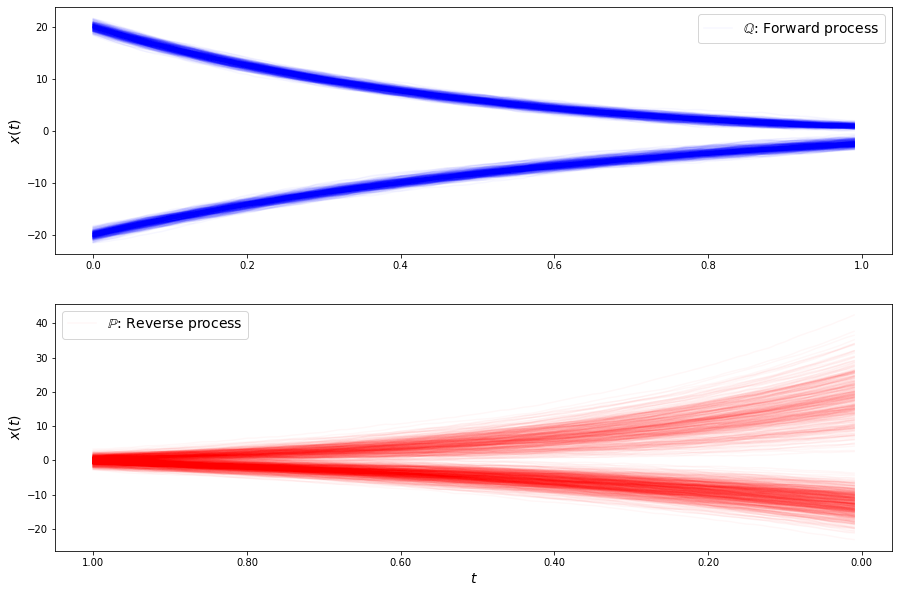

loss b 20.13052502678392
loss b 19.459361246710355
loss b 19.970076003580246
loss b 19.70210281222698
loss b 18.95016695209189
loss b 19.840801109047902
loss b 19.27752179891217
loss b 19.15385859539863
loss b 18.92074709577253
loss b 18.877528860258625
loss b 17.96968138453101
loss b 18.73222194516885
loss b 19.747474499314677
loss b 19.355135730213533
loss b 18.880992119084727
loss b 18.95854183129534
loss b 19.11353905726865
loss b 18.538595016981763
loss b 19.04935792086969
loss b 18.764076768573236
loss b 18.878472877047273
loss b 17.991734338858066
loss b 18.699499548041548
loss b 18.120324121014498
loss b 19.25537664210649
loss b 18.611681919836712
loss b 18.802854089999474
loss b 19.054085607469496
loss b 18.532535607300332
loss b 19.034020723006037
loss f 5.019662453815927
loss f 5.189520809345266
loss f 5.081441575066324
loss f 5.152611020188597
loss f 5.249387249370083
loss f 5.114688987314125
loss f 5.089251426718415
loss f 5.114202333180021
loss f 5.273624782926051
loss f 

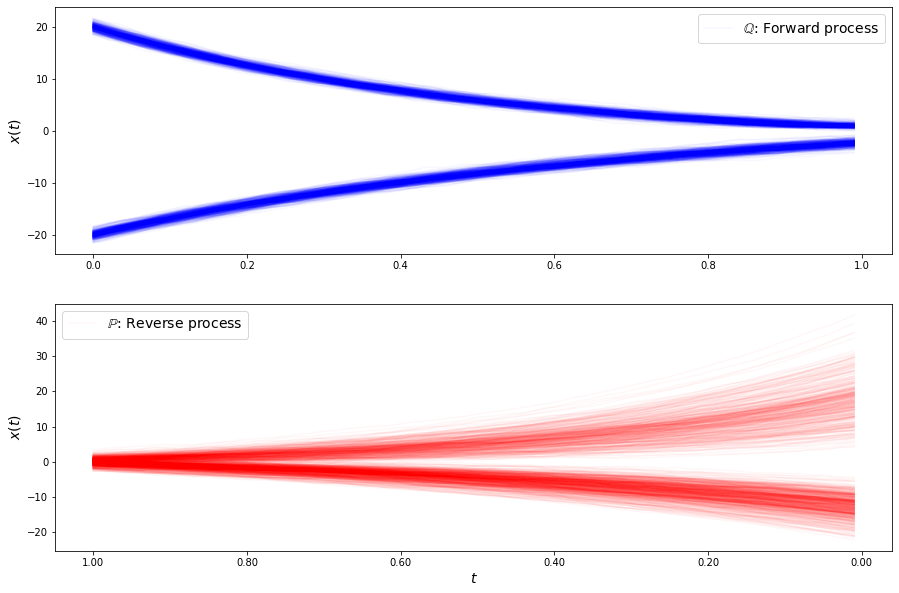

loss b 18.335492233931788
loss b 18.60624453985061
loss b 18.091700329557856
loss b 18.476604009987145
loss b 18.20629097947039
loss b 18.669518417237917
loss b 19.427191439064615
loss b 18.639542520210817
loss b 18.28174778892767
loss b 18.83466766230059
loss b 18.242695105857454
loss b 18.805283528594412
loss b 18.635212659722686
loss b 17.952720490571185
loss b 18.361638599872318
loss b 17.941142714314136
loss b 18.512920697333488
loss b 17.682592770268077
loss b 17.903127034276313
loss b 18.27812581629308
loss b 18.29890347804606
loss b 17.369196487503086
loss b 18.128109622833247
loss b 17.741601543036083
loss b 17.58671188963211
loss b 17.75413515745432
loss b 18.26303457144936
loss b 17.55884346280758
loss b 17.73918826262997
loss b 17.170465313751063
loss f 4.984005604150894
loss f 4.739768198631289
loss f 4.841562904467163
loss f 4.8581783384280275
loss f 4.812003675573655
loss f 4.8741668587407405
loss f 4.833623982601774
loss f 4.8691904538942445
loss f 4.802984554573298
los

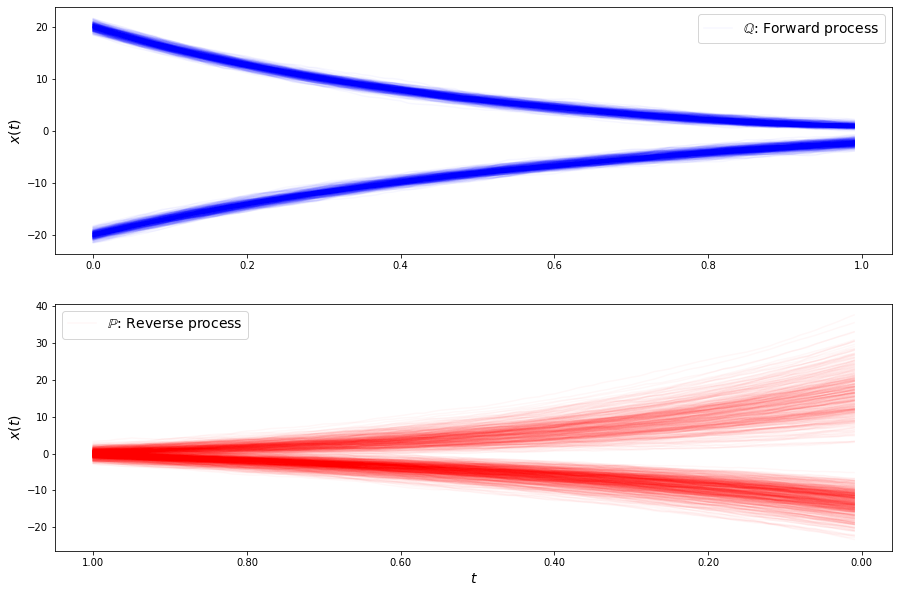

loss b 17.245586117251285
loss b 17.903697214842495
loss b 17.89839737870258
loss b 17.791554065390926
loss b 18.829963456481472
loss b 17.970556384430047
loss b 17.798076968658634
loss b 17.34186547539794
loss b 17.878228986014825
loss b 18.78789608680712
loss b 17.415727612043774
loss b 16.957612562650407
loss b 17.410830493828573
loss b 17.981485925562744
loss b 17.174625439336452
loss b 18.479719866890996
loss b 17.08614557419734
loss b 17.47877671313237
loss b 16.858740482323572
loss b 17.191011749635607
loss b 16.791346611225787
loss b 16.916860766847456
loss b 16.830956825163575
loss b 17.73273003718059
loss b 17.500814892856585
loss b 17.556518727465924
loss b 17.20931260048287
loss b 17.02657717986265
loss b 17.716196049954696
loss b 17.869042157375258
loss f 4.578485441506891
loss f 4.612440989725785
loss f 4.716664179813134
loss f 4.658482760563446
loss f 4.659613404147486
loss f 4.567476206300117
loss f 4.625307934913708
loss f 4.664770098731368
loss f 4.519521464495298
los

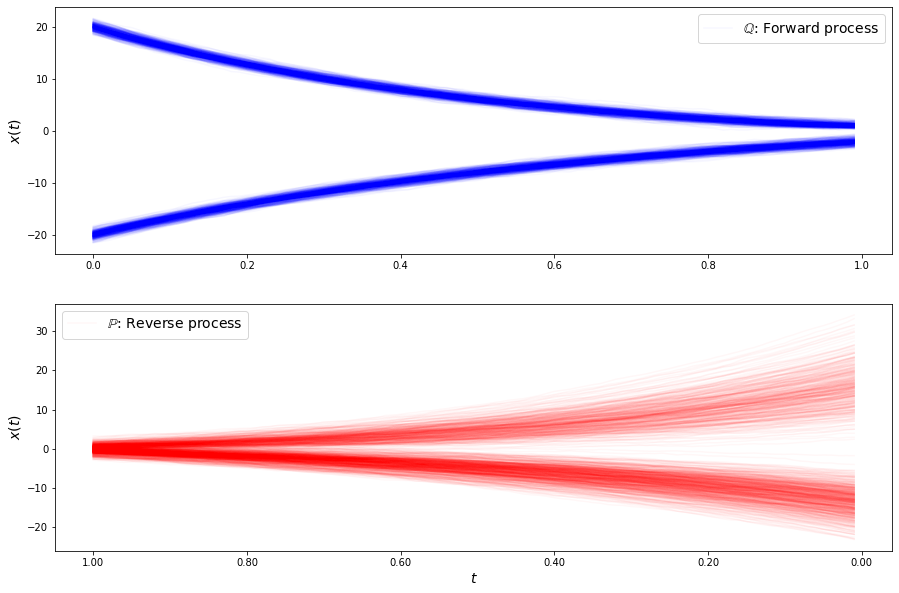

loss b 16.764427029538183
loss b 16.710516145939117
loss b 16.72247892229505
loss b 17.3414951405423
loss b 17.27186669383153
loss b 17.506905087183235
loss b 17.39330535996329
loss b 17.006072367651473
loss b 16.89422449828665
loss b 16.57500109024404
loss b 16.819888016360647
loss b 16.875765183272343
loss b 17.427951570047362
loss b 16.825201246228243
loss b 16.591583873012656
loss b 16.9028197598904
loss b 17.210416524916788
loss b 17.01912707630573
loss b 17.092674330377466
loss b 16.971830718142545
loss b 16.318583188914275
loss b 17.3333462125458
loss b 16.86852023807415
loss b 17.279817169404758
loss b 16.94531165910038
loss b 16.273640206307718
loss b 16.71876569068288
loss b 18.662212061016827
loss b 16.896704843409815
loss b 16.587131851822072
loss f 4.5253431819063525
loss f 4.492174299122733
loss f 4.53440018789591
loss f 4.538945140342951
loss f 4.434762681695705
loss f 4.411492453717167
loss f 4.531321197386238
loss f 4.4821839088046
loss f 4.466486294239382
loss f 4.542

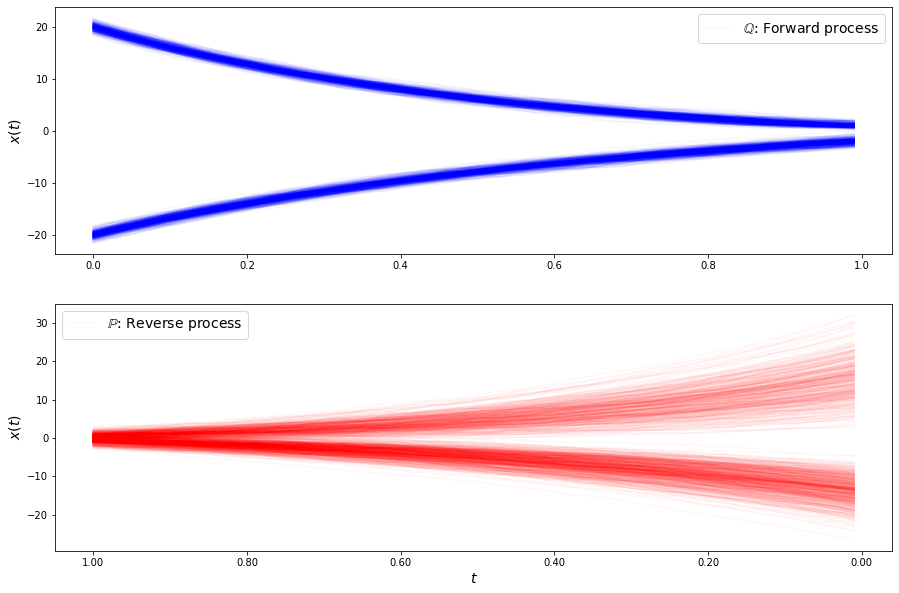

loss b 16.427407394449904
loss b 16.497288815753574
loss b 16.535616501610033
loss b 16.524545992868504
loss b 16.89655369801416
loss b 16.192532787341424
loss b 16.842398871086182
loss b 16.974334311567794
loss b 16.623464527753978
loss b 16.532351648752588
loss b 16.89187873225488
loss b 15.731570792934816
loss b 16.321988022145426
loss b 17.214619828706095
loss b 17.328596806662645
loss b 16.86314347313406
loss b 16.266791555264216
loss b 16.80634998116016
loss b 16.75992044152205
loss b 16.99672854974498
loss b 16.48633360870085
loss b 15.802180815206036
loss b 17.016758448666423
loss b 16.49128803025436
loss b 16.712461658792645
loss b 16.137428518117023
loss b 16.156225994719385
loss b 16.523237940967576
loss b 16.699055533999307
loss b 16.549303543074902
loss f 4.395905277213729
loss f 4.287206497913457
loss f 4.409931752000439
loss f 4.351625508314913
loss f 4.338455813333035
loss f 4.358550190092944
loss f 4.398998414347689
loss f 4.339947235169193
loss f 4.312638757734799
los

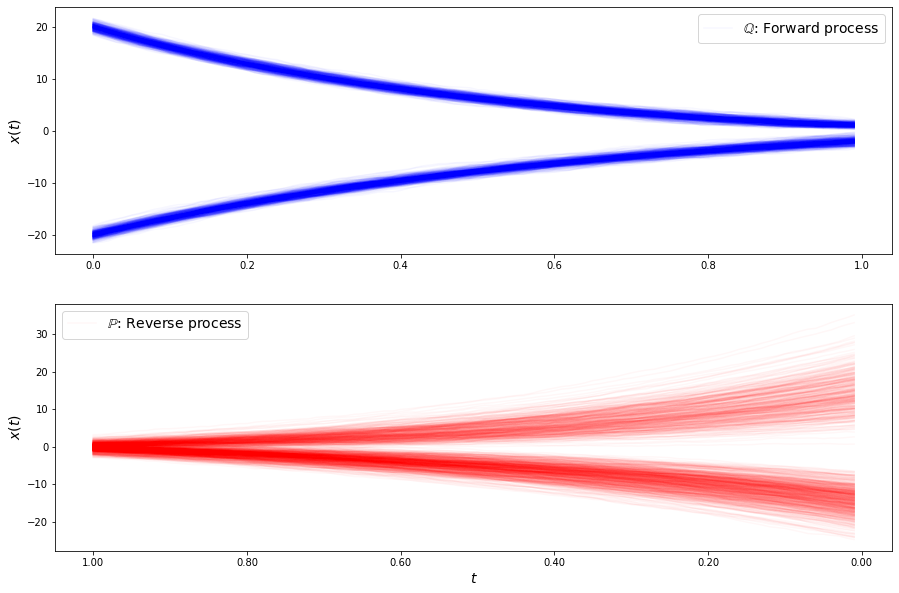

loss b 16.072555709393114
loss b 15.607921223491184
loss b 17.156018422853087
loss b 16.658786759730702
loss b 15.42503867007425
loss b 16.28097513559633
loss b 15.795629462084731
loss b 16.636681950859508
loss b 16.227464668161836
loss b 16.546849972908774
loss b 16.561479283642925
loss b 16.393360511096528
loss b 15.643492498145472
loss b 16.658561271206004
loss b 16.62767273596959
loss b 16.751120916801117
loss b 16.94321999305246
loss b 16.567509985463243
loss b 16.06716814454954
loss b 15.627234386445343
loss b 16.219318833499607
loss b 15.886941546075347
loss b 16.240843343995415
loss b 15.993599924791816
loss b 16.31200471326776
loss b 16.407168845815765
loss b 16.70382120998325
loss b 16.371174868274284
loss b 16.01405770092412
loss b 16.814487654865722
loss f 4.301364001357429
loss f 4.4018963152006725
loss f 4.245873131257955
loss f 4.3272760098721585
loss f 4.287838194061207
loss f 4.316530761722555
loss f 4.268723597332433
loss f 4.2895191356635545
loss f 4.220342531268263


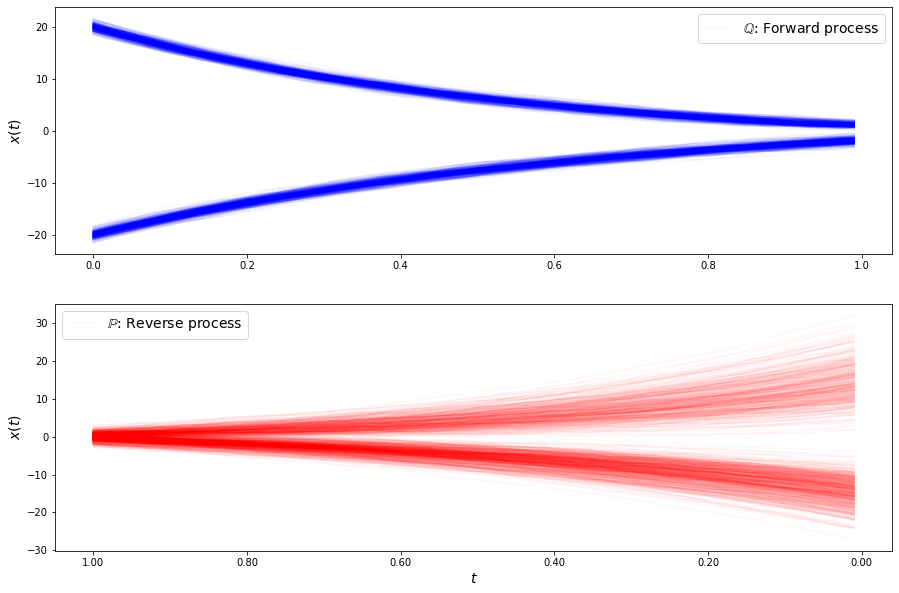

loss b 15.749315215244453
loss b 16.816331799770147
loss b 16.008815072474828
loss b 16.363777993694455
loss b 16.260679564926566
loss b 16.06125909285673
loss b 16.42890771980375
loss b 15.162832714090902
loss b 15.847266195727643
loss b 16.225934751805095
loss b 16.10223359022364
loss b 16.708339072496276
loss b 15.949115273020235
loss b 16.172645048230372
loss b 15.854518010775696
loss b 15.925684985851015
loss b 16.20891162135816
loss b 16.180379260746783
loss b 15.857148600871435
loss b 15.586215136337357
loss b 17.12311717110228
loss b 16.651146679196735
loss b 15.72865834506923
loss b 15.641589526157908
loss b 16.512595155730615
loss b 16.595959128735387
loss b 16.379406643782666
loss b 16.229150092392594
loss b 16.47945727571643
loss b 15.471076518635028
loss f 4.292962403406175
loss f 4.305930842075369
loss f 4.216089121879335
loss f 4.2822095541618195
loss f 4.239023054942821
loss f 4.246110416997288
loss f 4.196745815415041
loss f 4.329590124348495
loss f 4.2219564988524985


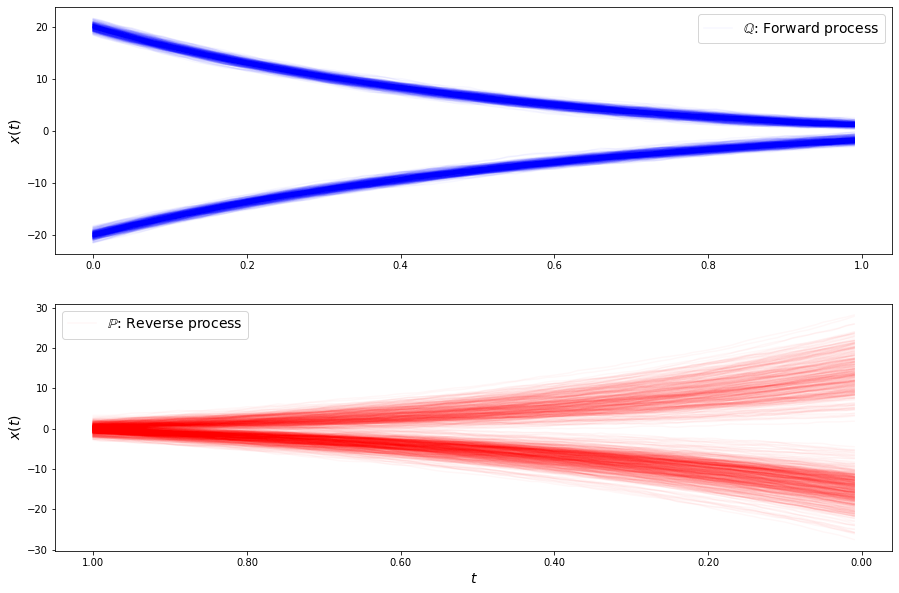

loss f 3.9862544256186396
loss f 4.056461866212375


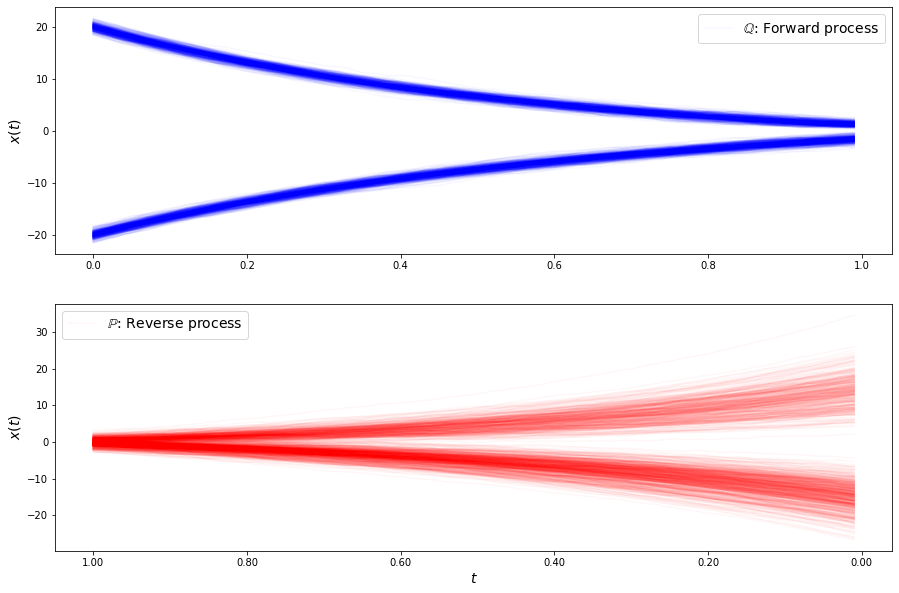

loss b 15.118864498046184
loss b 15.860958253935415
loss b 14.650497783600182
loss b 15.460093717392278
loss b 15.397985307452783
loss b 15.340397335583697
loss b 15.600733933991531
loss b 15.911858895663906
loss b 15.330147682887494
loss b 15.539025257540612
loss b 15.425743414468544
loss b 15.087399330811712
loss b 15.60939166497393
loss b 15.734387439694808
loss b 15.873688389896365
loss b 15.088282368202217
loss b 15.606213867495535
loss b 15.526063906269853
loss b 15.487018897583058
loss b 14.978971353209891
loss b 14.437159511921148
loss b 14.634250577078358
loss b 16.853342462243827
loss b 15.628059636217486
loss b 15.720312561355971
loss b 15.924601811417178
loss b 15.466398636349624
loss b 14.989325378336389
loss b 15.417721495335938
loss b 16.420508456935586
loss f 4.23513768687433
loss f 4.2067224232378955
loss f 4.167030129928607
loss f 4.164088778030054
loss f 4.0351564896691725
loss f 4.145945946504982
loss f 4.047767283753014
loss f 4.0429145256870385
loss f 4.1139583959

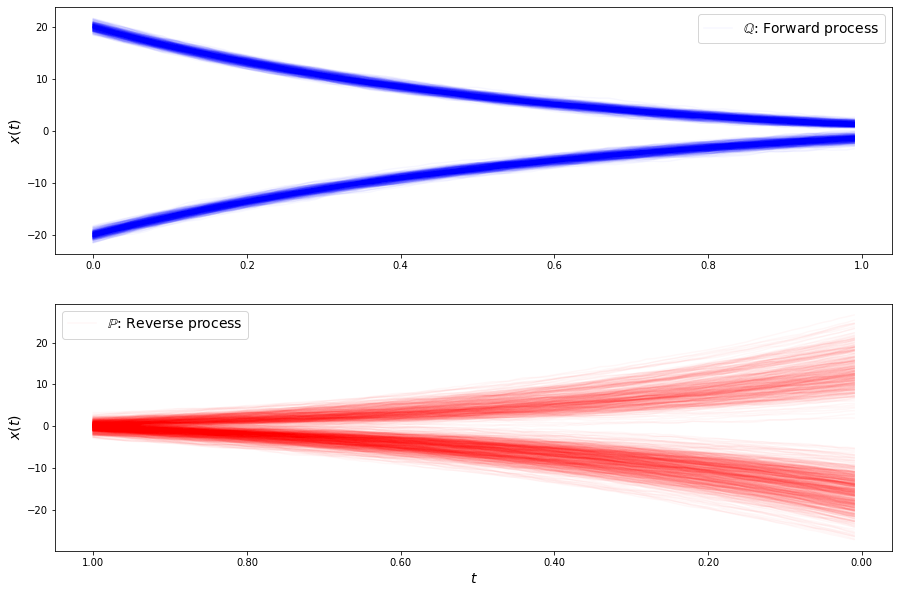

loss b 15.650147944367781
loss b 14.88713789232805
loss b 15.584262131844195
loss b 15.981179929401517
loss b 15.433749769617515
loss b 14.928628619027624
loss b 14.908727519387577
loss b 14.721021863667554
loss b 15.382403957625788
loss b 15.368786142140074
loss b 15.159694186804083
loss b 15.829838562468916
loss b 14.676577536381492
loss b 14.9874039190101
loss b 15.60438209138394
loss b 15.429174920266785
loss b 15.305810866826011
loss b 15.156901311196707
loss b 14.86826157013715
loss b 14.743578821272063
loss b 15.390309531145423
loss b 16.068649153106524
loss b 15.999320736705007
loss b 14.504448369999626
loss b 15.517549972503483
loss b 16.15453851096199
loss b 14.826990669007987
loss b 15.46439166912234
loss b 15.531290369949268
loss b 15.290641478202915
loss f 4.099171122489567
loss f 4.07496012373986
loss f 4.158479440238195
loss f 4.1502069918032785
loss f 4.002415672660042
loss f 4.080208828557777
loss f 3.9905507072497235
loss f 4.085617301781372
loss f 4.028716683233234
l

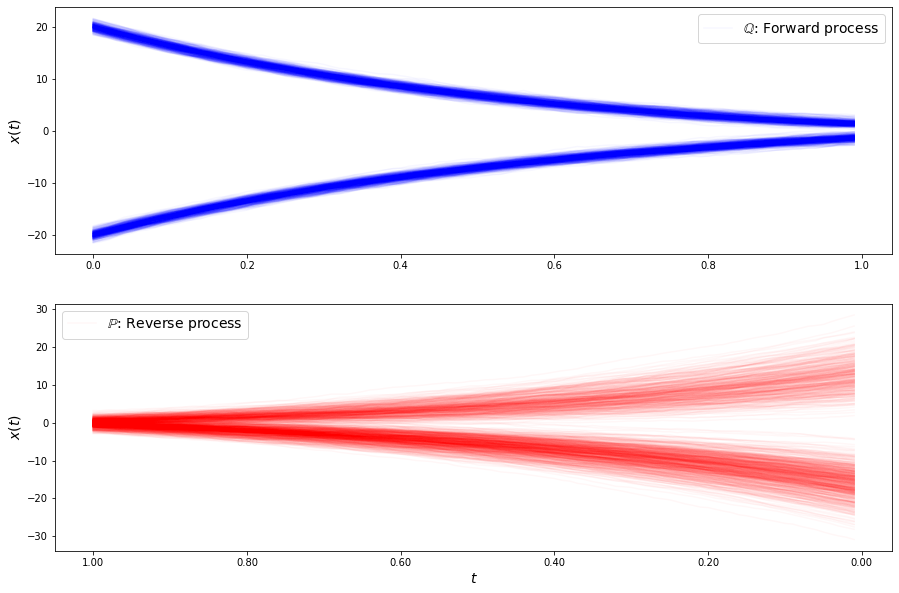

loss b 14.575232329881517
loss b 15.465723683513025
loss b 15.30526347657267
loss b 15.625434585438908
loss b 14.901706161686592
loss b 15.483260582955008
loss b 16.192904452477094
loss b 15.186160681152549
loss b 15.212277961841325
loss b 15.48657357895915
loss b 15.839639569502083
loss b 15.141318543475439
loss b 15.60296742111773
loss b 15.811608565035108
loss b 14.675051950905152
loss b 15.702391399131946
loss b 15.718553670327656
loss b 15.22923920807888
loss b 14.925378108880127
loss b 15.125539132833795
loss b 15.944358359706966
loss b 15.127043298591179
loss b 14.96396517653661
loss b 16.243792612790408
loss b 15.557905270802523
loss b 15.42438414366646
loss b 14.962201336649795
loss b 14.796344124696738
loss b 15.105734455790293
loss b 15.260337156654447
loss f 4.059994979115357
loss f 4.122330805918793
loss f 4.050994250868544
loss f 4.051463536822386
loss f 3.9969582971939195
loss f 4.011963866270536
loss f 3.9507878930895113
loss f 3.9987072712286396
loss f 3.97011741000085

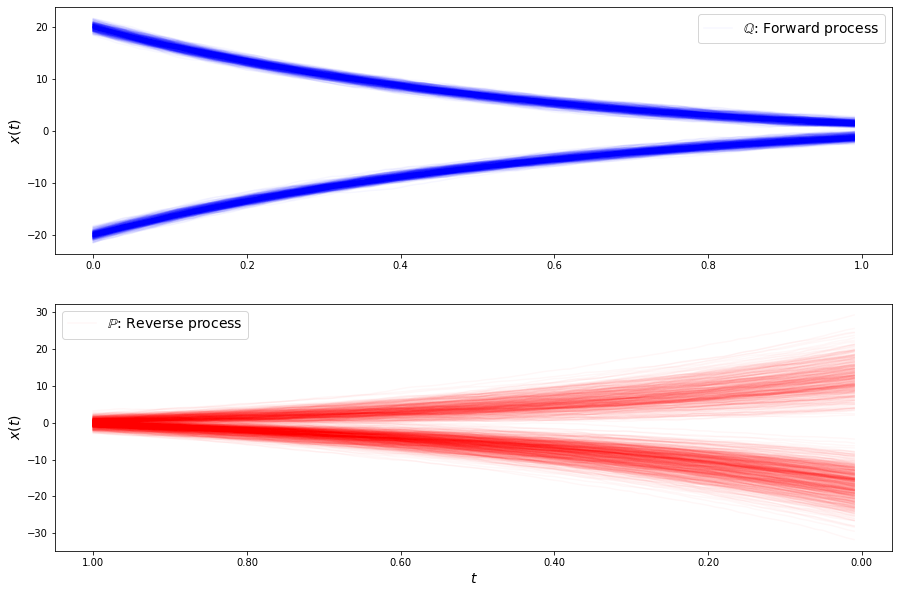

loss b 14.837192944864139
loss b 14.939741382307535
loss b 15.393050252730374
loss b 15.232113291526565
loss b 15.63202790954024
loss b 15.981427316403792
loss b 15.486180814758255
loss b 14.945916677972392
loss b 15.312073974455348
loss b 14.965351182937926
loss b 15.152301605578403
loss b 14.83310350109659
loss b 14.015102325888156
loss b 15.107664146024101
loss b 15.00020942548042
loss b 14.923210387370066
loss b 15.587790065626422
loss b 14.906438367570846
loss b 15.183686348095868
loss b 14.98592996528099
loss b 15.09533591211679
loss b 15.310112283491602
loss b 15.565742173640032
loss b 15.502261252539585
loss b 15.491510839540176
loss b 14.7206011794428
loss b 14.293452305544728
loss b 15.47084746263561
loss b 15.692477713743017
loss b 15.530148465347432
loss f 4.0168696209736785
loss f 3.9052593108039297
loss f 3.9995710818710664
loss f 3.9406873314818043
loss f 3.935226807484709
loss f 3.9286487600913675
loss f 3.963702609855611
loss f 3.916351176875006
loss f 3.90360965655512

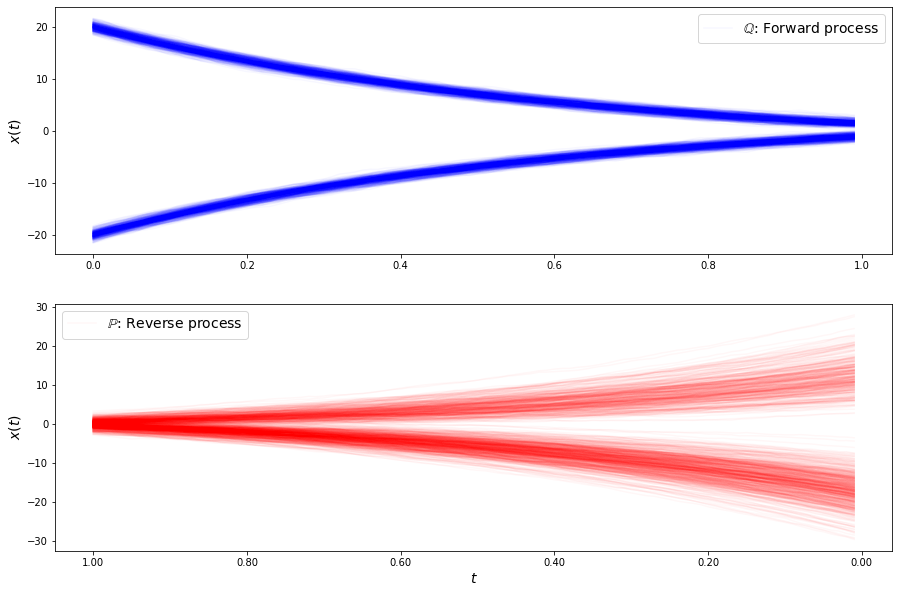

loss b 15.312824972269501
loss b 14.909415120888788
loss b 15.167811368955878
loss b 14.990972691075983
loss b 14.386461442947658
loss b 15.050187873330984
loss b 15.257432151424885
loss b 14.57192057538326
loss b 14.959040375943191
loss b 15.057604050377387
loss b 15.394716544580966
loss b 14.525751671150585
loss b 15.339564087365998
loss b 14.773928023046626
loss b 14.471254910150396
loss b 15.387094217932502
loss b 14.932599851206282
loss b 15.441683365566355
loss b 15.34376431108012
loss b 14.223615642026315
loss b 15.82993011121525
loss b 15.046857600642866
loss b 14.923982913515271
loss b 14.403755331934882
loss b 14.256737049482737
loss b 14.684934508500247
loss b 14.729556199480776
loss b 15.237846127112062
loss b 14.66466200388835
loss b 14.515569827796043
loss f 3.9570961724845595
loss f 3.8688876114301998
loss f 3.935433719515296
loss f 3.918168640526716
loss f 3.9115702806180064
loss f 3.9059035890901646
loss f 3.894790800664742
loss f 3.8360794673174734
loss f 3.7794904959

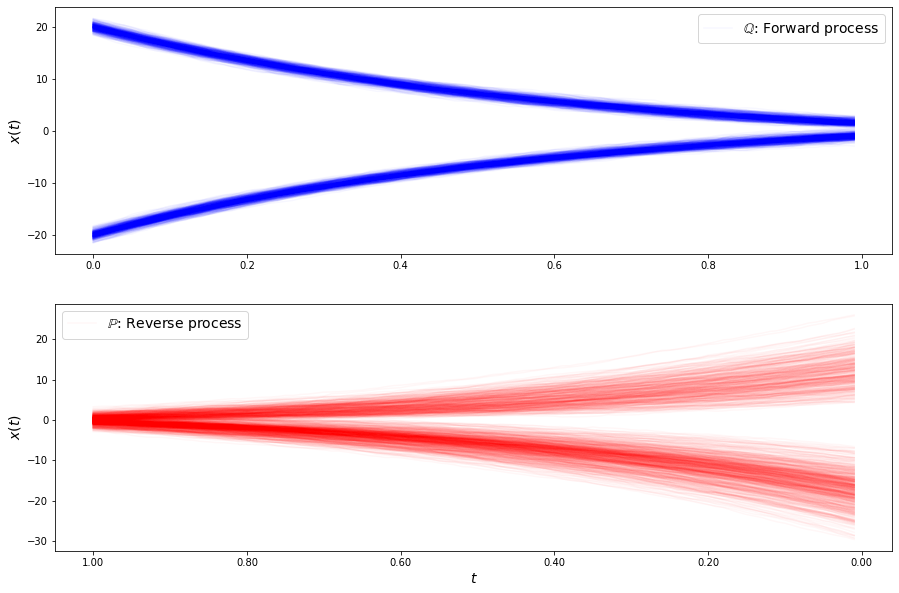

loss b 15.542754702348168
loss b 15.268039451650129
loss b 14.458188456689637
loss b 14.245845914982086
loss b 15.178308209459466
loss b 14.695734303245704
loss b 15.572981177823886
loss b 14.722480215866547
loss b 15.82019054834917
loss b 14.58985290688113
loss b 14.683377273065956
loss b 14.504208905945658
loss b 14.898711941054009
loss b 15.348214061829816
loss b 14.76171881681416
loss b 14.410270533925539
loss b 15.402007011230184
loss b 15.405799244413933
loss b 14.769206188781972
loss b 14.742951736649767
loss b 14.381083387638306
loss b 15.051770868513016
loss b 13.882835943643917
loss b 14.580018920073389
loss b 14.419925880962602
loss b 14.791202588785705
loss b 14.504708649376143
loss b 14.770565474157246
loss b 14.508726339382227
loss b 14.590869038733963
loss f 3.962399777980928
loss f 3.8093265816061472
loss f 3.941025783692238
loss f 3.8864936544631625
loss f 3.819783285314039
loss f 3.8677954196442963
loss f 3.9191881292700286
loss f 3.842546926174679
loss f 3.8319324624

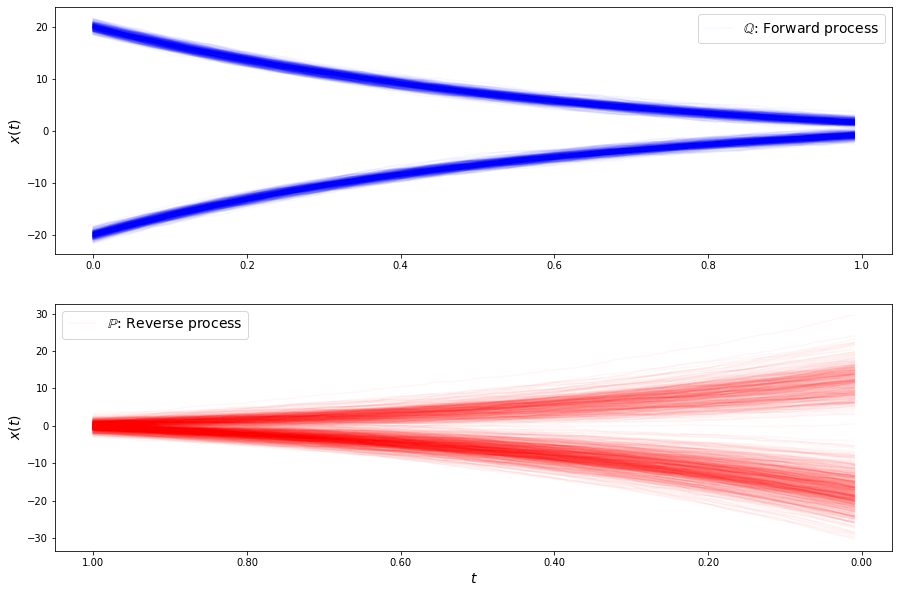

loss b 14.797945344939341
loss b 14.491693022158247
loss b 15.080698026369474
loss b 15.091588467995729
loss b 15.07358157345611
loss b 15.60742214927394
loss b 15.143873092565126
loss b 14.856701031017241
loss b 15.07649736907362
loss b 14.522398030139904
loss b 15.642554199919173
loss b 15.089105802301626
loss b 14.933810056374845
loss b 14.888898045494308
loss b 14.565566947688952
loss b 15.026785426430616
loss b 15.542466223974142
loss b 15.212970091401386
loss b 15.816652148342085
loss b 14.520041918218428
loss b 15.46009061524976
loss b 14.987621817214194
loss b 15.34260631036455
loss b 15.154791472776047
loss b 15.435502732301243
loss b 14.016806210034709
loss b 15.280333970772773
loss b 15.124152202797086
loss b 14.570583328980952
loss b 15.21805839735251
loss f 3.8359169462715466
loss f 3.859340411445061
loss f 3.8483524637325344
loss f 3.877364032620294
loss f 3.815871224713127
loss f 3.844700420976585
loss f 3.8838799170872584
loss f 3.9370450901882172
loss f 3.8222380751440

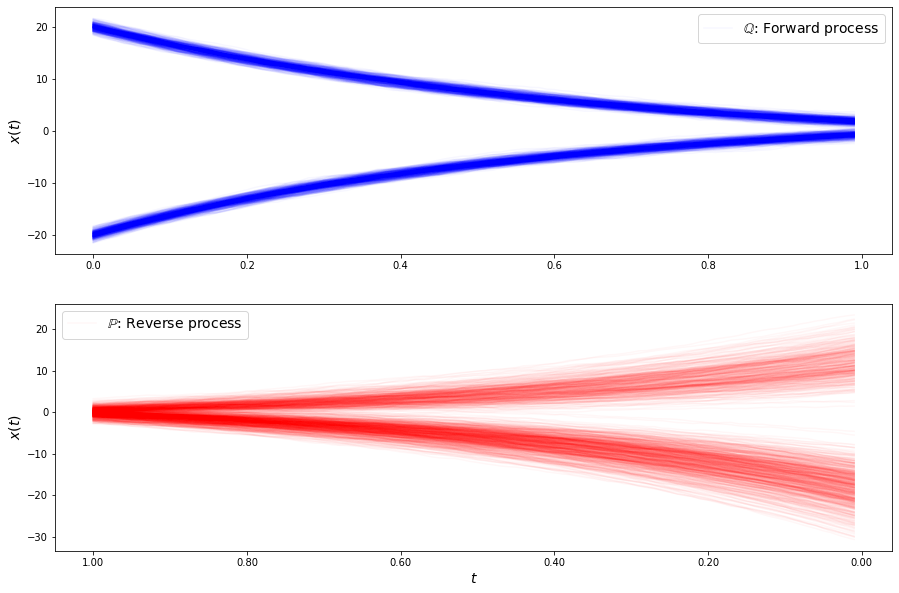

loss b 14.989639600978448
loss b 14.571267302045367
loss b 15.788872197671678
loss b 15.57627197217272
loss b 14.786879994595708
loss b 14.514415986382517
loss b 14.555444232744858
loss b 15.333811420826201
loss b 15.547445287679665
loss b 14.970026832335018
loss b 14.897080024670315
loss b 15.29154267141178
loss b 14.909447920118044
loss b 14.639957410951435
loss b 15.147892086400821
loss b 14.696601309334467
loss b 14.097495311384755
loss b 14.095802268009413
loss b 15.70695539936894
loss b 14.92750636803639
loss b 14.589737686799625
loss b 14.887208788689824
loss b 15.34983849200158
loss b 14.7874719128372
loss b 14.312397853074124
loss b 15.18372889921778
loss b 15.26314307275014
loss b 14.62501953451946
loss b 15.182290502624754
loss b 14.90516442474059
loss f 3.9994552720519065
loss f 3.8879542327790295
loss f 3.964920240992951
loss f 3.889223415330908
loss f 3.9369190331585138
loss f 3.8942179076930374
loss f 3.7992109094782216
loss f 3.9131608452153053
loss f 3.8876617609095536

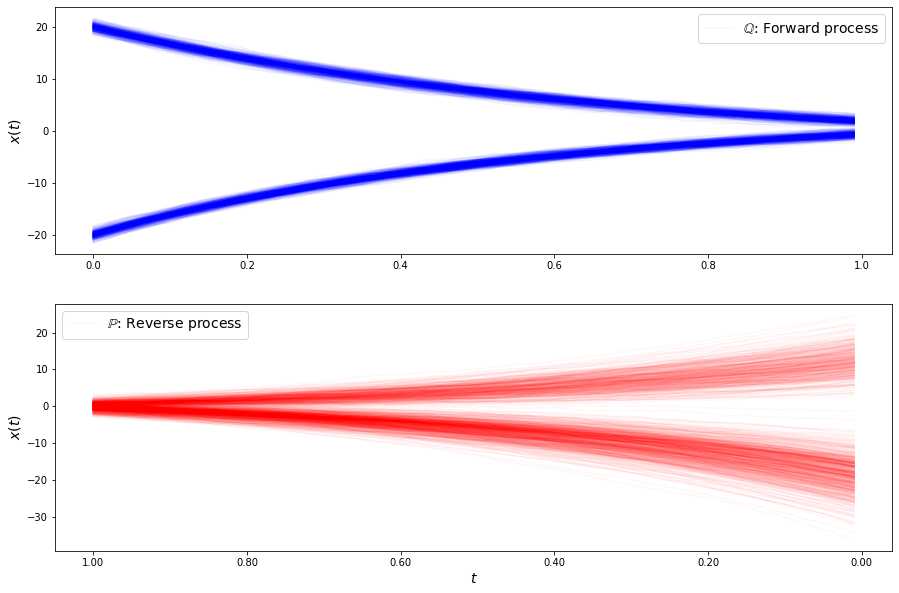

loss b 15.103906917266805
loss b 15.265275435480675
loss b 15.572534368686618
loss b 15.051050831988052
loss b 14.187394775280172
loss b 15.830378104454251
loss b 15.452429124614971
loss b 14.542548060520668
loss b 15.259261046380837
loss b 14.910108135075001
loss b 15.494690579223056
loss b 15.931590952428083
loss b 14.9562555750343
loss b 15.34488153480571
loss b 15.72644995133157
loss b 15.064764590277283
loss b 15.268214789838748
loss b 14.607489619312936
loss b 16.176028831464933
loss b 15.61496907902961
loss b 14.814206177270252
loss b 15.770255695558092
loss b 15.342420077315465
loss b 14.628969843217286
loss b 14.844296784187554
loss b 16.004115597809015
loss b 14.866399101434457
loss b 15.065727912118476
loss b 16.180574327658466
loss b 15.456878815616333
loss f 3.954222385186495
loss f 3.90551912551486
loss f 3.966802637408906
loss f 3.9914945499506267
loss f 3.9621002130044043
loss f 3.822012725838536
loss f 3.960561616885424
loss f 3.9244678601237872
loss f 4.06940593225345

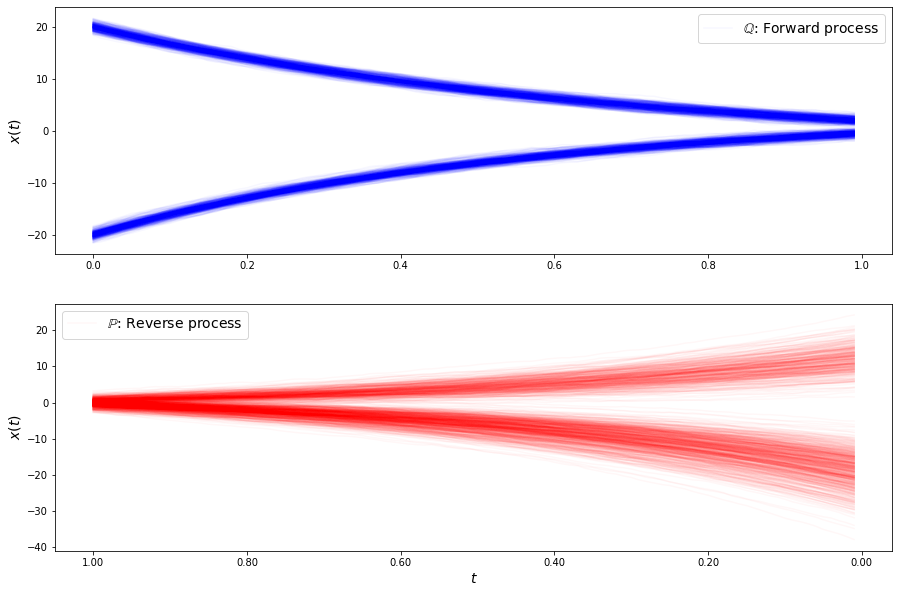

loss b 15.262602058123116
loss b 14.89438573392305
loss b 15.55655165214724
loss b 15.596622257112644
loss b 15.207967684551972
loss b 16.057521127961355
loss b 15.0472207877037
loss b 15.520100226812174
loss b 15.164640361279458
loss b 14.753841744994212
loss b 15.755833382265878
loss b 15.279215561892899
loss b 15.775085382411664
loss b 15.651096887787173
loss b 14.917968977902845
loss b 15.483563060158396
loss b 15.695604774662264
loss b 15.206942673407118
loss b 15.837489453189052
loss b 15.912164598347834
loss b 15.457547603651799
loss b 15.520016011758578
loss b 16.0392442404183
loss b 15.83249653107038
loss b 15.12298726784219
loss b 16.149578633121624
loss b 16.064226594976645
loss b 15.869179814924749
loss b 16.429117217323313
loss b 15.14619102823296
loss f 4.023592408975642
loss f 4.136718577998234
loss f 4.162941471892906
loss f 4.021398821499843
loss f 4.043071935824999
loss f 4.049669236565345
loss f 4.033567832636157
loss f 4.058657533360057
loss f 4.129784259865285
loss

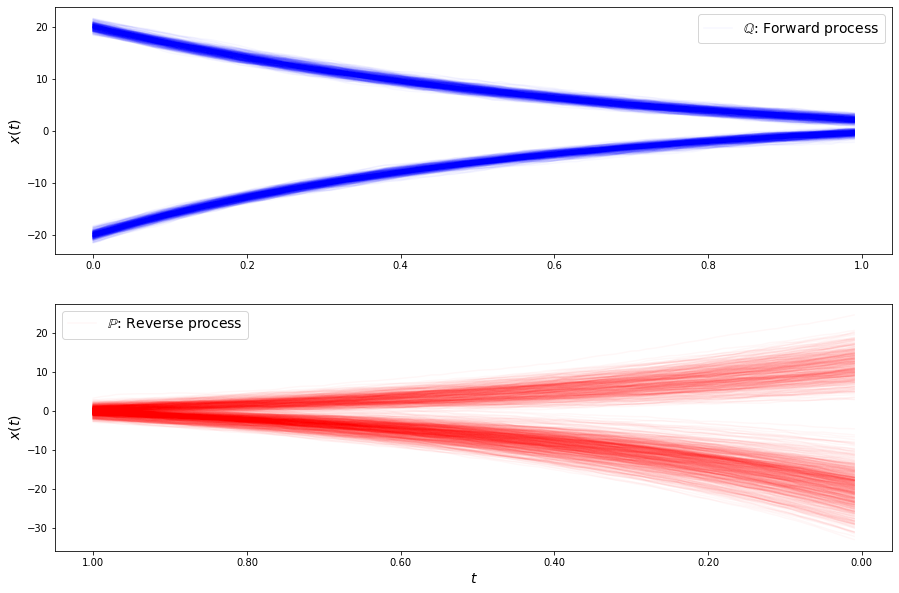

loss b 16.031170205939702
loss b 15.434933631245844
loss b 16.414035632845344
loss b 15.072754165013947
loss b 16.261539991480117
loss b 15.549329534811548
loss b 16.449761413060553
loss b 15.273334275545455
loss b 15.160406817786594
loss b 15.870068745652087
loss b 15.807604362843389
loss b 15.274788600451318
loss b 15.883932066799051
loss b 16.353536403915186
loss b 16.03120380951453
loss b 16.17803845071373
loss b 16.160035225763398
loss b 15.895451130738023
loss b 15.37391090689547
loss b 16.558290254675782
loss b 15.923248197971878
loss b 15.799520057331545
loss b 15.910296811148628
loss b 15.894029453659794
loss b 15.464281268062862
loss b 15.839505100883088
loss b 15.58321176184686
loss b 16.20595170612526
loss b 15.858331806836269
loss b 15.790471176502761
loss f 4.196094890769493
loss f 4.183504924060576
loss f 4.141498464249586
loss f 4.132774481567231
loss f 4.214192273177993
loss f 4.373033577351863
loss f 4.056357121786996
loss f 4.2635475883193745
loss f 4.248308947389887

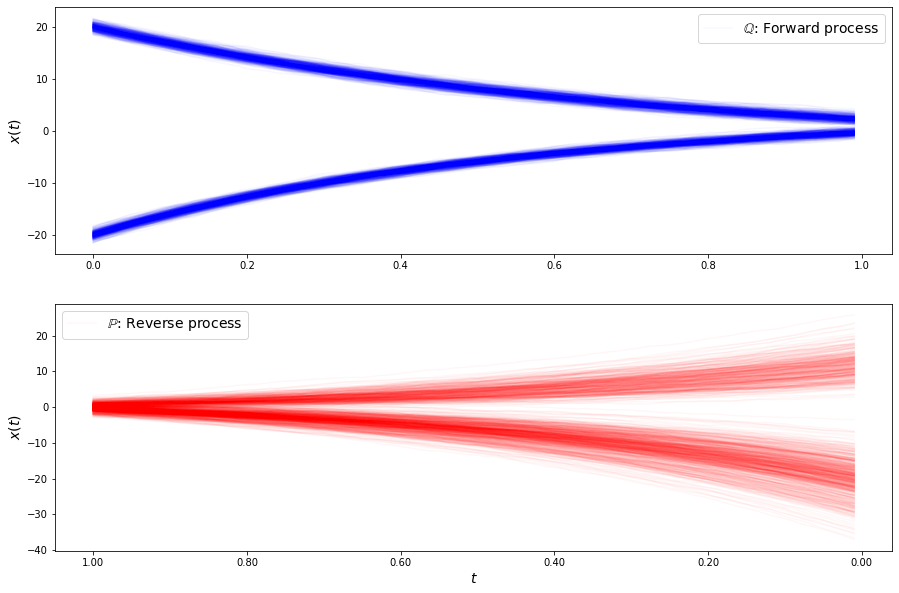

loss b 16.050405083189062
loss b 16.165431515476676
loss b 16.464351621112367
loss b 16.470075212063797
loss b 16.527743895871666
loss b 15.516370706554286
loss b 16.43001790443891
loss b 15.983360410154456
loss b 15.416002565617566
loss b 16.49720685786125
loss b 15.520121835548103
loss b 15.959429996668403
loss b 16.90674089717729
loss b 16.236331547871742
loss b 16.196181491709773
loss b 15.716199689723075
loss b 16.379094553606393
loss b 16.63395562868249
loss b 15.320878456900488
loss b 16.39241770002802
loss b 15.810513037085876
loss b 16.51071956761168
loss b 16.5581120792794
loss b 17.607140683858503
loss b 16.583660796754252
loss b 16.4861434014377
loss b 16.331018102301194
loss b 16.02315394496614
loss b 16.122885369111636
loss b 16.52133808295742
loss f 4.340386833503505
loss f 4.328700008315533
loss f 4.450063571389293
loss f 4.529050188106438
loss f 4.435601798831385
loss f 4.450907131382085
loss f 4.452475678719259
loss f 4.390992354720174
loss f 4.406676694260814
loss f 

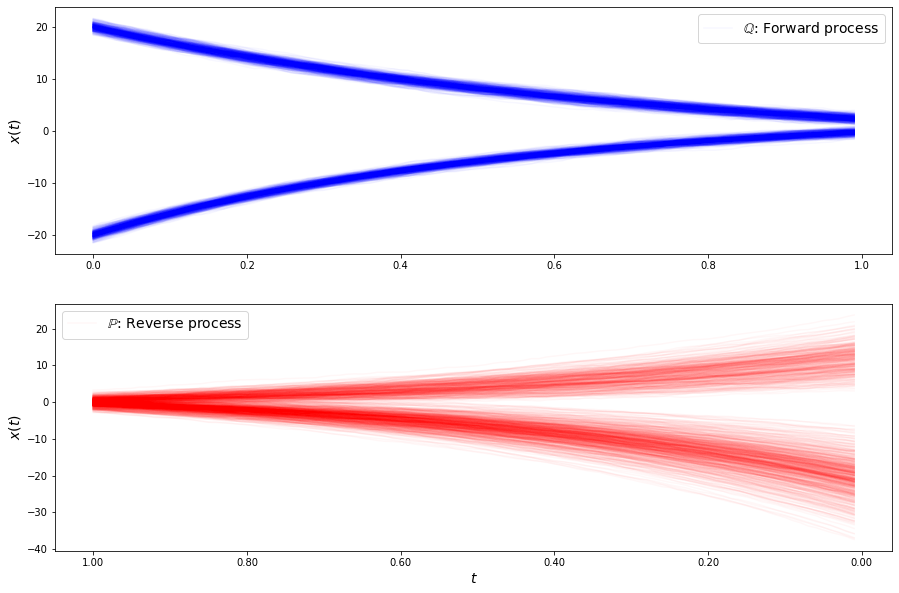

loss b 16.858840068045616
loss b 16.712440788109298
loss b 16.244410602776252
loss b 16.25834642214585
loss b 15.941346121034643
loss b 16.89609504523693
loss b 17.245112565746336
loss b 16.461893254088626
loss b 16.250077699539794
loss b 16.01383759040079
loss b 16.67474986999098
loss b 16.904724371811113
loss b 16.538965394449633
loss b 16.99835680348508
loss b 16.619295377955964
loss b 17.157452453371988
loss b 16.727001731343712
loss b 17.53290088784814
loss b 17.153030915486596
loss b 17.164283410709693
loss b 17.171114087791498
loss b 16.785697605185362
loss b 17.085745018258162
loss b 17.10039158359493
loss b 17.684435101675913
loss b 17.496288013492812
loss b 17.42287590359185
loss b 16.59396583127229
loss b 16.47147545533042
loss b 16.278060639711835
loss f 4.5878952650018086
loss f 4.627485300734418
loss f 4.746509938627522
loss f 4.672005339307488
loss f 4.503878991285436
loss f 4.667395259760016
loss f 4.7204283958818465
loss f 4.628939560109924
loss f 4.596306218558376
los

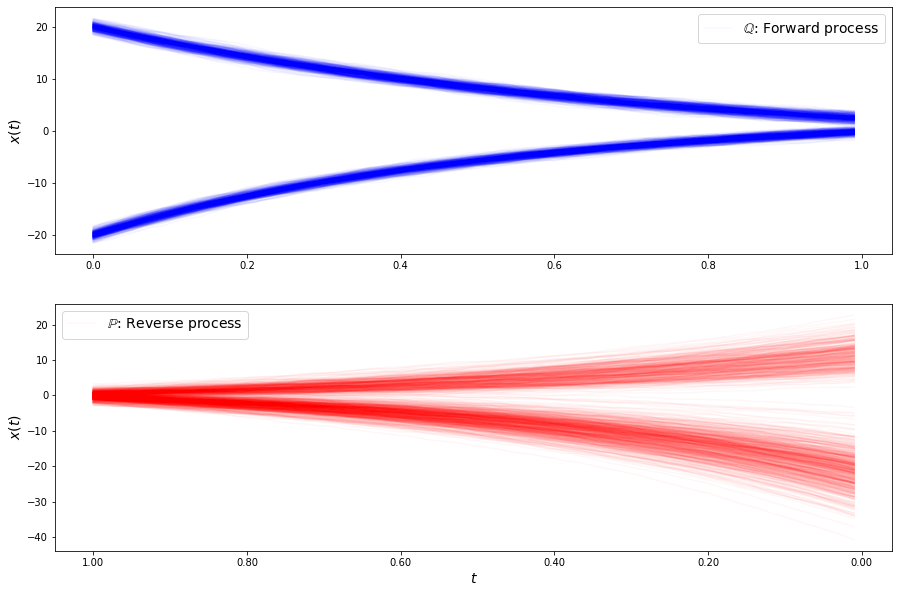

loss b 16.733990108321315
loss b 17.773602448672083
loss b 17.192331885788487
loss b 17.84864653516179
loss b 17.14567649431534
loss b 16.63897310515599
loss b 17.118282022560145
loss b 16.595794954781763
loss b 17.456464851977877
loss b 17.522135128825727
loss b 17.575107726862264
loss b 18.309728225585935
loss b 17.416586535867697
loss b 16.909711418423395
loss b 18.39394198859349
loss b 17.93135266772354
loss b 17.865748286850398
loss b 17.832972658359395
loss b 17.041122041334088
loss b 16.86531985858584
loss b 16.98943452598645
loss b 17.61822891080732
loss b 17.561260519648727
loss b 17.11246331592174
loss b 17.709863995553686
loss b 17.29203254882655
loss b 17.16861600325423
loss b 18.47085105901617
loss b 17.271249793345902
loss b 17.294796652501336
loss f 4.743048606610324
loss f 4.691856796318981
loss f 4.761677048417109
loss f 4.7892799150085885
loss f 4.820135817616986
loss f 4.8138298700037385
loss f 4.868757637262617
loss f 4.714932032704351
loss f 4.839609397121644
loss 

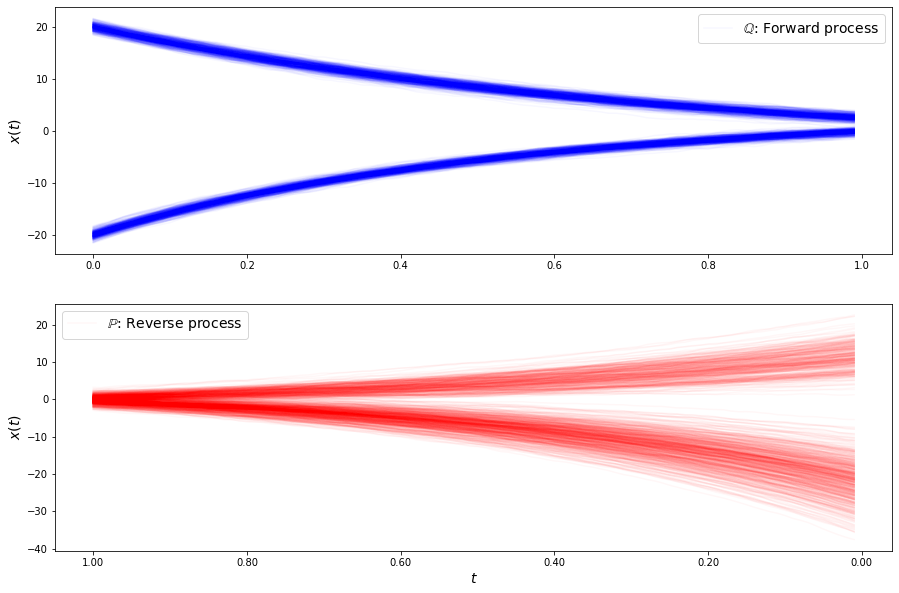

loss b 17.781173386134718
loss b 17.86664706984421
loss b 17.385905265834236
loss b 18.575893235910875
loss b 17.486970976038588
loss b 19.005953321000895
loss b 17.99067411740231
loss b 17.71055046512503
loss b 18.136116674195453
loss b 17.723671977080137
loss b 18.26069845807892
loss b 18.840818865153828
loss b 18.373203716027483
loss b 17.74682296534054
loss b 18.003296585287966
loss b 18.822080043813497
loss b 18.17534391024584
loss b 18.599999976034372
loss b 18.06182383893652
loss b 18.700486268717814
loss b 17.975766301998277
loss b 18.128559748107058
loss b 18.308293686875043
loss b 18.998783732605222
loss b 18.157857896946357
loss b 18.762859763438946
loss b 18.73089703572932
loss f 5.038791764892268
loss f 4.987773026617585
loss f 5.008127322091321
loss f 5.029771511615243
loss f 4.979659680927532
loss f 5.044096629931823
loss f 5.0573670913584365
loss f 5.037290660865262
loss f 4.978012096640759
loss f 5.062410607734628
loss f 5.044325259185746
loss f 5.11389147999089
loss f

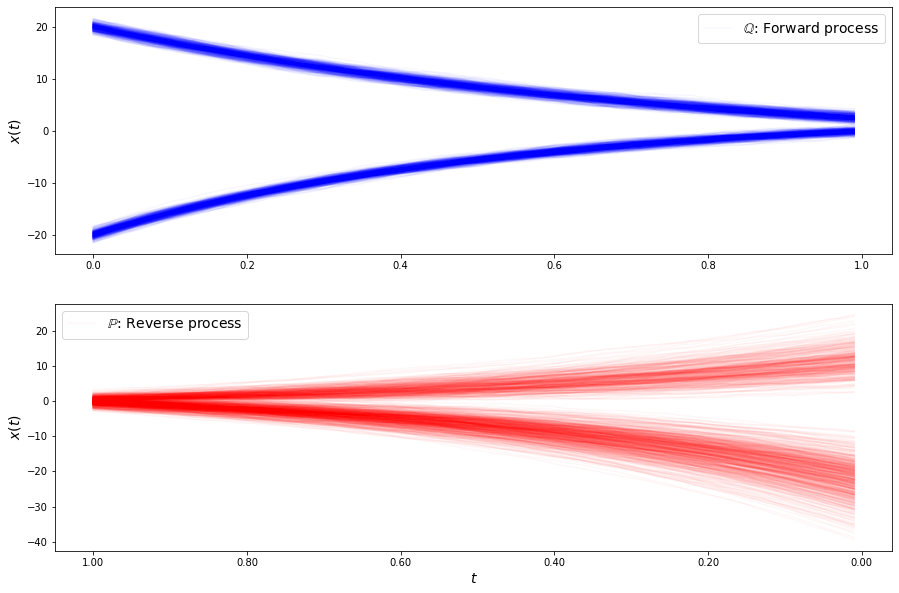

loss b 18.856316988824606
loss b 19.381144352535024
loss b 19.22201672812013
loss b 17.94807586637377
loss b 18.97040656181879
loss b 19.570072435006608
loss b 19.165062084539453
loss b 19.348588527093128
loss b 19.832907925325177
loss b 18.92317566990833
loss b 18.434364862026943
loss b 18.91049586672387
loss b 18.384724315566142
loss b 19.088778126146476
loss b 19.044876740636287
loss b 18.137737981121777
loss b 18.74758612999267
loss b 18.507119815994713
loss b 18.493545628961797
loss b 20.556751019026784
loss b 18.938780359722752
loss b 18.907151804020376
loss b 19.073215079461544
loss b 18.60751072871843
loss b 20.033499527796927
loss b 19.139494058019096
loss b 19.36916461609076
loss b 19.890472961555542
loss b 19.366562065008097
loss b 19.85033963679115
loss f 5.248008304411754
loss f 5.024678029600768
loss f 5.154521785053078
loss f 5.0863308507680784
loss f 5.216910247315491
loss f 5.12532387367654
loss f 5.255833088507638
loss f 5.184383087301425
loss f 5.251318512389298
loss

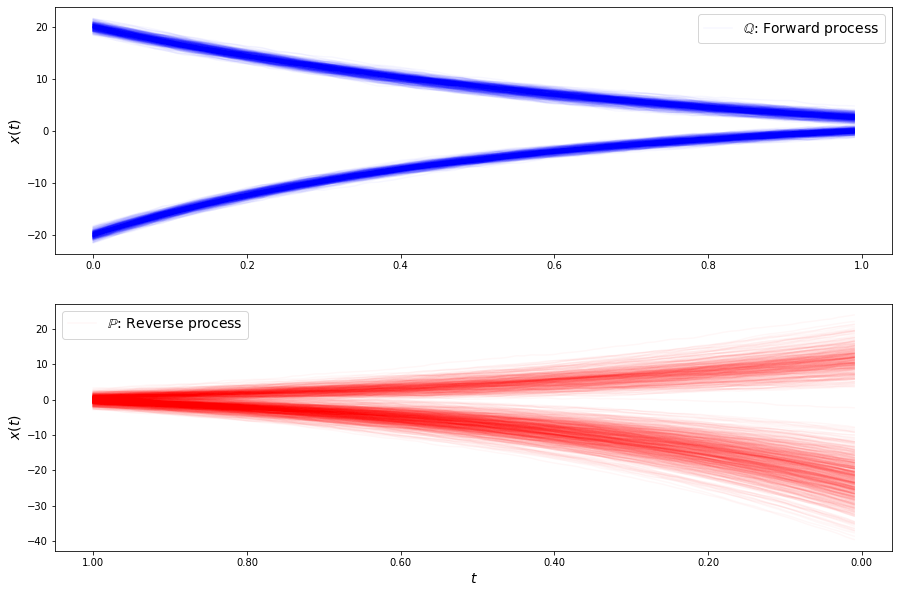

loss b 19.5883918629138
loss b 19.35921126852518
loss b 19.10518947565459
loss b 20.09349854456101
loss b 19.214215266656563
loss b 19.13278497839498
loss b 18.989736380369372
loss b 19.40473947067958
loss b 20.68552075746677
loss b 19.858507919413007
loss b 20.578626513787032
loss b 20.642925169884375
loss b 19.882098897236325
loss b 19.785635397632422
loss b 19.796666992238464
loss b 19.457693455717667
loss b 19.424088751904495
loss b 19.968682925491766
loss b 19.228559592897764
loss b 18.130948436152643
loss b 19.44098593379551
loss b 19.832913199379785
loss b 19.766017557930645
loss b 19.25417631274759
loss b 19.712453101712455
loss b 19.870767256085742
loss b 19.787229440781523
loss b 19.368688963493128
loss b 18.895062578729842
loss b 19.113860388950968
loss f 5.3465865932978245
loss f 5.317128958384161
loss f 5.2077013499803515
loss f 5.379648436884712
loss f 5.31978394988003
loss f 5.355475346864315
loss f 5.294478239227333
loss f 5.421981996258461
loss f 5.3145669068991825
los

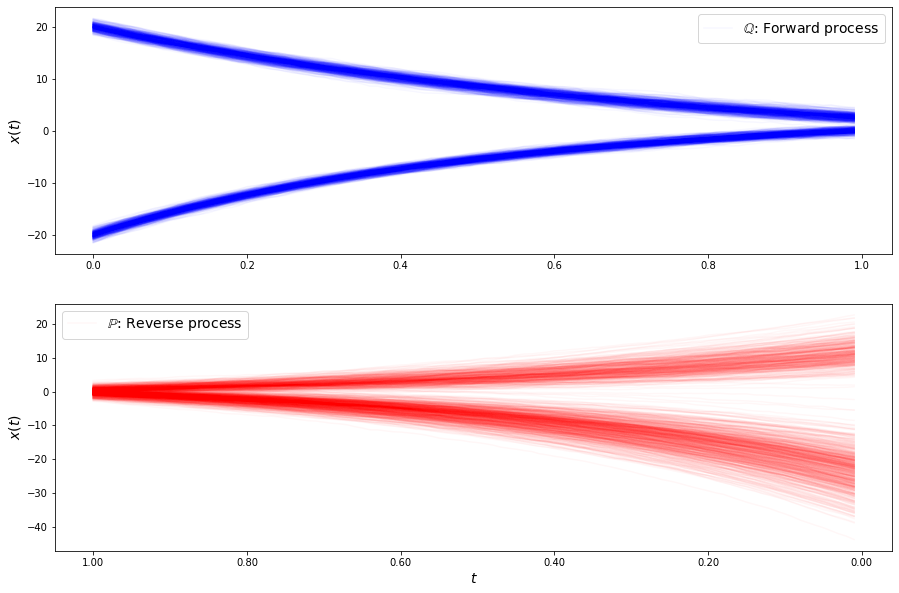

loss b 20.36676066287059
loss b 19.91309039557379
loss b 20.043874354047333
loss b 20.413566174420527
loss b 20.025757039639082
loss b 20.783737564948183
loss b 20.209465028223494
loss b 20.760671558675796
loss b 20.681341948939433
loss b 20.73712767108747
loss b 20.921442588714793
loss b 20.797899620878066
loss b 20.776697248278627
loss b 20.088075504042468
loss b 20.3948040133543
loss b 19.13234690985259
loss b 20.635660990766937
loss b 20.695251351727602
loss b 20.43776455339256
loss b 20.90432480967801
loss b 21.367460747470393
loss b 20.831183922926165
loss b 21.64223514155075
loss b 21.551997140625836
loss b 20.335078136388898
loss b 21.50295333115869
loss b 20.46247503820686
loss b 20.83716263130806
loss b 20.25383916777996
loss b 20.08047261759935
loss f 5.2747142450576
loss f 5.295148345981814
loss f 5.3330889107285735
loss f 5.4292944351753505
loss f 5.335270553916529
loss f 5.432061342375354
loss f 5.4045896112394045
loss f 5.344684692446237
loss f 5.3351610031128045
loss f 

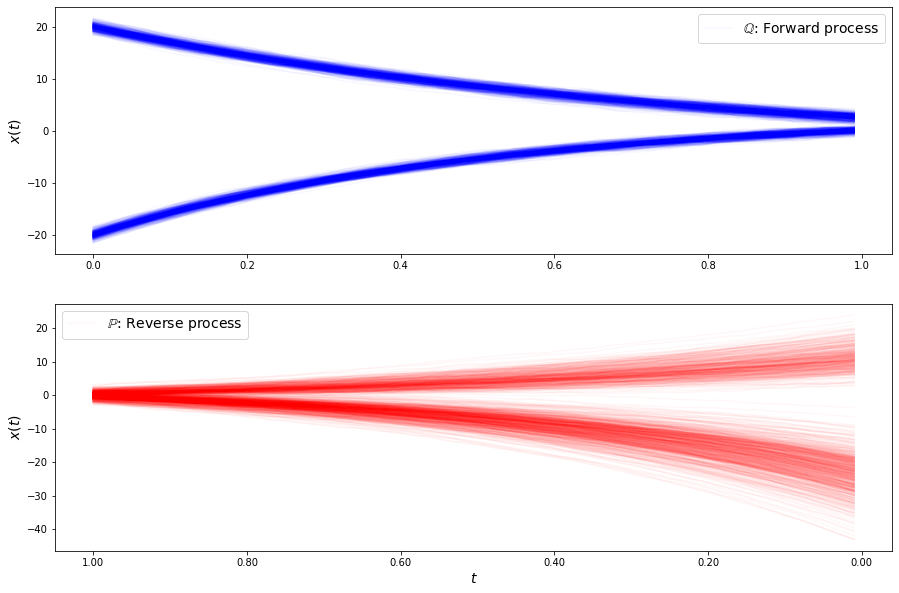

loss b 20.590135010043255
loss b 21.606304055965516
loss b 20.818568598195384
loss b 21.469462088571714
loss b 21.551752763059586
loss b 21.994757151306473
loss b 21.889973647303766
loss b 21.718475404780918
loss b 21.83411272920704
loss b 21.269030349989105
loss b 21.620676311165106
loss b 22.282833486340447
loss b 21.420521192117736
loss b 21.580799136349043
loss b 22.10589965631325
loss b 21.626894057248045
loss b 21.326028326024918
loss b 22.385999341498934
loss b 21.77633399704979
loss b 20.960666395777395
loss b 23.53691598003787
loss b 21.88345021602824
loss b 21.583063287297843
loss b 21.410569521403684
loss b 22.090337278118568
loss b 21.759771779774677
loss b 22.80618424100408
loss b 22.833233326067138
loss b 23.73645998923256
loss b 21.481910759995635
loss f 5.376402236842964
loss f 5.350173484300819
loss f 5.477519181056307
loss f 5.352903994261785
loss f 5.492791561945676
loss f 5.513399276597609
loss f 5.490837696613937
loss f 5.488116386009248
loss f 5.536514625333523
lo

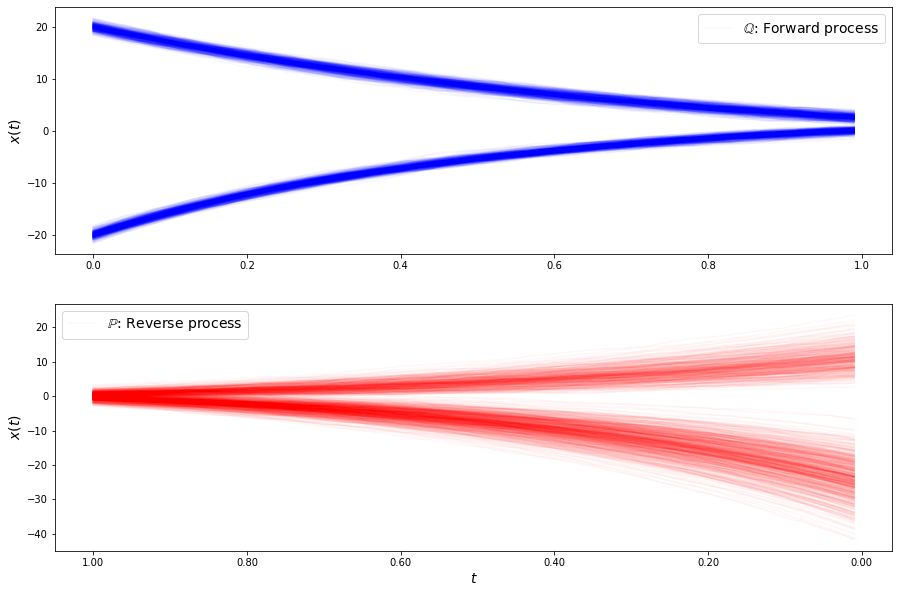

loss b 21.999066710890386
loss b 22.578985514302527
loss b 22.218340056520606
loss b 22.297889281095294
loss b 20.861559864900933
loss b 22.019468997884353
loss b 22.355267654056185
loss b 22.717716579660596
loss b 22.543325103105456
loss b 23.03836036112803
loss b 22.207661224254768
loss b 22.862507447689858
loss b 22.122958443547482
loss b 22.871543361551844
loss b 22.277164447718896
loss b 21.634673053048054
loss b 21.90516196728818
loss b 21.8139415677327
loss b 23.09740917847896
loss b 23.374494174532682
loss b 23.06174842017601
loss b 22.46299376121733
loss b 23.18458058042289
loss b 23.155492377654625
loss b 23.048951619839745
loss b 22.520420420364733
loss b 23.216653300213746
loss b 23.135453054773727
loss b 23.597131223495893
loss b 22.328986969277274
loss f 5.3405131233973
loss f 5.350448573702285
loss f 5.478918694167978
loss f 5.495429062116915
loss f 5.5362388108998655
loss f 5.482190582405396
loss f 5.389852587871586
loss f 5.372758640131099
loss f 5.490102343517498
loss

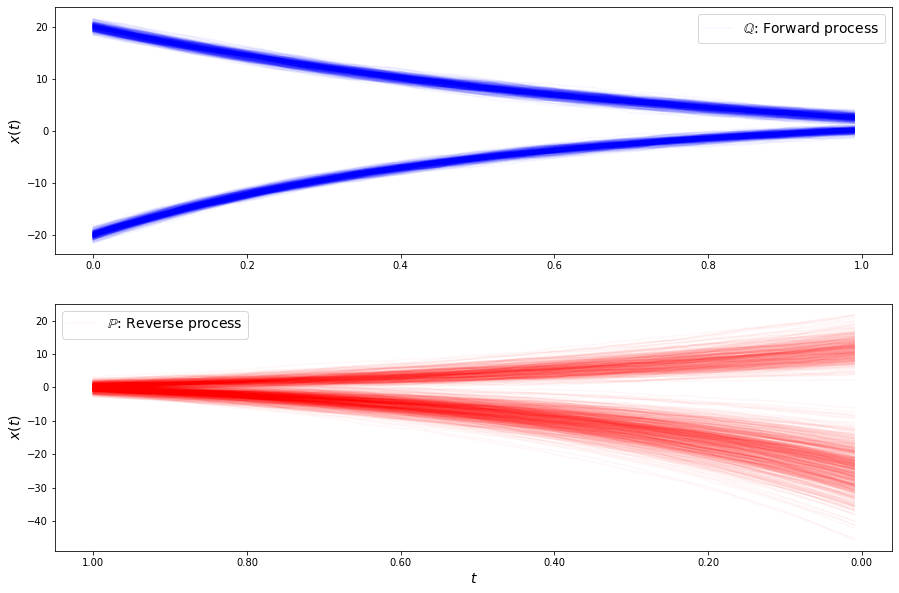

loss b 23.18410430968676
loss b 23.649228890698247
loss b 23.94539878856659
loss b 24.420154710766603
loss b 23.94157520721209
loss b 23.366915060045173
loss b 23.719539759993225
loss b 23.22951133696902
loss b 24.35864042350956
loss b 23.269144236382523
loss b 23.440706358799353
loss b 24.78909418690484
loss b 24.818792392693044
loss b 23.225506803368887
loss b 24.572031247207853
loss b 22.572336638359776
loss b 22.89608898389945
loss b 23.028634650703534
loss b 23.692615908500283
loss b 24.997164125829922
loss b 23.809182456889843
loss b 23.945822992874433
loss b 24.005449238869627
loss b 23.839964376348295
loss b 24.74254135287713
loss b 24.29266748446129
loss b 23.6149356052789
loss b 25.63579475020432
loss b 24.99755484973949
loss b 23.879898707187877
loss f 5.355768407933443
loss f 5.223607664354169
loss f 5.268807380160522
loss f 5.401430933630724
loss f 5.402852729949409
loss f 5.257626607574776
loss f 5.412152306951213
loss f 5.305530926910473
loss f 5.306223185341771
loss f 5

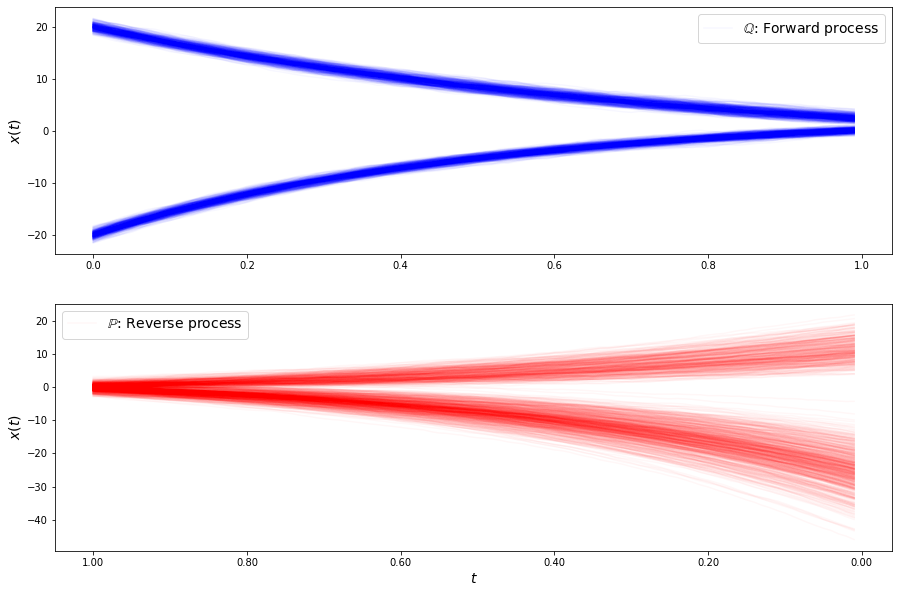

loss b 22.871567683810667
loss b 24.121570027851053
loss b 23.92821125388787
loss b 23.18523432715646
loss b 24.884039503154444
loss b 24.567727787101184
loss b 24.80794497349987
loss b 24.89324540590894
loss b 25.822126514843593
loss b 25.735281608303335
loss b 25.116613508112366
loss b 24.385819528172465
loss b 25.168495627891318
loss b 24.770521472967836
loss b 24.597877429068582
loss b 24.811731483938882
loss b 24.76503320506129
loss b 25.39327213894089
loss b 23.382977711537094
loss b 23.602054527825494
loss b 24.5517234647204
loss b 24.046131035215762
loss b 25.040990608754793
loss b 25.380151071808736
loss b 24.928444493512345
loss b 24.8193800817151
loss b 24.764245892189678
loss b 25.16161392844303
loss b 25.092462722686143
loss b 24.89603229658426
loss f 5.2423764003103575
loss f 5.192736825362373
loss f 5.210992064773511
loss f 5.331641369049795
loss f 5.2984968773749195
loss f 5.315765581228046
loss f 5.259957812624555
loss f 5.23378673814047
loss f 5.273856072990314
loss f

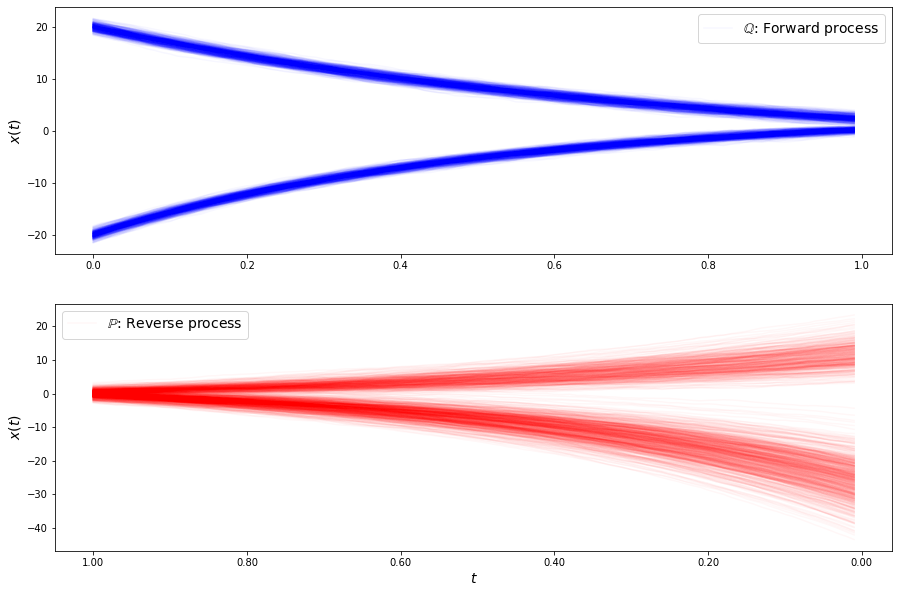

loss b 24.67432289308811
loss b 24.332902826813626
loss b 25.36549995818287
loss b 24.578299123311137
loss b 24.549280555668407
loss b 25.421361575515423
loss b 24.470626903223543
loss b 25.453479469678584
loss b 24.87952342892587
loss b 25.4722771070167
loss b 24.49197701070783
loss b 26.156417083634658
loss b 25.32179984476618
loss b 24.47868502263966
loss b 25.122779013781795
loss b 24.90616136817719
loss b 26.988443412662193
loss b 25.667217473229098
loss b 24.94199485004542
loss b 25.997886920378164
loss b 25.11536467751889
loss b 25.55921199458086
loss b 24.81119120600495
loss b 26.58935834041453
loss b 25.705020693852013
loss b 24.659897059631742
loss b 25.836813119280603
loss b 25.630879546249535
loss b 26.39732653936961
loss b 25.78864408248081
loss f 5.135024523622014
loss f 5.075594059203794
loss f 5.1511989085974985
loss f 5.123887553526401
loss f 5.120090542651132
loss f 5.1638159763298095
loss f 5.107913896135956
loss f 5.175502483829055
loss f 5.172390530068954
loss f 5.

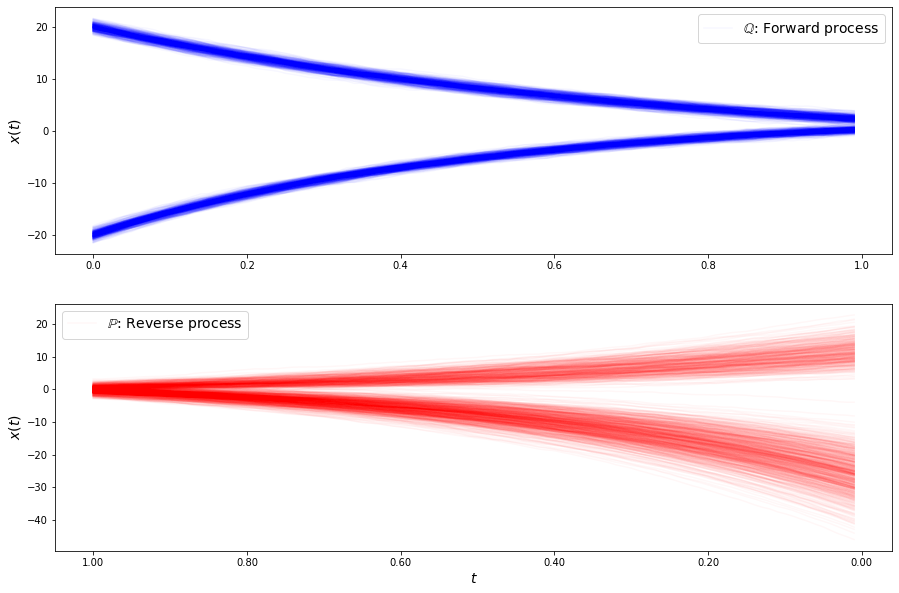

loss b 25.34269157939432
loss b 26.233186533245473
loss b 26.60471416508445
loss b 26.070845716822525
loss b 26.20874213783101
loss b 26.508098833909326
loss b 25.437054331773016
loss b 25.432375410518063
loss b 25.725595627096155
loss b 27.00662866257057
loss b 25.78318557307534
loss b 27.03724833083699
loss b 26.02946429370853
loss b 25.795410621629212
loss b 25.649260547564893
loss b 24.380823347714713
loss b 25.531796947719286
loss b 26.13276635363253
loss b 27.728857422768424
loss b 26.158217544723605
loss b 26.076157225793434
loss b 26.297820721840683
loss b 25.91607842007607
loss b 26.427073621650386
loss b 25.310885908434404
loss b 26.206902496863595
loss b 26.625398199271817
loss b 26.368720597685233
loss b 26.47330033240658
loss b 26.144041979214766
loss f 5.0472359786913845
loss f 5.0105099244266516
loss f 5.161703444666867
loss f 5.110187546283225
loss f 5.023362778002542
loss f 5.054273914687239
loss f 5.132420630683993
loss f 4.997414816100111
loss f 4.953817142693244
los

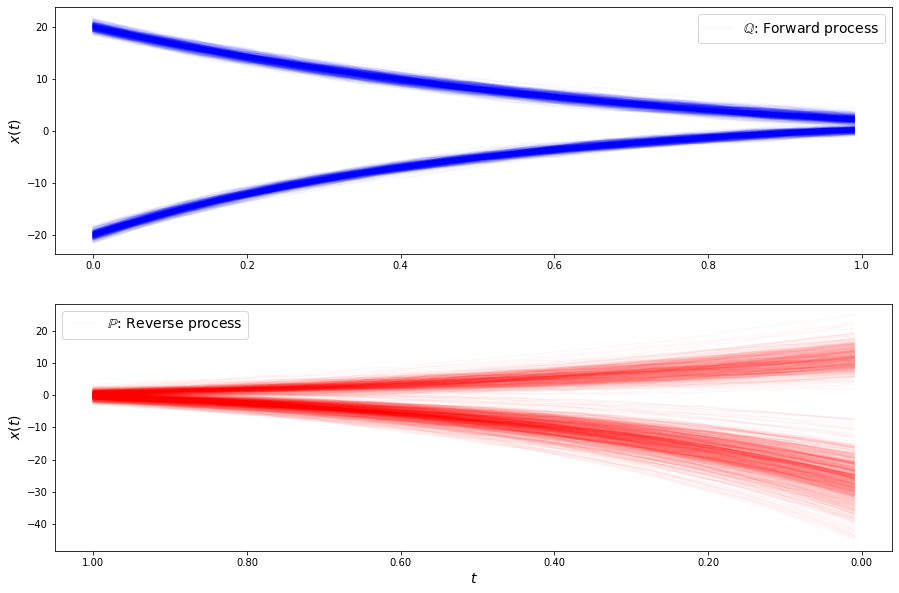

loss b 26.554633663289284
loss b 27.289019664610503
loss b 27.19985668057567
loss b 26.872600096018854
loss b 26.753166026696736
loss b 26.85852204540445
loss b 26.62683214426329
loss b 26.62733105167925
loss b 26.582604111150047
loss b 27.65925492863536
loss b 27.318229710148046
loss b 26.266480299532645
loss b 27.016829796241275
loss b 26.018989308123782
loss b 26.308166988968367
loss b 28.183659928716775
loss b 27.054577098629615
loss b 26.70760625406713
loss b 26.317377470846637
loss b 28.020935761416847
loss b 26.38900423328304
loss b 26.959307236491473
loss b 27.583256570242074
loss b 26.87243999876906
loss b 26.295663012204013
loss b 26.625664500547575
loss b 26.457033849128177
loss b 27.318532667355676
loss b 27.7640045963883
loss b 28.352197432307797
loss f 4.971025295768355
loss f 4.906469243166119
loss f 4.988105135903793
loss f 4.924808870866893
loss f 4.990300685046803
loss f 4.986974820996274
loss f 4.910545941828925
loss f 4.99936564459381
loss f 4.995778647061489
loss f

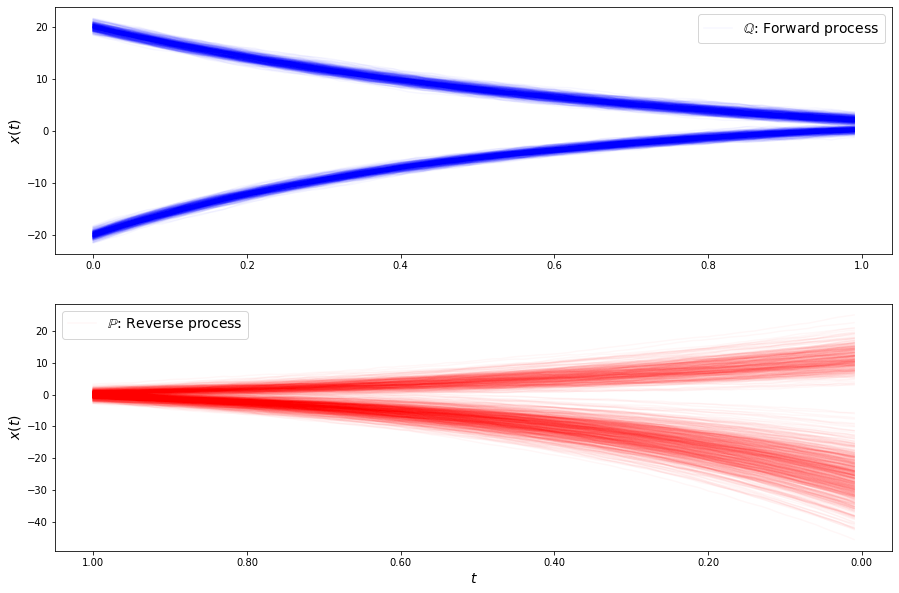

loss b 27.526922951920852
loss b 26.62868135247364
loss b 27.408966928882943
loss b 27.27223373270264
loss b 26.552345399029264
loss b 26.620969530761343
loss b 27.757039412544263
loss b 28.53416623309783
loss b 28.201515103430363
loss b 27.057987348766602
loss b 26.63279028799711
loss b 27.960540970720782
loss b 27.06856688569272
loss b 27.3093940792536
loss b 28.45421510050571
loss b 26.932604050381688
loss b 27.950526868285063
loss b 27.780365257388215
loss b 28.165062185466173
loss b 27.08517927536266
loss b 28.06030467511932
loss b 27.570878129747484
loss b 27.4544308909102
loss b 26.99554755224011
loss b 27.140713948793728
loss b 27.434911497983396
loss b 27.655145825931143
loss b 27.15618650186053
loss b 26.73090220503632
loss b 27.802604240385854
loss f 4.801853721481407
loss f 4.780582293095542
loss f 4.942435883863379
loss f 4.816502466321282
loss f 4.776859460662242
loss f 4.888588556869075
loss f 4.978528431520308
loss f 4.806489780213717
loss f 4.859013868045703
loss f 4.8

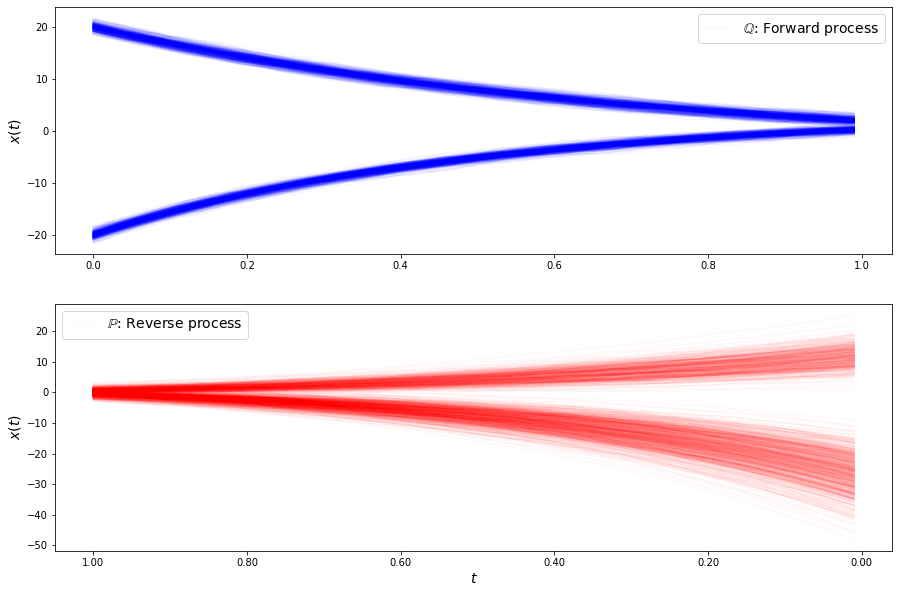

loss b 25.950632535959784
loss b 27.350091753062927
loss b 27.627957947039214
loss b 28.177774655637137
loss b 27.515945079131612
loss b 27.896175959640914
loss b 27.287178456920696
loss b 28.023501854320546
loss b 27.667387677430742
loss b 26.88251244779
loss b 27.19069615568784
loss b 27.439522640338097
loss b 26.74000526895486
loss b 26.59027293499598
loss b 27.023268167419072
loss b 27.389894043442002
loss b 27.596910682973792
loss b 27.698234631497563
loss b 27.901188711404682
loss b 28.075368574744054
loss b 27.727561181248735
loss b 27.49768553791522
loss b 27.895952565188608
loss b 27.730289008561765
loss b 27.65389618495289
loss b 27.629229983384505
loss b 26.088644930261875
loss b 27.211219517013053
loss b 26.89351379732356
loss b 28.534072044379105
loss f 4.810512231420707
loss f 4.758917626899844
loss f 4.770382925404052
loss f 4.695946994988026
loss f 4.766934237973156
loss f 4.7829166029939
loss f 4.70247277469194
loss f 4.840844947095481
loss f 4.827469274259152
loss f 4

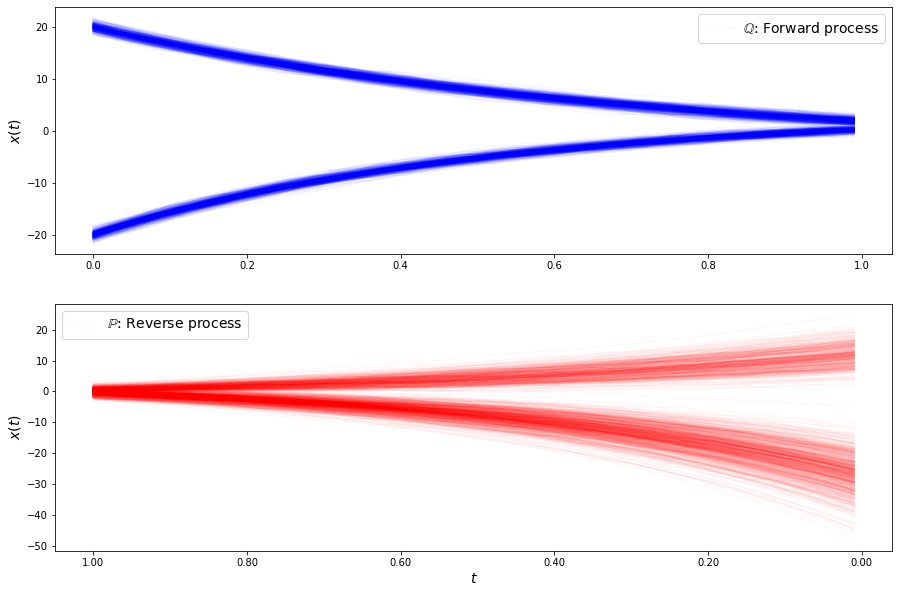

loss b 27.510531857668667
loss b 28.77656819399267
loss b 26.84913217100119
loss b 27.665315006602263
loss b 28.43019045420548
loss b 27.29170373224054
loss b 27.411292798714676
loss b 27.428638195866778
loss b 26.8137875256233
loss b 26.743938878296845
loss b 27.289280255162115
loss b 27.88092509997096
loss b 27.39824701169671
loss b 26.306280353402286
loss b 27.31738173096237
loss b 27.759274793010498
loss b 26.964355498477495
loss b 28.054717422961318
loss b 26.762852655220374
loss b 27.11200371845639
loss b 26.629437410278896
loss b 27.481785364313808
loss b 26.970236471516618
loss b 28.45909645611728
loss b 27.10017283053564
loss b 27.053722799974622
loss b 28.192199893707826
loss b 28.20225558832033
loss b 26.996020163632608
loss b 26.203542421027443
loss f 4.730836440034448
loss f 4.629051608951086
loss f 4.714252794860164
loss f 4.725985017293762
loss f 4.694276794480416
loss f 4.702364980743631
loss f 4.741446217583512
loss f 4.692214984569679
loss f 4.79645717471664
loss f 4.

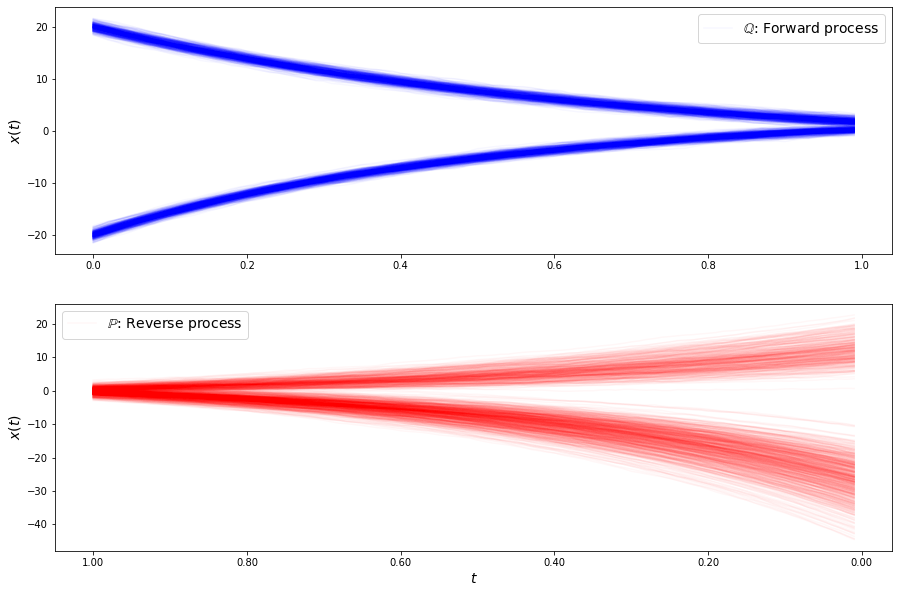

loss b 28.4543799810477
loss b 26.906953697715956
loss b 26.786940300491995
loss b 27.918900025030748
loss b 26.984078320779787
loss b 28.870443529583806
loss b 27.125592884978573
loss b 26.756934671172846
loss b 27.130504062690132
loss b 27.243077851134018
loss b 26.906546528694356
loss b 27.283873571587957
loss b 27.4569032790839
loss b 26.910454940671023
loss b 25.782901137905885
loss b 27.844931160550072
loss b 28.005431458856517
loss b 27.129129511898032
loss b 28.076305984660735
loss b 26.995035505744156
loss b 25.203186374524417
loss b 26.587899950248904
loss b 26.356746643381623
loss b 27.444898302645544
loss b 26.711629273256154
loss b 26.911322998009133
loss b 26.511130905381478
loss b 26.560329978268783
loss b 27.500702561986994
loss b 26.93324391229345
loss f 4.601756641614828
loss f 4.695063741670402
loss f 4.669428310877545
loss f 4.744021438308265
loss f 4.71943422496774
loss f 4.646897372400095
loss f 4.66218808832925
loss f 4.7174132544014995
loss f 4.653278489292474
l

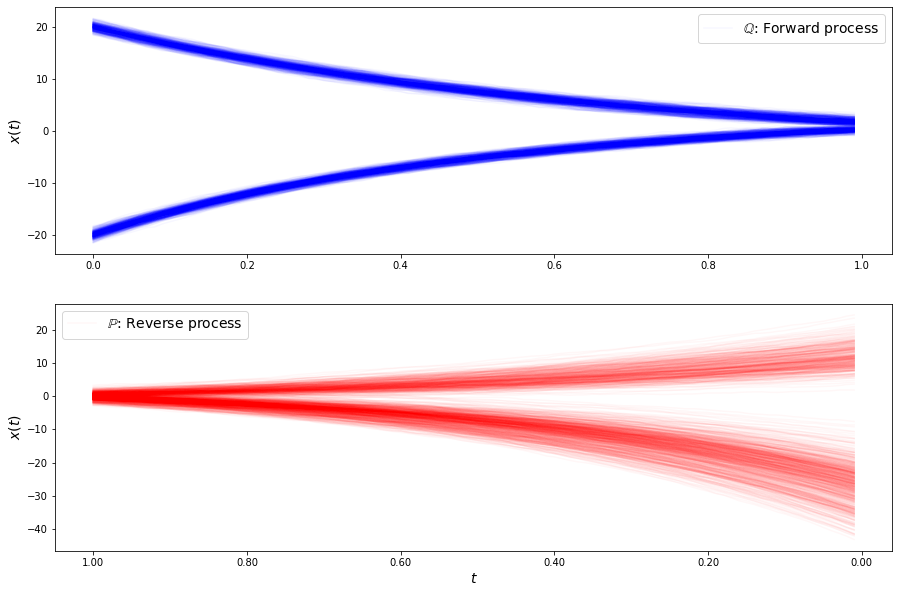

loss b 26.352772577686906
loss b 25.50799417997435
loss b 26.037217746984844
loss b 27.35019456222866
loss b 26.518015281112227
loss b 26.272662309463602
loss b 27.999765730112944
loss b 25.95447894811341
loss b 27.761554402059126
loss b 26.216138841270297
loss b 27.121602136549054
loss b 26.796227688725587
loss b 26.215373433295653
loss b 26.918051411223388
loss b 26.770474444351027
loss b 26.507034656705265
loss b 27.125794635728404
loss b 26.834782754756993
loss b 26.472590305738226
loss b 28.33891927990926
loss b 27.106778726768212
loss b 27.797077618216246
loss b 25.267456752218372
loss b 27.04508529727583
loss b 25.918747642614512
loss b 26.376083519325665
loss b 26.669009178730974
loss b 26.69923186918678
loss b 26.72889595050233
loss b 25.58540870594025
loss f 4.61817963960314
loss f 4.670359959082579
loss f 4.609305617619364
loss f 4.639806255976876
loss f 4.620797501689207
loss f 4.596154622186176
loss f 4.629997359722117
loss f 4.680348667621605
loss f 4.534984860693135
loss

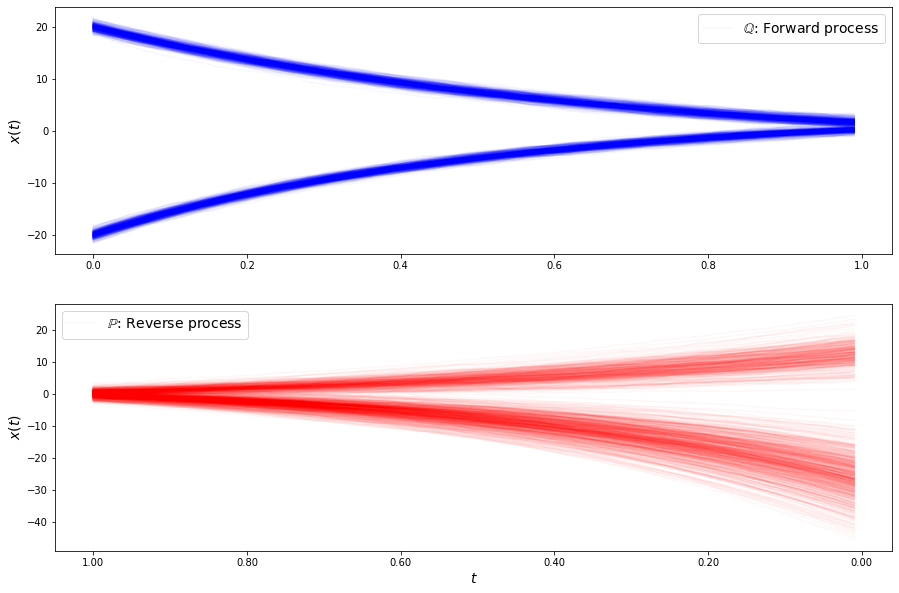

loss b 26.591126788843347
loss b 25.663823976601428
loss b 28.168151227733794
loss b 26.141069182145475
loss b 26.887400629201778
loss b 26.07572364927703
loss b 25.64871995252544
loss b 25.679272506193755
loss b 25.422290891821916
loss b 26.504260356646117
loss b 25.82534995048708
loss b 24.25559312427364
loss b 26.016524345296087
loss b 26.7030776792235
loss b 25.804164622027372
loss b 25.638967068470222
loss b 25.24750604925966
loss b 24.71606389215355
loss b 25.26185820630448
loss b 25.130881779796617
loss b 25.809757120784315
loss b 25.199339752386553
loss b 25.97925503317745
loss b 25.919004916368465
loss b 24.755524174149972
loss b 26.338305531644284
loss b 24.607494950940023
loss b 25.719379821289223
loss b 24.82603386188593
loss b 25.100246845709346
loss f 4.552584745103963
loss f 4.5248860754027
loss f 4.516467076678941
loss f 4.475168511724876
loss f 4.531189191271489
loss f 4.50252382227397
loss f 4.510354048734579
loss f 4.463930638355215
loss f 4.6220508570820265
loss f 4

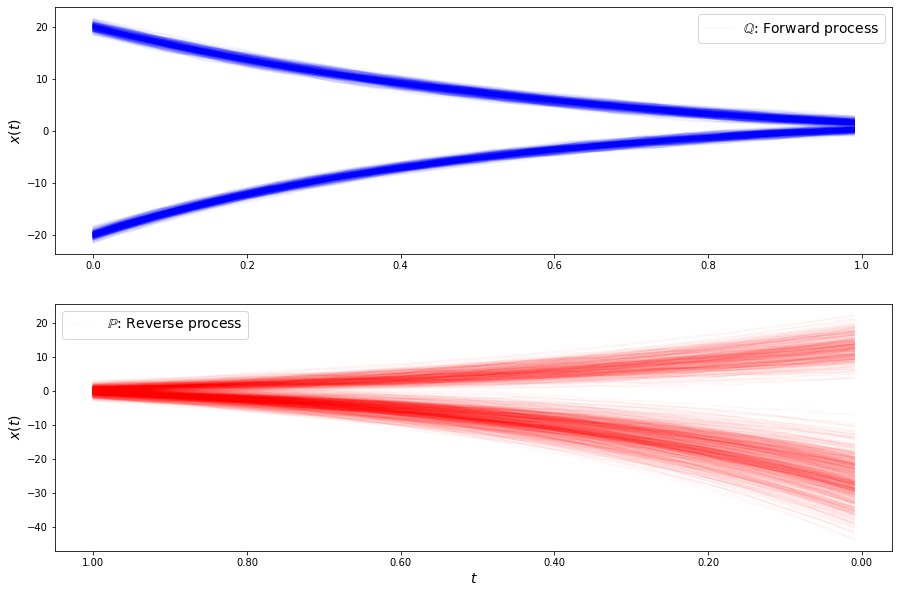

loss b 24.665705927508693
loss b 25.79065330519201
loss b 25.862647111361866
loss b 25.272736200401305
loss b 25.144079535287126
loss b 24.921524786256892
loss b 24.517821749922692
loss b 24.85317193379111
loss b 24.15745004593874
loss b 25.30883813239728
loss b 24.15400103040417
loss b 25.077595320987406
loss b 24.743818167069566
loss b 24.651560047206655
loss b 24.020525010816804
loss b 25.51356821286287
loss b 23.964363929945492
loss b 24.192277036606058
loss b 23.957106674116005
loss b 24.797380534030754
loss b 24.727574468380425
loss b 24.002716135943174
loss b 23.374090000213442
loss b 23.339734272970297
loss b 24.633096661057017
loss b 25.058774286955067
loss b 24.513808013088834
loss b 24.35707375327602
loss b 23.02492482898497
loss b 24.364457707669214
loss f 4.365334654746822
loss f 4.346167699649357
loss f 4.231820214595805
loss f 4.291074168271613
loss f 4.31074782301966
loss f 4.29046006040587
loss f 4.338551209767385
loss f 4.261868485178725
loss f 4.290746461031659
loss 

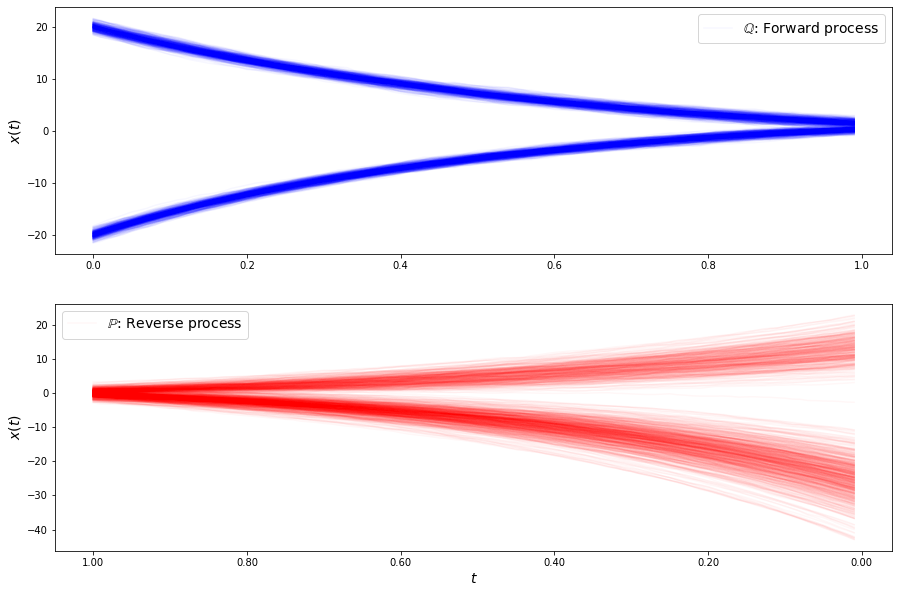

loss b 23.31393345386068
loss b 22.343463812952358
loss b 23.34713096499907
loss b 21.91286298424361
loss b 22.686936227020567
loss b 22.7166109622726
loss b 22.086128671870803
loss b 21.157241435539827
loss b 21.887046694956982
loss b 21.581208870037443
loss b 22.904029831237594
loss b 22.025897280954304
loss b 20.603177967039507
loss b 22.658464538424784
loss b 22.592192887816637
loss b 21.72268863776147
loss b 22.89719794655501
loss b 22.997364627502947
loss b 22.49741034367838
loss b 21.781253960439294
loss b 21.700612137789488
loss b 21.81301097493106
loss b 21.463832015006787
loss b 21.632553603150313
loss b 20.28088940990314
loss b 21.39202950723559
loss b 21.626639972302183
loss b 20.665847314600352
loss b 21.747747869721067
loss b 21.297898186427517
loss f 4.152316079719633
loss f 4.1554874347754005
loss f 4.224445596538351
loss f 4.092096784391429
loss f 4.160758947004236
loss f 4.194784796810956
loss f 4.139590578691889
loss f 4.172462973428507
loss f 4.192663157454879
loss 

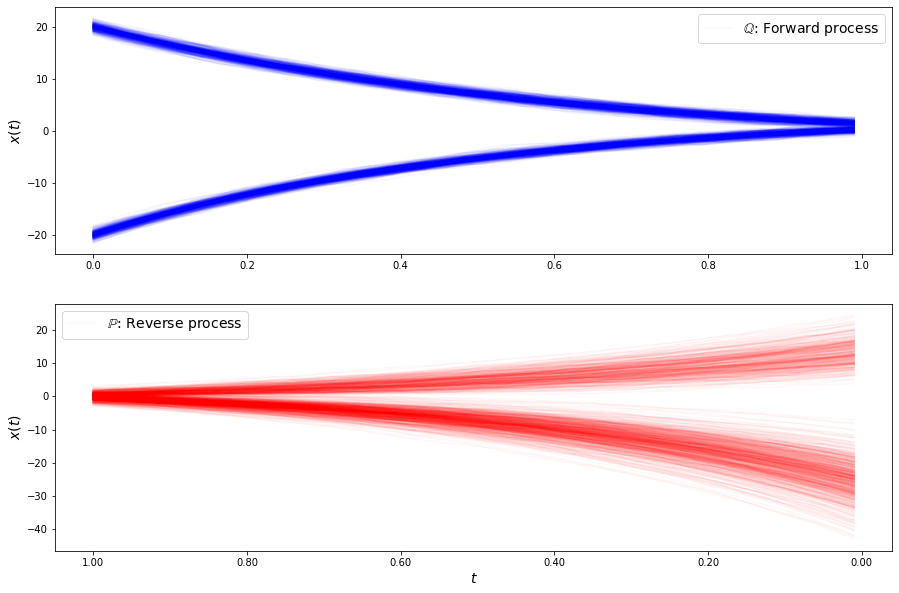

loss b 20.81331839398133
loss b 19.699494450778417
loss b 22.081144878309882
loss b 21.461022235816685
loss b 22.341772916264272
loss b 20.86182361708442
loss b 21.90330775961204
loss b 19.962830806323073
loss b 21.284322894932714
loss b 20.993561411804773
loss b 20.694708221642138
loss b 21.888511024272404
loss b 20.549769968840344
loss b 20.173757523367108
loss b 20.20832503501889
loss b 19.57279517966089
loss b 21.377783468706355
loss b 21.451781471814016
loss b 20.030908388752746
loss b 21.37307694627921
loss b 20.384492396928135
loss b 19.633150656593664
loss b 20.175666053867843
loss b 19.177788979834414
loss b 20.66438243056679
loss b 20.535100403435422
loss b 20.91646969597455
loss b 20.638333947301895
loss b 20.552086355027505
loss b 19.969095108515447
loss f 3.9293065933878726
loss f 4.048342639690573
loss f 3.991662743909683
loss f 4.059246713602449
loss f 4.035378673288847
loss f 4.001309189189631
loss f 3.948250876836401
loss f 4.024910240684851
loss f 3.939481718816556
lo

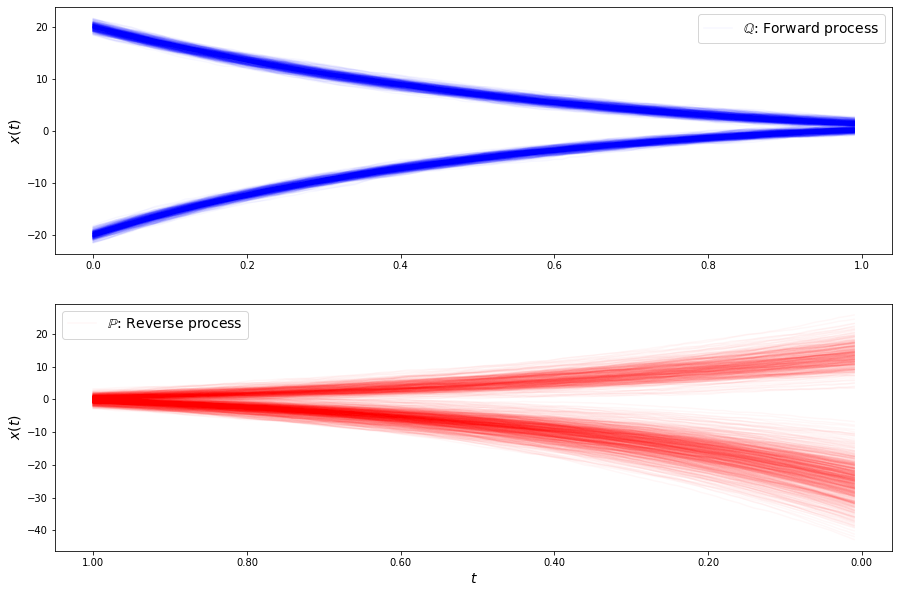

loss b 20.947495153037078
loss b 18.972680160536722
loss b 19.98240968771303
loss b 19.28569265113798
loss b 20.12687000883895
loss b 19.86367135457979
loss b 19.523383522172857
loss b 18.961631121545185
loss b 19.898557919372344
loss b 19.365945440094475
loss b 21.029444071622365
loss b 19.669818209227277
loss b 19.594230652607376
loss b 18.471212397280972
loss b 20.06036953302922
loss b 19.58874228875467
loss b 19.647515192074376
loss b 19.7021338255763
loss b 20.332949435286427
loss b 19.233939376185305
loss b 19.55516804769347
loss b 19.96577677208838
loss b 19.083438480267333
loss b 18.570809975934804
loss b 18.47676615938949
loss b 18.476076315721844
loss b 19.036511040554295
loss b 18.709922511351554
loss b 17.128562969736702
loss b 18.874793802255372
loss f 3.800557780494904
loss f 3.845328154576288
loss f 3.873974148574171
loss f 3.8831530726502925
loss f 3.8517694286212736
loss f 3.793099020938541
loss f 3.8488965590291873
loss f 3.882410155446319
loss f 3.8958219636153375
lo

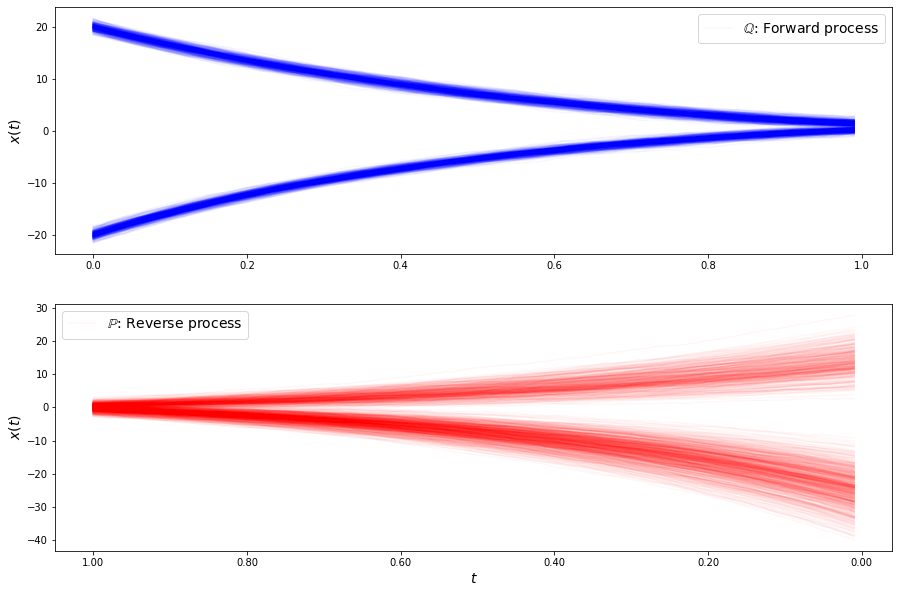

loss b 19.085797880598463
loss b 18.956785290745504
loss b 19.467561892218605
loss b 18.04198416998274
loss b 18.1454908936017
loss b 18.656781540428636
loss b 19.17351748314096
loss b 18.043176390929958
loss b 18.415981535041304
loss b 17.826471005601597
loss b 18.26340855449108
loss b 18.41397503100678
loss b 17.16208685291841
loss b 18.142166747211466
loss b 17.0759044628291
loss b 18.5912103345216
loss b 17.698653517000476
loss b 18.32140114421432
loss b 18.344636547280466
loss b 17.000047230488953
loss b 18.15086593749574
loss b 17.917528313879554
loss b 17.3345326567796
loss b 17.93582140995997
loss b 17.05630586343385
loss b 16.990575046877044
loss b 17.817396247689775
loss b 18.11993986203938
loss b 17.626649093258102
loss b 17.214524133304153
loss f 3.6485828663821263
loss f 3.6304629966919086
loss f 3.622437015313705
loss f 3.645974010577232
loss f 3.6150127071736
loss f 3.710630233208809
loss f 3.6407942587455935
loss f 3.650603263554429
loss f 3.7048499267116735
loss f 3.66

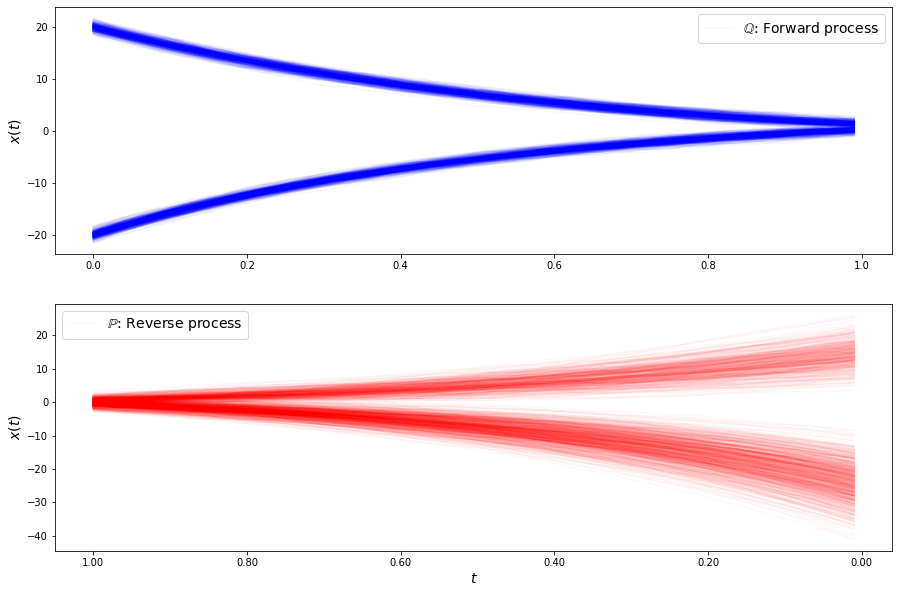

loss b 17.087401429009518
loss b 17.390933444269276
loss b 17.09088990153806
loss b 16.99629251765039
loss b 16.858662738656854
loss b 16.938249767205498
loss b 16.391025671118474
loss b 16.901239786545368
loss b 17.417179620656928
loss b 16.951385957854708
loss b 16.444152175352936
loss b 17.15956066926285
loss b 16.087473813756695
loss b 15.764457424120149
loss b 16.84671459672527
loss b 16.035132659187
loss b 16.36013922094005
loss b 16.19645253375274
loss b 15.97334367663593
loss b 16.362287000108093
loss b 15.973560189477775
loss b 16.140104885599712
loss b 15.633829722266038
loss b 16.61701199331071
loss b 16.252316434186238
loss b 16.521689999890338
loss b 14.502778675731511
loss b 15.538466807377672
loss b 16.210704892887428
loss b 16.909794900331327
loss f 3.5082583294450025
loss f 3.545601081659354
loss f 3.532365577929472
loss f 3.4943524674796103
loss f 3.5367481624134434
loss f 3.514248083111038
loss f 3.5171212539870718
loss f 3.5012065241647967
loss f 3.4979487845141275


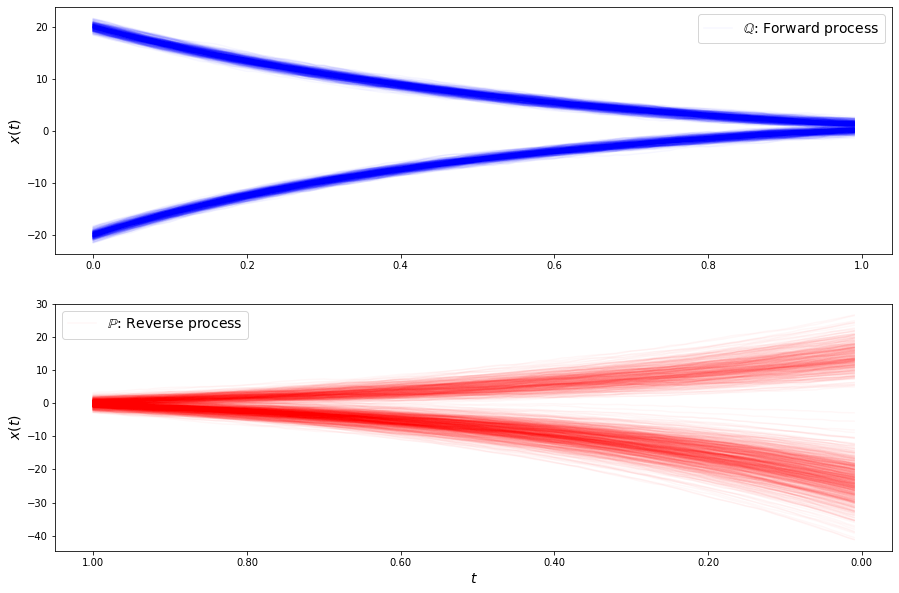

loss b 15.51595816554189
loss b 15.554733447914186
loss b 15.881041238426635
loss b 16.23680963921699
loss b 15.629683136582683
loss b 15.58458244628789
loss b 15.681711642251404
loss b 15.424248163110589
loss b 14.831095968777744
loss b 15.274268813859043
loss b 15.858053125308105
loss b 15.885774521841721
loss b 15.50009004847068
loss b 14.634914995361644
loss b 14.204544768843146
loss b 15.478388814691664
loss b 14.673502246960032
loss b 15.32721072493709
loss b 15.137598052476458
loss b 15.37579068225934
loss b 14.844473000280336
loss b 14.78174641379138
loss b 14.81922086796631
loss b 15.576217240652007
loss b 15.061413534279763
loss b 14.222279269053585
loss b 14.481369378943487
loss b 14.410189412701493
loss b 14.676425923825736
loss b 15.493272416643432
loss f 3.3264512035771956
loss f 3.281473960775084
loss f 3.381293863619485
loss f 3.300415325066093
loss f 3.308987045673484
loss f 3.3490334869452707
loss f 3.3543383709576466
loss f 3.3313099561128707
loss f 3.330464764609816

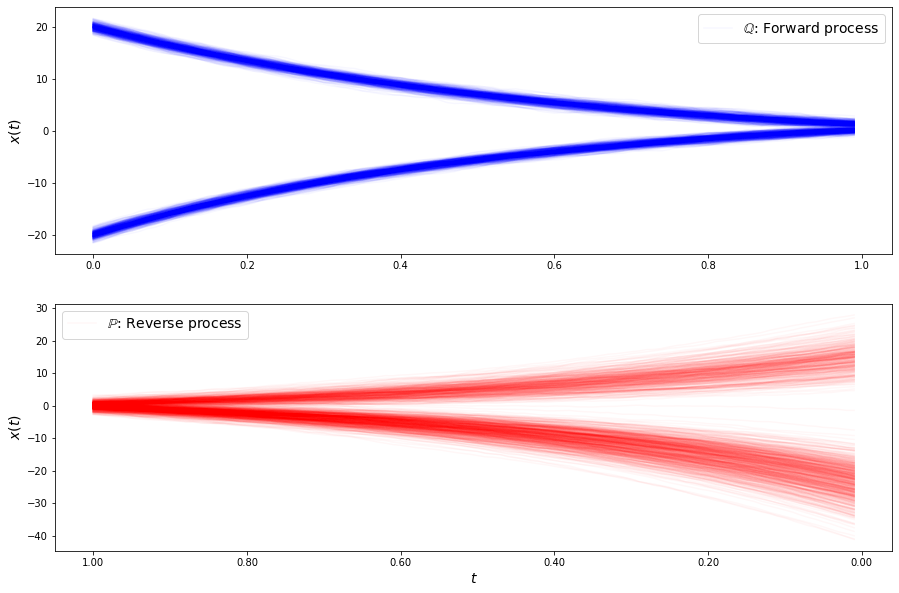

loss b 14.30094310869844
loss b 15.410908672073509
loss b 14.48625012317021
loss b 14.159476774027649
loss b 14.361506544774674
loss b 14.694319894986025
loss b 13.851855873106219
loss b 14.148511410794084
loss b 13.783579841097028
loss b 15.20896913392396
loss b 14.580439972520768
loss b 13.836688618464102
loss b 13.953633264916304
loss b 14.222121038226561
loss b 14.18920143974384
loss b 13.291591033551809
loss b 14.143092087409709
loss b 14.743987050056095
loss b 13.879639245705443
loss b 13.877363896506111
loss b 13.70123623595899
loss b 13.844096156842753
loss b 13.214171709836318
loss b 13.311858514680544
loss b 14.02218656350533
loss b 13.12049655068576
loss b 13.2424740071028
loss b 13.367589729143905
loss b 13.136578661046876
loss b 13.108878082697178
loss f 3.2186791727544035
loss f 3.2774138529959624
loss f 3.2532529574640154
loss f 3.306678556854923
loss f 3.167133549265601
loss f 3.2287316340681653
loss f 3.1875732638847762
loss f 3.1675871151733346
loss f 3.14261517763764

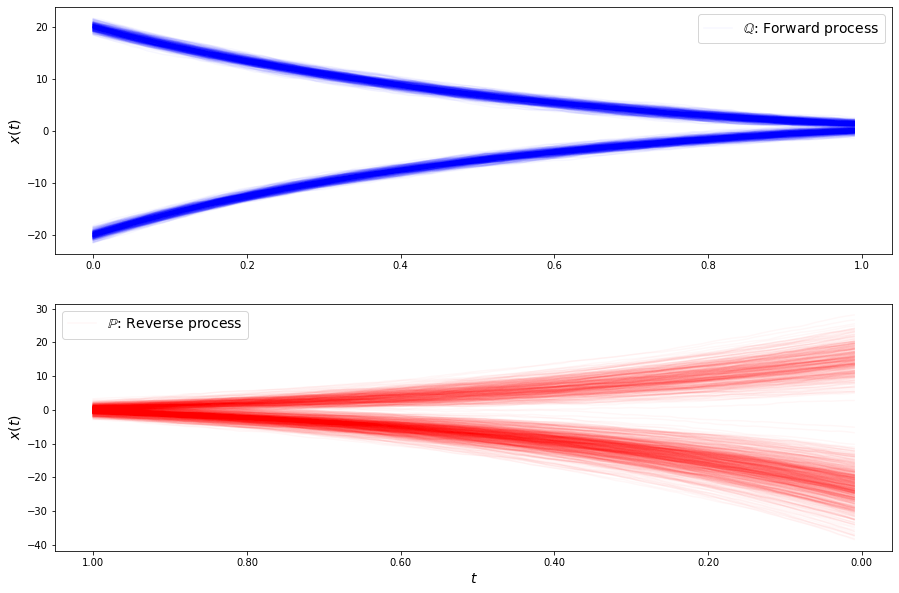

loss b 13.921122714373597
loss b 13.32375244533345
loss b 13.416095403274802
loss b 12.847463007744851
loss b 12.982945688778802
loss b 13.379401889550023
loss b 13.475742067011247
loss b 12.696218995367076
loss b 13.387672697348421
loss b 12.54098137495773
loss b 13.26664901947931
loss b 13.775364478004755
loss b 12.862004283896004
loss b 12.692567161269993
loss b 12.552285872073437
loss b 12.602602233393373
loss b 11.900399682242336
loss b 13.044840242501952
loss b 13.174105319614787
loss b 12.39974352423008
loss b 11.89353899401805
loss b 12.379665040537175
loss b 12.223375107422621
loss b 12.733251274313712
loss b 12.932132931689944
loss b 12.684921043447714
loss b 12.295536293961522
loss b 12.726136765841616
loss b 12.498046007711205
loss b 12.155159766656483
loss f 3.11851532781353
loss f 3.0539114218110908
loss f 3.0955315073875953
loss f 3.085257565901672
loss f 3.108992480835404
loss f 3.1246595909974433
loss f 3.1089693438306
loss f 3.0595910338781627
loss f 3.083057262742144

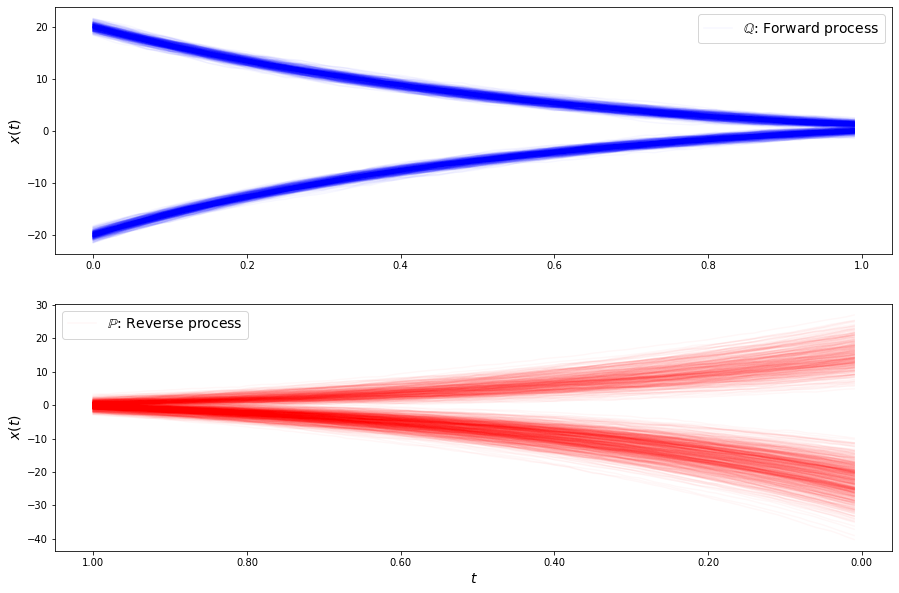

loss b 12.96569671785807
loss b 11.805507235671481
loss b 12.31174321985071
loss b 11.970267237522913
loss b 11.499450630591266
loss b 12.437223292263
loss b 12.16763092304849
loss b 12.754497644847337
loss b 11.899160501103491
loss b 12.823486500032212
loss b 12.415840385601884
loss b 11.63016510590772
loss b 11.510907671959643
loss b 12.060814487887757
loss b 12.380608759662039
loss b 11.475207785169623
loss b 11.878733737286804
loss b 11.301094559727815
loss b 12.042786706529917
loss b 12.091002185557622
loss b 11.138562433365928
loss b 11.425847961113949
loss b 11.383141448252415
loss b 11.188485560181348
loss b 11.459444982490423
loss b 11.8204596377695
loss b 12.208187011967807
loss b 11.629300554861798
loss b 11.404467411217842
loss b 11.257755478520613
loss f 2.994646509686923
loss f 3.0018471391885697
loss f 3.0351024976572303
loss f 3.022396072342832
loss f 3.0005450011658317
loss f 2.958140616390728
loss f 3.024844586931625
loss f 3.0043304217073574
loss f 2.964197949005684


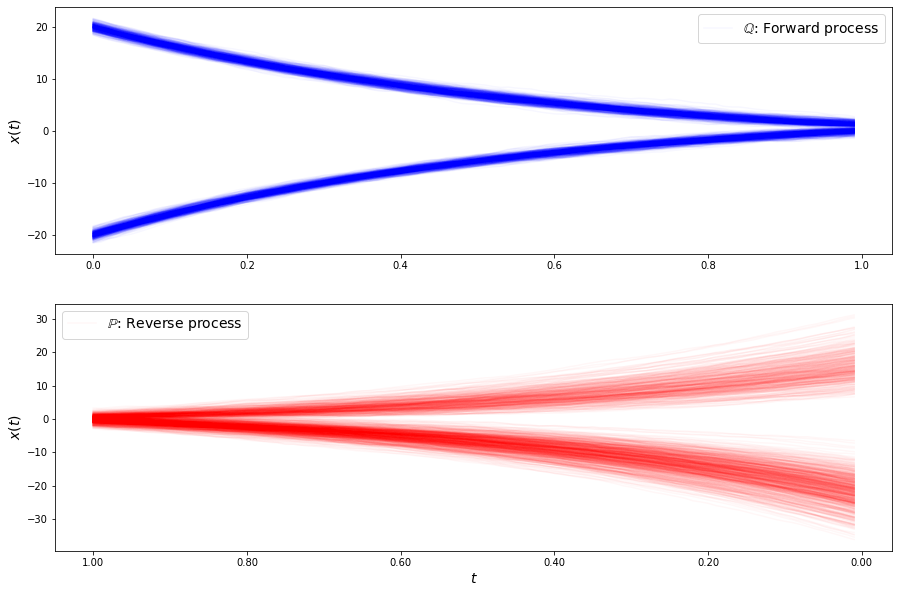

loss b 11.161929163889736
loss b 11.262009432180944
loss b 11.719736140136265
loss b 11.32096090585544
loss b 11.29143614359021
loss b 10.707663515908287
loss b 11.352215865411276
loss b 11.882065916314996
loss b 10.888764047984955
loss b 10.539025709227754
loss b 11.253808360213288
loss b 10.348343359502653
loss b 11.20702215463294
loss b 11.30703378932797
loss b 11.142037575470278
loss b 10.917425450715996
loss b 11.182798006459693
loss b 11.294152911565448
loss b 10.576814982717258
loss b 10.694207708709442
loss b 10.98884762810325
loss b 10.681774011679414
loss b 11.035587189614901
loss b 10.543600126346655
loss b 11.51592939736996
loss b 10.436932737396987
loss b 10.955634083571015
loss b 11.176522240876892
loss b 11.125694347188112
loss b 10.833401990579533
loss f 2.961536758120631
loss f 2.9770343549815625
loss f 2.9003463700596486
loss f 2.9723390556749307
loss f 2.9244814052414543
loss f 2.9756018223471177
loss f 2.856403488505905
loss f 2.94588416699224
loss f 2.9489358235235

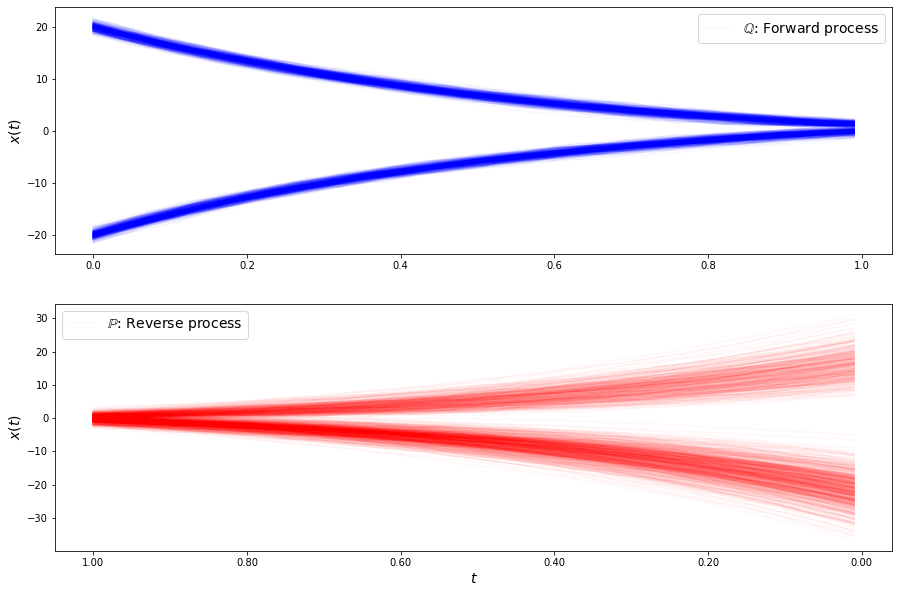

loss b 10.197763969445901
loss b 10.40396568629722
loss b 10.249652458696634
loss b 9.680745255082368
loss b 10.219915091033577
loss b 10.52640633947555
loss b 11.04106144689719
loss b 10.782633076562968
loss b 10.61478107422666
loss b 10.840812533537104
loss b 10.229214869337142
loss b 10.394956297933533
loss b 11.001338852651424
loss b 9.537708141524783
loss b 10.241531296406091
loss b 9.710116699354723
loss b 9.452762954646152
loss b 10.546342239101342
loss b 9.726892166958693
loss b 10.183019505316958
loss b 9.903761373852067
loss b 9.930465519355769
loss b 10.324832232209053
loss b 9.922314786539435
loss b 9.578755394697014
loss b 10.196205286968109
loss b 10.149556886594038
loss b 9.315956008077665
loss b 9.97412396290419
loss b 9.349341641428312
loss f 2.921843622841972
loss f 2.900597524275779
loss f 2.9206071563601004
loss f 2.9178862651976134
loss f 2.9364156707246347
loss f 2.928801643223139
loss f 2.9195233262573144
loss f 2.9369971914110526
loss f 2.909274941197988
loss f 

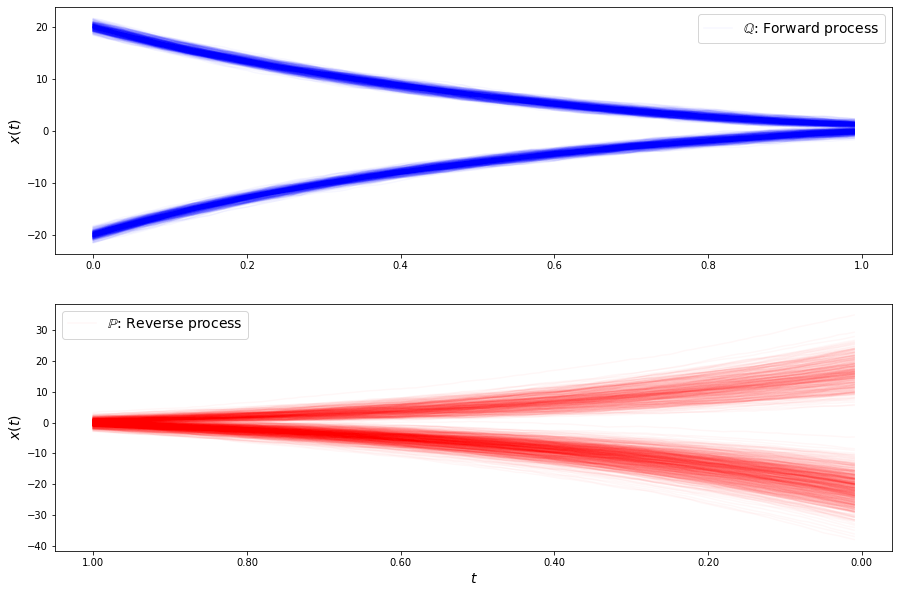

loss b 9.758487470943756
loss b 9.987862699813462
loss b 9.687542769753767
loss b 9.710543660013416
loss b 9.41776655796269
loss b 10.041301638470506
loss b 9.875737944983097
loss b 9.096588040057682
loss b 9.260192576423806
loss b 9.677041885316335
loss b 9.726386495701883
loss b 9.318512182103513
loss b 9.370551645396931
loss b 10.206686515587506
loss b 10.22461525283383
loss b 8.911051689536182
loss b 9.089389268554251
loss b 9.783023807377454
loss b 9.714283894534917
loss b 10.232132286897249
loss b 8.956794386345127
loss b 9.28260866224519
loss b 9.529512405424517
loss b 9.14844344566449
loss b 8.988386302823825
loss b 9.744796887919163
loss b 9.058508141003959
loss b 9.26045664360699
loss b 9.494745144476132
loss b 9.492234623847924
loss f 2.9418345186498667
loss f 2.937925244090681
loss f 2.9207650643365293
loss f 2.9187135053363633
loss f 2.899676809186654
loss f 2.9684113833457157
loss f 2.891058563207717
loss f 2.933074287416164
loss f 2.8768855843388623
loss f 2.867313446103

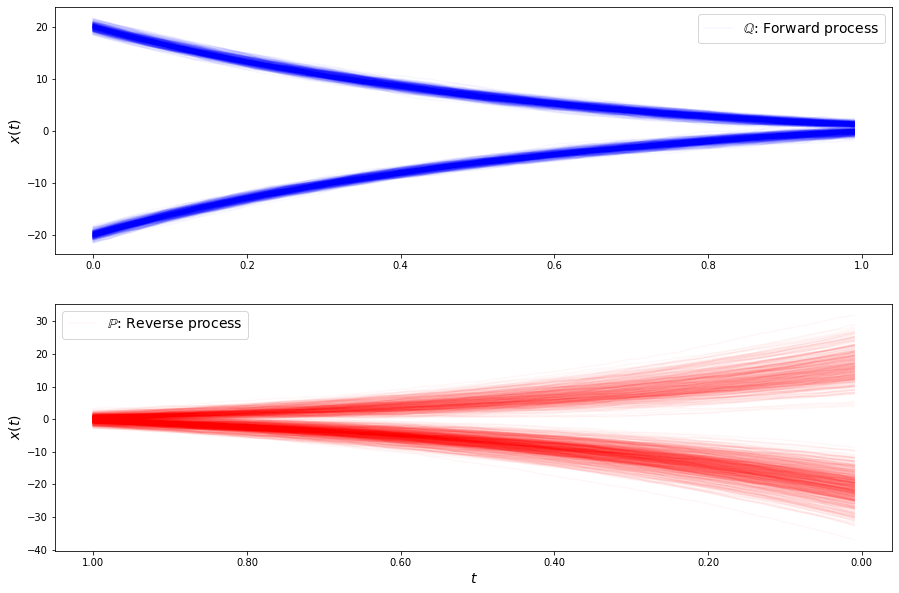

loss b 8.986169272082002
loss b 9.251349650667118
loss b 8.571396839499469
loss b 9.131376864690267
loss b 9.763537510973102
loss b 9.887899140919112
loss b 8.49737240256524
loss b 9.024734610138273
loss b 9.912483566607781
loss b 8.776144872336719
loss b 9.229630858861082
loss b 8.768304614656122
loss b 8.637818579547387
loss b 9.359244772909744
loss b 8.681651871843409
loss b 8.751064150496383
loss b 8.800829992269557
loss b 8.712233307748575
loss b 8.79639683707919
loss b 9.093222065552135
loss b 9.184999539953447
loss b 8.485310179692439
loss b 8.772082104203335
loss b 8.864858598508208
loss b 8.503370975495939
loss b 9.013300038874913
loss b 8.751487000733462
loss b 8.640865348187223
loss b 9.328209162084272
loss b 9.483783119342803
loss f 2.9497714608023053
loss f 2.956062850295557
loss f 2.8911153013903164
loss f 2.9123078653848533
loss f 2.9459015991045803
loss f 2.8976112651781367
loss f 2.9301800291560287
loss f 2.890440121671111
loss f 2.8855285613610415
loss f 2.91314691688

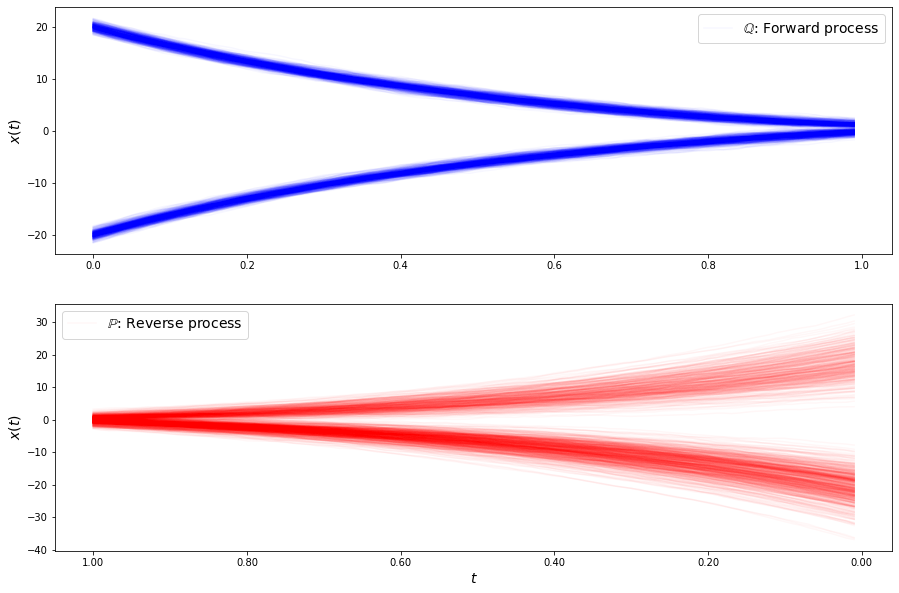

loss b 9.1577045845251
loss b 8.845936159274144
loss b 8.631880846045613
loss b 8.448901669295472
loss b 8.591482379779196
loss b 8.445616130085517
loss b 8.356668610138483
loss b 9.111434188483981
loss b 8.403159161245696
loss b 8.903842932554857
loss b 8.276969181709706
loss b 8.664061764738154
loss b 8.424524341478929
loss b 8.742744921267727
loss b 8.533375424103747
loss b 8.115990133586173
loss b 8.192810108723691
loss b 8.20418334861492
loss b 8.753844861183385
loss b 8.16828357703109
loss b 8.585290010279437
loss b 8.332686921212117
loss b 9.697090006488201
loss b 9.029147669495446
loss b 8.966861853874844
loss b 8.511300096298395
loss b 8.445517697525862
loss b 8.779340130459614
loss b 8.049895520390537
loss b 8.490820438836556
loss f 2.944524392963735
loss f 2.9522985385458056
loss f 2.9565635454930184
loss f 2.956129509093313
loss f 2.9046437821040256
loss f 2.9108993928098115
loss f 2.952125613511619
loss f 2.9512970569911245
loss f 2.9226398063025067
loss f 2.95861453595353

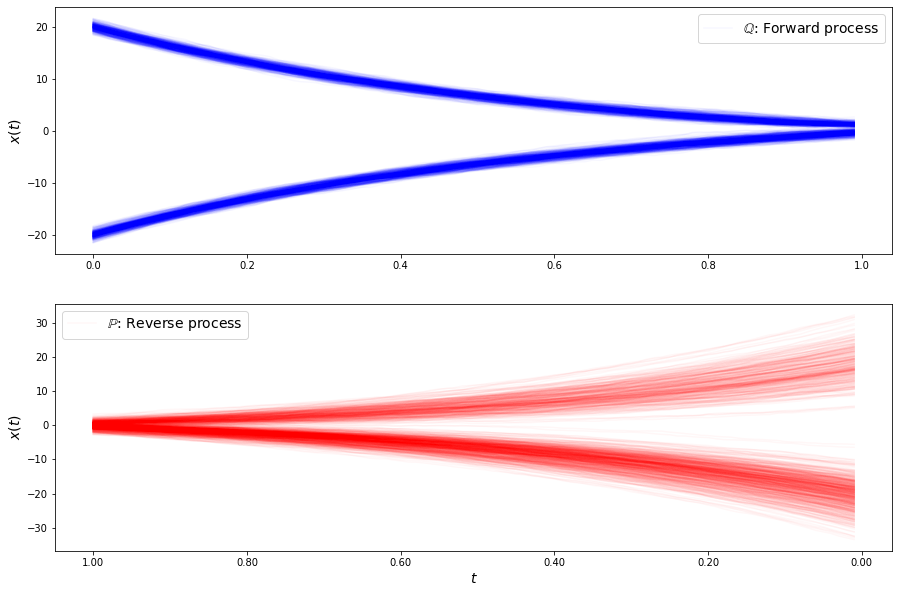

loss b 8.223653761321476
loss b 8.064978670007196
loss b 8.303313436668606
loss b 8.557936771105272
loss b 7.506816541607957
loss b 8.192957626635966
loss b 8.289256958275018
loss b 7.856756473189933
loss b 7.595612975379502
loss b 7.9690461595553055
loss b 7.927086990066844
loss b 8.177439384004487
loss b 8.55969094084405
loss b 9.131995723630622
loss b 8.310898021055996
loss b 8.115330215450332
loss b 8.044284902277353
loss b 8.311006611205448
loss b 7.964292550715358
loss b 8.463460080740317
loss b 8.14987207372838
loss b 7.763139464215753
loss b 8.056037942585338
loss b 7.8443375069497545
loss b 8.259277999546498
loss b 7.862760822748881
loss b 7.350504788210475
loss b 7.743412716745139
loss b 8.187780953723818
loss b 8.960348850538734
loss f 2.9637436759947753
loss f 2.954653226795908
loss f 2.967759176742693
loss f 2.9502733216129386
loss f 2.9587278275895317
loss f 2.9605024476456268
loss f 2.9625989204678755
loss f 2.9646327549561216
loss f 2.9552167445494057
loss f 2.934757747

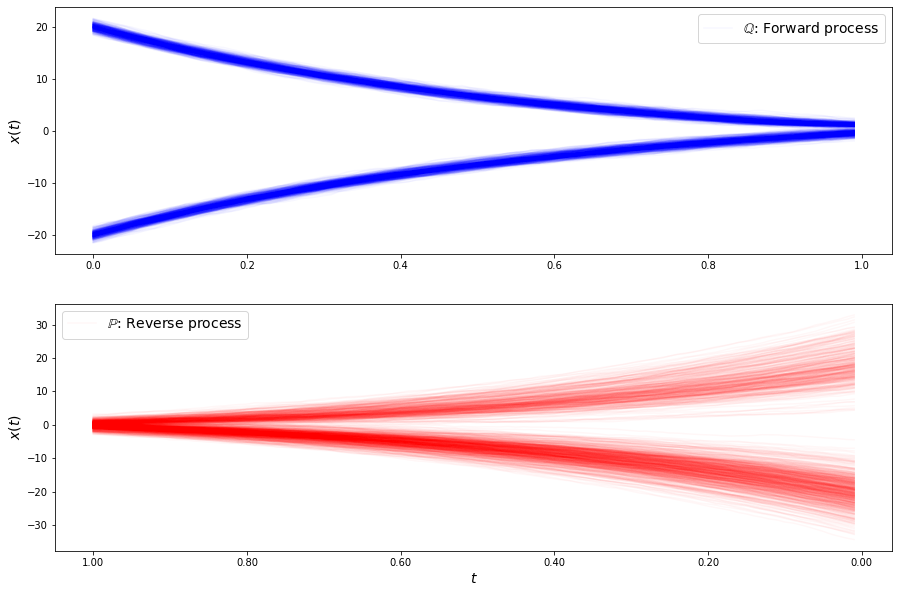

loss b 7.788435761981338
loss b 8.318086277528884
loss b 7.482624478486835
loss b 7.601607466993317
loss b 8.106204042081686
loss b 7.885215656566577
loss b 7.808854083313241
loss b 7.559507401423505
loss b 7.952427881109615
loss b 7.162649466503574
loss b 8.022925745035119
loss b 8.409180016932204
loss b 7.944728447435055
loss b 8.21400739677514
loss b 7.974482413429548
loss b 7.744748269690418
loss b 8.392845288777503
loss b 8.128176285247463
loss b 7.677892893725459
loss b 8.037516562132314
loss b 7.597935202671858
loss b 8.146255454682795
loss b 7.818941569216145
loss b 8.632533820988131
loss b 7.9049145599119255
loss b 8.583660875755708
loss b 7.923691038986838
loss b 7.7728076906337895
loss b 7.86734760815116
loss b 7.92898330464529
loss f 2.9074910094856357
loss f 2.9415061556777156
loss f 2.9680315591312607
loss f 2.9077139944120862
loss f 2.9369712108508246
loss f 2.9444907131414295
loss f 2.9195733592672237
loss f 2.94559340231891
loss f 2.9806766866445535
loss f 2.8863991582

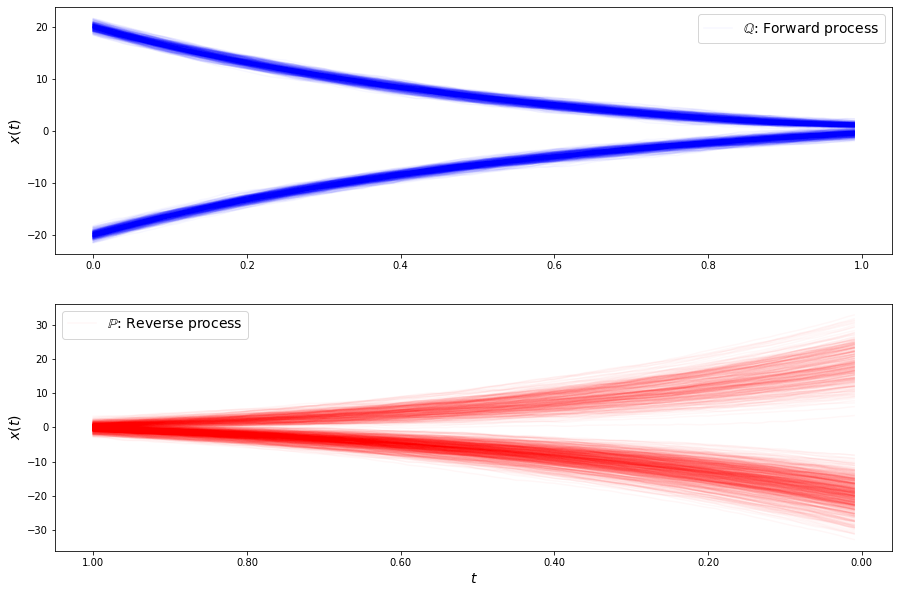

loss b 7.8303050650262165
loss b 7.848882985553501
loss b 7.700002225203539
loss b 7.878618122974425
loss b 7.625004591560005
loss b 7.8600461857141175
loss b 7.716683846506234
loss b 7.425488370743698
loss b 7.722913449422615
loss b 7.569075053757079
loss b 8.116857315175606
loss b 8.046149724750673
loss b 7.569372092971163
loss b 7.586834143283558
loss b 8.215923615628736
loss b 7.7044100715616475
loss b 7.641150597441895
loss b 7.836901313622964
loss b 7.589404131455571
loss b 7.458276202935438
loss b 8.072784783526
loss b 7.867015570392493
loss b 7.457959728193654
loss b 7.4232793626520275
loss b 7.703321496092821
loss b 7.894350470684608
loss b 7.937357708429489
loss b 7.928431960058736
loss b 7.662913547682962
loss b 7.952058637364659
loss f 2.9441002747626888
loss f 2.9595914170688897
loss f 2.9543027585787676
loss f 2.9594894388016075
loss f 2.967256825222467
loss f 2.9577118270290628
loss f 2.935259943440616
loss f 2.952823953825102
loss f 2.8902500576079624
loss f 2.931662580

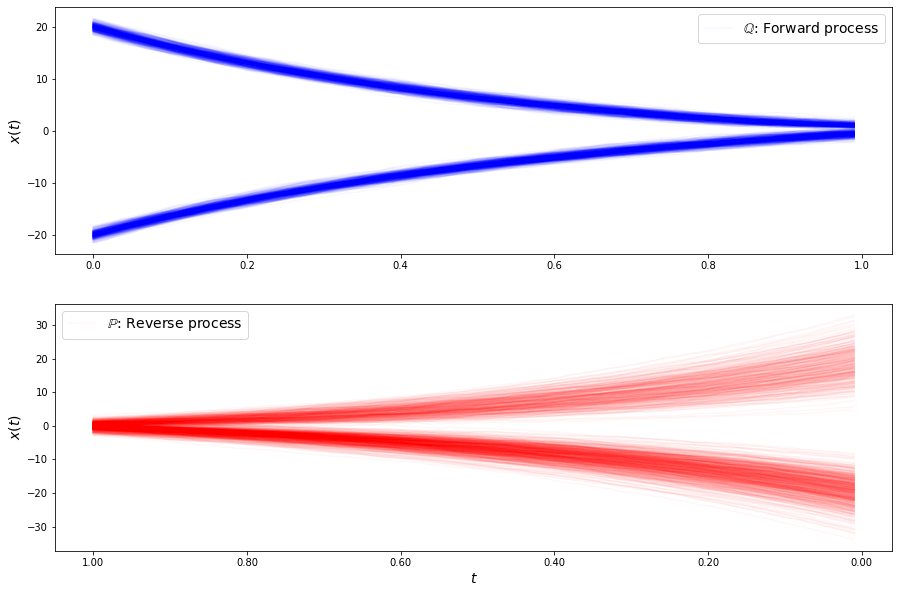

loss b 7.62483951570283
loss b 8.11878430158086
loss b 7.62907457984036
loss b 6.799968079769777
loss b 7.711539512527302
loss b 7.7731084967835695
loss b 7.624981688784693
loss b 7.97086359117574
loss b 7.972669470802971
loss b 7.780193513835896
loss b 7.6359704462832125
loss b 8.112973041670452
loss b 7.595799291195215
loss b 7.5069264411895285
loss b 7.365802086854064
loss b 8.173789987251487
loss b 7.987133306999634
loss b 7.667030330237769
loss b 8.182561661786034
loss b 7.825025161324648
loss b 7.568041604623839
loss b 7.721081091369732
loss b 7.670022777723755
loss b 7.508706291477377
loss b 8.13105765583432
loss b 8.099949995494972
loss b 7.564604542461619
loss b 7.608338777042801
loss b 8.026986603045403
loss b 7.840327487759175
loss f 2.938762137586562
loss f 2.945318600250448
loss f 2.971815491316471
loss f 2.960792849376964
loss f 2.9280216624709765
loss f 2.895423429732329
loss f 2.9038148419559446
loss f 2.9389852917448187
loss f 2.897238699024911
loss f 2.886678557930143

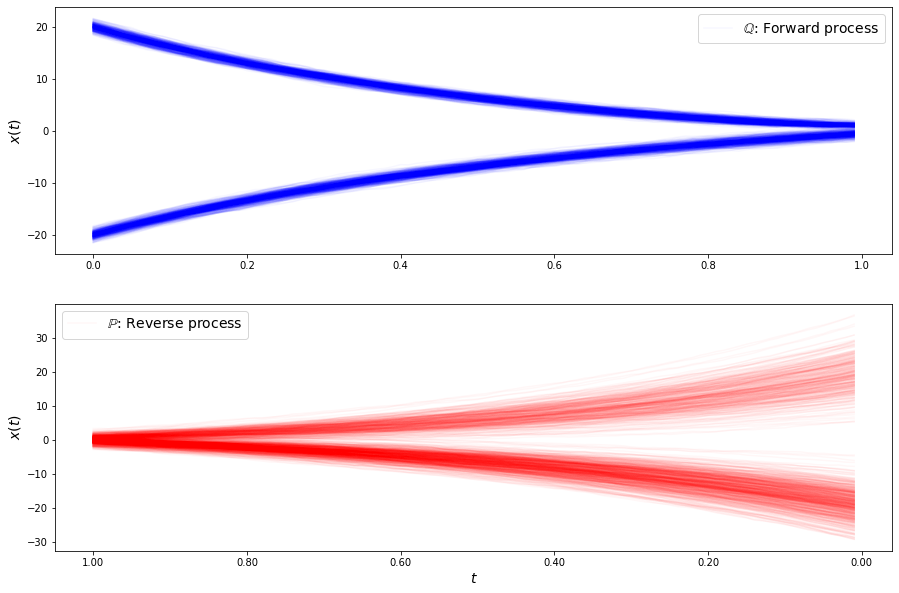

loss b 7.877255616707164
loss b 7.804716822954177
loss b 7.416249211676857
loss b 7.909602524966802
loss b 7.71895068409989
loss b 7.878775746838995
loss b 7.807898790285141
loss b 6.997722518162888
loss b 7.707937827889187
loss b 7.404736940580476
loss b 7.9646997122768255
loss b 7.3456044037908255
loss b 7.674569516715864
loss b 7.631114083698903
loss b 6.808103904906305
loss b 7.72856689174124
loss b 7.989196137313035
loss b 7.694894465846494
loss b 7.89307423303983
loss b 7.379774331878512
loss b 7.780804328806329
loss b 7.764063341593403
loss b 8.3436210273031
loss b 7.9058662701908045
loss b 7.553138372026432
loss b 7.382360294679474
loss b 7.2023500483715654
loss f 2.9291957385950442
loss f 2.8913436185657506
loss f 2.948711628126346
loss f 2.9140109226148097
loss f 2.9445556517167875
loss f 2.8999313995609977
loss f 2.915844730730033
loss f 2.9158408182251088
loss f 2.920661257827741
loss f 2.885353686393516
loss f 2.8930245721523
loss f 2.845588679833447
loss f 2.8951261725593

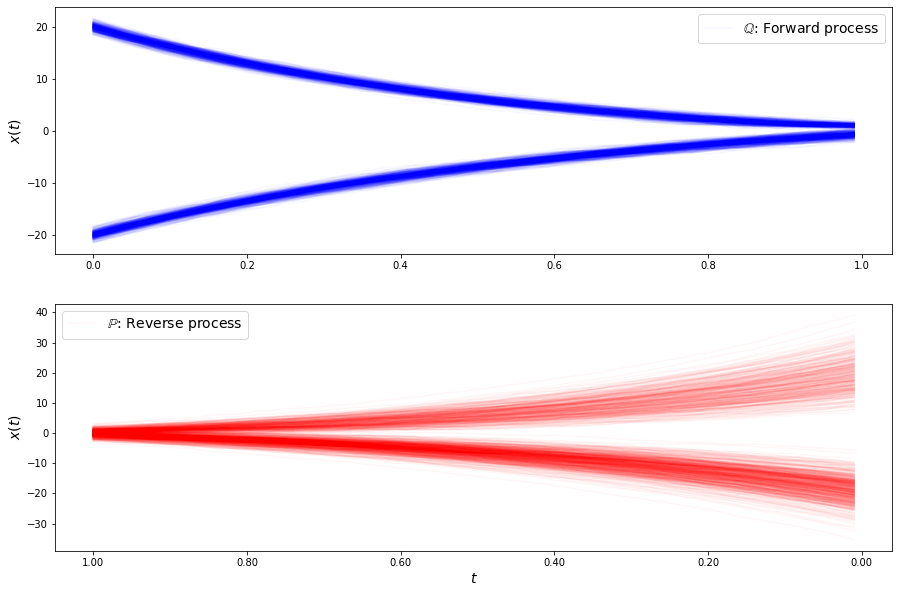

loss b 8.429310695567803
loss b 8.286310311041353
loss b 7.997419714457638
loss b 8.356356362935424
loss b 8.004522079438587
loss b 7.85101575112391
loss b 7.580483542160708
loss b 7.538850257470815
loss b 7.656827010661988
loss b 7.734575325866835
loss b 7.540690424035273
loss b 7.636546045351203
loss b 7.82788306727648
loss b 7.7598507472864116
loss b 7.023694731217208
loss b 7.59311300044578
loss b 7.976024387639748
loss b 7.925195420747599
loss b 8.174187372094211
loss b 7.833719000300493
loss b 7.430484625587305
loss b 7.916702717062856
loss b 7.725784161617229
loss b 8.032185183440056
loss b 8.362635268427445
loss b 7.605961423043872
loss b 7.757167584416632
loss b 8.01471902391706
loss b 7.747013599272821
loss b 7.767303229503468
loss f 2.9095038599362226
loss f 2.8890245421294294
loss f 2.9051314536960406
loss f 2.8935594296191898
loss f 2.9383090476449696
loss f 2.89697477438177
loss f 2.8684889586949516
loss f 2.8908517889325815
loss f 2.865240404656206
loss f 2.9311870947643

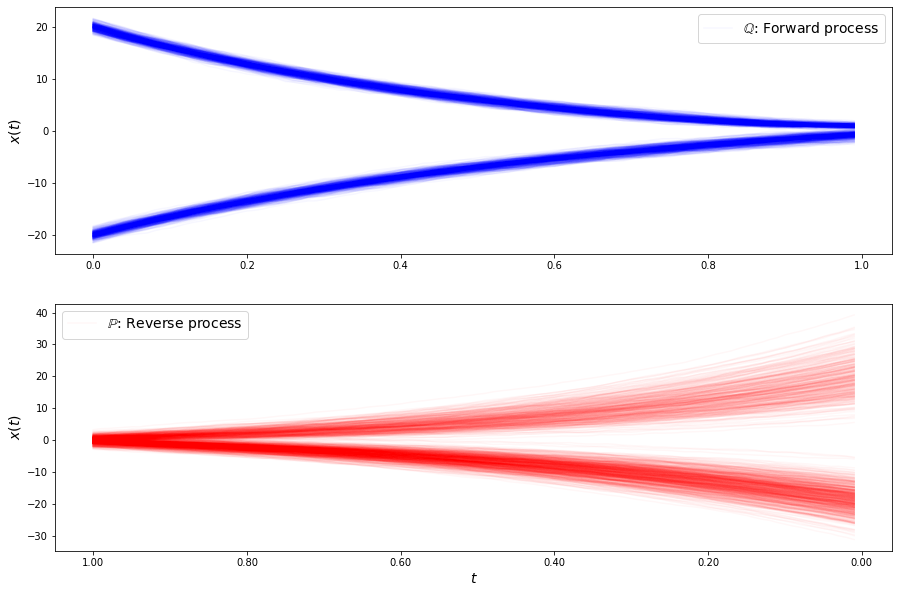

loss b 8.086973845995535
loss b 7.855245725887676
loss b 7.511376689290602
loss b 7.625973067845942
loss b 7.760480245744179
loss b 8.288630843864238
loss b 7.13815726879672
loss b 7.590819985759628
loss b 7.734768283171488
loss b 8.03266925244151
loss b 7.680866015097538
loss b 7.965577175450043
loss b 7.589419356223766
loss b 7.583077148496471
loss b 8.100832438658946
loss b 8.25092822934795
loss b 7.559751126840966
loss b 7.8566584301030025
loss b 7.833177726028368
loss b 8.40524705211696
loss b 7.826713550072734
loss b 8.159781248556246
loss b 7.785649925985693
loss b 7.783767266355712
loss b 7.802165370343675
loss b 8.13946362985135
loss b 8.1668203761829
loss b 7.758757074469234
loss b 7.688700310211921
loss b 7.962008218561701
loss f 2.885355810906924
loss f 2.895116307914043
loss f 2.874806149165927
loss f 2.84360516761068
loss f 2.919762539645866
loss f 2.870442821795974
loss f 2.888907705057192
loss f 2.8933444410859672
loss f 2.8875346867892615
loss f 2.8447426800877387
loss

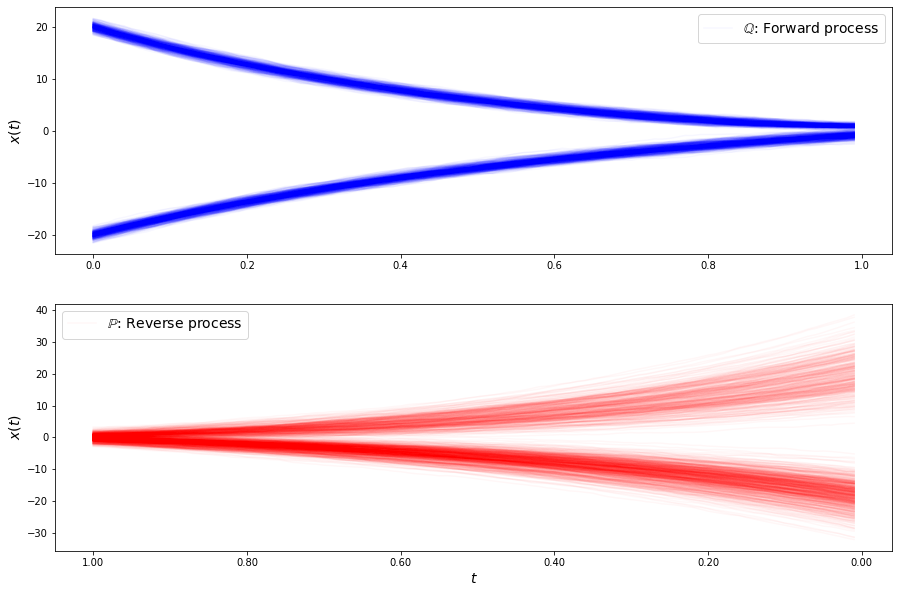

loss b 8.26210418471906
loss b 8.399711745079726
loss b 8.655513430718024
loss b 7.601409751150771
loss b 8.083049192255787
loss b 7.864098298999912
loss b 8.272626159569855
loss b 7.300302380207723
loss b 8.065336807893459
loss b 8.700659601033212
loss b 8.874001809776287
loss b 7.6676179462985115
loss b 8.266169769478669
loss b 7.608485038736464
loss b 8.480536457227092
loss b 7.95533194399898
loss b 8.004364798790904
loss b 7.790080875123989
loss b 8.232963471382321
loss b 8.037702508443779
loss b 8.376220984298763
loss b 8.344965482403103
loss b 8.376312909773098
loss b 8.363760511811662
loss b 7.935899733999459
loss b 8.797361310650512
loss b 8.459298474823916
loss b 8.06971579795275
loss b 8.375209896443632
loss b 7.746164160906589
loss f 2.8673376222486233
loss f 2.871892581396012
loss f 2.8862448014976536
loss f 2.867471081628027
loss f 2.896354856079806
loss f 2.8966435787810894
loss f 2.8908720729374306
loss f 2.9030691120631533
loss f 2.8972477208011256
loss f 2.930698835872

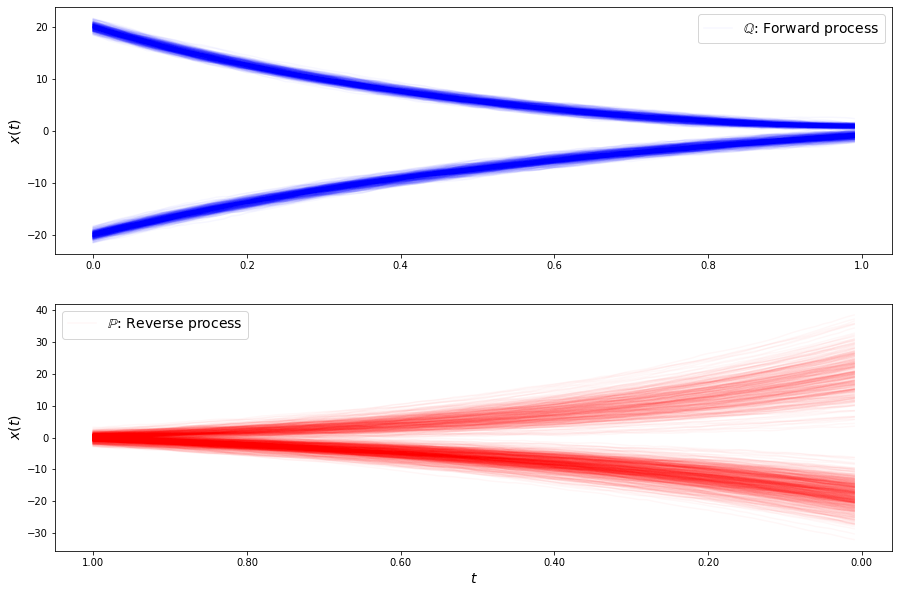

loss b 8.492241650176233
loss b 8.287961968925307
loss b 7.63204606246784
loss b 8.86798915404043
loss b 8.773745193245349
loss b 8.179402400985845
loss b 8.912994173384345
loss b 8.573719112072085
loss b 8.173278484631274
loss b 8.258562740524956
loss b 8.261271083357197
loss b 8.231383100274924
loss b 8.130958701375645
loss b 8.218148402733789
loss b 8.14026092708113
loss b 7.994320440504281
loss b 9.112198472454098
loss b 8.563491248448532
loss b 8.36734557378048
loss b 7.80055987117163
loss b 8.350615469317717
loss b 7.7795031107470765
loss b 8.758332188332272
loss b 9.075527010948917
loss b 8.584350694285803
loss b 8.72660847025962
loss b 8.288262900874997
loss b 8.574629273839445
loss b 8.271339569701867
loss b 8.33449381685997
loss f 2.9355113706630704
loss f 2.934575682690306
loss f 2.9364596417808775
loss f 2.949130923653025
loss f 2.9261477857932006
loss f 2.9560338078234225
loss f 2.9549227159444746
loss f 2.9389463405707827
loss f 2.9483993175903644
loss f 3.005503679932812

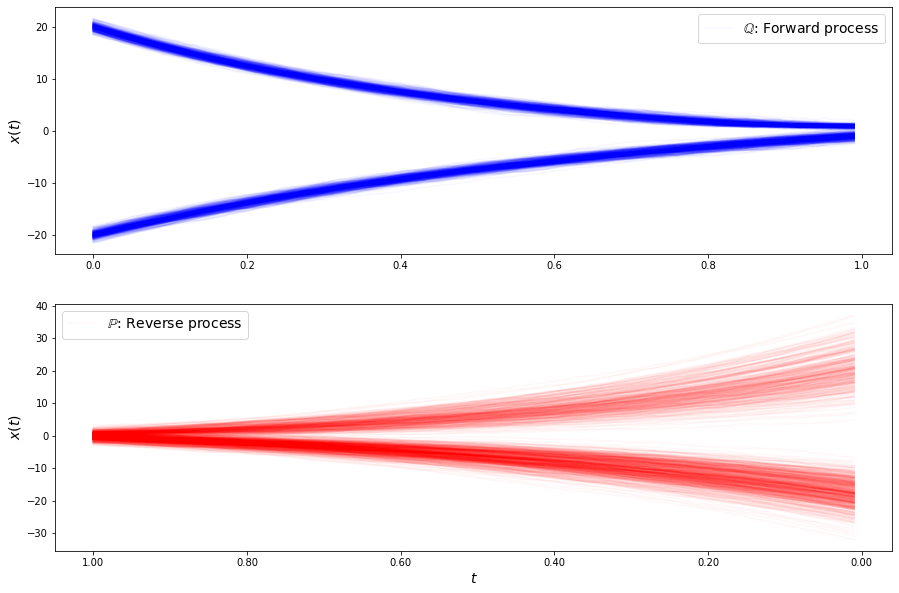

loss b 8.507413526657254
loss b 8.541251202573479
loss b 8.776448051991812
loss b 8.381717666423596
loss b 8.821758844477749
loss b 9.215133884387704
loss b 8.739367499651989
loss b 8.847919599960926
loss b 8.515618855270692
loss b 8.456422476678057
loss b 8.576349355720678
loss b 8.38250601682788
loss b 8.656378140573063
loss b 8.773049657513372
loss b 8.610512610808014
loss b 8.405249475562837
loss b 8.483150661738911
loss b 8.73993990093471
loss b 9.074484676189593
loss b 8.844662363468908
loss b 8.850998896813044
loss b 8.997992010488097
loss b 8.665575626723784
loss b 8.992938249460325
loss b 8.386614662454578
loss b 8.51290155567127
loss b 8.793317682054989
loss b 9.37323039590317
loss b 8.486529195930302
loss b 8.545952457169726
loss f 3.0155633658885335
loss f 2.9403814400914965
loss f 3.0106968482013596
loss f 3.0211548385712206
loss f 2.992730092642464
loss f 3.0277165757124624
loss f 3.0490079952322846
loss f 3.012929539449517
loss f 3.0187827527376254
loss f 2.9972484525698

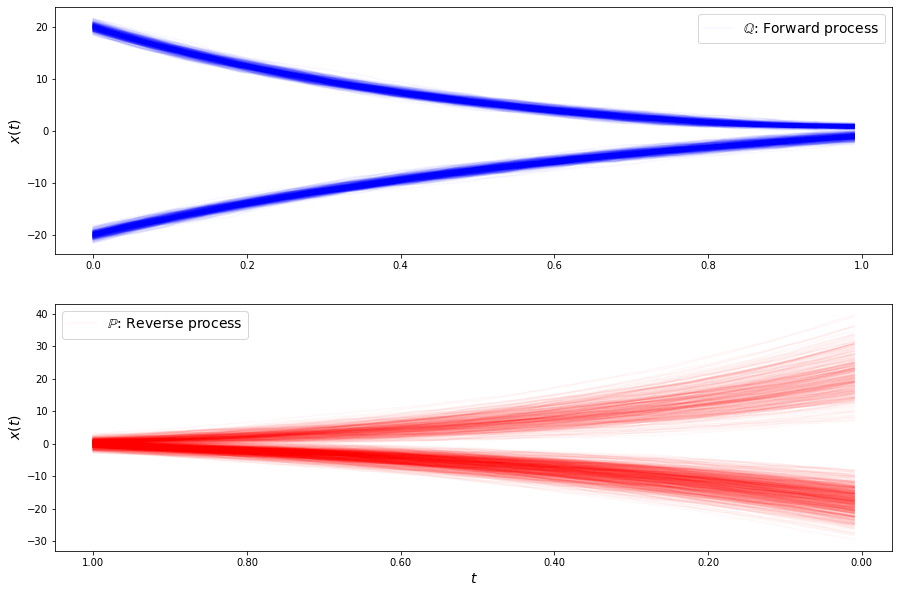

loss b 8.709067852385367
loss b 8.86855410821073
loss b 8.98907502692915
loss b 8.890670998618077
loss b 9.825705141100315
loss b 8.832250165801662
loss b 8.610869066633748
loss b 9.042672065076443
loss b 9.335364225213553
loss b 9.153830169016153
loss b 9.21669262355164
loss b 9.331075612642826
loss b 9.224177765408125
loss b 8.59172933128878
loss b 8.838887817211212
loss b 9.670954074063403
loss b 8.867536982674906
loss b 9.144407454999156
loss b 9.37887179250258
loss b 9.447012676757167
loss b 8.685188844948536
loss b 9.079222120330822
loss b 9.465643485197287
loss b 9.31859664127374
loss b 9.014872969199592
loss b 9.183194307470451
loss b 8.708548200657766
loss b 8.85162455013126
loss b 8.884006455228697
loss b 8.779460648149291
loss f 2.9861508659219047
loss f 3.0149287521119676
loss f 3.064176395976022
loss f 3.0718177117215584
loss f 3.083863044319
loss f 3.1368313480488514
loss f 3.081190667491026
loss f 3.1027986963400545
loss f 3.028103667590455
loss f 3.0596065625028603
loss

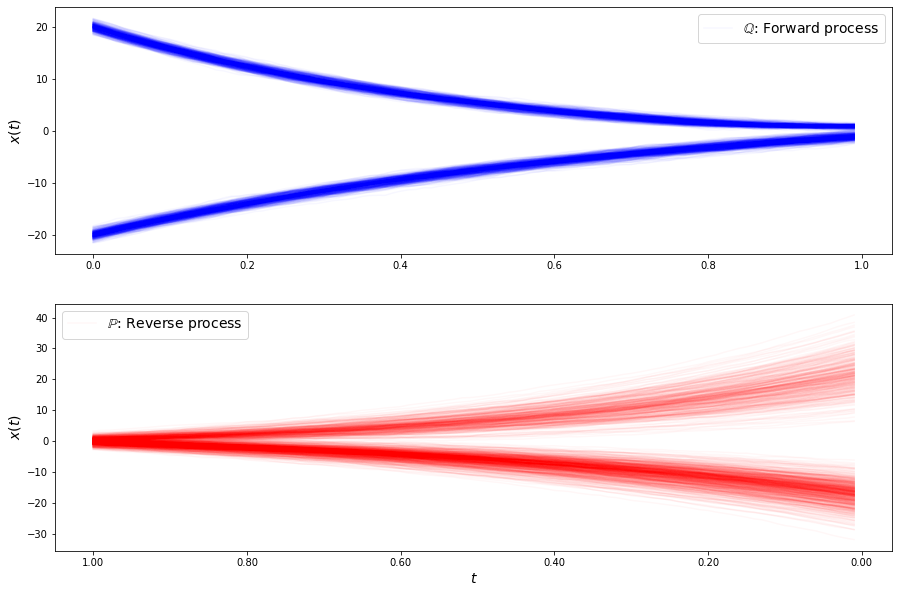

loss b 9.345624553844418
loss b 9.492658866973274
loss b 9.425395913300195
loss b 9.063371917685007
loss b 9.710219317407448
loss b 8.567427989461791
loss b 8.980825689788256
loss b 9.355324145383632
loss b 9.551687600167881
loss b 9.261283060296641
loss b 9.313188877209834
loss b 9.412225368086256
loss b 9.222483878271047
loss b 9.669291470591295
loss b 8.942659307464272
loss b 10.055199077018317
loss b 9.30927128024112
loss b 9.12495528752065
loss b 9.636465620102966
loss b 9.682602629061757
loss b 10.11241167776836
loss b 9.630056049804914
loss b 9.668481131005716
loss b 9.064771516065877
loss b 9.23557707642185
loss b 8.973981296112933
loss b 9.502316410157663
loss b 8.965582415364759
loss b 9.215508969802704
loss b 9.090511265164507
loss f 3.0815845169320637
loss f 3.133007023448704
loss f 3.147177519220371
loss f 3.111076764747567
loss f 3.147169868065906
loss f 3.1015463512369146
loss f 3.153064557075676
loss f 3.1094641445432023
loss f 3.120208777136702
loss f 3.140843252492155

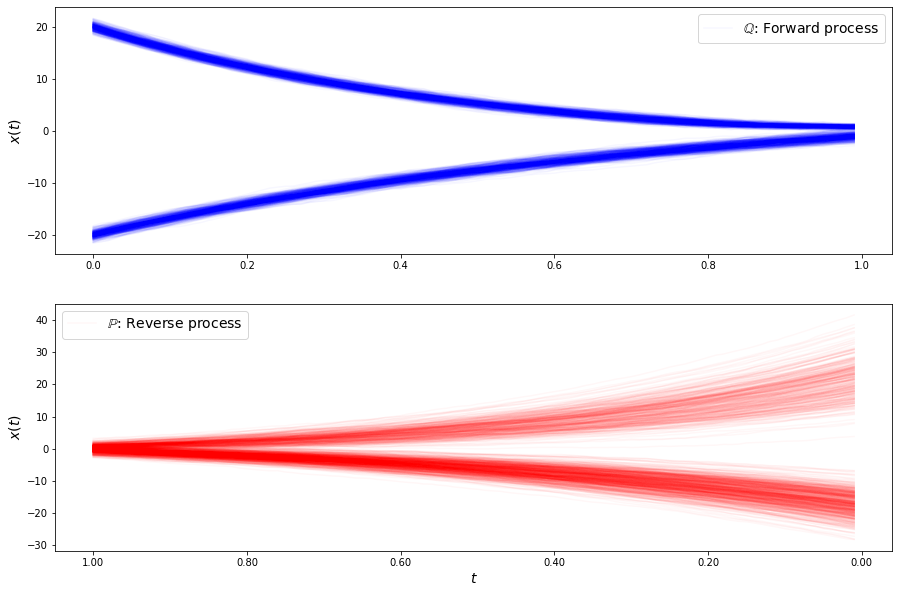

loss b 9.792298445736709
loss b 9.785247115533988
loss b 10.426758075822322
loss b 9.118057860753702
loss b 9.649168525548784
loss b 9.754069410463288
loss b 10.21039953821451
loss b 9.477048811310935
loss b 9.626413872275396
loss b 8.957610740132433
loss b 9.801164325306779
loss b 9.698542439003095
loss b 9.273123706917888
loss b 9.272487903519153
loss b 9.647357345170386
loss b 10.35940699143805
loss b 9.727734777751005
loss b 9.642598520346533
loss b 9.786204842846228
loss b 9.862938876408858
loss b 10.300575563590275
loss b 9.813310316917665
loss b 9.986952087747516
loss b 9.439837940203253
loss b 9.750212610654605
loss b 9.680154742459452
loss b 10.232449466179542
loss b 9.893588196592285
loss b 10.193961283425804
loss b 10.249333323529289
loss f 3.173316240554869
loss f 3.2047761111739796
loss f 3.1483690116832266
loss f 3.155820303651572
loss f 3.208263875316438
loss f 3.1668761620701207
loss f 3.187013317669565
loss f 3.167976164904553
loss f 3.136629754645728
loss f 3.17766243

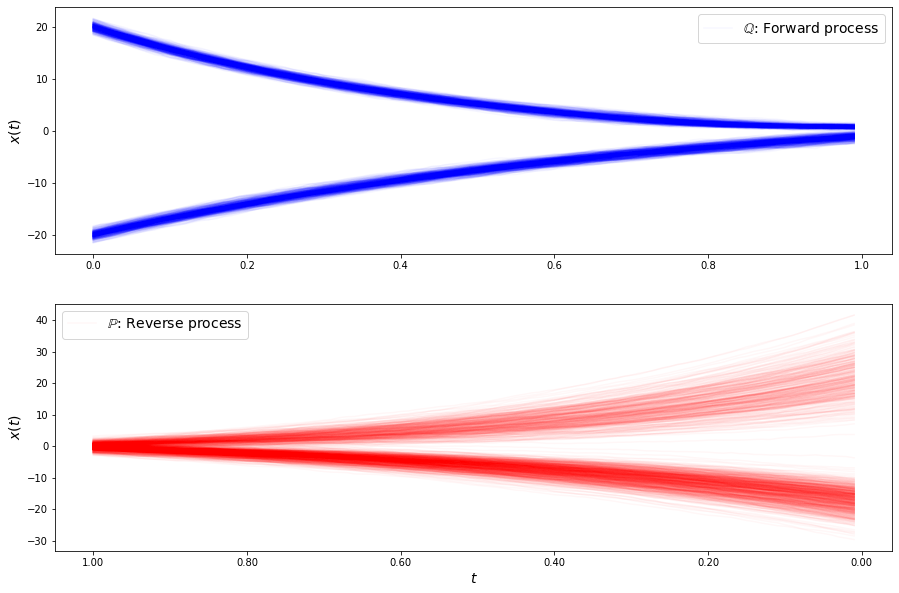

loss b 9.786377302473962
loss b 9.187937471892033
loss b 9.56083453051262
loss b 10.396757985734912
loss b 10.232745988112343
loss b 9.974142581253636
loss b 10.229791373559397
loss b 10.201416853137747
loss b 10.105889995156442
loss b 9.955475761682164
loss b 9.968330409418341
loss b 10.03850813214219
loss b 10.53400151705253
loss b 10.044284995562856
loss b 10.88259718904901
loss b 9.751119769585548
loss b 9.735357465577046
loss b 10.002321953047067
loss b 10.1634799248082
loss b 10.27701891527407
loss b 10.205030870726274
loss b 10.120729538865632
loss b 10.016696104683955
loss b 10.147782441105916
loss b 10.655925998359914
loss b 10.15948163519353
loss b 10.71947996693272
loss b 10.148690479361596
loss b 10.210042058877752
loss b 10.044872919499818
loss f 3.2037478923316685
loss f 3.1911372925808767
loss f 3.1384124750766316
loss f 3.1676992459911903
loss f 3.1532162004308657
loss f 3.2306977078568972
loss f 3.1932193834557787
loss f 3.2213036642327957
loss f 3.219400787792628
loss

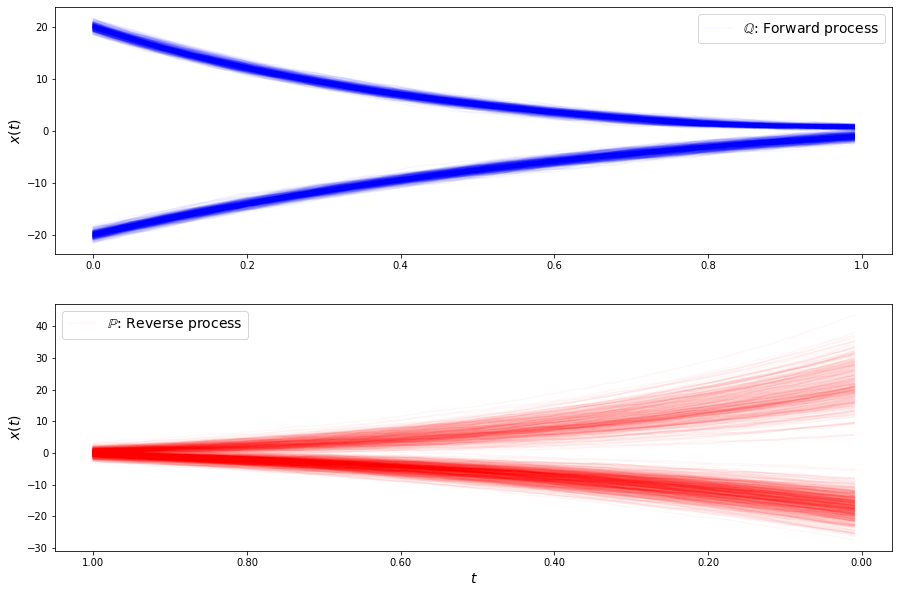

loss b 10.008627544051585
loss b 10.062251906696783
loss b 10.594082275739222
loss b 9.292383086170421
loss b 10.000955100911366
loss b 11.345412962681229
loss b 10.364139428112763
loss b 10.191052014037986
loss b 10.367782967688376
loss b 10.191109332083911
loss b 10.66724906817861
loss b 10.544715801689696
loss b 11.068357831017098
loss b 10.226235725098602
loss b 10.6739205070167
loss b 10.981730251252905
loss b 10.459760501798419
loss b 10.703286476884603
loss b 11.139114888658195
loss b 10.742383810263659
loss b 11.436177270954117
loss b 10.390679344743816
loss b 10.866445656154804
loss b 9.962992221687118
loss b 10.430092583123526
loss b 10.70585931219517
loss b 11.028165960138718
loss b 11.287197099817462
loss b 11.300255532146814
loss b 10.445884540230857
loss f 3.234949573881013
loss f 3.218382984118902
loss f 3.23972582848995
loss f 3.246360323392656
loss f 3.22990750783406
loss f 3.2776828759518444
loss f 3.271409175241752
loss f 3.1921182029219857
loss f 3.2562461021015454


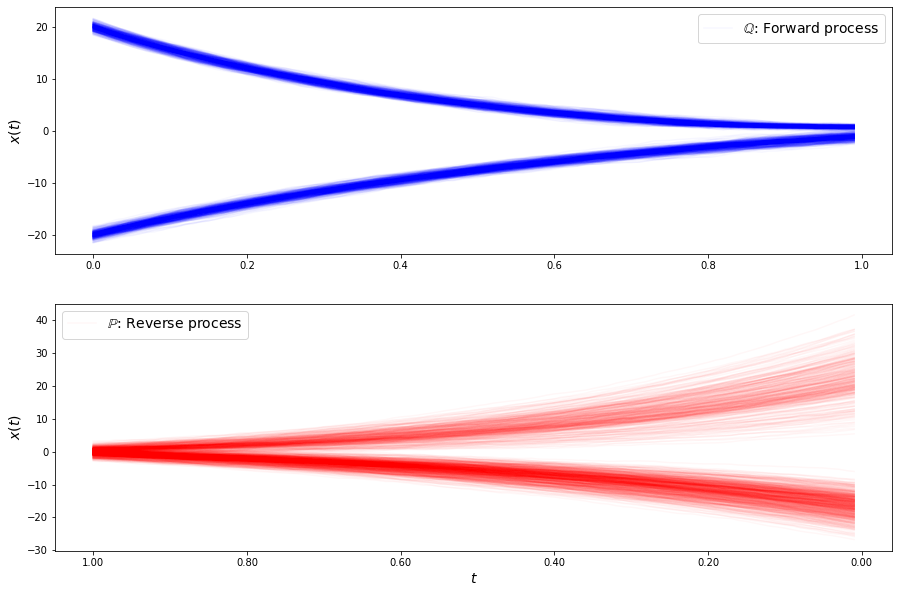

loss b 11.720386832427083
loss b 10.83897557085777
loss b 10.604215814874301
loss b 10.706308236248162
loss b 11.557510986672293
loss b 10.608568976639804
loss b 11.053976896708347
loss b 10.819630393912911
loss b 10.855071645040574
loss b 11.000610851225796
loss b 10.78502046626537
loss b 10.536124662879782
loss b 10.866921369114001
loss b 10.722363155401151
loss b 10.576476767062477
loss b 11.088983535543267
loss b 10.788506248624186
loss b 11.279714415096953
loss b 11.292634757185175
loss b 11.244850309052763
loss b 10.642776281986073
loss b 10.728053464541444
loss b 11.33069763994965
loss b 11.225453343801682
loss b 10.665656345303189
loss b 10.63987407195509
loss b 10.767759555520856
loss b 11.094636279184842
loss b 10.841563512535982
loss b 11.249081227066261
loss f 3.334481150730138
loss f 3.2609968411914925
loss f 3.316470724845338
loss f 3.271570291015354
loss f 3.340124571221396
loss f 3.299686066690569
loss f 3.3246892134264203
loss f 3.2948159757831323
loss f 3.274651679192

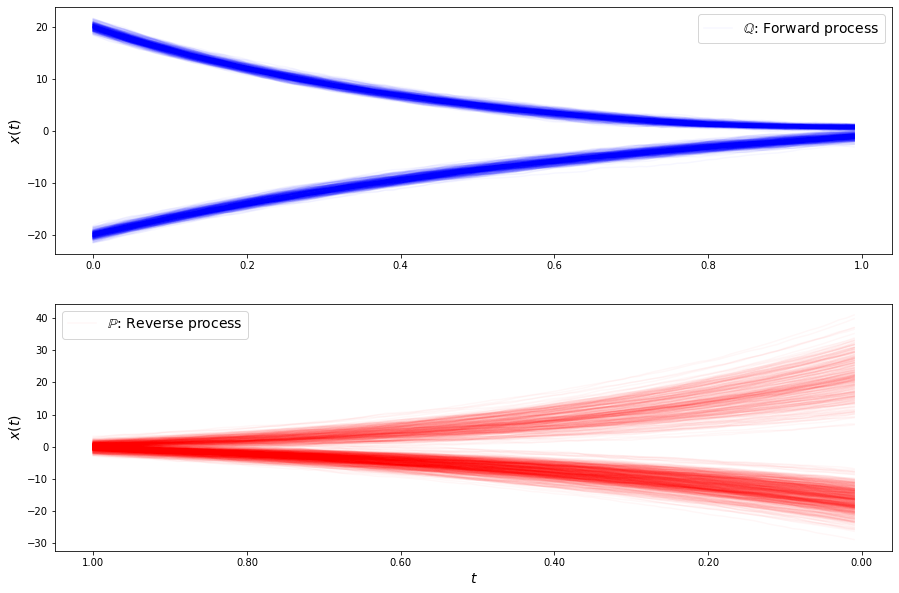

loss b 10.361306784844285
loss b 11.086843774306125
loss b 10.624117244820383
loss b 11.455223083747041
loss b 11.083219185337411
loss b 11.351039305522772
loss b 11.332422187947072
loss b 10.978091364881681
loss b 11.300371512822421
loss b 11.338043850092658
loss b 11.519102795700785
loss b 11.372834524983668
loss b 11.290158069689392
loss b 12.266335987243188
loss b 11.71166185136134
loss b 10.696968144856825
loss b 11.914560188021326
loss b 11.040103563241642
loss b 11.880003664375048
loss b 11.519687181114833
loss b 12.027128521881671
loss b 11.691630456120144
loss b 11.728647554696588
loss b 11.863682757187156
loss b 11.789069392345375
loss b 11.476640210240406
loss b 11.386253502581143
loss b 11.426148208443273
loss b 11.824167854492408
loss b 12.137601480992876
loss f 3.3757332480550444
loss f 3.3242613245548065
loss f 3.319188730048993
loss f 3.334750796543774
loss f 3.3163757463238563
loss f 3.389544099336006
loss f 3.4009690561614527
loss f 3.4390546763132397
loss f 3.3354264

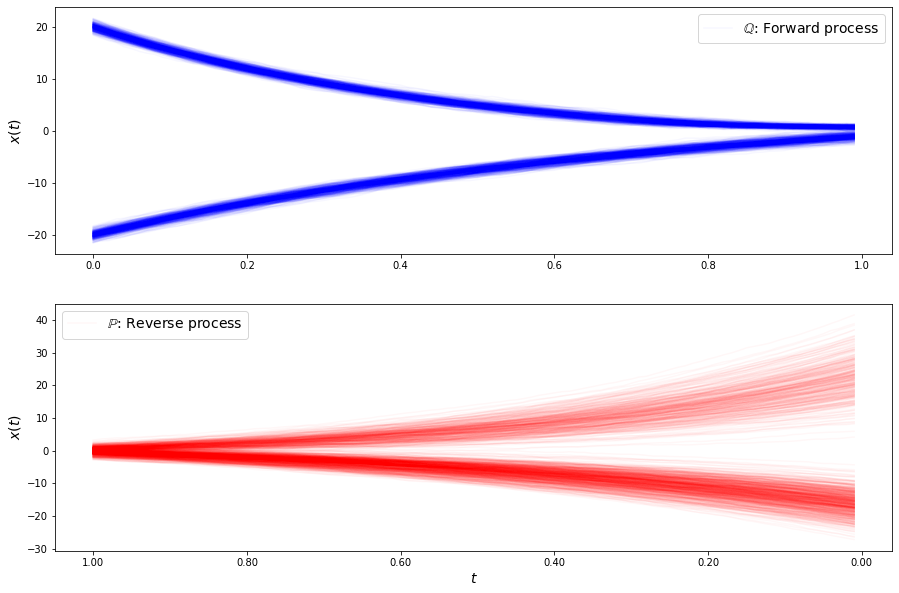

loss b 11.79757692708473
loss b 11.975856439823742
loss b 11.44198476212227
loss b 12.225956262102248
loss b 11.522821884436548
loss b 11.371598918793847
loss b 11.89596191664385
loss b 11.726789428946331
loss b 11.539106676501142
loss b 11.974128815370788
loss b 11.886060720285736
loss b 11.755878054495078
loss b 11.943498162497727
loss b 11.46435172370516
loss b 11.27254730901623
loss b 12.014814567263281
loss b 11.46510269887196
loss b 12.444356288125018
loss b 12.151743282830832
loss b 11.925024987321502
loss b 12.980365602876976
loss b 11.227863954019174
loss b 11.64300597007259
loss b 11.844637467816739
loss b 12.134795278926374
loss b 11.777566918342266
loss b 11.567711150557754
loss b 12.49750515828855
loss b 11.72104073805059
loss b 12.713773572544351
loss f 3.4234280773547585
loss f 3.4888176522883887
loss f 3.4904623980684226
loss f 3.404863083859107
loss f 3.4314328428376264
loss f 3.479075721742779
loss f 3.474513034656073
loss f 3.466910229157335
loss f 3.4566388384301847

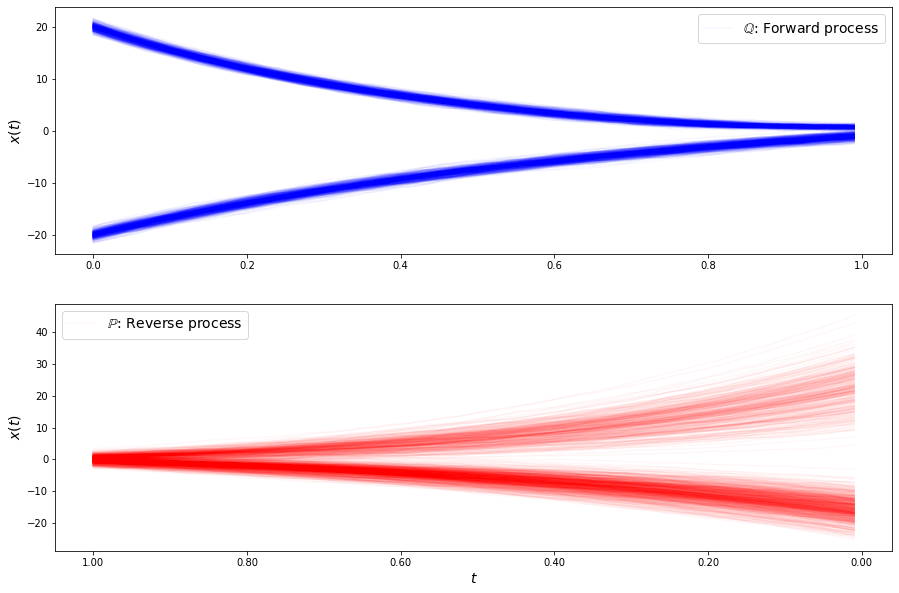

loss b 12.16568912103396
loss b 12.423298641848206
loss b 11.777281704455955
loss b 12.914258519113535
loss b 12.814004661558727
loss b 11.892881198546815
loss b 12.225581749791589
loss b 11.93315487416339
loss b 12.627972713824262
loss b 12.178834547306165
loss b 11.834425283792454
loss b 11.719074128481697
loss b 12.041634118014791
loss b 12.406597882592852
loss b 12.278272344065634
loss b 12.357952863339136
loss b 12.3348582053539
loss b 12.187470891507331
loss b 11.041843740596367
loss b 12.294249350528398
loss b 12.61166717658199
loss b 11.992109391676642
loss b 11.710325663427355
loss b 13.310796909021317
loss b 13.690938894878956
loss b 12.131790305033629
loss b 11.808461597714759
loss b 13.056061922426698
loss b 12.320215143897476
loss b 12.462462825263769
loss f 3.5231133749412678
loss f 3.523194544599911
loss f 3.536381312557549
loss f 3.5219206447877975
loss f 3.5580488905620773
loss f 3.5730070012837865
loss f 3.583499059141095
loss f 3.558917552755206
loss f 3.552885922080

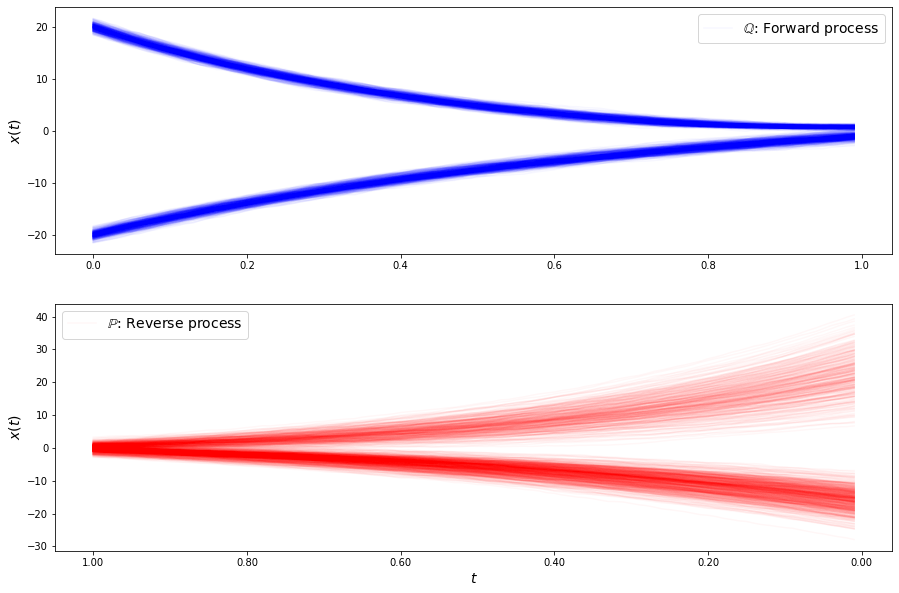

loss b 12.158975579675548
loss b 12.392979214733032
loss b 12.982688301017758
loss b 12.5214641858255
loss b 12.475013431685992
loss b 12.05186269580298
loss b 12.379088130445204
loss b 12.708622624450719
loss b 12.747976924613031
loss b 12.308971049404251
loss b 12.442367461851246
loss b 12.271592267262733
loss b 12.640877036015796
loss b 11.226855873146409
loss b 12.797433610160411
loss b 12.531539080741053
loss b 12.61647282258487
loss b 13.113490355516458
loss b 12.913279847469672
loss b 12.45530519229428
loss b 13.564187842155322
loss b 12.560409828007938
loss b 12.429470687083972
loss b 13.114247798850544
loss b 12.874311177101465
loss b 12.571461219571226
loss b 12.559317716872748
loss b 13.416976796402688
loss b 13.335264479123971
loss b 12.090071658264293
loss f 3.652018468109966
loss f 3.602347864425723
loss f 3.6125756872913994
loss f 3.6131998002446784
loss f 3.637717845774327
loss f 3.6840535248441526
loss f 3.6111890310823958
loss f 3.6014554209334277
loss f 3.65598601641

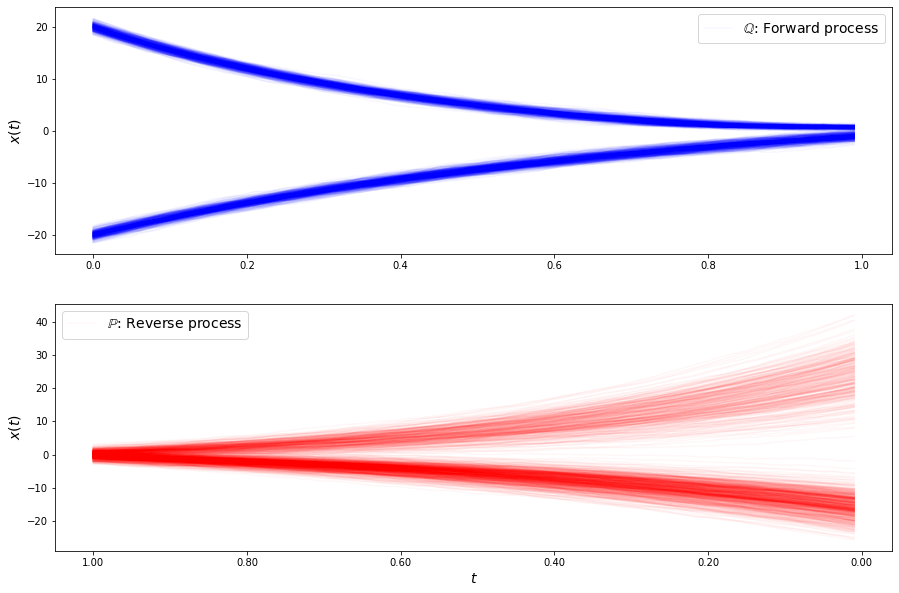

loss b 12.6972459177683
loss b 12.332640237793443
loss b 12.900561713607447
loss b 13.28964967932003
loss b 12.488147568492778
loss b 12.649249021430949
loss b 12.558880304575993
loss b 12.800618703206077
loss b 13.712514721259799
loss b 12.4300162253574
loss b 13.042443159025739
loss b 14.150524742788177
loss b 12.972417885158421
loss b 13.314976124012665
loss b 12.26326352116192
loss b 13.440070783198406
loss b 12.937877176327147
loss b 13.685210115171037
loss b 13.058955999893854
loss b 13.734519470843143
loss b 13.400666360543205
loss b 13.681221564750905
loss b 12.11316994029536
loss b 12.839674275155973
loss b 12.89343846512504
loss b 13.013275667042087
loss b 13.466638450856763
loss b 12.957600433139477
loss b 13.914234768349974
loss b 13.588576933857883
loss f 3.607160639211498
loss f 3.6777751409829045
loss f 3.6291062863121253
loss f 3.6693096014968964
loss f 3.699156583804809
loss f 3.7120001321463527
loss f 3.672564744879582
loss f 3.6931131372076647
loss f 3.64265371524028

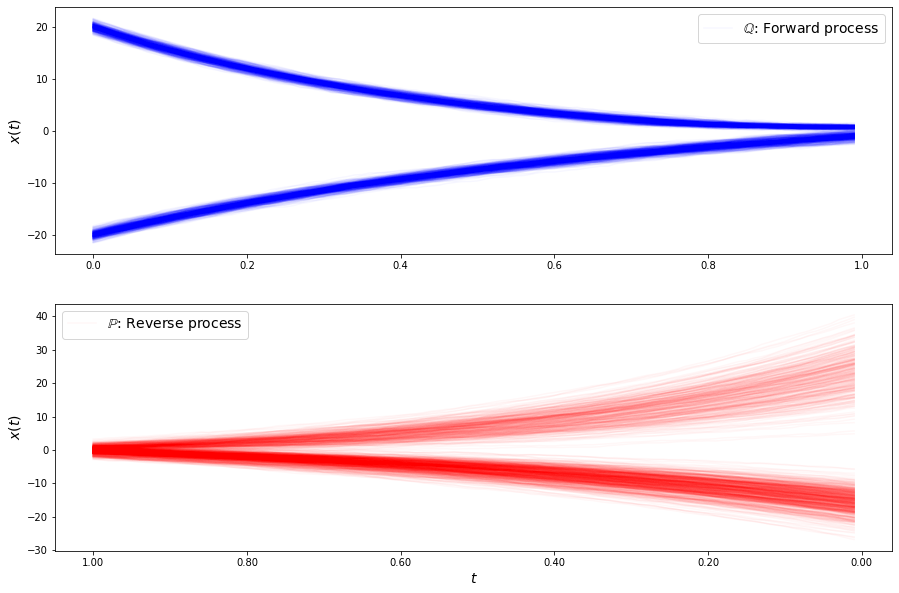

loss b 12.690477993994772
loss b 13.05984666854749
loss b 13.529625416200988
loss b 13.080639412974234
loss b 13.172047846260524
loss b 12.70071211144876
loss b 13.428856191786371
loss b 13.687099053751771
loss b 13.43345857576304
loss b 13.335605816639845
loss b 13.751064700838599
loss b 12.889059727434043
loss b 14.558416594987513
loss b 14.09346535115961
loss b 13.411943258183507
loss b 13.62948168363962
loss b 13.63078606661922
loss b 13.285682246932861
loss b 13.501184439213626
loss b 12.272171817513867
loss b 13.597485336743071
loss b 12.857689623998478
loss b 13.124372630509688
loss b 14.097086360805996
loss b 13.238289103052935
loss b 13.683928742308527
loss b 13.813515079022734
loss b 13.835275916576675
loss b 14.079704382662344
loss b 13.389288188161903
loss f 3.7365356003900905
loss f 3.6530754048674523
loss f 3.7109178648955456
loss f 3.715740653168892
loss f 3.688066461794623
loss f 3.7450514161567106
loss f 3.707767854044309
loss f 3.7598810990507228
loss f 3.761285479425

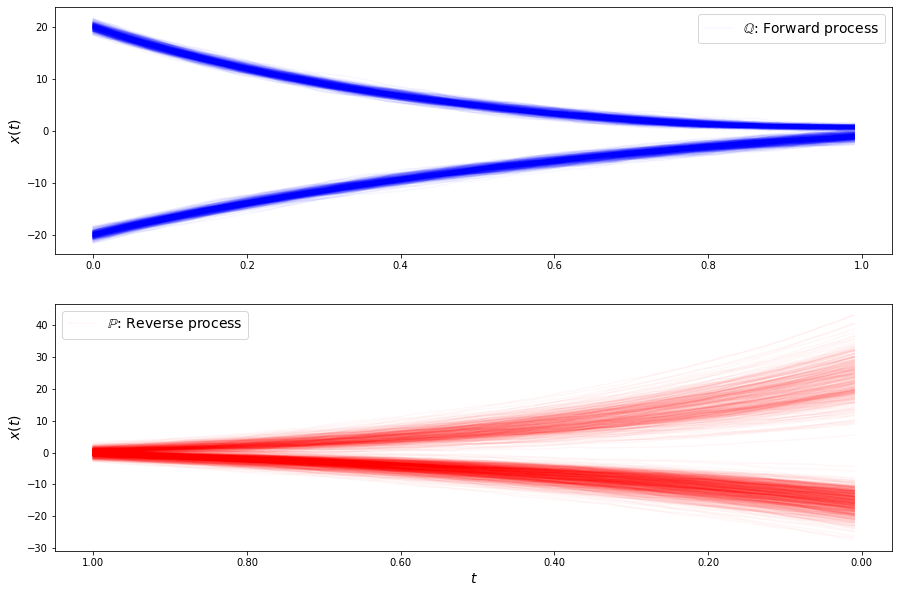

loss b 13.149441708537688
loss b 13.584733859885187
loss b 13.128567379543888
loss b 13.112541061193731
loss b 13.293453511868396
loss b 13.737750867749806
loss b 13.523510923453726
loss b 13.553459121944757
loss b 13.35184365794679
loss b 13.830920966329755
loss b 13.739570378781858
loss b 12.62367837441693
loss b 13.691877581367148
loss b 13.240439585318729
loss b 13.779936114187121
loss b 13.225377664179943
loss b 13.576009966876786
loss b 14.032828120653846
loss b 12.554092539533393
loss b 14.61575493451296
loss b 13.237871429079537
loss b 13.56837245939557
loss b 14.10354774767657
loss b 13.731862777573177
loss b 13.314439608781763
loss b 13.32877770178392
loss b 13.684883031099357
loss b 13.130191919698328
loss b 13.993479699956591
loss b 14.179553923171975
loss f 3.701825414495616
loss f 3.739048667403378
loss f 3.775617630617762
loss f 3.7321960152642704
loss f 3.672608044812619
loss f 3.76161816370135
loss f 3.726975204464875
loss f 3.665376994088188
loss f 3.716994521749615
l

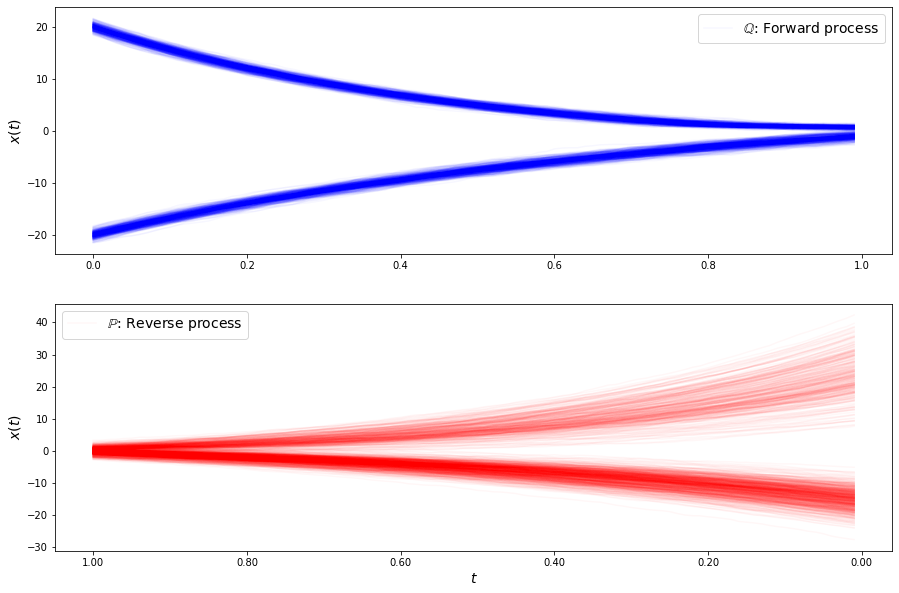

loss b 12.457267941389922
loss b 14.048997851054763
loss b 15.152404458370471
loss b 13.201590001958937
loss b 14.45394480946738
loss b 13.072631057200624
loss b 13.76304319454646
loss b 13.693725461173132
loss b 13.616831247350367
loss b 13.87166179995105
loss b 14.18113263841241
loss b 13.870977447548945
loss b 13.465131513956345
loss b 14.13660349661388
loss b 14.209058418324021
loss b 14.093376317928259
loss b 14.190632620149083
loss b 13.983733212313872
loss b 14.037272848183187
loss b 14.58478877448988
loss b 13.588865397389613
loss b 13.74415530202039
loss b 14.479815664268202
loss b 13.21048515170788
loss b 14.328678816678
loss b 14.519068159944718
loss b 13.712964945931702
loss b 13.781077633598867
loss b 13.017762782150026
loss b 14.409847204405153
loss f 3.7624921400377933
loss f 3.715009395399229
loss f 3.7303849022750653
loss f 3.7242454999745944
loss f 3.7214594326747896
loss f 3.697236377480411
loss f 3.716804784564899
loss f 3.704411406193582
loss f 3.7490661857267407
l

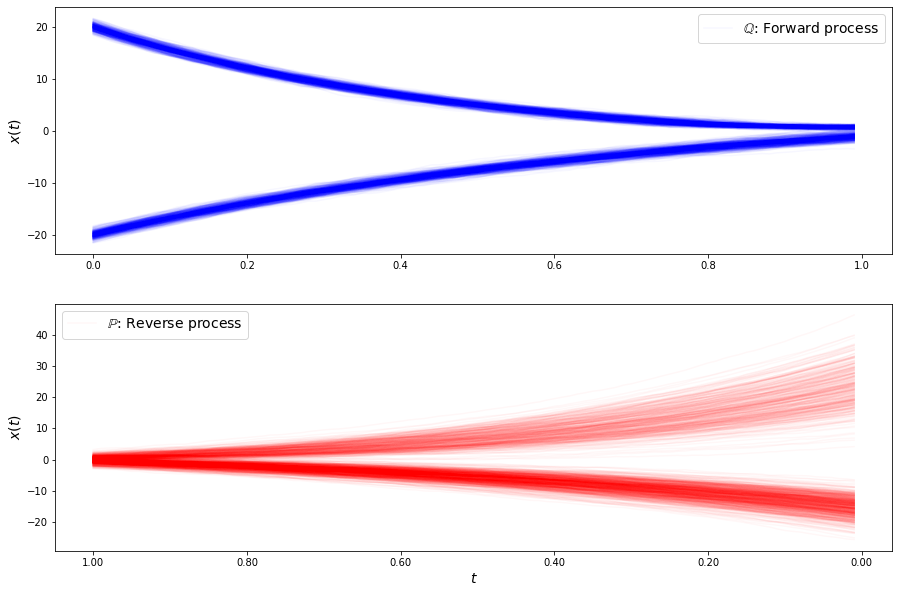

loss b 14.22015757476718
loss b 13.631829229159266
loss b 13.58220098480453
loss b 14.174995870267484
loss b 14.190080646035785
loss b 14.39175223204435
loss b 13.456944864175568
loss b 13.90443893118111
loss b 14.196744457338374
loss b 14.096529145537838
loss b 14.35997756879331
loss b 13.76010928415761
loss b 14.371648788372113
loss b 14.073581043071604
loss b 14.157392763921795
loss b 13.820709717193674
loss b 14.345811582810855
loss b 13.431579722430229
loss b 14.2224282323274
loss b 14.640909714332393
loss b 13.71392371409315
loss b 13.213247055423459
loss b 14.176219336539614
loss b 13.717141656649211
loss b 14.939811413192672
loss b 14.303997774696183
loss b 14.004693090116813
loss b 14.175739365548216
loss b 13.99836323112023
loss b 13.68252999873179
loss f 3.722997397224685
loss f 3.7069330451810685
loss f 3.706401706845527
loss f 3.740156530062215
loss f 3.7153741424660707
loss f 3.7372480071195504
loss f 3.7461758116159096
loss f 3.730114420081606
loss f 3.738761415008014
lo

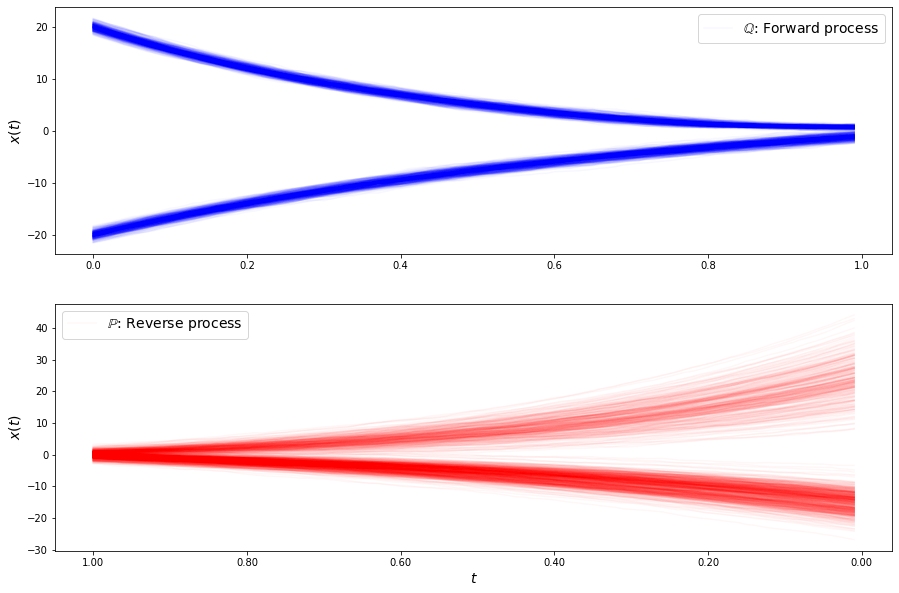

loss b 14.326694110213488
loss b 13.489787770264751
loss b 14.11363901908377
loss b 13.986189768401418
loss b 14.144675812337338
loss b 14.04745969878474
loss b 15.177168849273889
loss b 14.012651211508338
loss b 15.341898454369197
loss b 14.304822196538584
loss b 14.256321772425002
loss b 14.070775637489158
loss b 14.898739009134808
loss b 13.391677711130184
loss b 14.138151168358812
loss b 13.3338482592532
loss b 13.990689016596225
loss b 14.323172408732704
loss b 13.765324954374178
loss b 15.082295598894033
loss b 14.130205051974988
loss b 13.808881717817309
loss b 14.179271217582896
loss b 13.978261866666786
loss b 14.73422986406218
loss b 14.483917725156537
loss b 14.099590338850723
loss b 14.791007308211631
loss b 14.155872814420581
loss b 13.529538985736643
loss f 3.704845103919112
loss f 3.7536200073916226
loss f 3.7467949342853775
loss f 3.6474385611108104
loss f 3.7010228935354292
loss f 3.7441213077088524
loss f 3.7224792707254784
loss f 3.7471067925540464
loss f 3.698961565

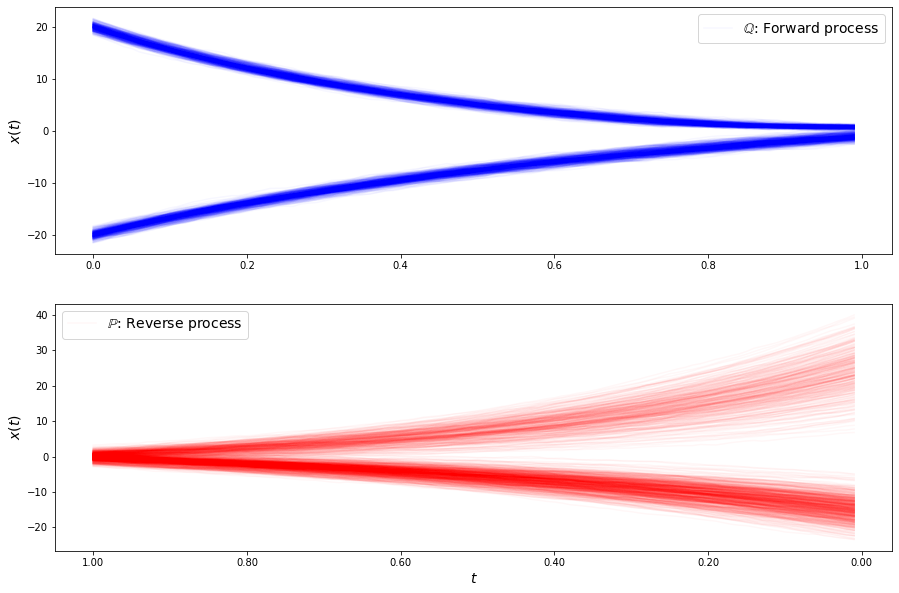

loss b 13.711910765098288
loss b 14.07451671071846
loss b 14.188760307571238
loss b 13.939176104308073
loss b 14.450462250984032
loss b 14.213014915521462
loss b 14.47722845330667
loss b 14.571737358021792
loss b 14.154499141811124
loss b 14.38426250828203
loss b 14.121318474475022
loss b 13.81673098495286
loss b 14.159761221959213
loss b 14.353310069279138
loss b 14.220058335779388
loss b 14.408092568837684
loss b 14.313924234369766
loss b 14.588667026013361
loss b 14.08435429136582
loss b 14.05292311711851
loss b 14.3301252910783
loss b 14.488388860571709
loss b 13.332426813844025
loss b 14.038877525293442
loss b 13.86881072953017
loss b 13.81868320909146
loss b 14.677882512073472
loss b 14.74765735486911
loss b 14.366310231159707
loss b 14.125686829812102
loss f 3.73623077531955
loss f 3.7312074727969318
loss f 3.7427089705841925
loss f 3.723977096069621
loss f 3.720320805587674
loss f 3.7249121429507897
loss f 3.7520561441961595
loss f 3.6915271564702734
loss f 3.7334350407099546
l

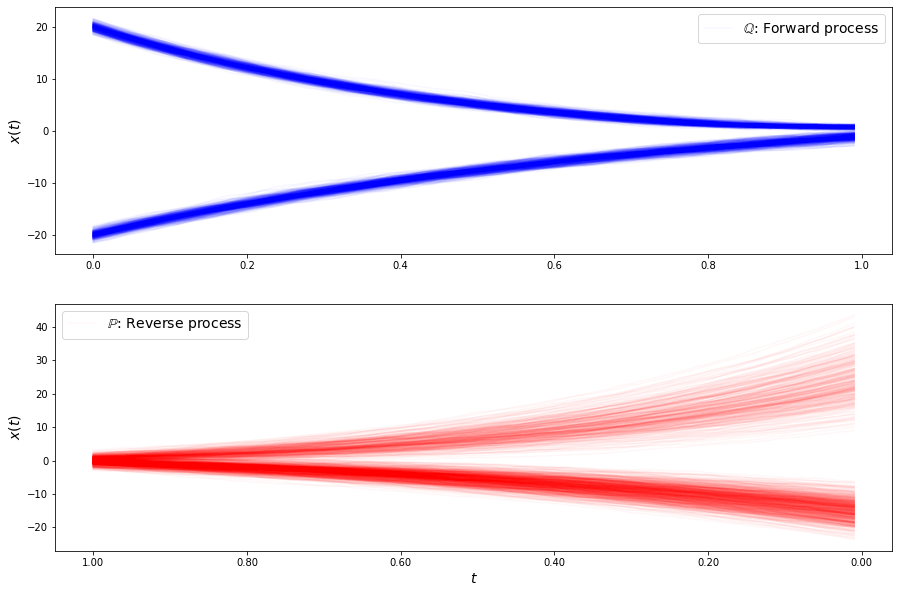

loss b 14.91520525096701
loss b 14.00749197262596
loss b 14.554168038933826
loss b 14.630854162576309
loss b 14.638688296837886
loss b 14.024201601930178
loss b 14.238092021659872
loss b 14.285049720741641
loss b 14.168116448561037
loss b 14.682031139643236
loss b 14.142620539631972
loss b 15.323041440031364
loss b 13.9406382885573
loss b 14.273492795442131
loss b 13.891737251548543
loss b 14.34882573614085
loss b 14.571898451686447
loss b 15.02773007657675
loss b 14.514071224714604
loss b 14.418824694501996
loss b 14.490729186927869
loss b 13.796287259968393
loss b 14.668477508023221
loss b 14.572675291081206
loss b 14.812393554667498
loss b 13.715875431600256
loss b 14.780418582792377
loss b 13.995888489240967
loss b 14.131248971936703
loss b 14.664795504745692
loss f 3.7334071593993805
loss f 3.7722733624753184
loss f 3.7149718655484874
loss f 3.723877273620133
loss f 3.7505260193957093
loss f 3.766307385350138
loss f 3.74521193166601
loss f 3.723105738863076
loss f 3.73304749714621

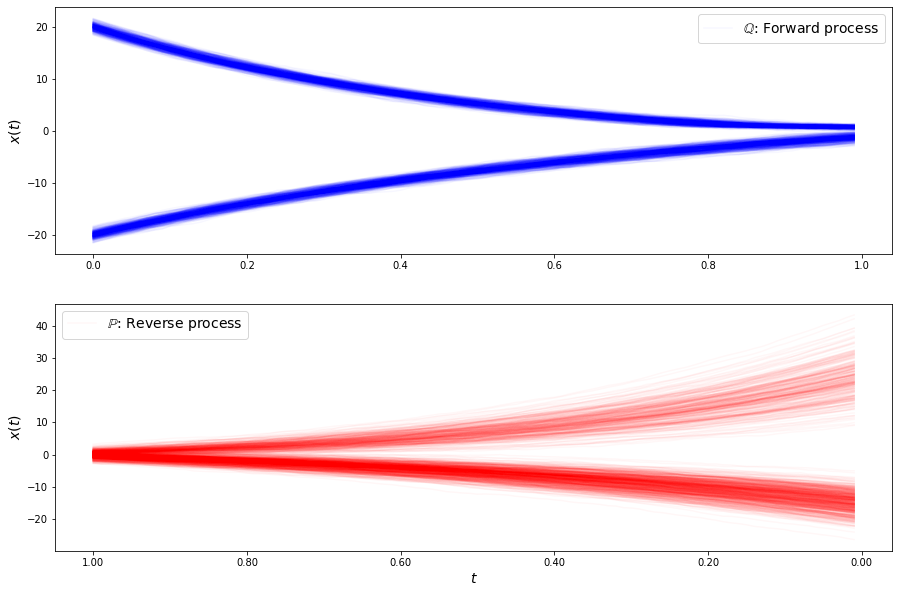

loss b 13.902024455409677
loss b 14.790470919990677
loss b 15.334160839422038
loss b 14.456690880629333
loss b 14.34811206367253
loss b 14.492071896924728
loss b 14.436632962696395
loss b 13.705269691241938
loss b 14.427164079977624
loss b 13.367934464624092
loss b 14.673170698896365
loss b 13.650002919266976
loss b 14.14369324728752
loss b 14.319781274323804
loss b 14.732277736134515
loss b 14.344102440329621
loss b 14.738282445934832
loss b 14.75457676798065
loss b 14.25988728893307
loss b 14.321291922754423
loss b 14.37208071221627
loss b 14.02098600483243
loss b 14.155621603208344
loss b 14.258511030082637
loss b 14.391930777157272
loss b 14.180587606383252
loss b 14.031569234955551
loss b 13.894876589535139
loss b 13.982064128828476
loss b 13.94175943453668
loss f 3.724462225004714
loss f 3.786304389701449
loss f 3.6891803160990753
loss f 3.74843112944317
loss f 3.7158467075055164
loss f 3.73062714510961
loss f 3.7291813671485943
loss f 3.7146063570890187
loss f 3.7506568244201595

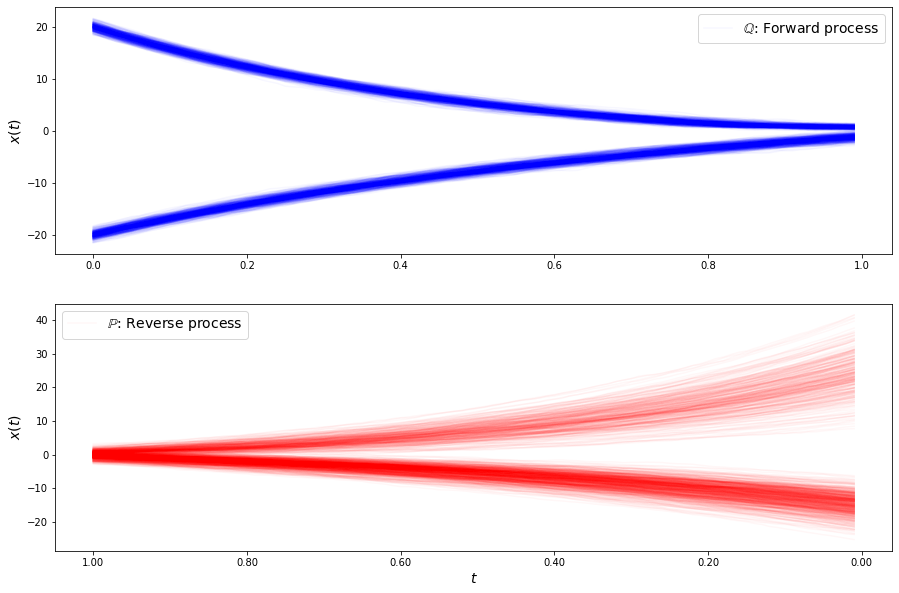

loss b 14.509453124376337
loss b 13.883081925095363
loss b 14.062672455375393
loss b 14.051823277681063
loss b 13.636014313700937
loss b 14.897052454489101
loss b 14.212087686726317
loss b 14.420652074653939
loss b 13.934708596635163
loss b 14.180801357380872
loss b 14.720542370383374
loss b 15.413637117848126
loss b 13.920478931921263
loss b 13.77018918931433
loss b 13.472138807171866
loss b 14.108242533567683
loss b 14.06370316256763
loss b 14.075973301270963
loss b 13.935464291460319
loss b 14.77383689255425
loss b 14.524230174220886
loss b 14.186097346844653
loss b 14.520225493434408
loss b 14.750265378732243
loss b 14.09501971738726
loss b 14.241777084969995
loss b 13.891257796469754
loss b 14.028762453425577
loss b 14.33912823801088
loss b 13.894556023158836
loss f 3.694982936434709
loss f 3.7489578334130096
loss f 3.6771000185706537
loss f 3.7282836950633045
loss f 3.741559469718557
loss f 3.751844609515081
loss f 3.713884683667345
loss f 3.7280332415903996
loss f 3.687055364028

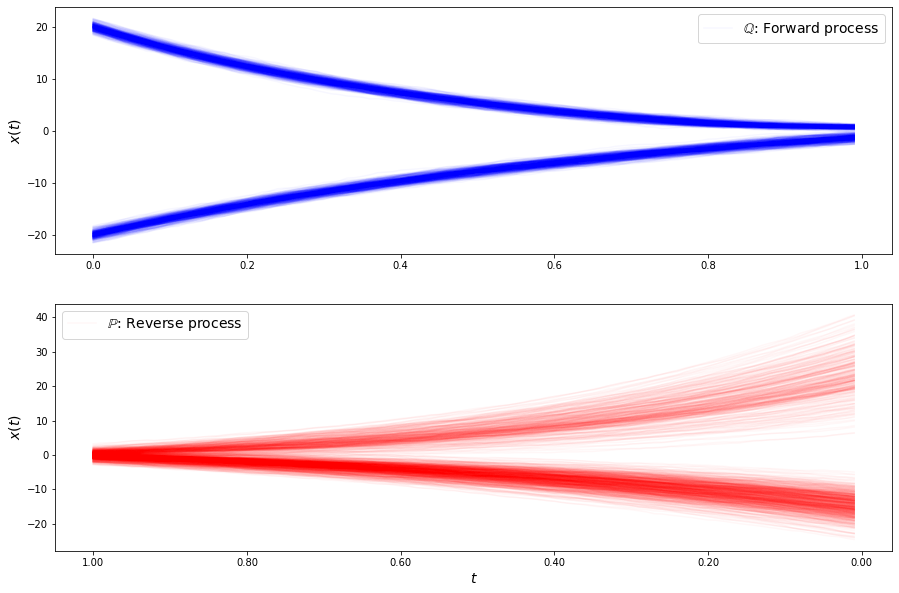

loss b 14.43540754365024
loss b 14.240450285632345
loss b 14.320400398939016
loss b 14.579062853155813
loss b 13.877728352821366
loss b 13.576006833153192
loss b 14.302702416971266
loss b 14.693350974344796
loss b 14.294342345970797
loss b 14.86546423734432
loss b 14.847873634439882
loss b 13.82900118279293
loss b 14.230933139864431
loss b 14.09464803828966
loss b 14.613370697221665
loss b 14.105557096829362
loss b 14.720776032212726
loss b 13.89759320333351
loss b 13.897804012945192
loss b 13.636589906412196
loss b 14.38935519492737
loss b 13.655083360689778
loss b 14.283226982511438
loss b 13.92524653493465
loss b 14.342396146394302
loss b 13.613202155818804
loss b 13.49008836805108
loss b 13.834348417074265
loss b 14.188707829222409
loss b 14.14888852517661
loss f 3.759803133725061
loss f 3.677715099997628
loss f 3.7317101571893945
loss f 3.718877226326328
loss f 3.724211007789409
loss f 3.6745125058584596
loss f 3.815761976904613
loss f 3.7398282704170867
loss f 3.6766340607769523


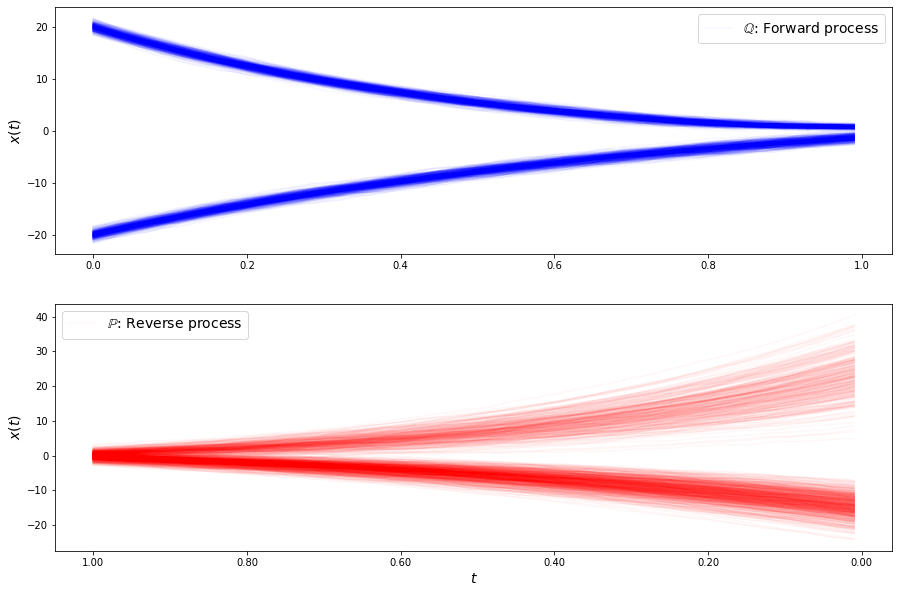

loss b 14.86275166296874
loss b 14.478543557378824
loss b 13.95359334830649
loss b 14.265803951812428
loss b 14.786872528642089
loss b 13.7611176710432
loss b 14.497212193279976
loss b 14.614258229157487
loss b 14.720817970695542
loss b 14.16621112910464
loss b 14.32392389015982
loss b 14.095063135704073
loss b 14.339522354958696
loss b 14.438891187923167
loss b 13.816635928664393
loss b 14.561965851787548
loss b 14.357718365910806
loss b 14.331150710732881
loss b 14.711192421788747
loss b 14.358085238884447
loss b 13.722987235582574
loss b 14.027263959205902
loss b 13.940652345350124
loss b 14.799413195150484
loss b 13.229558107160171
loss b 14.398363173841012
loss b 13.532235645220354
loss b 13.849378415518794
loss b 14.14750212539284
loss b 13.613544350607013
loss f 3.7178049611662085
loss f 3.7406504276334402
loss f 3.679435223905966
loss f 3.6760938621000734
loss f 3.717847654227018
loss f 3.7099433969592877
loss f 3.683636719228345
loss f 3.7203223459788095
loss f 3.6991169343371

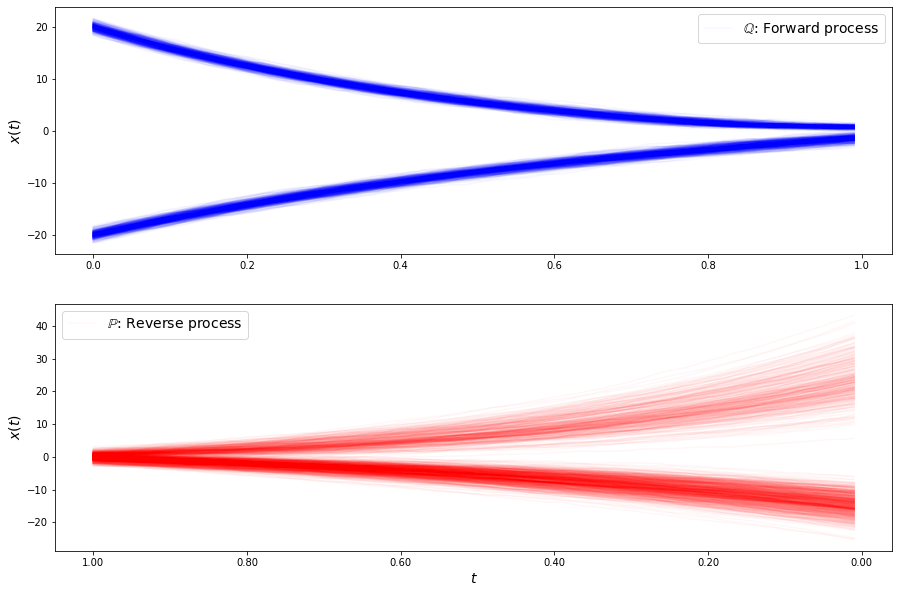

loss b 14.379800622061614
loss b 14.09507336637234
loss b 14.517039859809655
loss b 14.038007563694142
loss b 14.5367026608612
loss b 14.057058318457017
loss b 14.254535549047533
loss b 13.420742614227338
loss b 14.172655733598878
loss b 13.861493919103124
loss b 14.180941064652924
loss b 13.628019854128022
loss b 14.71657574422768
loss b 13.859862494431109
loss b 14.133308067453434
loss b 14.507274061179178
loss b 14.120933373162583
loss b 14.15026243339546
loss b 13.683439634389197
loss b 13.988207546224393
loss b 13.363634642339441
loss b 14.46729432187827
loss b 13.93621573569093
loss b 14.355076521191087
loss b 13.83612684012936
loss b 14.512312985892846
loss b 14.092114457574407
loss b 13.571721136429835
loss b 14.046018351158157
loss b 13.73360681985012
loss f 3.706985601186785
loss f 3.686166927245379
loss f 3.686247600594804
loss f 3.727519816148905
loss f 3.7583286605088655
loss f 3.7469441193124946
loss f 3.6572795394723765
loss f 3.724143495157542
loss f 3.6880402564129096


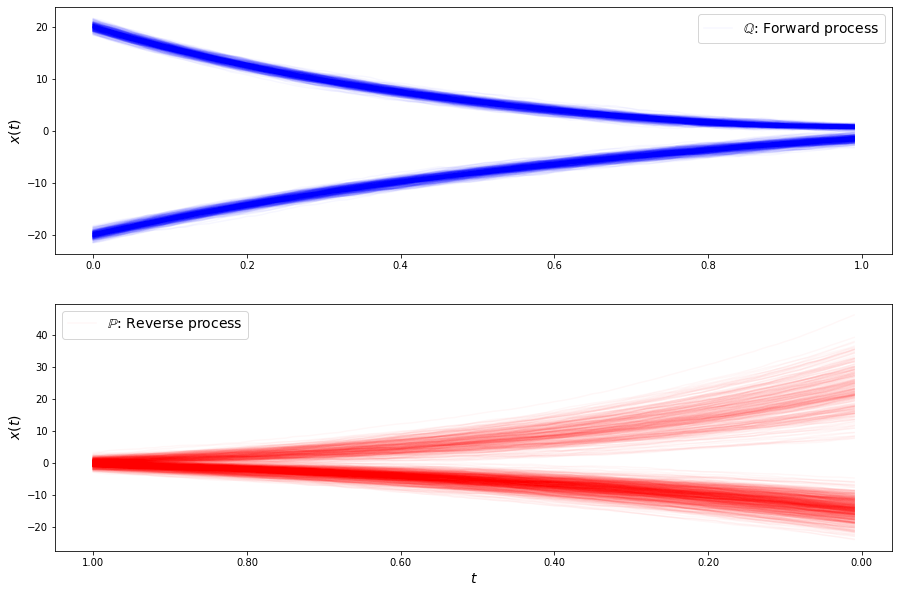

loss b 13.931143324644072
loss b 13.666795478080784
loss b 13.875062585767054
loss b 14.617367599486888
loss b 13.611053261944706
loss b 14.441405782650154
loss b 13.658867185137444
loss b 13.430453841346067
loss b 13.78538100556009
loss b 13.969597048599276
loss b 14.805092234916453
loss b 14.169736848161506
loss b 14.00942111949917
loss b 13.876275849603843
loss b 14.134736256476888
loss b 13.663973581650197
loss b 13.599164872075917
loss b 13.742109195447672
loss b 14.170888714168713
loss b 13.4857676991386
loss b 14.313510764047864
loss b 14.10138935051823
loss b 13.524627155818914
loss b 13.616599128402221
loss b 13.618074793244693
loss b 14.09063598863803
loss b 13.90472179365453
loss b 13.263155883720433
loss b 13.518170609130257
loss b 13.837109170394683
loss f 3.7386343570052074
loss f 3.726531660803062
loss f 3.7045854482370744
loss f 3.727967690844282
loss f 3.7005972600696575
loss f 3.7821629822679212
loss f 3.7330146244370437
loss f 3.7716111437561954
loss f 3.701365520880

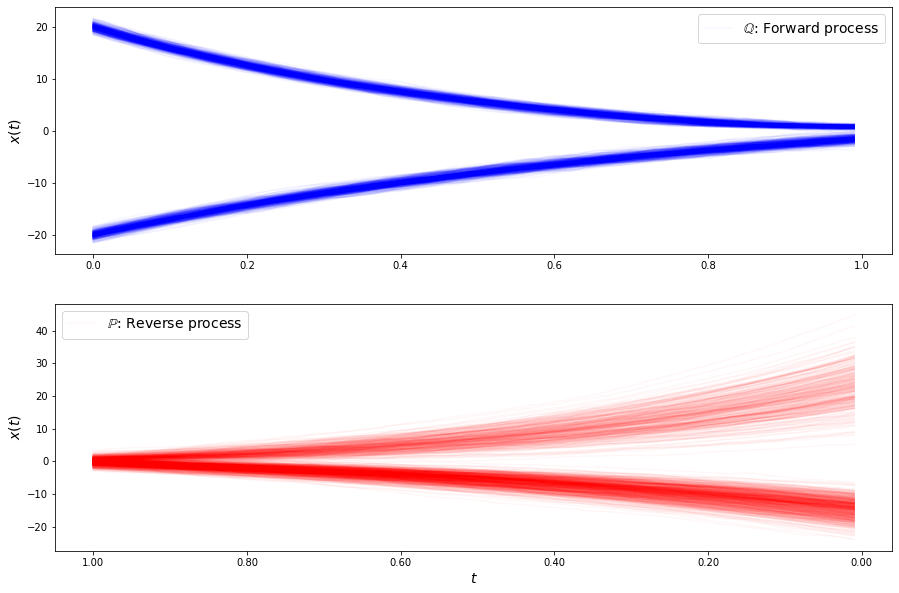

loss b 13.388271725487142
loss b 13.342975156054452
loss b 13.81650046383697
loss b 14.153908474423483
loss b 14.071062742792714
loss b 14.001352165404933
loss b 12.785236540628082
loss b 13.603032582556816
loss b 14.429768163270985
loss b 14.243221544776464
loss b 13.699736762400342
loss b 13.506246108853523
loss b 12.753938695662484
loss b 13.518690831466623
loss b 13.027797453746942
loss b 13.527392535290362
loss b 13.75981509583882
loss b 13.426505454401035
loss b 13.091397229182327
loss b 13.652528254444462
loss b 13.271649225634947
loss b 13.761080195200236
loss b 13.126177518065528
loss b 13.45531601902081
loss b 14.37517978803307
loss b 13.796688693907264
loss b 13.581670805974099
loss b 13.286251643017462
loss b 13.67586343044452
loss b 13.769481059362857
loss f 3.6481082570753802
loss f 3.6895472499856696
loss f 3.722845836759258
loss f 3.6571213638045186
loss f 3.619329447881528
loss f 3.6701642202217886
loss f 3.68582467844127
loss f 3.7109541311098537
loss f 3.678742586344

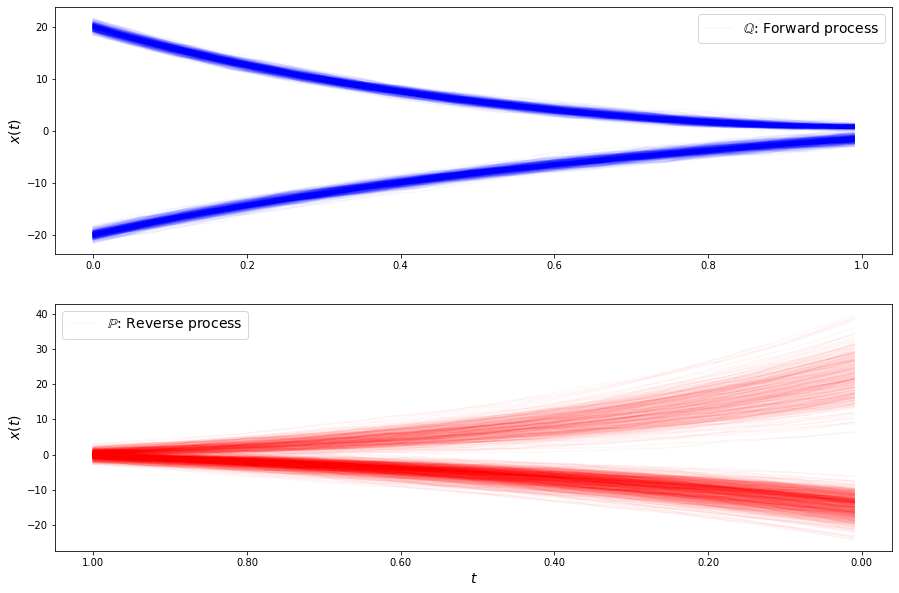

loss b 13.370243151593819
loss b 13.682154747328315
loss b 13.772562796479761
loss b 13.433566389061621
loss b 13.280730390076675
loss b 13.878032567133335
loss b 12.822875581931124
loss b 13.230637259350981
loss b 13.926199512663352
loss b 13.321139222652743
loss b 13.713319914885584
loss b 14.006999371961395
loss b 13.383912553643293
loss b 13.800015296832965
loss b 14.023038688850853
loss b 12.749698699666745
loss b 14.208154520646918
loss b 13.914316770827476
loss b 13.62229998799615
loss b 13.67966563559748
loss b 13.851075058879793
loss b 13.459394396784786
loss b 13.514614298512006
loss b 13.781047781349791
loss b 13.74481570507437
loss b 13.354326752338666
loss b 13.440544718447882
loss b 13.120544070867213
loss b 13.203992750098612
loss b 13.423500129664898
loss f 3.7824307954539265
loss f 3.6736862081349866
loss f 3.671956406853251
loss f 3.7414614171010703
loss f 3.720705213151149
loss f 3.638036785374179
loss f 3.6569982458340182
loss f 3.741947836287027
loss f 3.6276894979

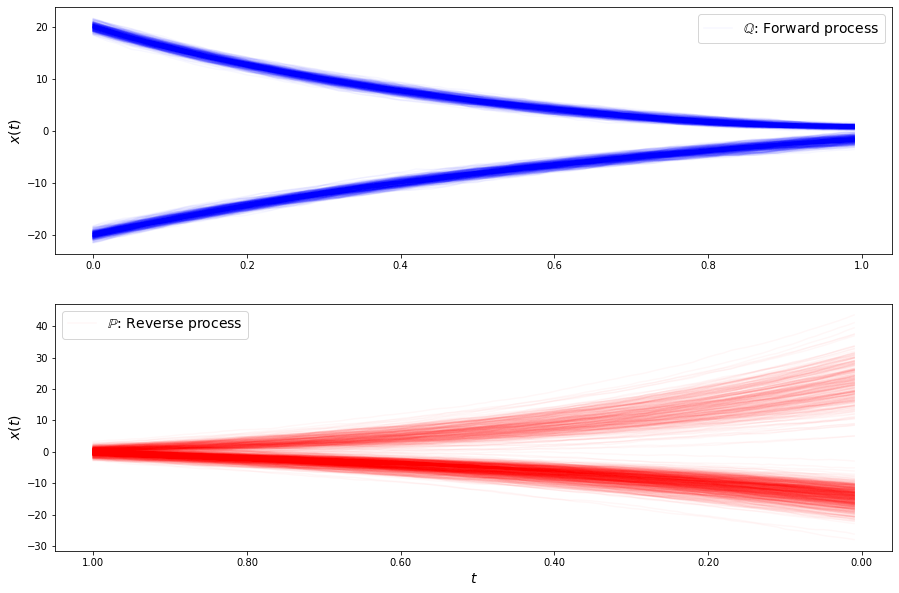

loss b 13.569296252795173
loss b 13.688714296273567
loss b 13.127479272260693
loss b 14.013322616953166
loss b 13.627721827054232
loss b 12.861196389592305
loss b 13.444700949781934
loss b 12.747353733648177
loss b 13.590777883183085
loss b 13.433071193157769
loss b 12.788691249823383
loss b 13.039820954499149
loss b 12.91347052196254
loss b 13.513193128050464
loss b 13.633245113970025
loss b 13.49597082866025
loss b 12.84951272473237
loss b 13.252786219711306
loss b 13.71504268748856
loss b 12.747085870605742
loss b 13.980977446525408
loss b 12.612814630591771
loss b 13.627040632243872
loss b 13.996865168922328
loss b 12.945299365143395
loss b 13.068428526758726
loss b 13.114743109457443
loss b 13.578343629082823
loss b 13.262658380322558
loss b 13.054591809036063
loss f 3.681846226352264
loss f 3.678281420065729
loss f 3.7161920372141584
loss f 3.680758905986457
loss f 3.6907696436564046
loss f 3.6936206244585454
loss f 3.626689972923865
loss f 3.687691627819106
loss f 3.697187959193

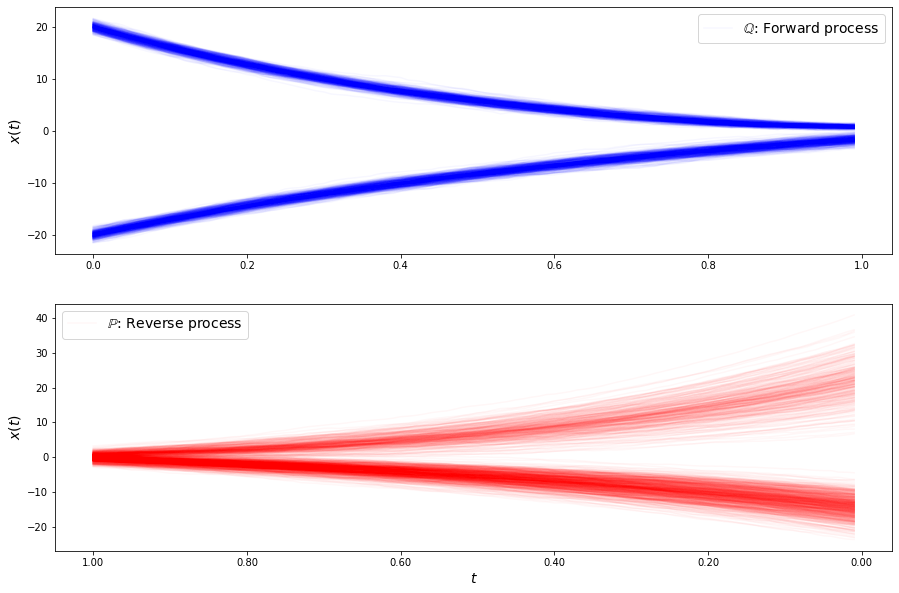

loss b 13.57859779199043
loss b 13.520912329765755
loss b 13.49031863560404
loss b 13.413318011587245
loss b 13.796415057377464
loss b 13.07554849534715
loss b 12.956581463782799
loss b 13.678916602679774
loss b 12.991311653391012
loss b 13.682138306276237
loss b 12.525073201530713
loss b 12.926456288828165
loss b 13.888969097443493
loss b 13.246517142317842
loss b 13.023226407532702
loss b 13.097803256500939
loss b 13.479336125043774
loss b 13.261893770424791
loss b 13.144776818326399
loss b 13.4636626702031
loss b 13.556103435122637
loss b 13.057620855704185
loss b 13.040458301431002
loss b 12.926416896704946
loss b 12.959090899993228
loss b 13.188784191451296
loss b 13.423521385366877
loss b 13.384088538924363
loss b 12.658260163833175
loss b 13.072579870545482
loss f 3.788295506168683
loss f 3.726717173850236
loss f 3.6989802157361518
loss f 3.7019668614663073
loss f 3.777015707889595
loss f 3.664354318659859
loss f 3.8035402224838095
loss f 3.6668942731604077
loss f 3.716986682315

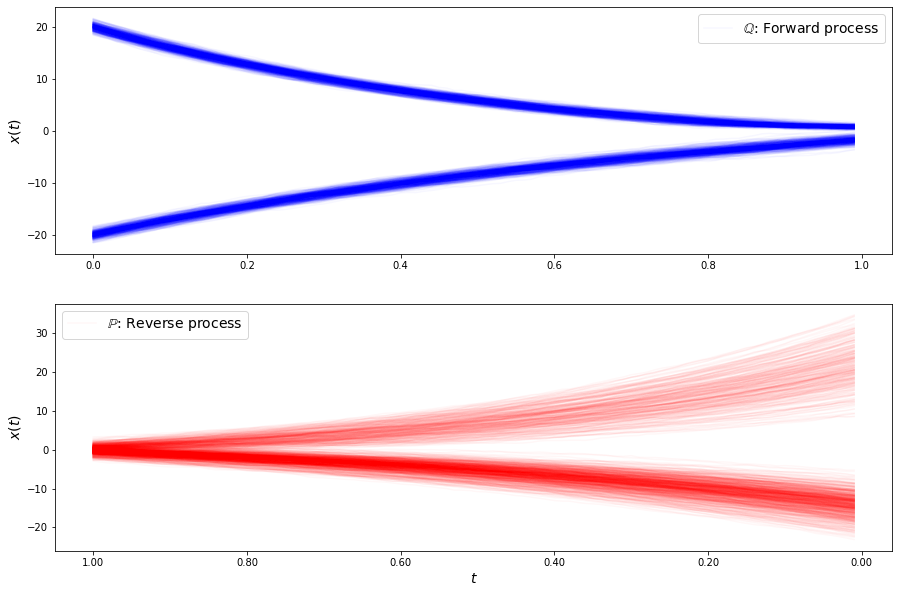

loss b 13.129909135681162
loss b 13.398576742611933
loss b 13.056882624665597
loss b 13.172767454369573
loss b 13.072799046654039
loss b 12.784997703168504
loss b 13.07084320791124
loss b 12.551112412359592
loss b 13.216915924631065
loss b 13.4018156009499
loss b 13.470459193286517
loss b 13.197769554389797
loss b 13.827904375077946
loss b 12.873262655682044
loss b 13.35871257439025
loss b 13.353489843263455
loss b 12.513171106912877
loss b 12.768023853230003
loss b 12.48106887919161
loss b 13.11445510184744
loss b 13.121060658863268
loss b 12.918671266482042
loss b 13.000539672997558
loss b 13.3878319176028
loss b 12.792999244907865
loss b 12.688058115756073
loss b 12.706181328870617
loss b 13.156793534951296
loss b 13.19318708281361
loss b 12.825173113424498
loss f 3.7671743902096293
loss f 3.718081424080643
loss f 3.66473493345779
loss f 3.724068146696173
loss f 3.6785624281246765
loss f 3.6823147255844098
loss f 3.728862447817324
loss f 3.6352043075453673
loss f 3.8077708563868766


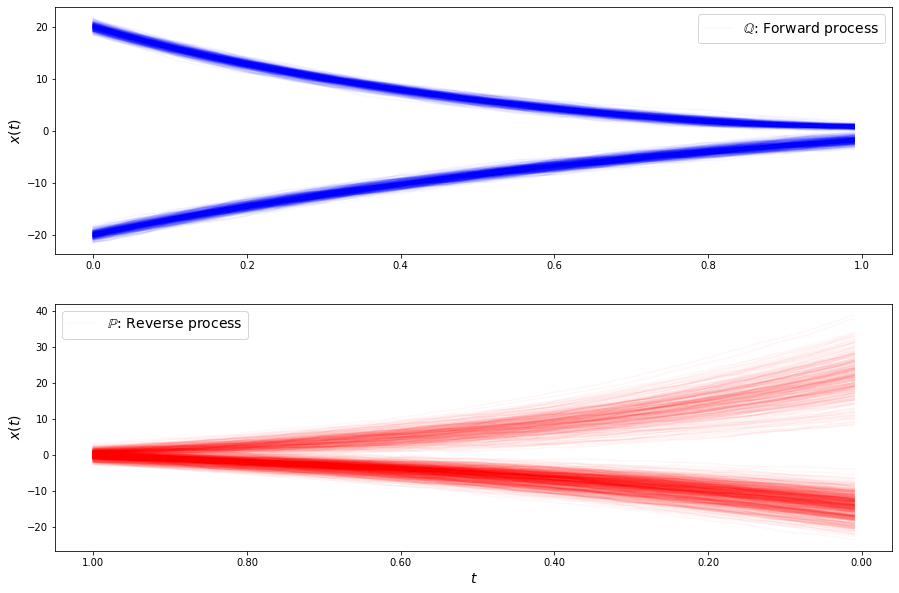

loss b 12.408992377119542
loss b 13.24131130507827
loss b 13.282450678470573
loss b 12.624374752198271
loss b 13.36927172147918
loss b 12.791959151180484
loss b 12.74308406707542
loss b 12.889946169126166
loss b 12.830406617828457
loss b 12.97427579018954
loss b 12.332095252440311
loss b 11.81195588291429
loss b 12.565312959065306
loss b 12.73290343878245
loss b 12.665679956303737
loss b 12.978541660649741
loss b 12.781593691808222
loss b 12.722401613432687
loss b 12.772237163131111
loss b 12.269292905065956
loss b 12.54310081166657
loss b 12.600255284459433
loss b 13.548466772104243
loss b 13.127049210453158
loss b 12.682755675341436
loss b 13.476431752036339
loss b 13.459227506297069
loss b 12.598519363584563
loss b 12.34897976081965
loss b 13.051064598847052
loss f 3.742978920918207
loss f 3.7828376128628696
loss f 3.7146768463582234
loss f 3.717158807538296
loss f 3.857327182293717
loss f 3.673825823912122
loss f 3.801861834708232
loss f 3.6562017954536055
loss f 3.7010295478941395

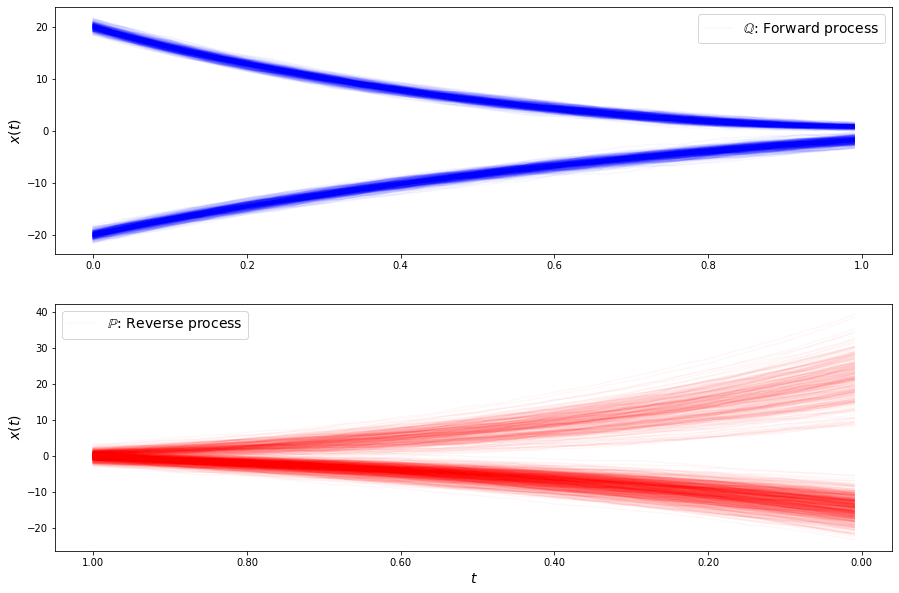

loss b 12.478020716725698
loss b 13.246766910448114
loss b 12.481459684272528
loss b 12.241642315006564
loss b 12.791613300293804
loss b 12.854558922742122
loss b 12.429424647181609
loss b 12.720829316042352
loss b 12.435995055987828
loss b 13.008005516258441
loss b 12.867733261583465
loss b 13.31313804265119
loss b 12.360636978841193
loss b 13.376296857829487
loss b 12.460098666056158
loss b 13.18054964896251
loss b 13.049672705464866
loss b 12.849977646861745
loss b 12.7904517231782
loss b 13.176688933029807
loss b 12.582172041672294
loss b 12.352003499711666
loss b 13.346580445294112
loss b 12.624587440192716
loss b 12.382790291537786
loss b 12.90881668880322
loss b 12.61782518466171
loss b 12.673702659592776
loss b 12.757391635481621
loss b 12.30485729842333
loss f 3.721354742959533
loss f 3.7988198280182375
loss f 3.7215865760720224
loss f 3.7908065370632316
loss f 3.6634611999171707
loss f 3.777845838514021
loss f 3.818225890337855
loss f 3.7822817764019763
loss f 3.7848378444101

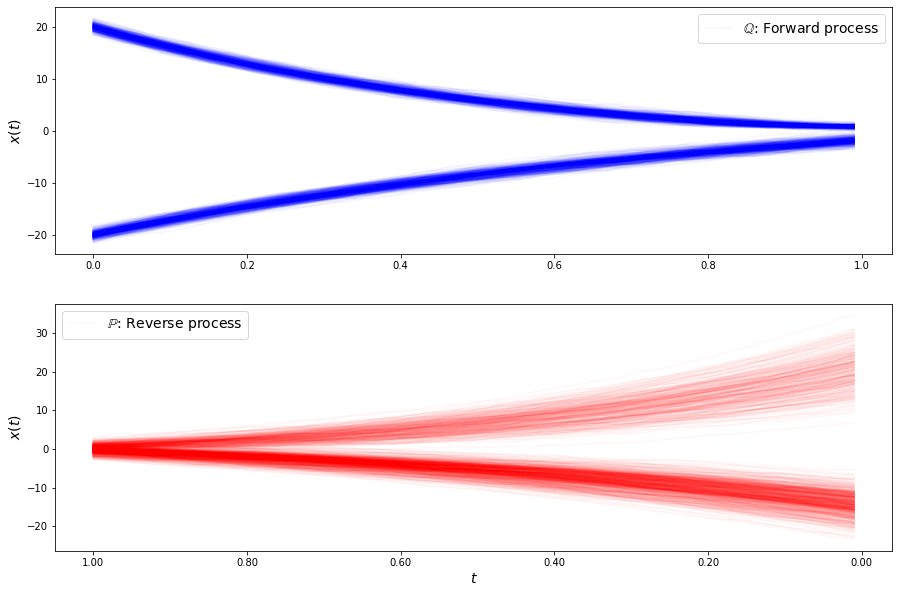

loss b 12.921255828921911
loss b 12.399343151782121
loss b 12.873160509026205
loss b 13.09737498441992
loss b 12.361769358150832
loss b 12.629214068421769
loss b 12.77596640350159
loss b 12.214330934734392
loss b 12.788241814447556
loss b 12.26677368882796
loss b 12.797991204402491
loss b 12.858833424792707
loss b 12.678645305081295
loss b 12.796442013110495
loss b 12.306450930270087
loss b 12.722530073674726
loss b 12.87753500086417
loss b 13.285097540027497
loss b 12.77265565884124
loss b 12.55820252747223
loss b 13.290878843331019
loss b 12.744898623073649
loss b 12.297739257269582
loss b 12.329337688248318
loss b 12.873904700233078
loss b 12.727893581843716
loss b 12.448676473922173
loss b 12.615023081040231
loss b 12.196197244499187
loss b 12.646482624914027
loss f 3.786048665806227
loss f 3.759288174894064
loss f 3.7506690543152668
loss f 3.7843924436904337
loss f 3.8146737336634438
loss f 3.795713393717995
loss f 3.82574667479529
loss f 3.7867605750895734
loss f 3.79257001844955

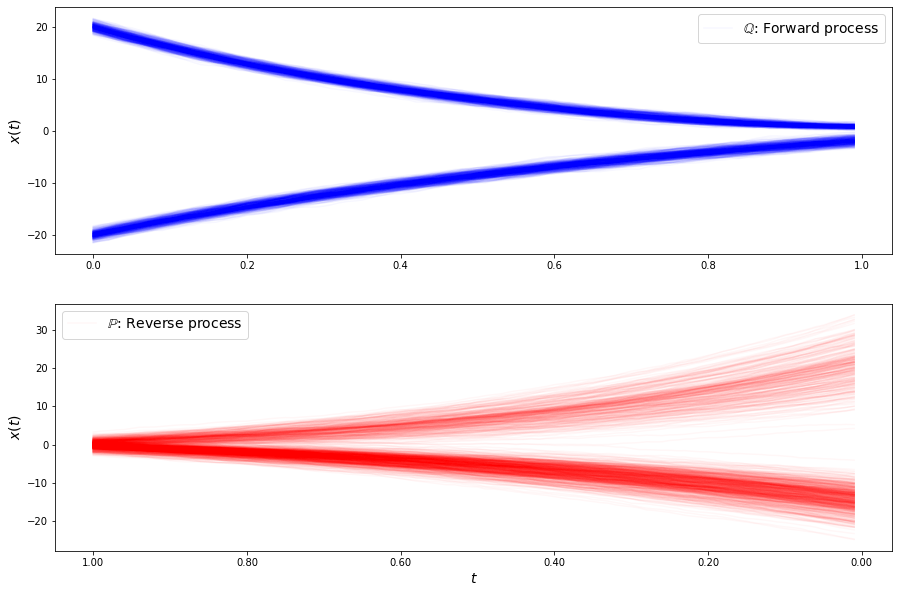

loss b 12.340722124226135
loss b 12.668062742362892
loss b 12.43441107845709
loss b 12.828097319829112
loss b 12.302346627725903
loss b 12.646963060075874
loss b 12.37577685444176
loss b 12.766480023565965
loss b 12.614764954204585
loss b 13.017075911972423
loss b 12.231061651280855
loss b 13.074132647163825
loss b 12.591261690696557
loss b 12.331313560469365
loss b 12.03865980113376
loss b 12.138195734203768
loss b 12.640651071612236
loss b 12.432042892782617
loss b 12.679920120029575
loss b 12.514320717812446
loss b 12.284978677780812
loss b 12.378038877954086
loss b 12.88296597309582
loss b 12.434462588815325
loss b 12.612722826324118
loss b 12.184859944156864
loss b 12.312595835657946
loss b 12.395979059756948
loss b 12.698112372280303
loss b 12.609918191983189
loss f 3.790510866032444
loss f 3.858253099811037
loss f 3.859414094496431
loss f 3.8366496539948938
loss f 3.768225711166332
loss f 3.8553683933654064
loss f 3.7341547319543325
loss f 3.7858798292163085
loss f 3.82524261620

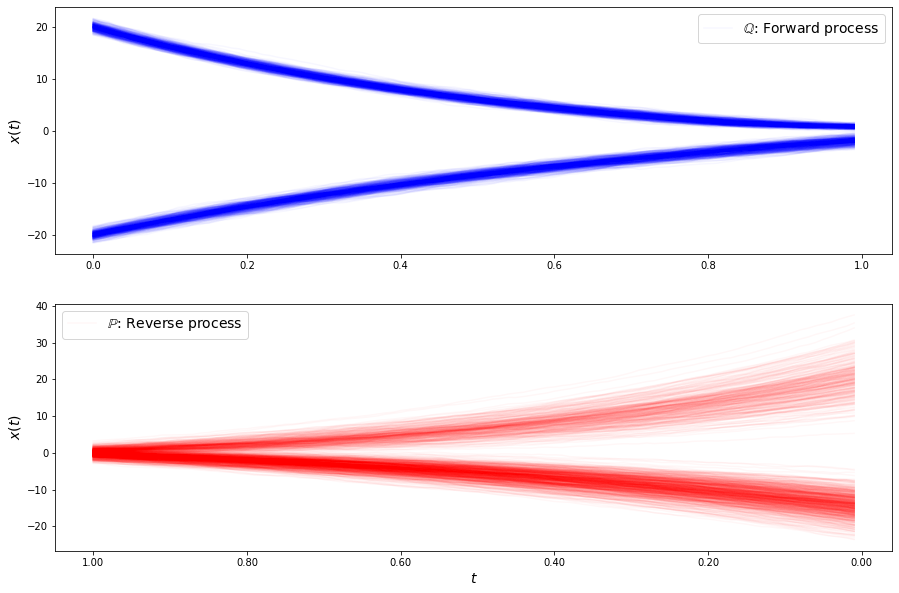

loss b 12.479246140191586
loss b 12.704305749357726
loss b 12.375610892184335
loss b 12.223547754402196
loss b 12.547694654792947
loss b 12.020190377783816
loss b 12.080992609880735
loss b 11.803391726539385
loss b 12.048204293527977
loss b 11.79566466347644
loss b 12.819207461151148
loss b 12.833249847122604
loss b 12.515860471730615
loss b 12.202439191420186
loss b 12.987830489609788
loss b 12.429587556981353
loss b 12.449516105440994
loss b 12.072953450363663
loss b 12.447525830754834
loss b 11.81001622290533
loss b 12.68460400477796
loss b 12.385185953173671
loss b 12.994341952306637
loss b 12.824552697164037
loss b 12.458780149566284
loss b 12.443544010525457
loss b 13.135680516899676
loss b 13.243953623824076
loss b 12.660883357422968
loss b 12.122451962628165
loss f 3.9613548116851773
loss f 3.812511413003529
loss f 3.804074023821965
loss f 3.837147489433286
loss f 3.7892402237776457
loss f 3.7497934957230843
loss f 3.852022892345898
loss f 3.8368715326364993
loss f 3.8074578771

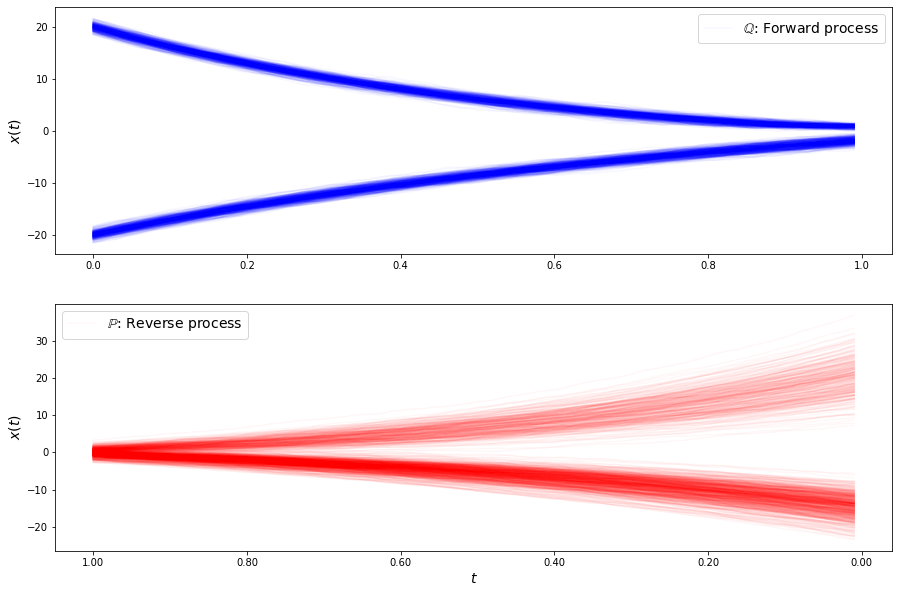

loss b 12.344830175945313
loss b 11.310026035290544
loss b 12.518246927198144
loss b 12.438057895637092
loss b 12.38816809929722
loss b 12.713401165029435
loss b 12.548637731038493
loss b 12.032896451311831
loss b 12.318848540574855
loss b 12.303997831134724
loss b 12.743985993283292
loss b 12.068963973416102
loss b 12.495967420972157
loss b 12.668876961629742
loss b 12.702298017704328
loss b 12.42442743502483
loss b 13.500327945015828
loss b 12.405489848524029
loss b 12.065127627759834
loss b 12.369315462485778
loss b 11.71717996683199
loss b 12.10266373982778
loss b 12.379638415799297
loss b 12.303857623871027
loss b 12.672167709219782
loss b 12.447347559321978
loss b 12.534371932563085
loss b 12.405270304770719
loss b 12.18774476512075
loss b 12.156050148255941
loss f 3.8615329820712825
loss f 3.7767172087391323
loss f 3.867992312969121
loss f 3.846576348239899
loss f 3.9230375442974146
loss f 3.8458767191070895
loss f 3.922601164620873
loss f 3.8332082247280863
loss f 3.76500697360

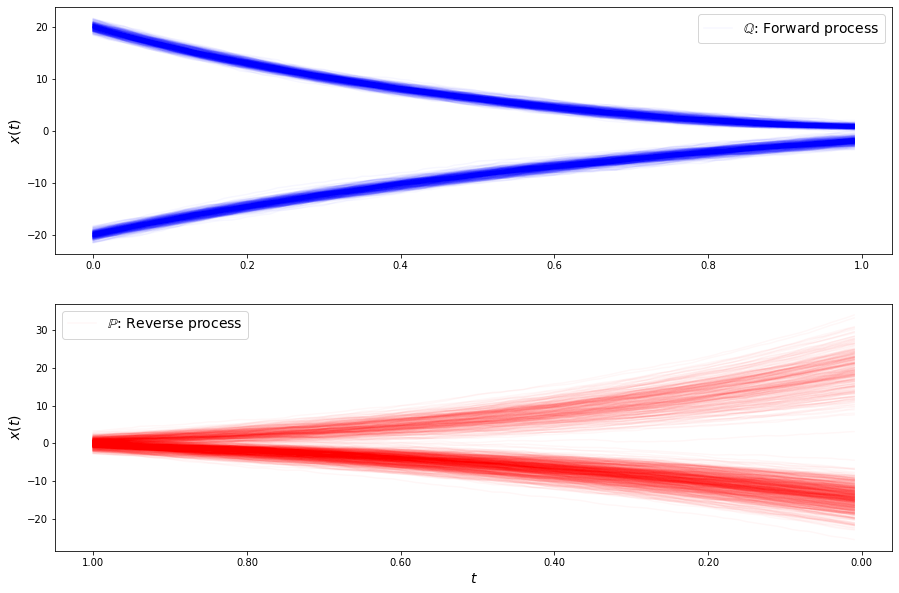

loss b 12.1496534392988
loss b 12.40835348851389
loss b 12.774548420279526
loss b 12.283596039481365
loss b 11.892178586254483
loss b 11.870624352186761
loss b 12.382468417003533
loss b 11.960711910362269
loss b 12.31150399729299
loss b 12.209950811567593
loss b 12.380571798129461
loss b 12.071267421850807
loss b 12.635019555593104
loss b 12.34763435044448
loss b 12.917921078237734
loss b 12.092573724768371
loss b 12.413383658677557
loss b 12.090008500806423
loss b 12.179668048170003
loss b 12.366524538865841
loss b 11.952454054041954
loss b 12.249090360971326
loss b 11.963508767693472
loss b 12.719297551248669
loss b 11.899121191566069
loss b 12.467026299489312
loss b 12.156409488652558
loss f 3.7892473474418735
loss f 3.7092536634509656
loss f 3.878789213969928
loss f 3.842009173553669
loss f 3.9272270440934034
loss f 3.7456346881234586
loss f 3.7908342240434756
loss f 3.8061838453145334
loss f 3.9021668953821766
loss f 3.8745140550988864
loss f 3.7882399320881692
loss f 3.7740839914

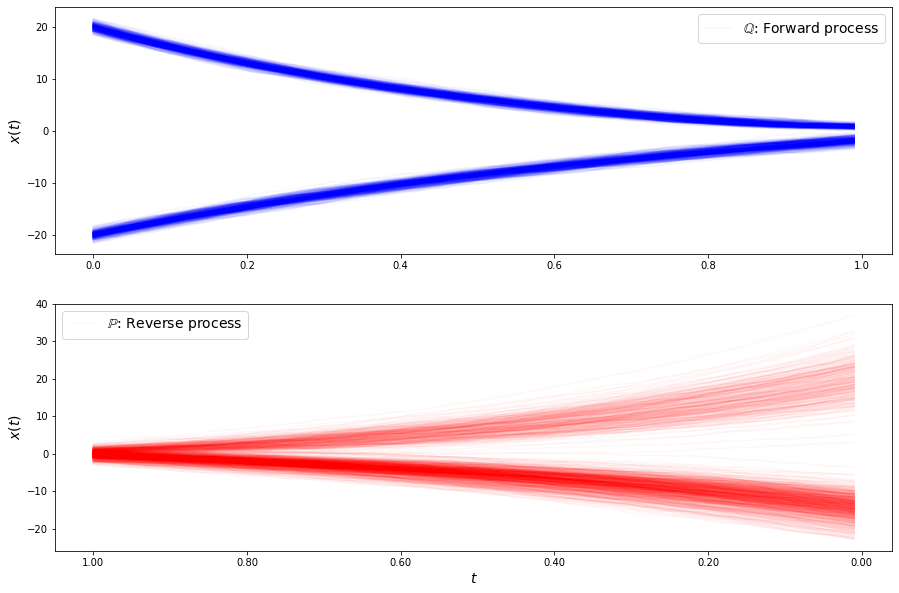

loss b 12.616189498125014
loss b 12.190677924796793
loss b 12.166109345892584
loss b 12.411739815321782
loss b 12.008647540469216
loss b 11.986884117564891
loss b 11.573833179287362
loss b 12.033928133127628
loss b 11.605631300821877
loss b 12.31503215034821
loss b 12.713087559746574
loss b 12.598513676387343
loss b 12.04533680656414
loss b 12.49451763049926
loss b 12.265220148911327
loss b 12.455179653855359
loss b 12.224810874224003
loss b 11.923781096881493
loss b 12.174325437727054
loss b 12.158522390699229
loss b 11.850280632452105
loss b 12.374122310099363
loss b 11.836353001265929
loss b 11.553410606855106
loss b 12.558485600873892
loss b 12.03086600015869
loss b 11.825280983554508
loss b 11.964639032412078
loss b 11.757298105468868
loss b 11.71576243135731
loss f 3.6984574686407696
loss f 3.793815712927007
loss f 3.8344612002010634
loss f 3.762655690550629
loss f 3.770034887790348
loss f 3.7683325962776055
loss f 3.7607598998654574
loss f 3.8091819639673257
loss f 3.90077674062

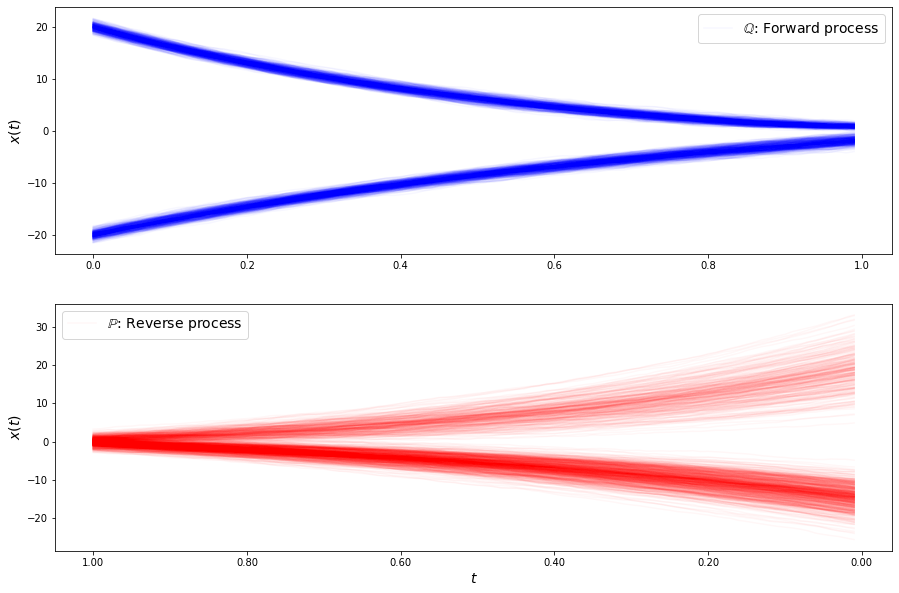

loss b 12.078020510554731
loss b 12.299418677960315
loss b 11.586160096836581
loss b 12.045552429554702
loss b 12.370760659384642
loss b 12.138336009897346
loss b 12.548860041010927
loss b 11.653784821024528
loss b 12.10189768950638
loss b 12.041584173948506
loss b 12.019387048095501
loss b 11.958845050012975
loss b 12.541579487799087
loss b 12.284150069155757
loss b 12.209388811087637
loss b 11.478251468385668
loss b 11.96840189246019
loss b 11.488281713013956
loss b 11.502662534573357
loss b 12.675295539687834
loss b 12.074913234680327
loss b 12.415824907891688
loss b 11.763759270168965
loss b 11.817218431689088
loss b 11.928444772146287
loss b 11.543187593584895
loss b 12.22188115664258
loss b 11.899533175697757
loss b 11.708197065713367
loss b 12.202031231855628
loss f 3.8398740355858596
loss f 3.7305690714181323
loss f 3.7486933606017128
loss f 3.7572749131176266
loss f 3.7958388862587005
loss f 3.7845199430875804
loss f 3.819611274757068
loss f 3.7800599602783156
loss f 3.8086068

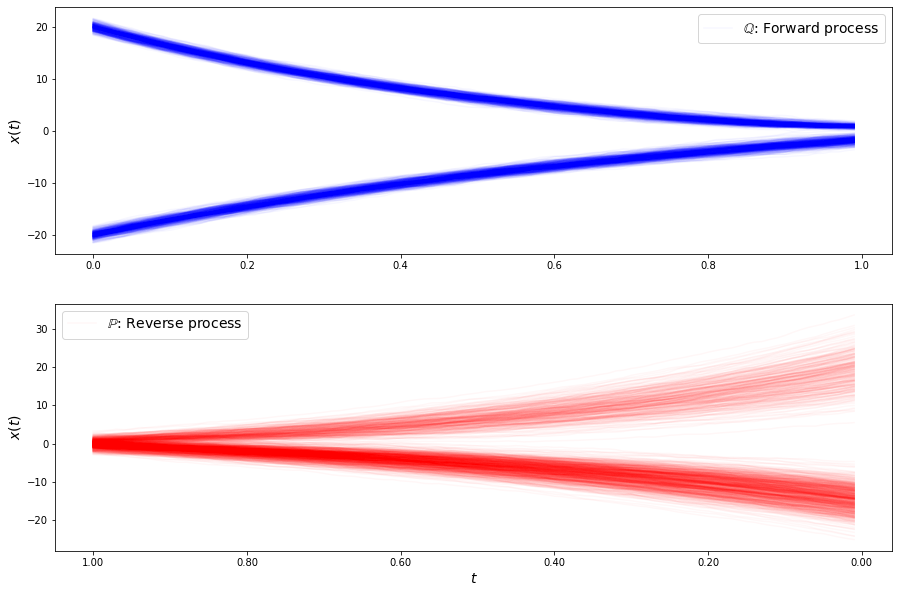

loss b 12.219067647313642
loss b 12.063060946483414
loss b 11.076399913852164
loss b 12.224045125380577
loss b 11.646482182944705
loss b 12.001886345634942
loss b 11.765974805611524
loss b 11.912264147206855
loss b 11.936978765684898
loss b 11.847862956530578
loss b 12.034894075177872
loss b 11.764350635048917
loss b 11.674300630383703
loss b 11.645003085538095
loss b 11.702127448959605
loss b 12.68022904894685
loss b 11.93447296153522
loss b 11.98386904198247
loss b 12.005679952445961
loss b 10.97933564878294
loss b 12.011406230123786
loss b 11.459069160409927
loss b 12.149473772362647
loss b 11.827432143216623
loss b 12.560658034109334
loss b 11.798697118874658
loss b 12.312522535691773
loss b 12.328478487542952
loss b 11.861024926324893
loss b 11.854095361193965
loss f 3.6901988147791425
loss f 3.715679813229781
loss f 3.668585222708582
loss f 3.6868774249585154
loss f 3.7397170879197175
loss f 3.656312686477281
loss f 3.715140498832676
loss f 3.7047251586788468
loss f 3.73435006440

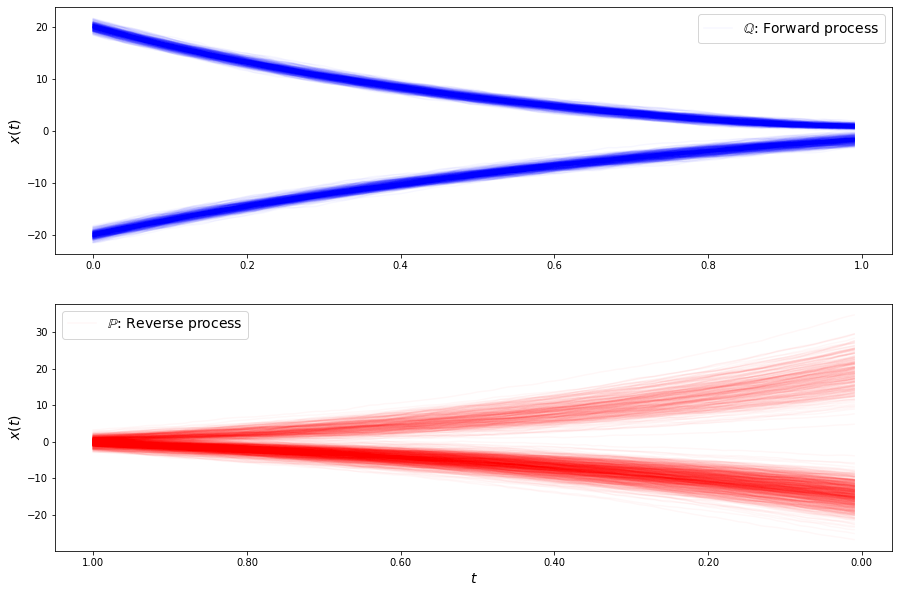

loss b 11.928345114683854
loss b 11.762295819218517
loss b 11.480447551426439
loss b 11.852731256665487
loss b 11.912553922878741
loss b 10.79148450213831
loss b 11.603122353298986
loss b 11.76852263364565
loss b 11.529884952973513
loss b 11.441994452226002
loss b 11.552706086472284
loss b 12.10020740714375
loss b 11.605534720944863
loss b 11.699723731581003
loss b 11.66715886471362
loss b 11.736574001216978
loss b 11.751235165409067
loss b 12.0348048692029
loss b 11.210343816550328
loss b 11.451455361825007
loss b 11.620785229679468
loss b 11.627911263670022
loss b 11.508697620853292
loss b 11.708323805918376
loss b 11.672936454144343
loss b 12.429539990199272
loss b 11.177477703702412
loss b 11.635880776934716
loss b 11.716446259623558
loss b 12.006634683833305
loss f 3.654590496333142
loss f 3.5698905510254404
loss f 3.602325856248802
loss f 3.6732813429567615
loss f 3.6259258358182094
loss f 3.6482857598199496
loss f 3.6398102970329504
loss f 3.5825348252286418
loss f 3.65482372169

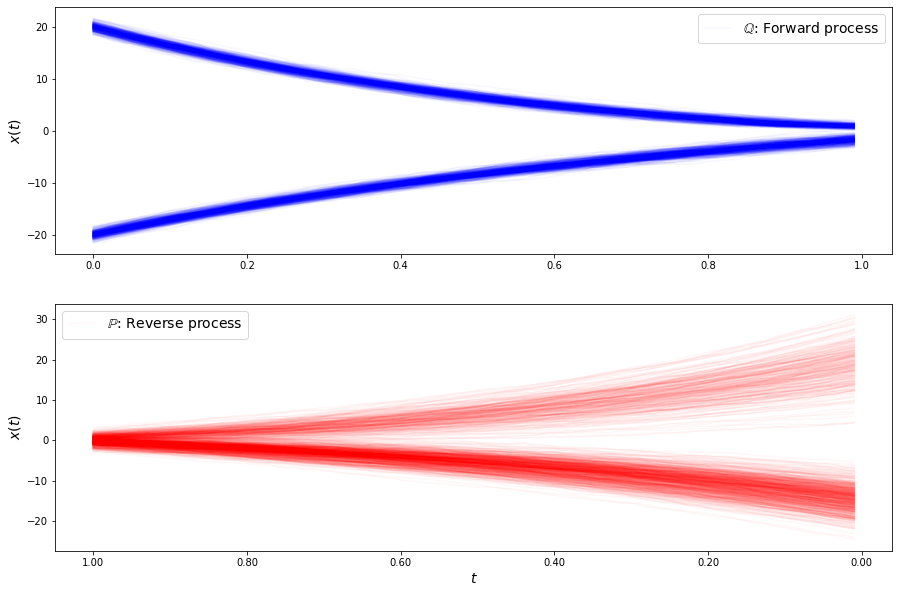

loss b 11.254116598004515
loss b 11.429756171193729
loss b 11.580235830651796
loss b 11.32267014937167
loss b 11.71664092896269
loss b 11.680910337302373
loss b 11.287577323337269
loss b 11.13760919386691
loss b 11.96438401706434
loss b 11.613643567262963
loss b 11.798387247180115
loss b 11.80168739218229
loss b 11.302200063467785
loss b 11.640993564562903
loss b 11.762345511682
loss b 11.40887480197381
loss b 11.973523085378854
loss b 11.669840263659227
loss b 10.857873534358736
loss b 11.731882369908309
loss b 11.576386212268867
loss b 11.478410291782573
loss b 11.741651347936424
loss b 11.655016193434573
loss b 11.389731561588134
loss b 11.40615071038262
loss b 11.36506336088121
loss b 11.253398820447684
loss b 11.941427016762681
loss b 11.665400941375998
loss f 3.566426680652069
loss f 3.5017027727991175
loss f 3.5254847117789656
loss f 3.5702827654635585
loss f 3.507610522330679
loss f 3.546085182739944
loss f 3.5136274518137913
loss f 3.5753957286673845
loss f 3.5343629602857005


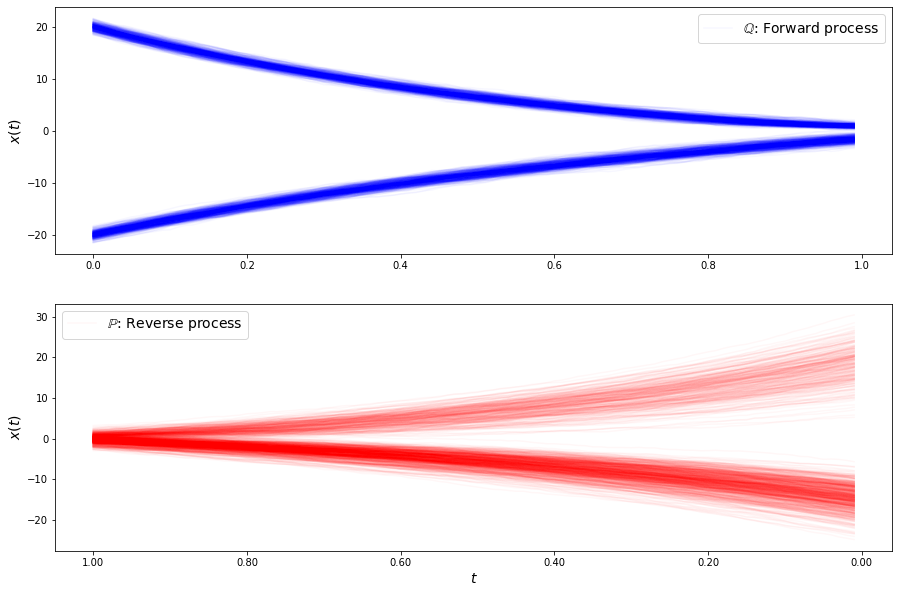

loss b 11.42710223237789
loss b 11.280952151481863
loss b 11.536370630960574
loss b 11.529217004039467
loss b 11.095073994487846
loss b 11.400014115590793
loss b 10.994665307364045
loss b 11.34481734630276
loss b 11.875805406686009
loss b 11.294097260950773
loss b 11.19639724175999
loss b 11.317383481435607
loss b 11.4613466981504
loss b 10.842190388819345
loss b 11.386944528016219
loss b 11.109851217962298
loss b 11.35979086011002
loss b 11.41374072708497
loss b 11.698287565663255
loss b 11.033763907417732
loss b 11.244766883286264
loss b 11.477245063926507
loss b 11.152094702605625
loss b 11.745250756270597
loss b 11.657865801682032
loss b 11.968241234034942
loss b 11.218802571165813
loss b 10.918347078667543
loss b 11.07020529313566
loss b 11.120155439823503
loss f 3.571784253743589
loss f 3.4178536632841596
loss f 3.5169992816911204
loss f 3.5620313518517794
loss f 3.5167397205364486
loss f 3.5478924566920846
loss f 3.5026491806241253
loss f 3.563119842122536
loss f 3.4444552682013

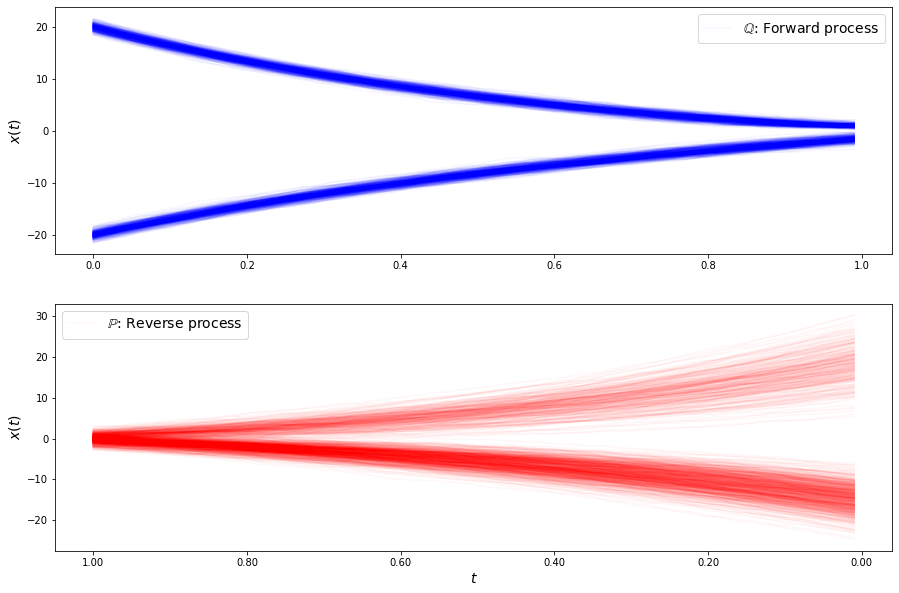

loss b 11.041633710523998
loss b 11.071979901344966
loss b 11.544973295673385
loss b 10.906118386140262
loss b 11.743168431975223
loss b 10.94757855010058
loss b 11.079706352452716
loss b 10.977600144441633
loss b 11.600559106564369
loss b 11.048743948175717
loss b 11.458942533422942
loss b 11.111683659510197
loss b 10.944653931282843
loss b 10.795187223321788
loss b 10.975071156132515
loss b 11.162114599399743
loss b 10.65067415766737
loss b 11.22359973714096
loss b 11.042470634519658
loss b 11.217826420067722
loss b 11.460813757841542
loss b 11.151756271470639
loss b 11.703128634155219
loss f 3.3382968647335267
loss f 3.2797997234022516
loss f 3.348493477467915
loss f 3.343945993903114
loss f 3.343561195096088
loss f 3.312222239260132
loss f 3.3546821478969546
loss f 3.3175003186385923
loss f 3.270318958414509
loss f 3.298650690010075
loss f 3.367513608023258
loss f 3.330631363774033
loss f 3.267832870760602
loss f 3.2740779410769694
loss f 3.2982734196040076
loss f 3.285838943749963

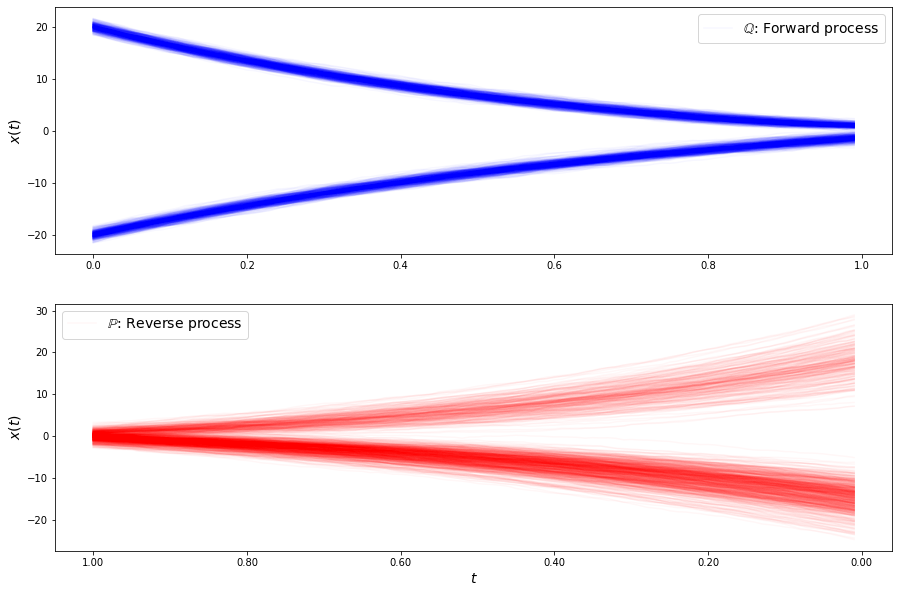

loss b 10.655431660494123
loss b 10.779533176091617
loss b 11.218519278835958
loss b 11.075958803673416
loss b 10.684525805359048
loss b 11.305093231228629
loss b 10.7769857343425
loss b 10.373110347933821
loss b 11.30162484879639
loss b 10.723461457608334
loss b 11.261101293658776
loss b 10.996512411596031
loss b 11.322152808916123
loss b 10.95178754628973
loss b 10.829453720886876
loss b 11.014305795493302
loss b 10.561505164850331
loss b 11.157755547934356
loss b 10.792949578193715
loss b 11.234114191556005
loss b 10.637171694319116
loss b 10.382122009902604
loss b 11.349165848776748
loss b 11.09185948256501
loss b 10.706521966961475
loss b 11.362745009973114
loss b 11.07578405585642
loss b 10.786940053929122
loss b 11.206006223690752
loss b 10.683134990911578
loss f 3.333652276686442
loss f 3.2999405949239895
loss f 3.264614900809395
loss f 3.3181364019760027
loss f 3.2644758598536545
loss f 3.2760608187879967
loss f 3.254807536667294
loss f 3.279640724759797
loss f 3.2238061755333

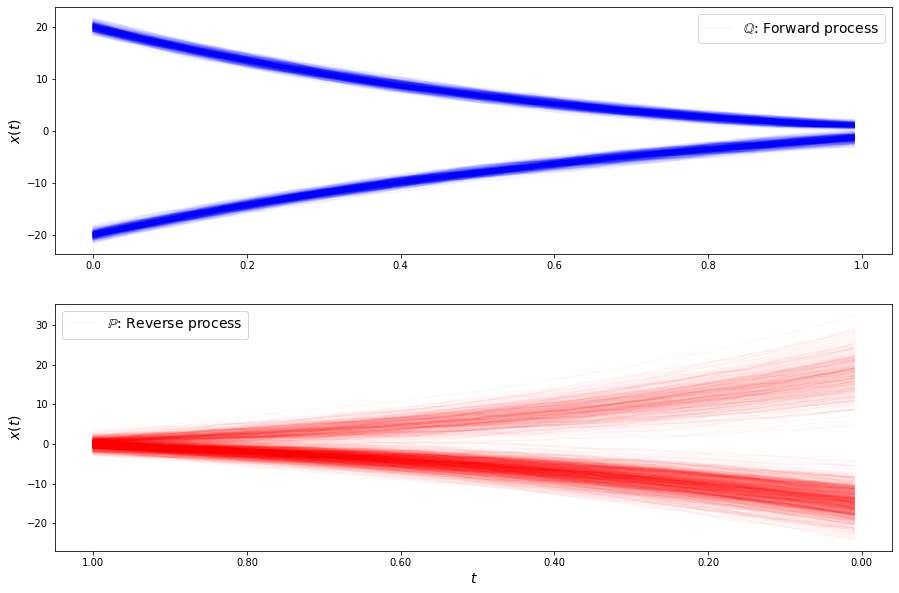

loss b 10.813961400880007
loss b 10.712613388578896
loss b 10.822646143947038
loss b 11.022263820103001
loss b 10.62306646232789
loss b 10.560496989768756
loss b 10.671319979202977
loss b 10.592427840009668
loss b 10.967246998882386
loss b 11.073806529993261
loss b 11.05041092019197
loss b 10.455676127305965
loss b 11.239226585637976
loss b 10.644867179389447
loss b 10.500449715938794
loss b 10.655103579267367
loss b 10.652796831881401
loss b 10.845794752977714
loss b 10.77319295468835
loss b 10.62297154541335
loss b 10.734256506994992
loss b 11.179624198541495
loss b 10.995987225079029
loss b 10.129038894687737
loss b 10.827118364500263
loss b 11.425157476615832
loss b 10.949161630500367
loss b 10.963709397393941
loss b 10.508206497243147
loss b 10.778995782616368
loss f 3.2389453997485704
loss f 3.186933575016652
loss f 3.200174031241722
loss f 3.1445954690983067
loss f 3.2516942087742073
loss f 3.260242107213297
loss f 3.174916309242477
loss f 3.2555854719095376
loss f 3.25720654958

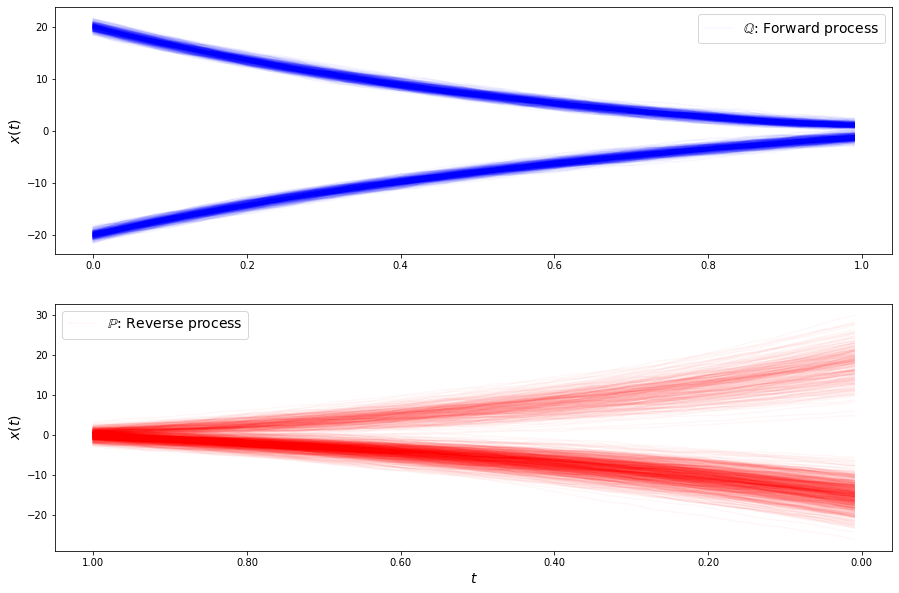

loss b 10.890141693249378
loss b 11.50949352908316
loss b 11.02976104608755
loss b 10.181436757685663
loss b 11.162379746368343
loss b 10.983765007833881
loss b 11.038780843518483
loss b 10.88588561507708
loss b 10.783434273752468
loss b 10.942322577192733
loss b 10.697004688003089
loss b 11.12071509137428
loss b 10.409316645985234
loss b 10.812426454665406
loss b 10.780371574541102
loss b 10.827182954560861
loss b 10.322010029525144
loss b 10.778738090953384
loss b 10.533603558252691
loss b 10.759820357874483
loss b 10.51949607364685
loss b 10.435682550290691
loss b 10.044965064936617
loss b 10.436729941820175
loss b 10.663936812948185
loss b 10.295727698948758
loss b 10.293091346600702
loss b 10.651924614853607
loss b 10.120881658273335
loss b 10.419061453663574
loss f 3.2267290965607134
loss f 3.1979713890494676
loss f 3.185202972355774
loss f 3.1671603289717396
loss f 3.1365811648111284
loss f 3.1927755311565704
loss f 3.196394930636584
loss f 3.194958749010703
loss f 3.15750134814

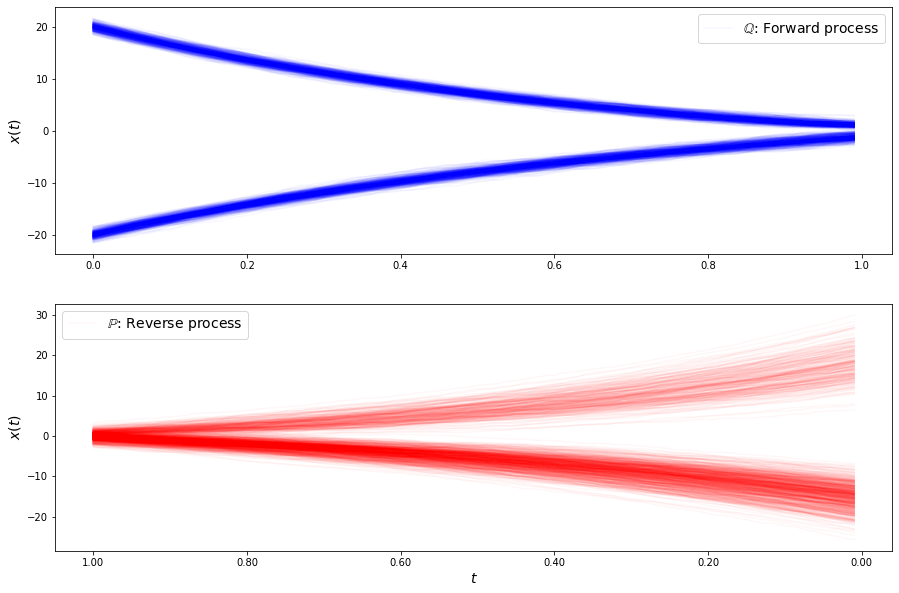

loss b 10.916760505728664
loss b 10.68516654374615
loss b 11.096642251839459
loss b 10.214190680354305
loss b 10.81716236702392
loss b 10.40325110403729
loss b 10.480344342985942
loss b 10.427167658909296
loss b 10.417479919028864
loss b 10.271935321427472
loss b 10.609147015947672
loss b 10.299668456152517
loss b 10.77954368829251
loss b 10.420188824417263
loss b 10.821554284257113
loss b 10.566656585005129
loss b 10.393324281197394
loss b 10.624850712628136
loss b 10.300758535641627
loss b 10.680846746799817
loss b 9.973633557539166
loss b 10.009564079004077
loss b 10.334113092833821
loss b 10.383937551457736
loss b 10.385819453129034
loss b 10.118065549598207
loss b 10.018955694809222
loss b 10.177667285871715
loss b 10.155199055822623
loss b 10.289701359231328
loss f 3.1041270893215147
loss f 3.169438434396978
loss f 3.135453450466692
loss f 3.1633502473657096
loss f 3.1469791003376937
loss f 3.0811137243018827
loss f 3.1362385257250036
loss f 3.144378795282567
loss f 3.23566200000

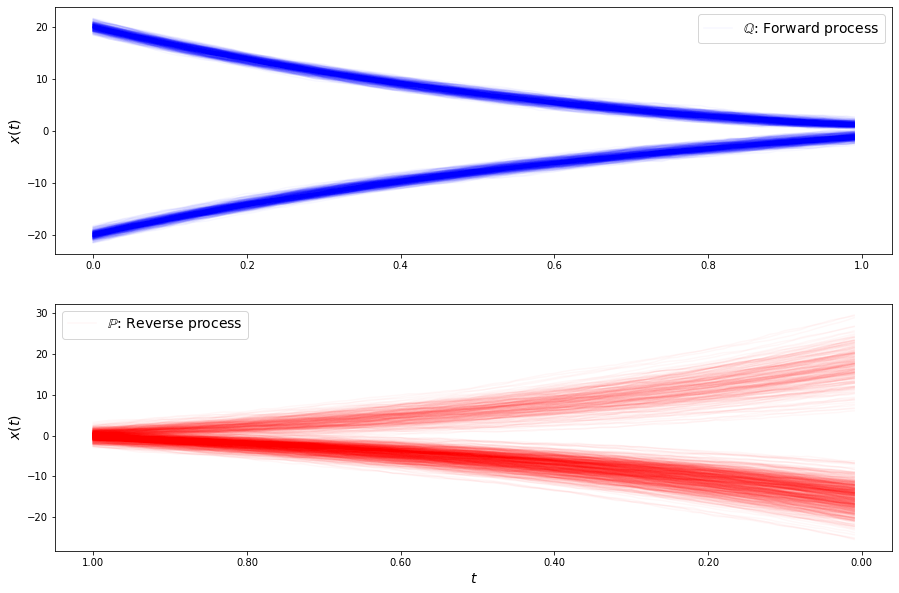

loss b 10.287460976559519
loss b 9.926316064273696
loss b 10.519775134781892
loss b 10.734914555976541
loss b 10.18656621316628
loss b 10.24910376741739
loss b 10.298797024997901
loss b 10.04118197210977
loss b 10.59863319958047
loss b 10.132814212098635
loss b 10.483864258364717
loss b 10.35305303432332
loss b 10.262369883617382
loss b 10.079117512549056
loss b 9.93626501596535
loss b 9.97984600682753
loss b 10.267474838418782
loss b 10.67324930355296
loss b 9.75815709503386
loss b 9.866895715799602
loss b 10.101189980335965
loss b 10.300115201090058
loss b 10.489647078539445
loss b 10.269732313056132
loss b 10.40909508661244
loss b 10.06978585869486
loss b 9.98798258086785
loss b 10.19131587476748
loss b 10.151518962989643
loss b 10.556828486298384
loss f 3.1533430004200045
loss f 3.1008869008173
loss f 3.1204174028755056
loss f 3.0810916024418944
loss f 3.1257664417257156
loss f 3.145952978240064
loss f 3.1283980157618156
loss f 3.153699838902483
loss f 3.181623038045765
loss f 3.15

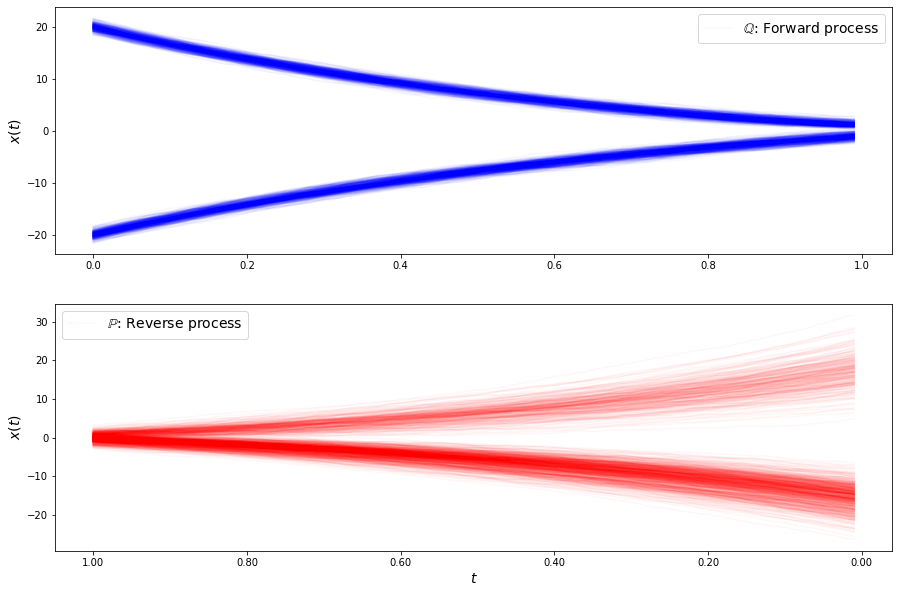

loss b 10.645625594239394
loss b 10.154720279350055
loss b 10.089131122911132
loss b 10.033068833948002
loss b 10.034022599205453
loss b 10.412240611499849
loss b 10.387576822165165
loss b 9.902263542510411
loss b 9.95316369003851
loss b 10.247648351781246
loss b 10.20225611253636
loss b 10.656730456207963
loss b 10.161039150298445
loss b 10.191829663953042
loss b 10.148432552724277
loss b 10.170789432234251
loss b 9.703435029260115
loss b 10.283832950916025
loss b 10.242121289792923
loss b 10.150408972282131
loss b 9.889921903361705
loss b 9.78480202559786
loss b 9.893140976591162
loss b 9.74100088056158
loss b 10.674247068044673
loss b 9.584053232405234
loss b 9.920200482388674
loss b 10.109307070662066
loss b 9.884720491177243
loss b 10.782389140232567
loss f 3.1289674671362646
loss f 3.184025747350529
loss f 3.1227252440822624
loss f 3.0553109594419414
loss f 3.173009008660387
loss f 3.1853933825431637
loss f 3.167577797048094
loss f 3.0487861377655796
loss f 3.1400675121120116
los

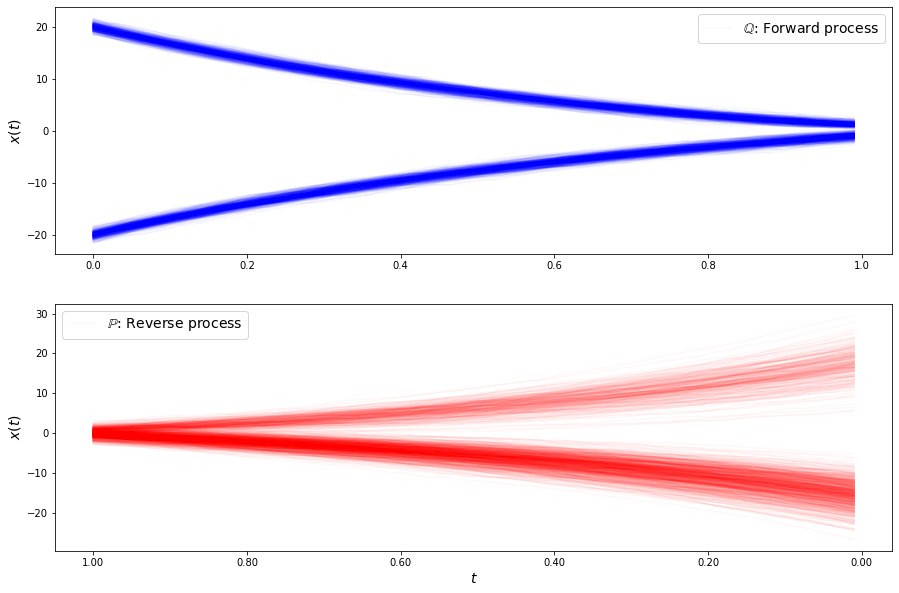

loss b 10.60313664355256
loss b 9.956565758597879
loss b 9.97869894207293
loss b 10.137696552353711
loss b 10.006908298870451
loss b 10.348873732168641
loss b 10.181282569238391
loss b 9.731688172217607
loss b 9.919039560457124
loss b 10.1416994778098
loss b 10.033743466669767
loss b 9.902550716061077
loss b 9.94053650702578
loss b 9.784462802889605
loss b 9.809799346747365
loss b 9.864042506764578
loss b 9.67199142462673
loss b 9.871867821623708
loss b 9.877703051993128
loss b 9.999626945524
loss b 9.968318855899225
loss b 9.76553942130604
loss b 9.95231183921947
loss b 9.811438152415295
loss b 9.696399428222453
loss b 9.891717150114301
loss b 10.006642504365955
loss b 9.451575239057162
loss b 9.949443199698266
loss b 9.64429913218417
loss f 3.136093587393204
loss f 3.084585923202837
loss f 3.0254151732596974
loss f 3.1364739817924225
loss f 3.141102527779689
loss f 3.12591759596817
loss f 3.147906960470082
loss f 3.200834503271325
loss f 3.130740929214391
loss f 3.1583522240145006
lo

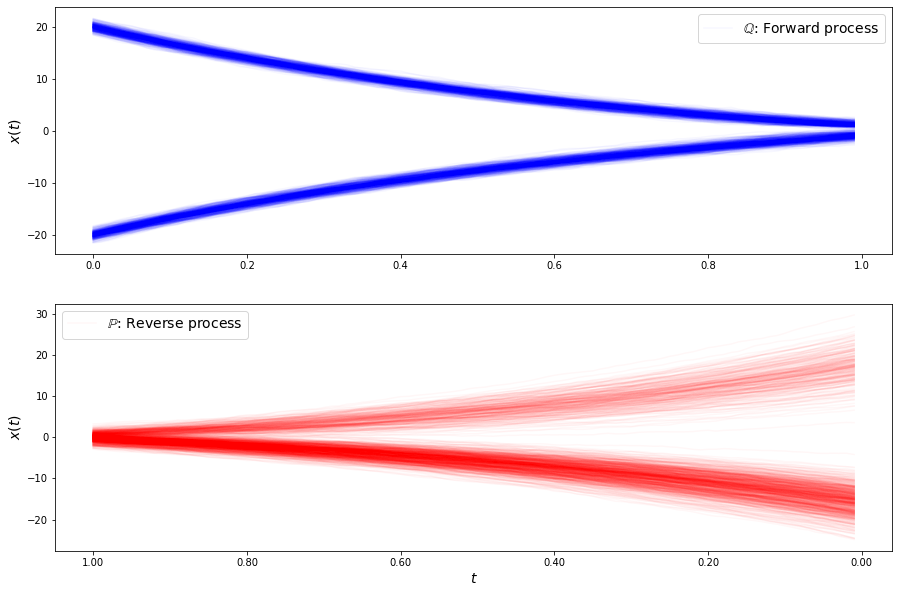

loss b 10.2157387519217
loss b 10.119083158591156
loss b 9.581023032128723
loss b 10.144469904850594
loss b 9.930535641520526
loss b 10.0059021219444
loss b 9.353503774967356
loss b 9.724787232112764
loss b 9.774740819361343
loss b 9.782743923215184
loss b 9.97418890636445
loss b 9.748499359657346
loss b 9.798647591944214
loss b 9.732157404839844
loss b 9.825720326423118
loss b 10.38516037363109
loss b 9.698308786146697
loss b 9.551683686811012
loss b 10.50691647576895
loss b 9.802266651492054
loss b 9.746852657080812
loss b 9.78067637067339
loss b 9.546567346478023
loss b 9.761785814627341
loss b 9.662199817784565
loss b 9.921471113560902
loss b 9.344296477390705
loss b 9.592254934442048
loss b 9.338001951266449
loss b 10.004417148610148
loss f 3.0897535316936033
loss f 3.1468854732813063
loss f 3.131843953911207
loss f 3.204781769268879
loss f 3.1502198337179252
loss f 3.1623429249625845
loss f 3.1270021831935626
loss f 3.204590228121461
loss f 3.1506628329756428
loss f 3.13156042680

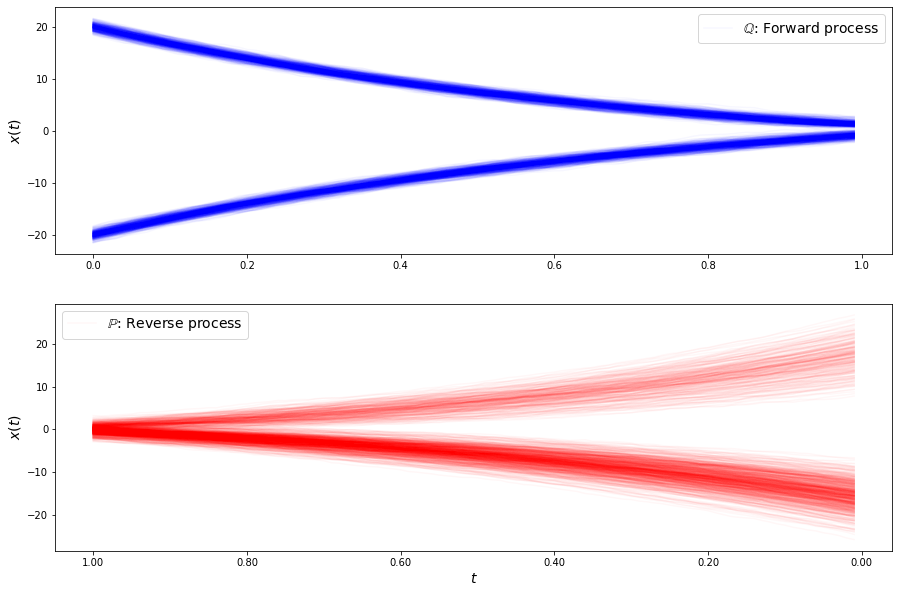

loss b 9.607382273049904
loss b 9.93504859750867
loss b 10.082298816990097
loss b 9.789638497880182
loss b 9.797102174581482
loss b 9.247329232699544
loss b 9.765615186868875
loss b 9.850192458740555
loss b 9.844948066392213
loss b 10.127315361758853
loss b 9.552662512761925
loss b 9.308191296792744
loss b 9.777609053092386
loss b 9.58029083905151
loss b 9.688985835343098
loss b 10.045201545823126
loss b 9.462759335802476
loss b 9.492549847992354
loss b 9.927016782069254
loss b 9.631934340618512
loss b 9.455002916570644
loss b 9.038839388209423
loss b 9.997350796340207
loss b 9.359022481243693
loss b 9.070573536550809
loss b 9.149677798085987
loss b 9.718437375235885
loss b 9.435835850072335
loss b 9.089558546386064
loss b 9.901725361366324
loss f 3.107069119697479
loss f 3.0969595227411935
loss f 3.1588808424340264
loss f 3.145909769376089
loss f 3.183768315808515
loss f 3.1217921089875547
loss f 3.1355975201394006
loss f 3.1543873187343934
loss f 3.1404279039869913
loss f 3.099510665

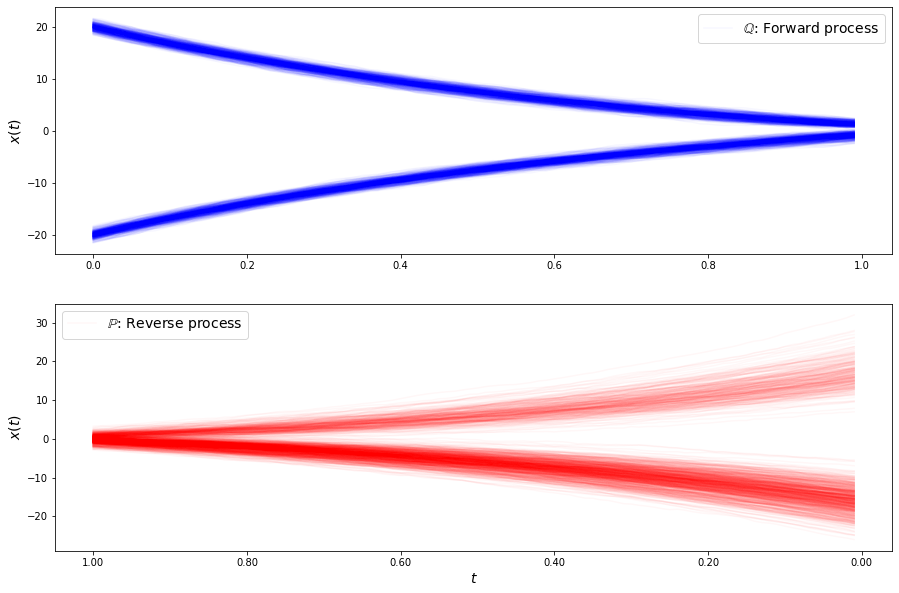

loss b 9.609002463181762
loss b 9.664705055436999
loss b 9.481354702722653
loss b 9.484712854010764
loss b 9.602907576604117
loss b 9.607524962524646
loss b 9.656780402578415
loss b 9.523612658521248
loss b 9.207927553239998
loss b 9.510211721755429
loss b 9.13277011558146
loss b 9.036943656315369
loss b 9.346070365518965
loss b 9.23587595490928
loss b 8.982149957468257
loss b 9.743950931359812
loss b 9.844879522432388
loss b 9.360153848301106
loss b 9.939107147259893
loss b 9.083343751794715
loss b 9.699450933718374
loss b 8.978841260216061
loss b 9.358186814707361
loss b 9.526843595025172
loss b 9.333035650126597
loss b 9.42732038319368
loss b 9.167135055974192
loss b 9.355596750211102
loss b 9.69273173996184
loss b 9.265363629160179
loss f 3.1360081952817778
loss f 3.1202127682134084
loss f 3.1871328138641872
loss f 3.117920896071695
loss f 3.174892150957028
loss f 3.0849284976551177
loss f 3.1496500921949395
loss f 3.0928007016170205
loss f 3.157992219290566
loss f 3.14348533489077

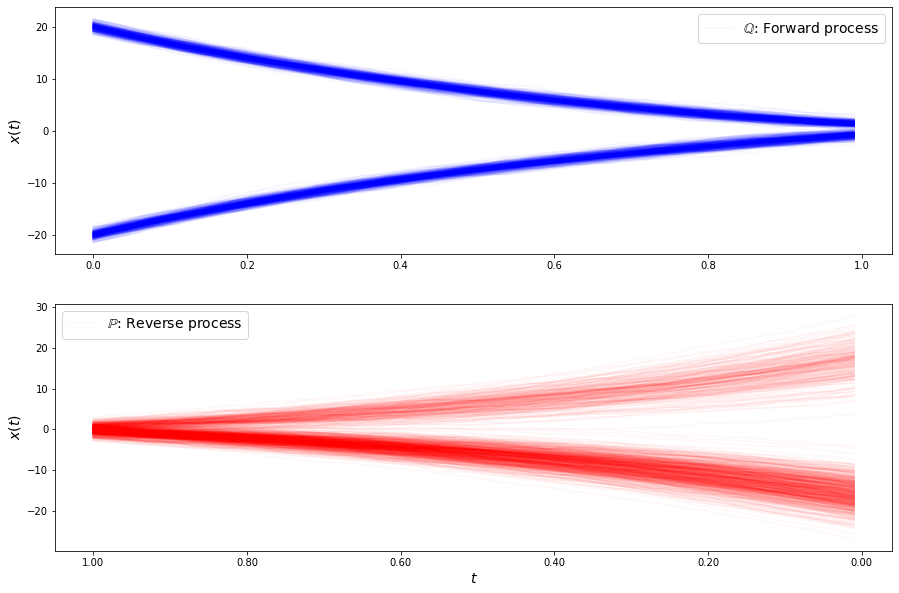

loss b 9.30450916160276
loss b 9.627992486940663
loss b 9.029211866824005
loss b 9.541799497544444
loss b 9.120195530544272
loss b 9.164348148714229
loss b 9.391707342987083
loss b 9.22917605501845
loss b 9.523700629139036
loss b 9.230678678944418
loss b 9.52823896320132
loss b 8.749558018755723
loss b 9.121823469379763
loss b 9.02494102907776
loss b 9.34887648240077
loss b 9.824791376186218
loss b 9.20404262608207
loss b 9.30633398370666
loss b 9.524384962516816
loss b 9.361026249791117
loss b 9.304074916274713
loss b 9.477570121192054
loss b 9.07803510892586
loss b 9.004687717945027
loss b 9.397665382178264
loss b 8.968152757159666
loss b 9.422274510453029
loss b 8.749229182829117
loss b 9.287625729671698
loss b 9.073067051780718
loss f 3.115010944006151
loss f 3.0590011019179917
loss f 3.1445434230301936
loss f 3.096937239878938
loss f 3.0636112597953002
loss f 3.1052441156267685
loss f 3.105236876552112
loss f 3.0559040165227445
loss f 3.1486574878326734
loss f 3.1782557749405833
l

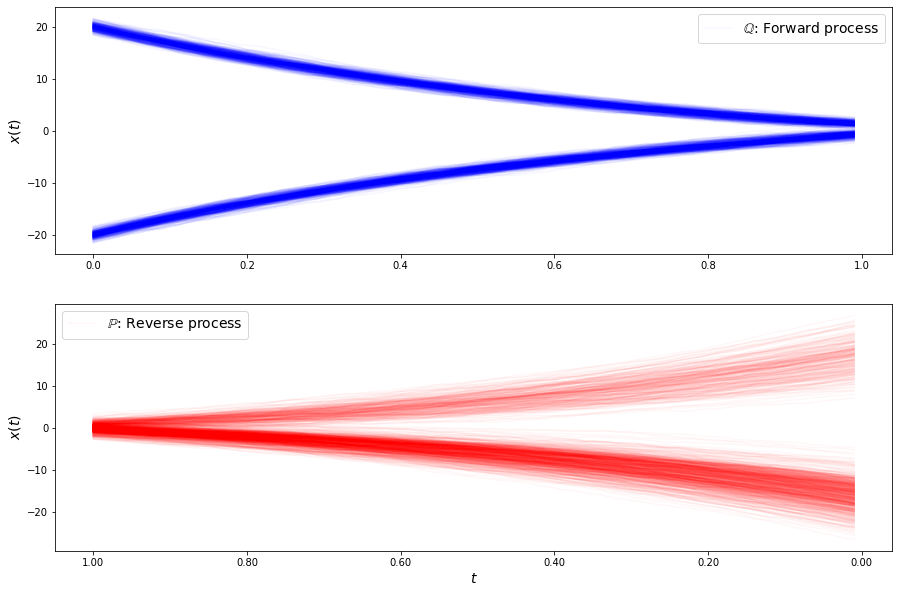

loss b 9.093270413597173
loss b 9.14732146144055
loss b 9.016595894644146
loss b 9.300841257513358
loss b 8.913995161080482
loss b 8.96414688830087
loss b 8.969096114462584
loss b 8.967871910527993
loss b 9.077484055522346
loss b 8.889259711974095
loss b 9.033690100072276
loss b 8.549191323994808
loss b 8.732062665349236
loss b 8.727512769113705
loss b 9.341929397051743
loss b 8.76184166227012
loss b 9.117465142479915
loss b 9.373792774321563
loss b 8.676183231574447
loss b 8.44862291170298
loss b 9.045986593510834
loss b 9.018245225943417
loss b 8.662894609500237
loss b 8.746506359138673
loss b 9.378007771180748
loss b 8.907385249907396
loss b 9.283477230421706
loss b 9.406817878024528
loss b 8.481603667233829
loss b 8.728728448275762
loss f 3.059484428425545
loss f 3.1016878297691
loss f 3.0530872049668543
loss f 3.1211216709058425
loss f 3.1043199068239367
loss f 3.07267943239328
loss f 3.147862147951669
loss f 3.1385420213942434
loss f 3.104543978525535
loss f 3.102051684802344
los

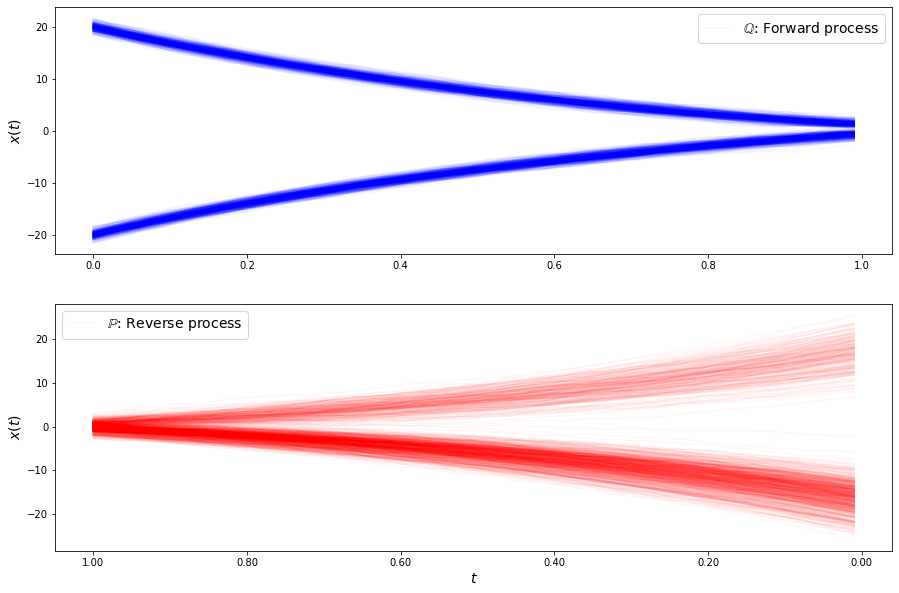

loss b 8.80681907098488
loss b 8.503055167659369
loss b 8.16443113817375
loss b 8.590973564435819
loss b 8.67180441235638
loss b 9.31058555368429
loss b 9.03748865435655
loss b 8.300268324065991
loss b 9.022532998348384
loss b 9.13303507041564
loss b 9.259203664333588
loss b 8.887503179834631
loss b 9.242105156142328
loss b 9.084976418563846
loss b 8.598437672184527
loss b 8.120919217573668
loss b 8.375256842650307
loss b 8.965946943122354
loss b 8.529947369964786
loss b 8.633659705494612
loss b 9.352902396853475
loss b 9.093565745355962
loss b 8.864777590702905
loss b 9.017615382206603
loss b 9.088634595873183
loss b 9.096972842570587
loss b 8.286040243674913
loss b 8.814779719681813
loss b 8.986088471171234
loss b 9.28834732895301
loss f 3.0329408781743012
loss f 3.099170208615845
loss f 3.071912777163942
loss f 3.079995693989267
loss f 3.0633968173185617
loss f 3.0340948279772304
loss f 3.058822286349315
loss f 3.078113065427532
loss f 3.0701656679278586
loss f 3.1880848976699228
lo

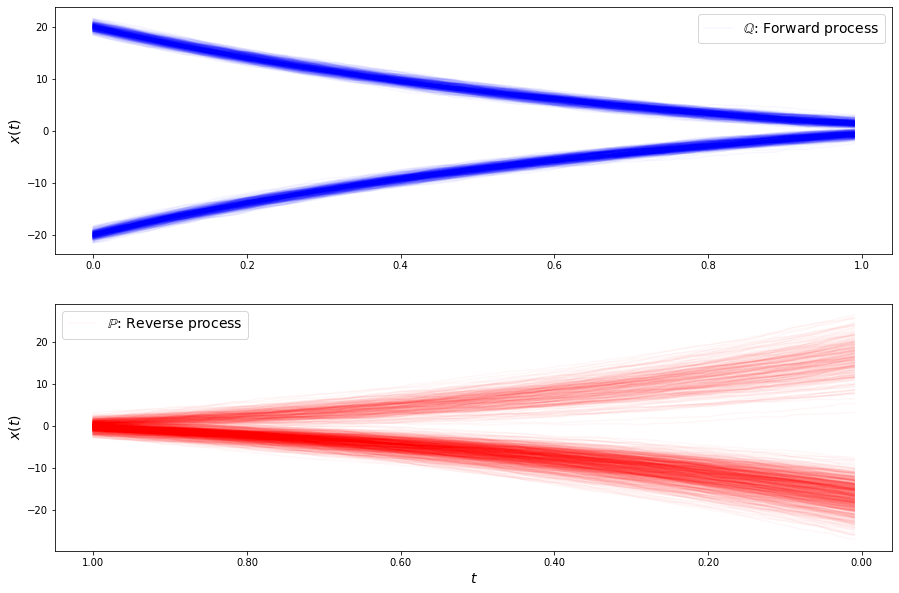

loss b 9.264052272914356
loss b 8.635144575254673
loss b 9.180895980192593
loss b 8.812473610293383
loss b 9.1017426513335
loss b 8.450980455001453
loss b 9.014961668783108
loss b 8.84385894635613
loss b 8.671542521885181
loss b 8.566068754832745
loss b 9.147739957654982
loss b 8.442581410541447
loss b 8.540273341043314
loss b 8.58417467658145
loss b 9.054358495646879
loss b 8.323317795974601
loss b 8.4240218034893
loss b 8.686464943864415
loss b 8.513667590800976
loss b 8.284987637959524
loss b 8.23240879157433
loss b 8.937137042673832
loss b 8.3627739907239
loss b 8.723218858765811
loss b 8.206833909474732
loss b 8.433748505173147
loss b 8.650034388403723
loss b 8.715532136540887
loss b 8.612085146456732
loss b 7.886360269385965
loss f 2.943731646934136
loss f 3.0351159282604074
loss f 3.132578359244529
loss f 3.101022742695681
loss f 2.983028838186115
loss f 2.9953075940043346
loss f 3.0808509414465397
loss f 3.0756174040522226
loss f 3.0662926582242434
loss f 3.0033364362075945
los

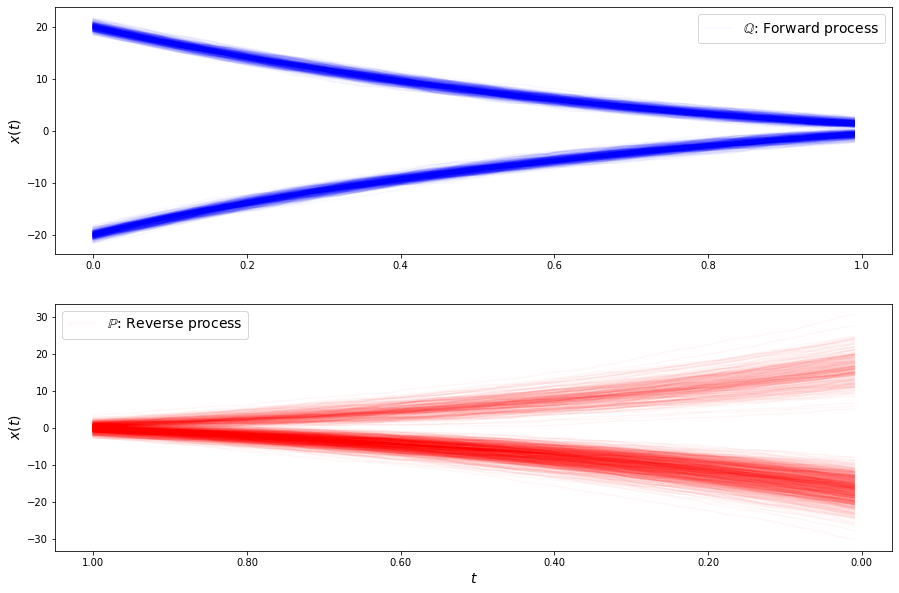

loss b 8.192897299821984
loss b 8.479391808651128
loss b 8.120416114794656
loss b 8.337565914477665
loss b 8.765429960204484
loss b 8.676857240422875
loss b 8.40625540956872
loss b 8.601704371511842
loss b 8.854520791527813
loss b 7.940908128679452
loss b 8.493858393750092
loss b 8.251774886031175
loss b 8.796430208468065
loss b 8.124450877252501
loss b 8.326969842858375
loss b 8.364508380948514
loss b 7.875412671043552
loss b 8.18938657651089
loss b 8.289841404866369
loss b 8.105845355108707
loss b 8.608280270887569
loss b 8.767203495928056
loss b 8.058368603164691
loss b 8.18821469402328
loss b 8.142802600634171
loss b 8.038175112073393
loss b 8.297146219264347
loss b 8.1301715504049
loss b 7.792116733238682
loss b 7.937761603799186
loss f 3.0305918261711438
loss f 3.0736880974526213
loss f 2.970810802004624
loss f 3.0084706293281664
loss f 2.978534100856637
loss f 3.010834625123991
loss f 2.9564481943713097
loss f 3.0402038319825664
loss f 2.949778185322247
loss f 3.0134189523888826

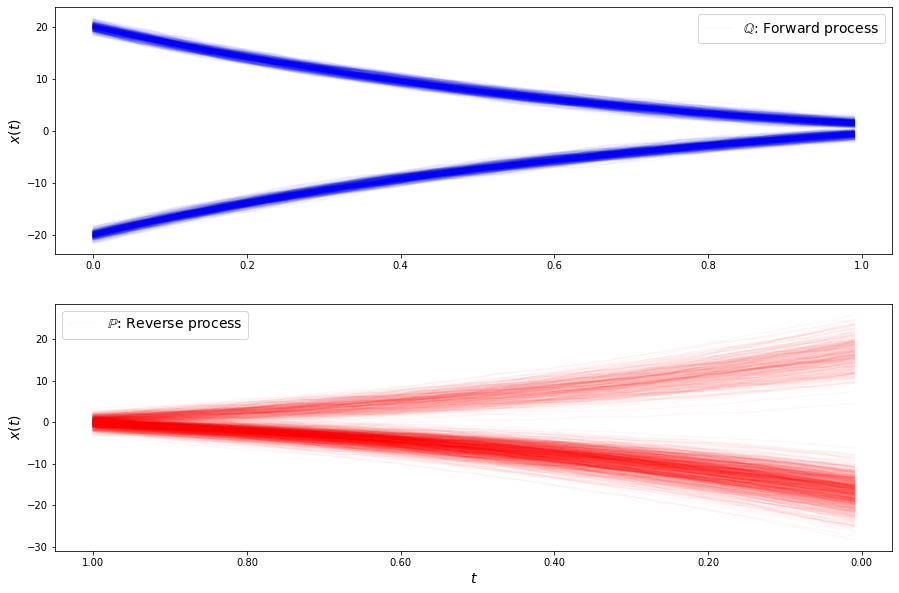

loss b 8.6526191470579
loss b 8.602302503180535
loss b 8.462213649266218
loss b 7.884432044711998
loss b 8.428000062803525
loss b 7.957684751630629
loss b 8.51411113052459
loss b 7.98752896571908
loss b 8.59234951599109
loss b 8.317346913902687
loss b 8.0953330613655
loss b 8.083421494862467
loss b 8.3900593127219
loss b 8.382532304019449
loss b 8.210375940825399
loss b 8.258395679152386
loss b 8.066489923082594
loss b 8.155816291782955
loss b 8.309182860651086
loss b 8.119312837108824
loss b 7.8800020111273925
loss b 7.857297239628559
loss b 8.26668005948942
loss b 7.857311903548918
loss b 7.648065407994689
loss b 8.14770620932737
loss f 3.031253913572964
loss f 2.97160617611781
loss f 3.018095782894967
loss f 3.017354927638794
loss f 2.929352404605968
loss f 2.9636481943559696
loss f 2.9865919771831413
loss f 2.9399300050608326
loss f 2.9263937411479617
loss f 3.015517228972854
loss f 2.9421496372989937
loss f 2.961765901702378
loss f 2.9616328819124864
loss f 2.998622535850927
loss 

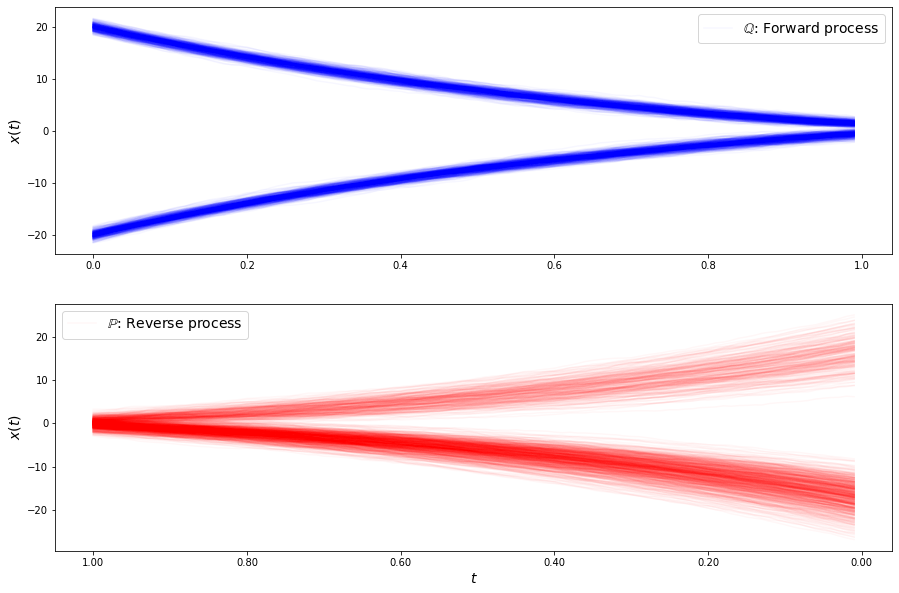

loss b 8.123796619646562
loss b 8.223278191110781
loss b 7.9902697292415406
loss b 8.044573772946945
loss b 7.940195930154837
loss b 7.84608699292686
loss b 7.983145600630032
loss b 7.8583089287474515
loss b 8.446274495112801
loss b 8.170892606406127
loss b 7.932459379009476
loss b 7.723833255056825
loss b 8.193731829396203
loss b 8.386998016461428
loss b 7.8525230940094835
loss b 8.157072202581718
loss b 7.938502193361755
loss b 7.81941313184266
loss b 7.888846730926707
loss b 8.002609915086188
loss b 8.420697088914604
loss b 7.676080012732574
loss b 7.181582388338573
loss b 8.097275166990157
loss b 8.037364572900131
loss b 8.028869376364277
loss b 7.733784755103821
loss b 8.014464317034383
loss b 8.063290938645181
loss b 7.705366825885731
loss f 2.925619225645723
loss f 2.958026878640854
loss f 2.9550017873283276
loss f 2.8965415775043524
loss f 2.9628268085255
loss f 2.860061757942153
loss f 2.983720259381339
loss f 2.9833518312752023
loss f 2.9498695451732426
loss f 2.9210374581208

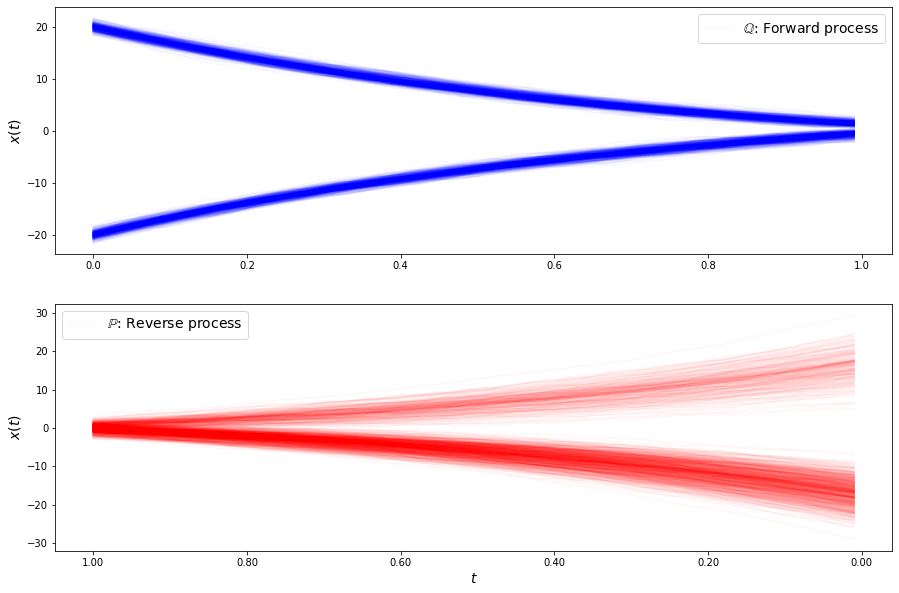

loss b 7.597068675666708
loss b 7.581577556587988
loss b 7.489092207451689
loss b 7.9866943387398015
loss b 7.41869949877128
loss b 7.87776877677801
loss b 7.72217352205921
loss b 7.976335317928104
loss b 7.587098669966869
loss b 7.549291976534827
loss b 7.7329828476323295
loss b 7.598527952740012
loss b 7.774876750983561
loss b 8.0973088654311
loss b 8.014501355694515
loss b 7.544538395117467
loss b 7.880128739458401
loss b 7.572670366157443
loss b 8.085074364955094
loss b 7.565889242119867
loss b 7.555470076251898
loss b 7.7594517006072135
loss b 7.997499551460375
loss b 7.930081344217736
loss b 7.558780438526705
loss b 7.746394614180439
loss b 8.211307152467429
loss b 7.633341781531704
loss b 7.588819128677421
loss b 7.336621055675171
loss f 2.8391085795024225
loss f 2.896992401077672
loss f 2.9234995076635815
loss f 2.8420000958699334
loss f 2.8871852558101168
loss f 2.8323867245163235
loss f 2.935790087275999
loss f 2.9363356543062737
loss f 2.867075565902157
loss f 2.871898156889

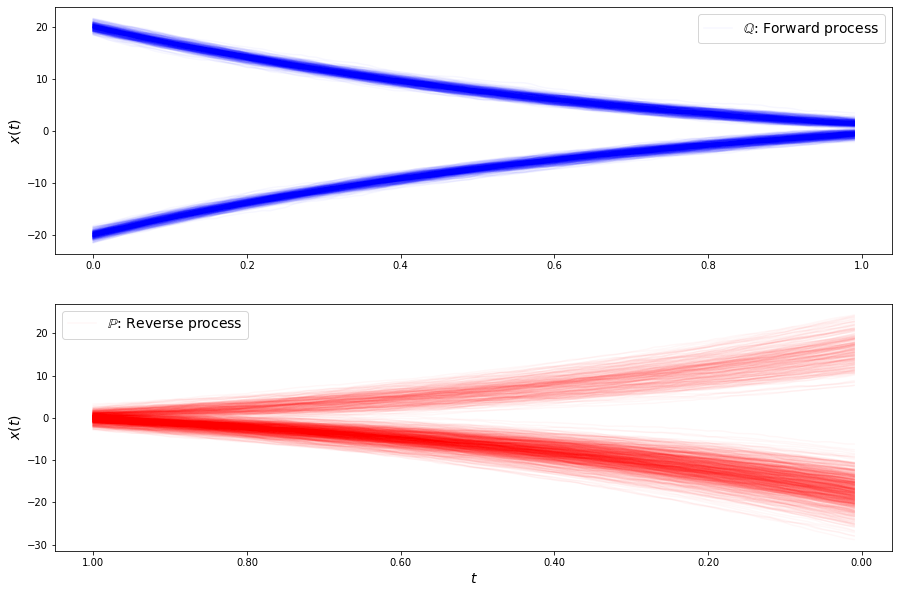

loss b 7.557447166594287
loss b 7.870596196250246
loss b 7.5293160345309404
loss b 7.615788338852541
loss b 7.788353784583144
loss b 7.255580284789044
loss b 7.850587199838887
loss b 7.758372954236027
loss b 7.77889498959259
loss b 7.731304206294012
loss b 7.616473155206281
loss b 7.864898566716875
loss b 7.8050911227938204
loss b 7.760972130541107
loss b 7.487547854102273
loss b 7.789581207634266
loss b 7.383630277071193
loss b 7.625808495173867
loss b 7.078993358856083
loss b 7.2849939384437015
loss b 7.563064943480513
loss b 7.653888007044197
loss b 7.380155822906595
loss b 7.75935872182547
loss b 7.4505475972263016
loss b 7.380218926893202
loss b 7.480065084937635
loss b 7.433336639585695
loss b 7.232678986720728
loss b 7.235329031005547
loss f 2.912827621755235
loss f 2.827519208868704
loss f 2.8407222693178333
loss f 2.8460148943159007
loss f 2.8905155376767384
loss f 2.8464601021550653
loss f 2.8149675668397314
loss f 2.829463571658716
loss f 2.832276850732151
loss f 2.814762369

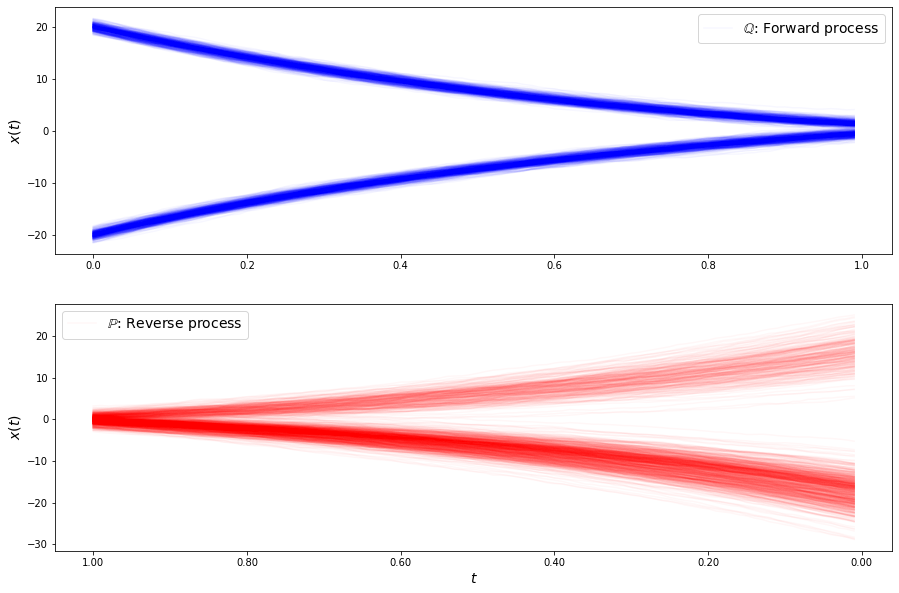

loss b 7.19121166076852
loss b 7.316628301910677
loss b 7.600188803557863
loss b 7.147201503509644
loss b 7.211149165711959
loss b 7.3473775716974545
loss b 7.150497987356503
loss b 7.268849127076388
loss b 7.419222282589411
loss b 7.413570025742823
loss b 7.453485302730554
loss b 7.188626528075641
loss b 7.1232695508821555
loss b 7.4760913173296535
loss b 7.117039810676192
loss b 7.460685622077244
loss b 7.255148395674154
loss b 7.67964586474639
loss b 7.471490887514069
loss b 7.126295726231213
loss b 7.048929229254878
loss b 7.301692687119522
loss b 7.131065494958753
loss b 7.470379587920867
loss b 7.4529926172137015
loss b 7.4175331668726905
loss b 7.367659846977529
loss b 7.425391468440567
loss b 7.284963252695805
loss b 7.568949251875498
loss f 2.798848884222343
loss f 2.8124098618798294
loss f 2.772646241322838
loss f 2.8095240534090435
loss f 2.855571036871052
loss f 2.8072060551878133
loss f 2.8713810944946383
loss f 2.885332053100535
loss f 2.788130295086178
loss f 2.790262933

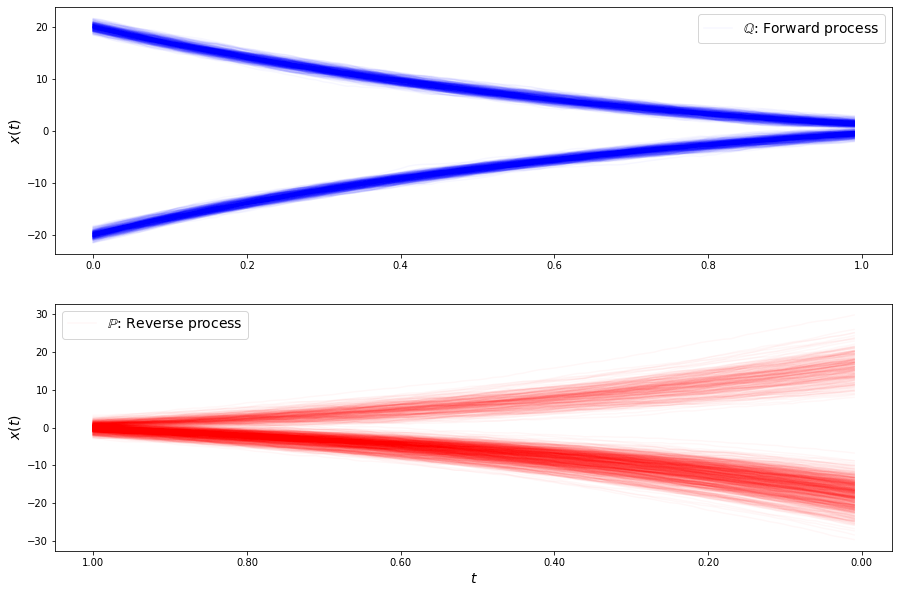

loss b 7.6792819557399
loss b 7.098870010516884
loss b 7.354615025958601
loss b 7.4269218877725764
loss b 7.184129854014382
loss b 7.768614832550046
loss b 7.046330371039618
loss b 7.319004117122183
loss b 7.095016300050946
loss b 7.475638651949179
loss b 6.992549156806108
loss b 7.268218070745194
loss b 7.115262663158549
loss b 6.85153293093259
loss b 6.79499522337024
loss b 7.193837515967328
loss b 6.598771451768614
loss b 7.230134646297173
loss b 7.2004109735297135
loss b 7.195485524920368
loss b 7.14051828992924
loss b 7.008913889369721
loss b 7.351447792584306
loss b 7.059021269431822
loss b 6.833145467452566
loss b 7.203730150731579
loss b 7.045001170857805
loss b 6.932374222092339
loss b 6.966997182034851
loss b 7.393130629774212
loss f 2.748079901629636
loss f 2.7778184383565345
loss f 2.7548183361994507
loss f 2.7931265634992277
loss f 2.751012948654395
loss f 2.7675885403081693
loss f 2.7805817952844754
loss f 2.804742203967038
loss f 2.790914803836818
loss f 2.81928436317325

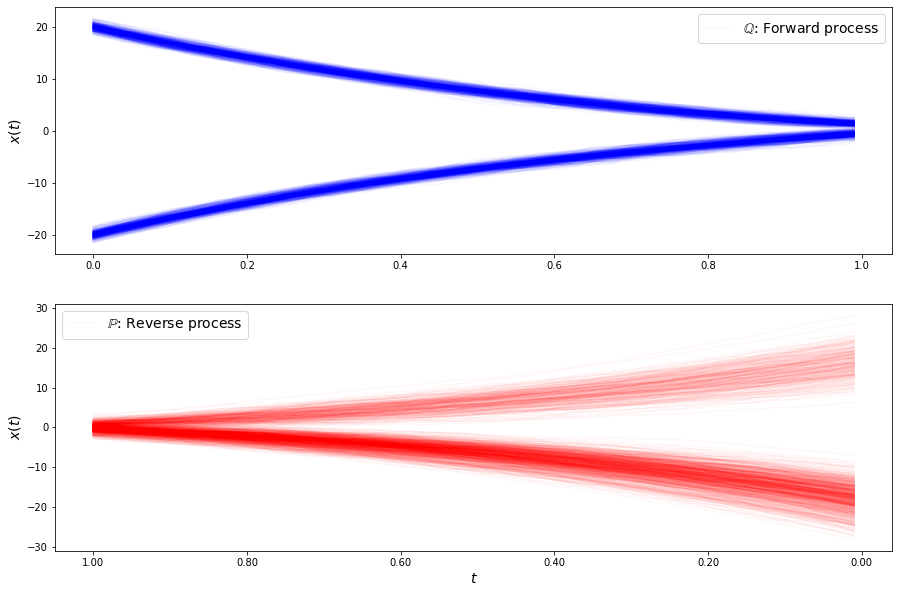

loss b 6.8130093187282545
loss b 6.669587249507181
loss b 7.071339212285617
loss b 6.379424358690841
loss b 6.909989622792214
loss b 7.274005652691079
loss b 7.409431453752014
loss b 6.989768772847611
loss b 6.84921777060874
loss b 7.019616383056906
loss b 6.467253481481202
loss b 7.043524789167745
loss b 6.859085951221114
loss b 7.052107340698803
loss b 7.196916004025107
loss b 6.942480988377915
loss b 7.099631561136702
loss b 6.652510178673305
loss b 7.061717109725633
loss b 6.746339520942022
loss b 6.938020143050942
loss b 6.9278642833655235
loss b 7.014909097735657
loss b 6.4362274453921255
loss b 7.330102706031147
loss b 6.715925336730159
loss b 7.009423764083106
loss b 6.919690114189115
loss b 6.822008607928302
loss b 7.088709815246098
loss f 2.786306549582112
loss f 2.798409804288805
loss f 2.7806594335272026
loss f 2.7931236356893336
loss f 2.779321849410006
loss f 2.8295158989788263
loss f 2.7568485726064784
loss f 2.7929969391028457
loss f 2.766170511965852
loss f 2.770181957

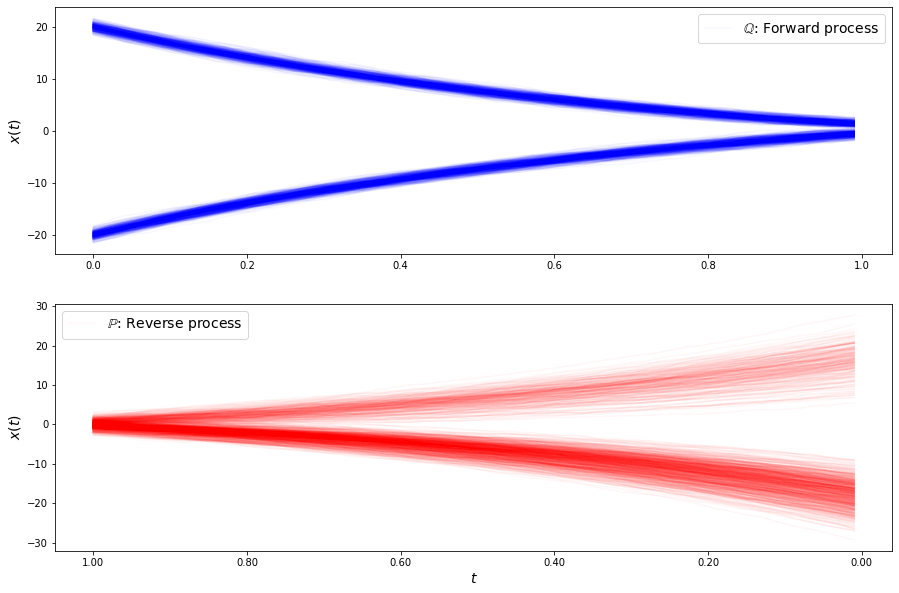

loss b 7.6015768029025566
loss b 7.136106093768313
loss b 6.876848023072296
loss b 6.6530448991531745
loss b 6.706142405584028
loss b 7.156981441369074
loss b 6.786964816095384
loss b 6.642371785029101
loss b 6.9290321972635684
loss b 6.984487204726929
loss b 6.353280895029769
loss b 6.97306118813846
loss b 6.466162349850882
loss b 6.730485303960482
loss b 7.0886901902572115
loss b 6.501622120031082
loss b 7.0370714472663485
loss b 7.17010827519189
loss b 6.854796003155243
loss b 7.0880613082062585
loss b 6.920006091855993
loss b 6.721592084079766
loss b 6.81927277333101
loss b 6.743115624351731
loss b 7.193465693777235
loss b 6.536053948326023
loss b 6.4968013362579775
loss b 6.91463095399809
loss b 6.7213761892577235
loss b 6.842060230330584
loss f 2.7612140053462815
loss f 2.7682247258589325
loss f 2.7742075482098425
loss f 2.819425176984336
loss f 2.783762376619945
loss f 2.750017531998333
loss f 2.8154298863374083
loss f 2.807614137875612
loss f 2.807009644725178
loss f 2.70640213

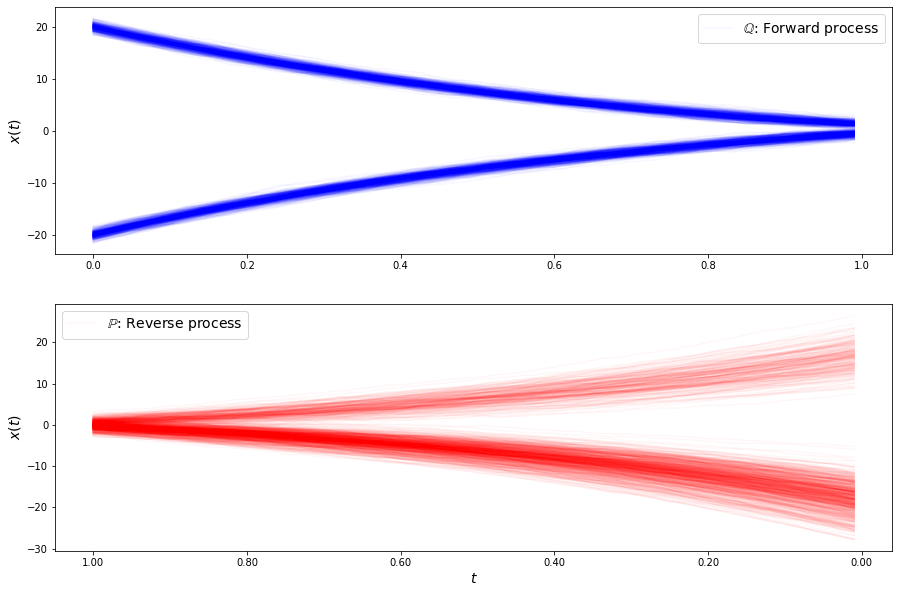

loss b 6.742228703476311
loss b 6.693691683698178
loss b 6.927735618429042
loss b 6.695762922917776
loss b 6.890337131948955
loss b 6.615289550411501
loss b 6.515945771441859
loss b 6.700690387513672
loss b 6.4145742120544265
loss b 6.603586875793876
loss b 6.750447580324779
loss b 6.7582267238028875
loss b 6.543058037059526
loss b 6.701292728554776
loss b 6.820425281452891
loss b 6.815857039821947
loss b 6.348892766323664
loss b 6.866724149128979
loss b 6.515694642982555
loss b 6.254471696562033
loss b 6.366130331930845
loss b 6.501437957182668
loss b 6.593800475122724
loss b 6.539623393460731
loss b 6.949383677260529
loss b 7.082357317968121
loss b 6.851709579075032
loss b 6.848599283844062
loss b 6.433831518923695
loss b 6.5358956205722025
loss f 2.8058437140861128
loss f 2.7650260325786027
loss f 2.7000235522187355
loss f 2.7535214030784414
loss f 2.77205406372327
loss f 2.8077372967709504
loss f 2.765092210376611
loss f 2.8118277235234452
loss f 2.770809691308109
loss f 2.78279173

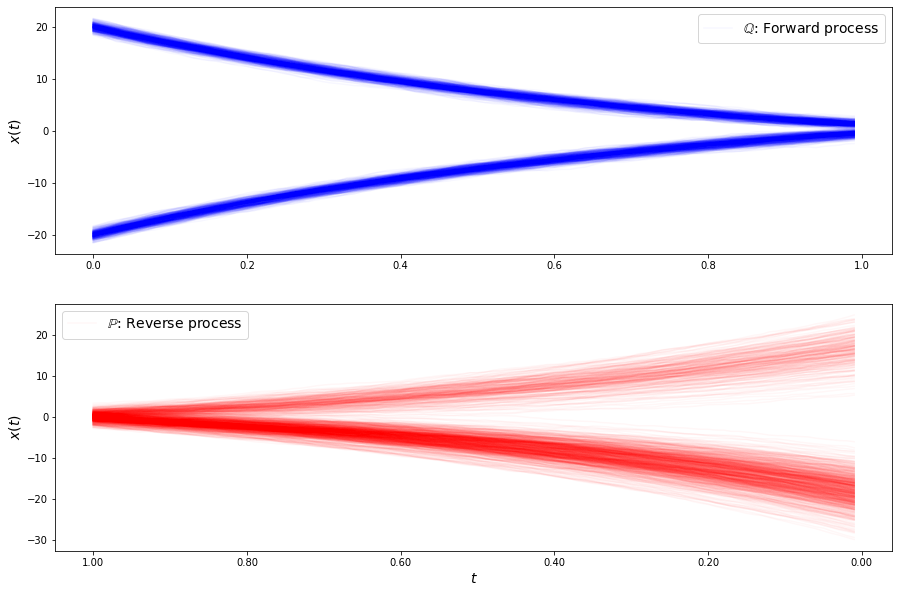

loss b 6.838645860351192
loss b 6.8641638117987345
loss b 6.667847028282918
loss b 6.572497303368947
loss b 6.391383942987434
loss b 6.453358830644734
loss b 6.474048680516318
loss b 7.090572146576511
loss b 6.828102087191826
loss b 6.819723958846081
loss b 6.296248309067429
loss b 6.564774693578654
loss b 6.427132855564622
loss b 5.985042725441547
loss b 6.789679820442782
loss b 6.64021551660355
loss b 7.051622636330079
loss b 6.507611948846581
loss b 6.711760654577016
loss b 6.581204041242039
loss b 6.712932929251763
loss b 6.586047882972187
loss b 6.761042973604307
loss b 6.957498827244476
loss b 6.461602624003278
loss b 6.543290318299443
loss b 6.295524360417537
loss b 6.670389558718089
loss b 6.490198478118697
loss b 6.635176881742319
loss f 2.856781309579861
loss f 2.823955724272491
loss f 2.804681395604482
loss f 2.839283683973466
loss f 2.784223218873781
loss f 2.774162903914585
loss f 2.786760530041636
loss f 2.849138497046622
loss f 2.8220207153327217
loss f 2.789419511417063

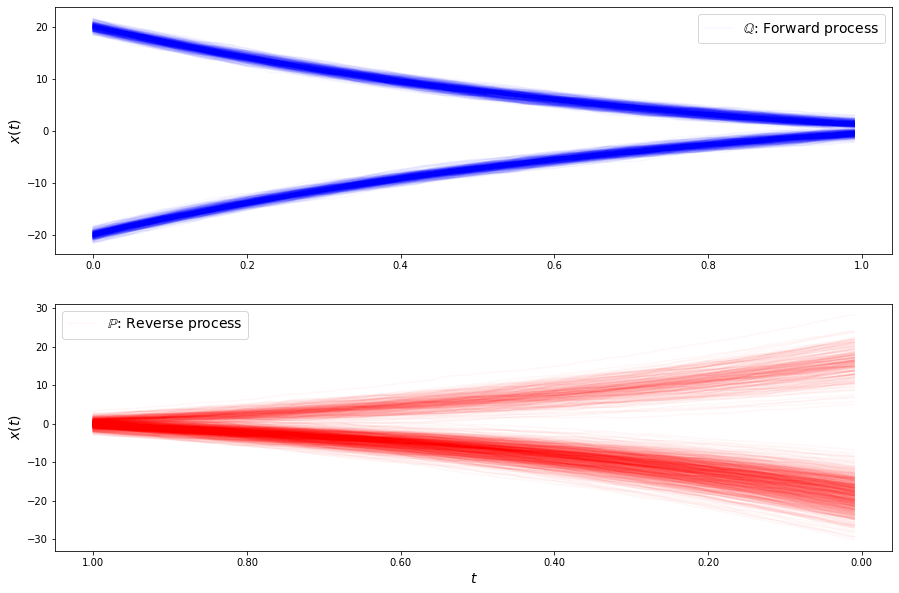

loss b 6.92428650606671
loss b 6.425937263862276
loss b 6.191966931286674
loss b 6.189751392650632
loss b 6.20310947022614
loss b 6.428406269504698
loss b 6.49053887679691
loss b 6.982445048049584
loss b 6.7702981300233915
loss b 6.600980238351995
loss b 6.588763169901724
loss b 6.357627352215447
loss b 6.892686693616853
loss b 6.599836753793629
loss b 6.404056822562163
loss b 6.673423105345936
loss b 7.137265488392106
loss b 6.795332601457587
loss b 6.7530733933562095
loss b 5.940294215551056
loss b 6.145207238453959
loss b 6.619715192046508
loss b 6.673669839624506
loss b 6.42613041933833
loss b 6.5215630524615955
loss b 6.703760111856996
loss b 6.861032168246962
loss b 6.446476233133107
loss b 6.82836392127766
loss b 6.316849769482883
loss f 2.8173103338962724
loss f 2.837182041020238
loss f 2.836158545381203
loss f 2.828663446709615
loss f 2.8200324573662687
loss f 2.7910942539234203
loss f 2.822180129191202
loss f 2.8378268622316627
loss f 2.790330984132164
loss f 2.84295821163179

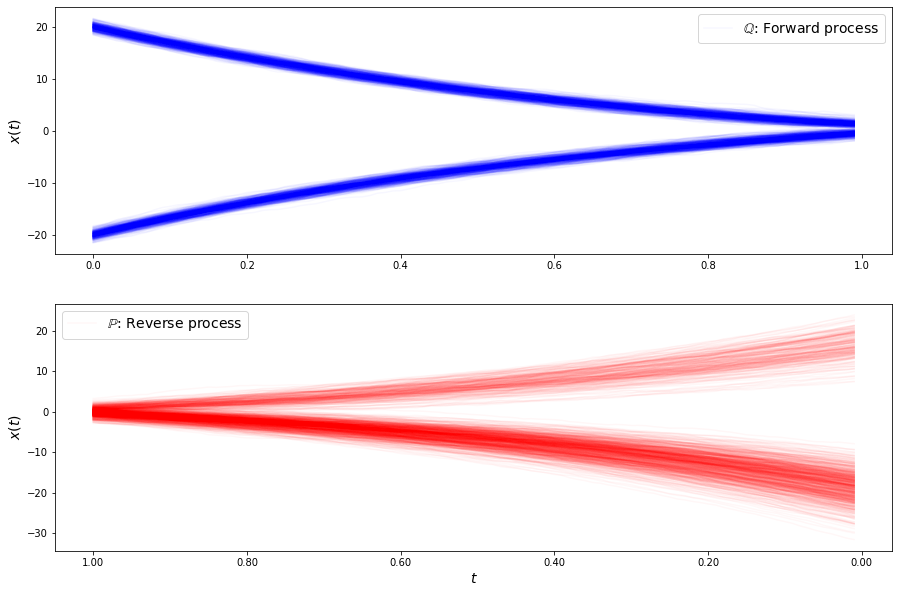

loss b 6.607070940476504
loss b 6.187933121997747
loss b 6.213226433221918
loss b 6.5533822977851885
loss b 6.512553318101258
loss b 6.230923602609382
loss b 6.553010062923827
loss b 6.954752023864583
loss b 6.439723850871098
loss b 6.058984758362705
loss b 6.975811070818185
loss b 6.222401802034958
loss b 6.323649298113385
loss b 6.513524364665258
loss b 6.424705156600415
loss b 6.407329867326164
loss b 6.540907528694924
loss b 6.635238213287028
loss b 5.748916708528967
loss b 6.3886758319033605
loss b 6.252819912010923
loss b 6.140092040622991
loss b 6.3727399004866285
loss b 6.437443178054369
loss b 6.64075855956212
loss b 6.656803313712143
loss b 6.25595004760857
loss b 6.134878018551139
loss b 6.367158299968295
loss b 6.639169370155725
loss f 2.8502578967940595
loss f 2.8626723474873303
loss f 2.8038851160727245
loss f 2.85522990808544
loss f 2.815998146163573
loss f 2.8156961331037347
loss f 2.863062723141505
loss f 2.8348394537732156
loss f 2.836574669158767
loss f 2.79237672291

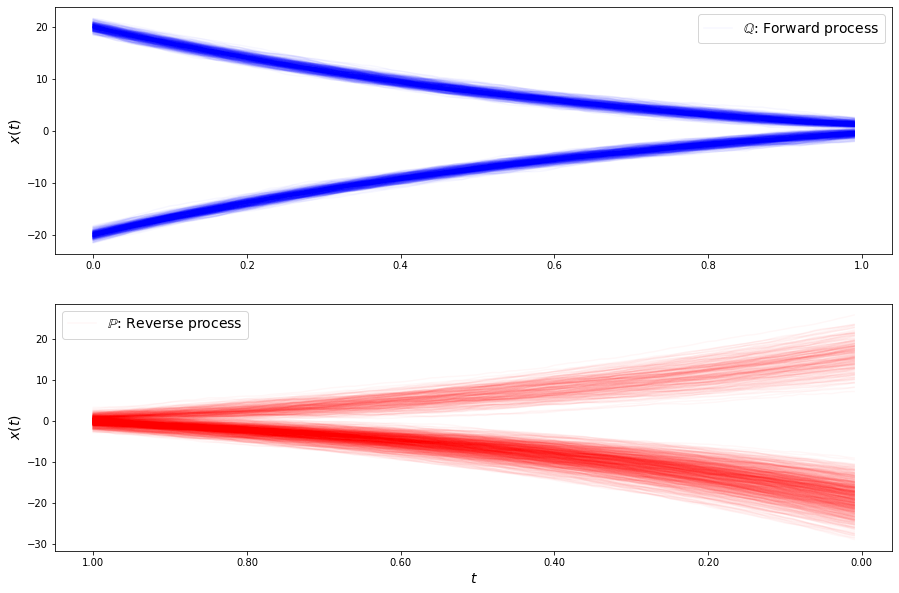

loss b 6.299556882567138
loss b 6.3058495025313235
loss b 7.036730572047528
loss b 6.507452492682474
loss b 6.142973732150238
loss b 6.649521485543093
loss b 6.402740804589633
loss b 6.825165310539076
loss b 6.245066818713599
loss b 6.367506373928176
loss b 6.573805484335683
loss b 6.409488910222301
loss b 6.290106848549812
loss b 6.007059224240294
loss b 6.049678500464647
loss b 6.5541565877981665
loss b 6.513199009383837
loss b 6.302640657140468
loss b 6.2893558938638074
loss b 6.377013893890732
loss b 6.331307271400938
loss b 6.339499466858064
loss b 6.571281055606284
loss b 6.5553784623156
loss b 6.178404394429865
loss b 6.214476559346424
loss b 6.482067558128713
loss b 6.554333171391231
loss b 6.457158169538754
loss b 6.27100756105945
loss f 2.8645733293921274
loss f 2.858727983402531
loss f 2.8589912384426057
loss f 2.8115291108714815
loss f 2.86863405008961
loss f 2.8225214349363394
loss f 2.8602085411486406
loss f 2.8653173169393145
loss f 2.8667511952149125
loss f 2.7992186939

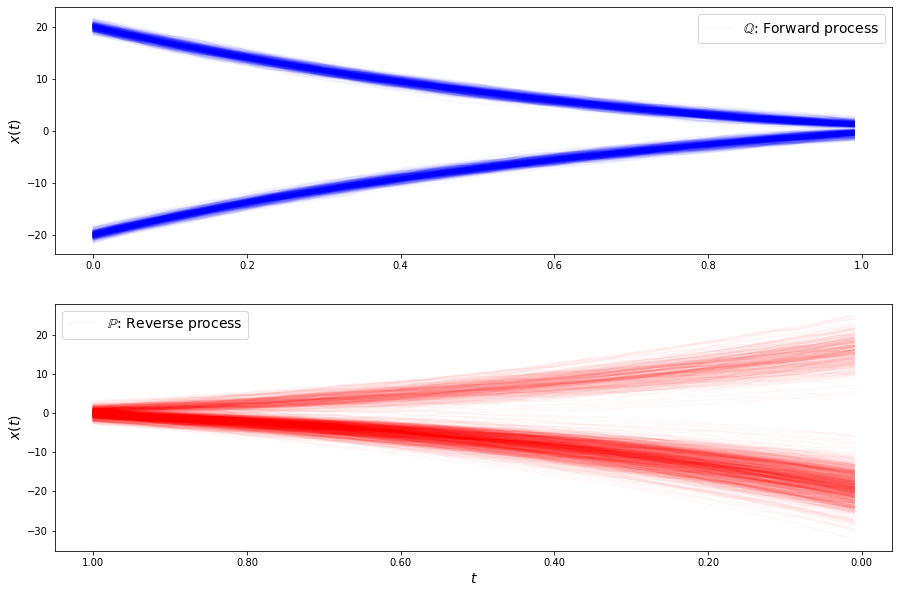

loss b 6.310319501765127
loss b 6.5853698994745775
loss b 6.069589515160549
loss b 6.3806422785821555
loss b 6.6932364910667
loss b 6.114080886882506
loss b 6.278324491949998
loss b 6.4528143940931315
loss b 6.265163229513851
loss b 6.625014310555184
loss b 6.21622439035565
loss b 6.408016403233394
loss b 6.206783878861433
loss b 6.54430395881571
loss b 6.164136689752321
loss b 6.385983772530114
loss b 6.303076685578674
loss b 6.097556719298966
loss b 6.279092081704648
loss b 6.418971940967655
loss b 6.491150518401427
loss b 6.366467881183796
loss b 6.048901234346876
loss b 6.5886721104499415
loss b 6.4782778606777045
loss b 6.119571835981152
loss b 6.06789953931011
loss b 5.978028426997689
loss b 6.304910059341389
loss b 6.273932759467896
loss f 2.863754582206931
loss f 2.8858721666434404
loss f 2.861379794528764
loss f 2.818047945102083
loss f 2.8099996250779515
loss f 2.8109286525712776
loss f 2.8861655273529707
loss f 2.8574285319398456
loss f 2.8453639535377566
loss f 2.8640129725

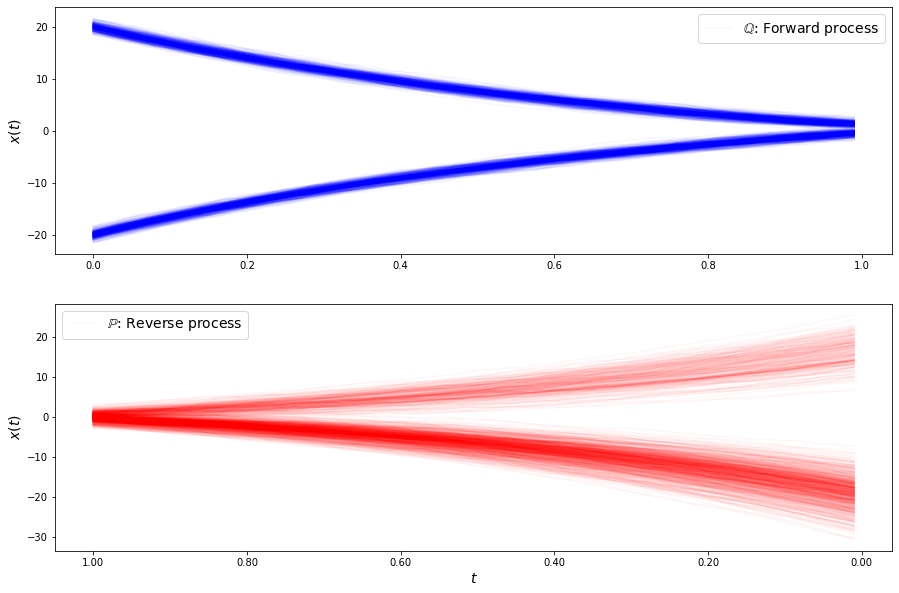

loss b 6.105500459643187
loss b 6.499235910024331
loss b 6.164622161860537
loss b 6.272906876488289
loss b 6.500192863201357
loss b 6.175806507942662
loss b 6.260796070337157
loss b 6.465323437330576
loss b 6.504672072219784
loss b 6.539219278382246
loss b 6.268064261517692
loss b 6.4209821950095005
loss b 6.225123269398352
loss b 6.652563749732259
loss b 6.150396623758532
loss b 6.496713734034838
loss b 6.19870811624317
loss b 6.244489129865185
loss b 6.425674160899451
loss b 6.307528615768565
loss b 6.4461155942731425
loss b 6.177534397902057
loss b 6.0596851377674925
loss b 6.153531083034471
loss b 6.364810848657075
loss b 6.557633273080757
loss b 6.248418397389602
loss b 6.598554526034809
loss b 6.177718304359435
loss b 6.635024289124893
loss f 2.8840364337405204
loss f 2.868138783644119
loss f 2.902992077859402
loss f 2.843930257498196
loss f 2.8540705543890166
loss f 2.8449672408993654
loss f 2.9117470619322376
loss f 2.85442255816444
loss f 2.8276326727424013
loss f 2.8366178997

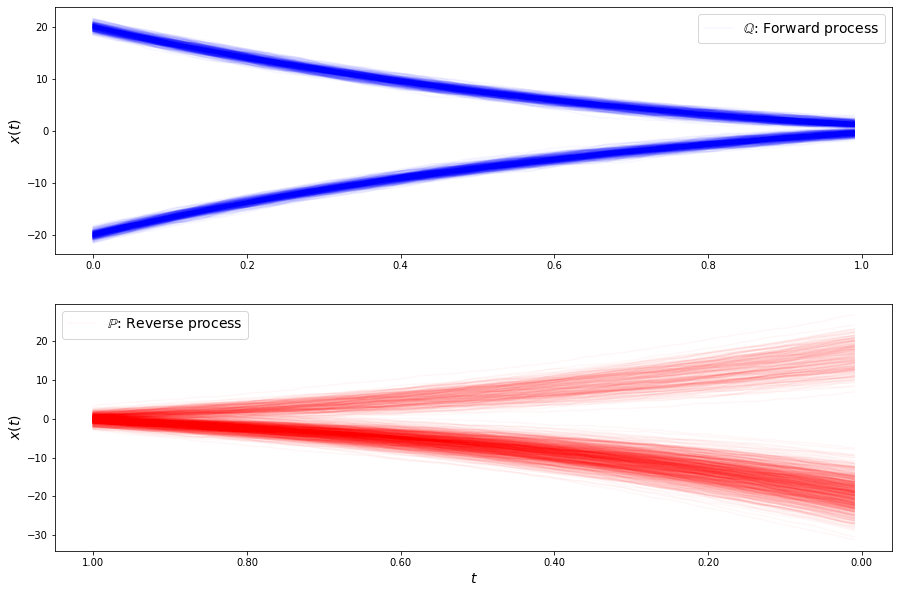

loss b 6.348961812465272
loss b 6.4004779355286
loss b 6.088444657940961
loss b 6.1748804098416
loss b 6.2956439048263695
loss b 6.321357452319233
loss b 6.213751211953752
loss b 6.389866785411818
loss b 6.074816097616935
loss b 6.70288534164682
loss b 5.938644036721135
loss b 5.7442698885381605
loss b 6.283508971808077
loss b 6.3665141781324195
loss b 6.407233246048204
loss b 5.977203941669125
loss b 6.1712325666210655
loss b 6.337193751898661
loss b 5.62304625723228
loss b 6.097689199284195
loss b 6.0918280685422745
loss b 6.25460207960863
loss b 5.985879610250195
loss b 6.191540491337655
loss b 6.229347056964021
loss b 5.930718581192571
loss b 6.427161431254999
loss b 6.039274137905429
loss b 6.315563723314123
loss b 6.073135558410028
loss f 2.819199413558704
loss f 2.871238254668446
loss f 2.780665677875798
loss f 2.8399429601752275
loss f 2.8413049746730237
loss f 2.820449177521693
loss f 2.865485826300107
loss f 2.833934885895269
loss f 2.857576031368345
loss f 2.811122622722863


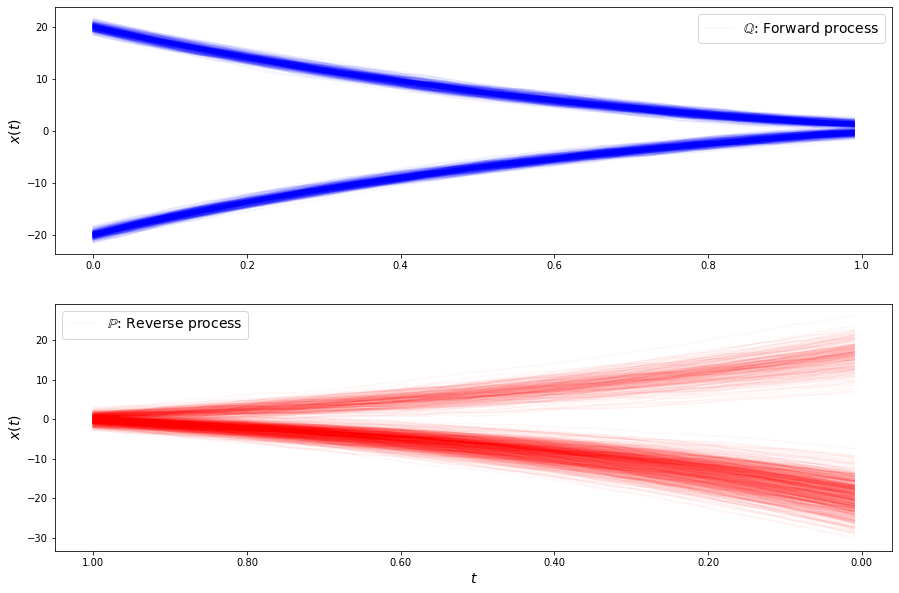

loss b 6.403638090225293
loss b 5.982055873265875
loss b 6.21980094022588
loss b 6.125580947632846
loss b 5.882108232563631
loss b 5.891444709870033
loss b 5.9090116917458815
loss b 6.066901453320041
loss b 6.1030587681654165
loss b 6.159345746553594
loss b 6.432030439571888
loss b 6.1617468813839
loss b 6.1860850429829535
loss b 6.031860054522349
loss b 6.176959285030096
loss b 6.2924719205566175
loss b 6.241480218814128
loss b 6.319621361548378
loss b 6.110198035464501
loss b 6.390252485872448
loss b 6.146119378596406
loss b 6.069819545523282
loss b 6.4917658075388
loss b 6.053194494343534
loss b 6.204069695234615
loss b 6.249154244751678
loss b 6.373158242664213
loss b 5.861609427393092
loss b 6.441669772342269
loss b 5.993505791732767
loss f 2.7879029844411525
loss f 2.8029366477509807
loss f 2.8146707227900247
loss f 2.847344317512047
loss f 2.7978958612944345
loss f 2.823060828233135
loss f 2.781846946080351
loss f 2.791606600397929
loss f 2.8060699242418607
loss f 2.803263067459

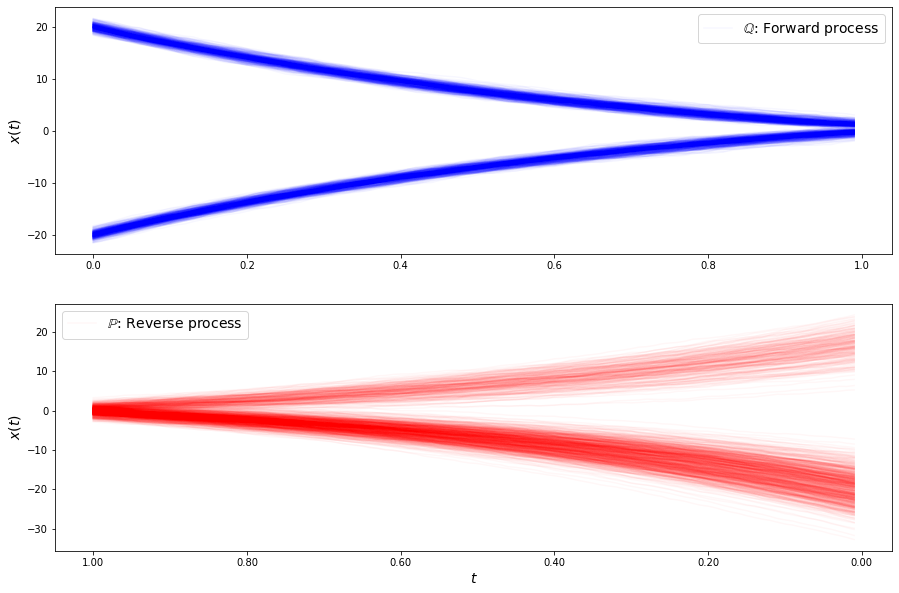

loss b 5.940408176335838
loss b 6.419279101031318
loss b 6.467434268168977
loss b 5.764665564878242
loss b 6.277335775672877
loss b 6.386644654821465
loss b 6.52095981747565
loss b 6.1906252893856895
loss b 6.285379253235232
loss b 5.925889289322775
loss b 6.169017724751096
loss b 5.974831677197319
loss b 5.947638770589481
loss b 6.236362536988809
loss b 5.995978055570933
loss b 5.90776027620893
loss b 6.254572226374088
loss b 5.926520483608961
loss b 6.266378671053106
loss b 5.856065705206169
loss b 6.2689882187984205
loss b 6.531778627483489
loss b 6.072064380184506
loss b 5.957013178787359
loss b 6.171963478469286
loss b 5.833891708894197
loss b 6.125089348656035
loss b 6.233269640446261
loss b 6.127339300584608
loss b 6.106847171854604
loss f 2.7727540279059957
loss f 2.7735754518204905
loss f 2.7756653312448116
loss f 2.7935973902087503
loss f 2.7916868113303956
loss f 2.7959945593453575
loss f 2.7538410324828213
loss f 2.776861788570408
loss f 2.7489560498541463
loss f 2.75006877

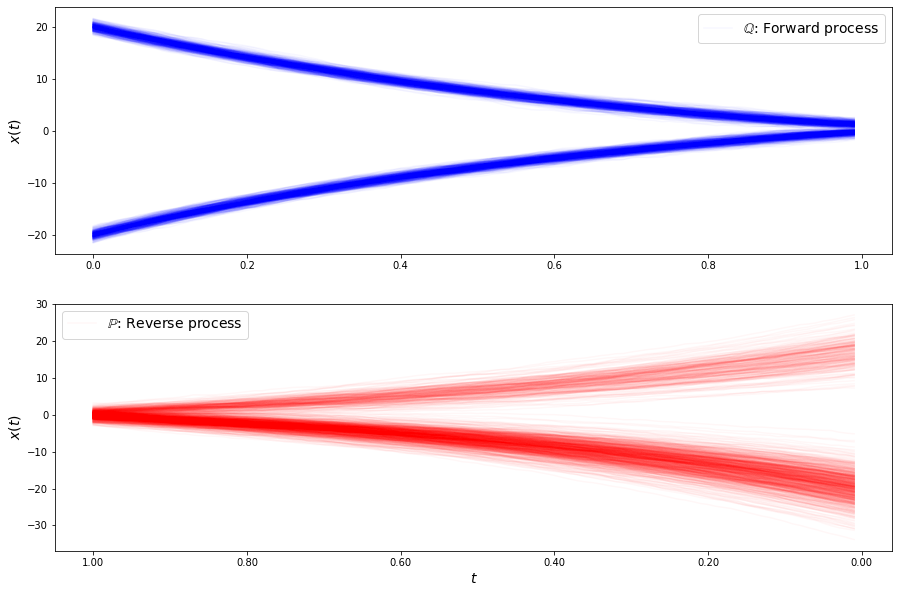

loss b 6.026449485665601
loss b 6.428434072113008
loss b 6.167575063395787
loss b 5.885030846129169
loss b 5.644383085042096
loss b 6.3950283607950125
loss b 5.940906275785418
loss b 6.112431154576557
loss b 6.115586778917528
loss b 6.187992677123411
loss b 6.364959604596592
loss b 6.297114134418622
loss b 6.058764947991282
loss b 6.289780295361457
loss b 6.024619455613981
loss b 6.070462253449555
loss b 6.1160216665215055
loss b 6.25100519050401
loss b 6.105940456211936
loss b 6.074272559123332
loss b 6.4830454379444635
loss b 5.54921217265077
loss b 6.1161682526111605
loss b 6.502758965183131
loss b 5.757893460055953
loss b 6.600355377212674
loss b 6.267392141161169
loss b 6.576715829099137
loss b 5.954901232002054
loss b 6.237466302340303
loss f 2.725556954561165
loss f 2.7119801825003234
loss f 2.7358919676626994
loss f 2.716803580338541
loss f 2.723126808430379
loss f 2.7427558672875727
loss f 2.753807932071548
loss f 2.7773980040415944
loss f 2.7621977652537937
loss f 2.750237957

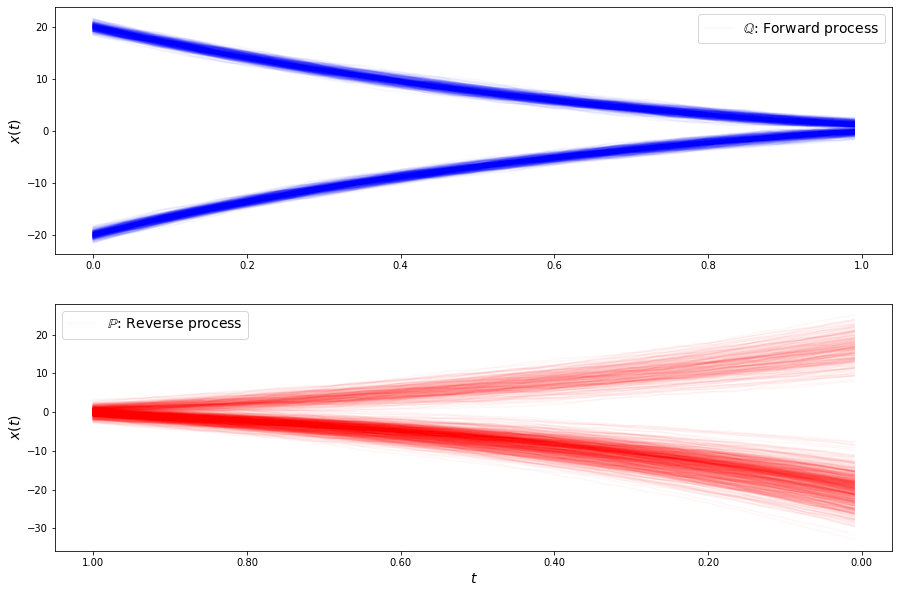

loss b 6.097492143156941
loss b 6.249843102590143
loss b 5.860993078855563
loss b 5.5840658016943205
loss b 6.059374282152151
loss b 5.880147787539081
loss b 6.363387808622848
loss b 5.915536000003032
loss b 6.178198236395752
loss b 6.1469639445705315
loss b 6.664774961244205
loss b 6.266484251968779
loss b 6.352901014532713
loss b 6.166233397098396
loss b 5.774559188229615
loss b 6.208880185455204
loss b 6.185613841305193
loss b 6.131925426668034
loss b 6.146923779144914
loss b 6.128384082830233
loss b 6.032512043302943
loss b 6.008998236954342
loss b 5.821282344554637
loss b 6.232215674408896
loss b 5.87175449589283
loss b 6.297960581136219
loss b 6.271820660520874
loss b 5.934996646038456
loss b 5.853149681292505
loss b 5.728092525479589
loss f 2.7363717851246054
loss f 2.721252195428658
loss f 2.709327444440409
loss f 2.727842542230013
loss f 2.7192308072905123
loss f 2.7122305634355692
loss f 2.69948311305608
loss f 2.7367541614766377
loss f 2.7088805644332985
loss f 2.70120434160

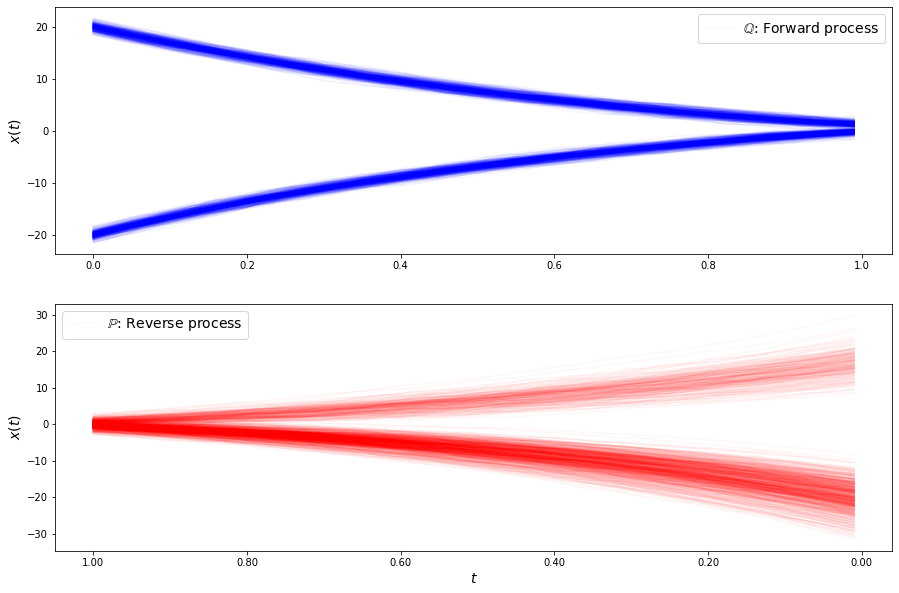

loss b 6.291292154500353
loss b 6.206192285958223
loss b 5.868891716137494
loss b 6.605762776893562
loss b 5.98416432847705
loss b 6.286576582357871
loss b 5.827948988693247
loss b 6.186619243254322
loss b 6.340671612723104
loss b 6.059487778190319
loss b 6.453121315782085
loss b 6.263983724239952
loss b 6.519605250783976
loss b 5.95567839018257
loss b 5.701997227349253
loss b 6.270346642519375
loss b 6.228037852738355
loss b 6.0909404795197695
loss b 6.04461285458157
loss b 6.289043451961321
loss b 6.0544347786764305
loss b 6.1829991399629245
loss b 6.233446805429686
loss b 6.03023351641862
loss b 5.898167148827758
loss b 5.877146086881573
loss b 5.872194011779251
loss b 6.038401847422311
loss b 6.028528993218329
loss b 5.709966565339188
loss f 2.660908680069835
loss f 2.655489328787706
loss f 2.6695275488479373
loss f 2.702620009224732
loss f 2.6410666707251425
loss f 2.660411904461759
loss f 2.7333405321505184
loss f 2.6748781911646375
loss f 2.6935235755606417
loss f 2.726596864694

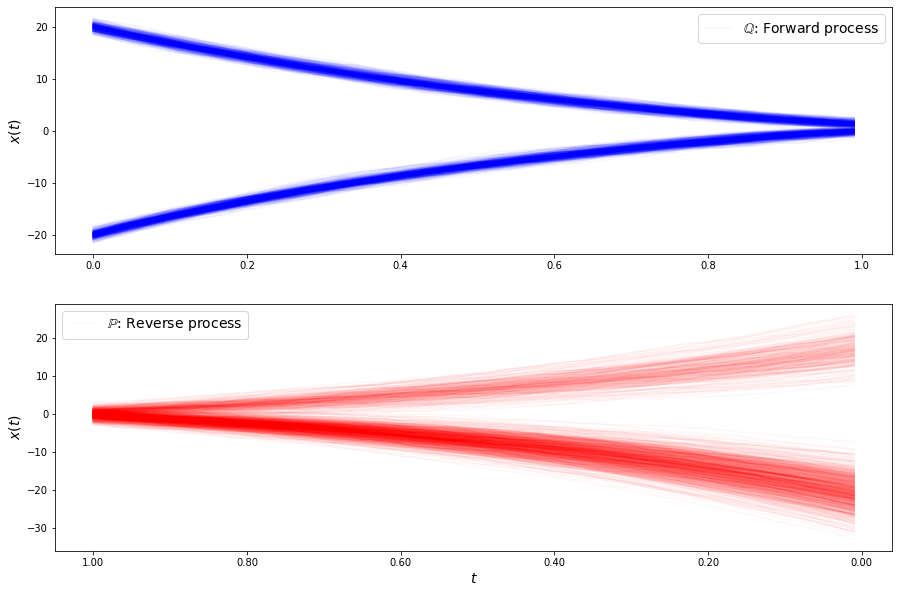

loss b 6.166773892790989
loss b 6.0242397523615825
loss b 6.424746798577811
loss b 6.289749571229264
loss b 5.978053448933075
loss b 6.650932403304618
loss b 6.251084124011545
loss b 6.633256767113907
loss b 6.58296898793955
loss b 6.549559119721915
loss b 6.356564305986008
loss b 5.953682596966221
loss b 6.593512412328222
loss b 6.204093602037984
loss b 6.3863607814134395
loss b 6.154123517214513
loss b 5.883023900104527
loss b 6.0004487413791665
loss b 6.528452149533715
loss b 6.6483750192985624
loss b 6.371990705487713
loss b 6.035699383397295
loss b 6.483088453810644
loss b 6.185559573054299
loss b 6.483928953974903
loss b 6.667019155089842
loss b 6.366141329152068
loss b 6.003247071948112
loss b 6.432969648060055
loss b 6.126643606596208
loss f 2.6204924878891247
loss f 2.6727712618763606
loss f 2.6271124707823525
loss f 2.6588952949113662
loss f 2.682030629204654
loss f 2.6592198680812302
loss f 2.6396225547362167
loss f 2.6433940460932583
loss f 2.661331325207773
loss f 2.659274

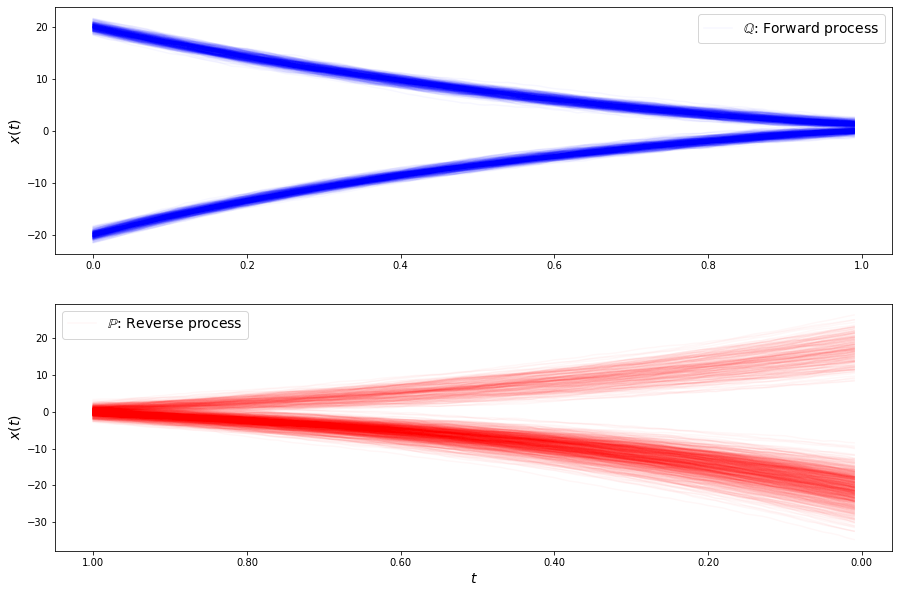

loss b 5.994128771146284
loss b 6.266349797318198
loss b 6.081313308109555
loss b 6.183788242165575
loss b 6.597970415616669
loss b 6.436229004399048
loss b 6.383891036604566
loss b 6.487830918866368
loss b 6.0808975530395175
loss b 6.339547122935279
loss b 6.362411078232771
loss b 6.028871434033174
loss b 6.554309720847025
loss b 5.792049573764776
loss b 6.262510365646426
loss b 6.485102745680509
loss b 6.473884645902806
loss b 6.413102713808973
loss b 6.388519778150457
loss b 6.284665452159926
loss b 6.5981139032992004
loss b 6.591164377354916
loss b 6.076587372883101
loss b 6.432635733518859
loss b 6.141366767118846
loss b 6.3667099155247415
loss b 6.340968981645835
loss b 6.279587875184784
loss b 6.197747261532207
loss b 6.388693149690263
loss f 2.693708117477782
loss f 2.689788220375298
loss f 2.6390050375494627
loss f 2.7120923958650867
loss f 2.658788065016842
loss f 2.687522269997727
loss f 2.7380910983873563
loss f 2.6425004616336865
loss f 2.6707892227487418
loss f 2.71792742

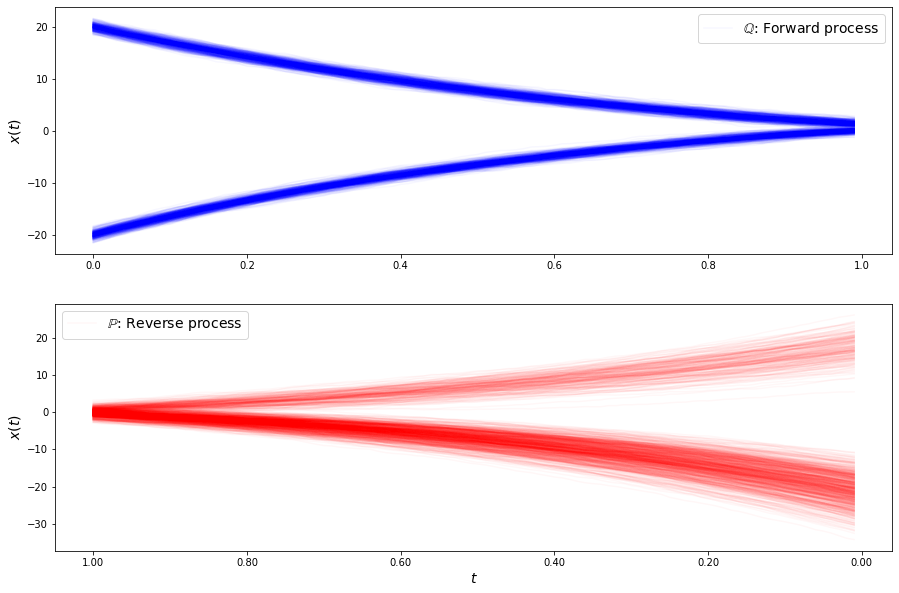

loss b 6.588233101167568
loss b 6.339063350706902
loss b 6.594291359080087
loss b 6.3498206432469555
loss b 6.275486454857501
loss b 6.402420368251517
loss b 6.190753925723072
loss b 6.379479370261888
loss b 6.197914134036221
loss b 6.285226969001505
loss b 6.666503630738615
loss b 6.336617933431398
loss b 6.609357911573193
loss b 6.085816287849876
loss b 6.252703265622162
loss b 6.732430539217846
loss b 6.460920294930527
loss b 6.487367396760151
loss b 6.6739447954978965
loss b 6.06706836911346
loss b 6.502485597628277
loss b 6.173687140493374
loss b 7.0947041816907745
loss b 6.5988482144148985
loss b 6.739450628560768
loss b 6.6392069053248886
loss b 6.590473626018232
loss b 6.456376514684153
loss b 6.480396644517826
loss b 5.999259432870265
loss f 2.6812695286897164
loss f 2.6646515205031114
loss f 2.738986913880384
loss f 2.655499654086002
loss f 2.6970920723432807
loss f 2.6963343717975343
loss f 2.6892362422992186
loss f 2.6893377632048883
loss f 2.681784092141077
loss f 2.657847

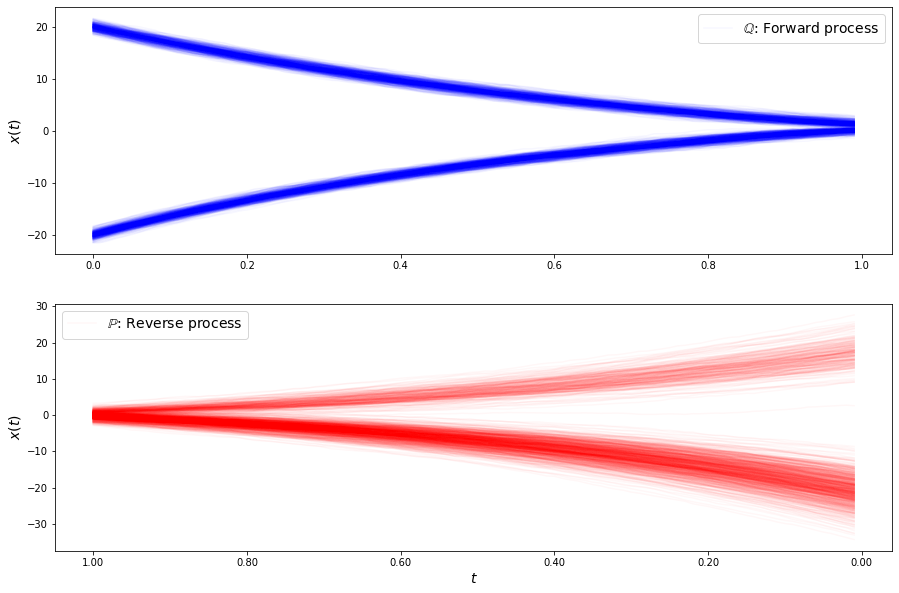

loss b 6.9831296975444435
loss b 6.2749894868418075
loss b 6.3542814540912556
loss b 6.565744190676122
loss b 6.477576414077876
loss b 6.664622871799227
loss b 6.59806665427187
loss b 6.826816134348677
loss b 6.4458493705828594
loss b 6.696434642057545
loss b 6.788007491623044
loss b 6.47799665871021
loss b 6.6659438001309255
loss b 6.666908118998761
loss b 6.570388746313261
loss b 6.461488669244502
loss b 6.86112435365291
loss b 6.565529548558589
loss b 6.73692745601139
loss b 6.894772755643946
loss b 6.41412752160988
loss b 6.47230350285083
loss b 6.396540039556442
loss b 6.342349464816537
loss b 6.916274343460914
loss b 6.707546564771806
loss b 6.740398657543762
loss b 6.501362033367609
loss b 6.838074878749336
loss b 6.780950153471314
loss f 2.71666011754916
loss f 2.672449771264141
loss f 2.6899949051934278
loss f 2.736483416585374
loss f 2.705367732639196
loss f 2.6768842616820856
loss f 2.68312159577757
loss f 2.6643397984319774
loss f 2.7423808958924574
loss f 2.678478187737411

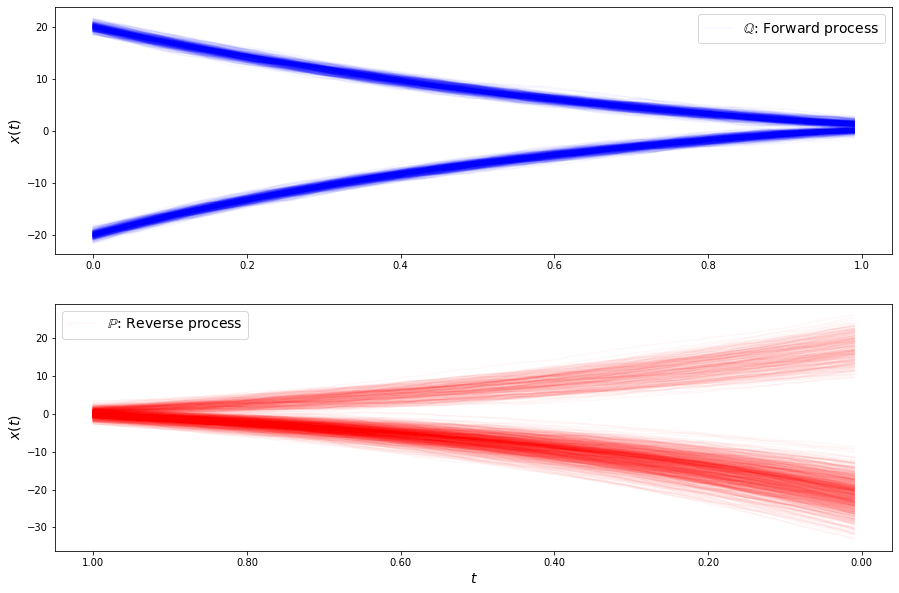

loss b 7.135829945193945
loss b 6.296570599990271
loss b 6.381998695064287
loss b 6.674801937162154
loss b 6.983927665513946
loss b 6.341163613183659
loss b 6.8220433215096605
loss b 6.610235755153334
loss b 7.048506615692745
loss b 6.670730398554072
loss b 6.516225320988189
loss b 6.8443835214735325
loss b 6.684054164556735
loss b 7.022882456869408
loss b 6.838290795231376
loss b 7.238906762600355
loss b 6.736931407014024
loss b 6.691102188398901
loss b 6.450587952016291
loss b 6.425516107676373
loss b 6.861449396328711
loss b 6.662743753595684
loss b 6.564841902001236
loss b 6.7466331890222
loss b 6.824804605775811
loss b 6.737522712088408
loss b 6.693236250059186
loss b 6.629869238796176
loss b 6.668028960783031
loss b 6.666501497874857
loss f 2.7109234054184337
loss f 2.687812687241365
loss f 2.735757549790693
loss f 2.7298681782242613
loss f 2.7329757194882935
loss f 2.7043152841539904
loss f 2.7326573811781505
loss f 2.6550594173312243
loss f 2.698263988233242
loss f 2.7187936274

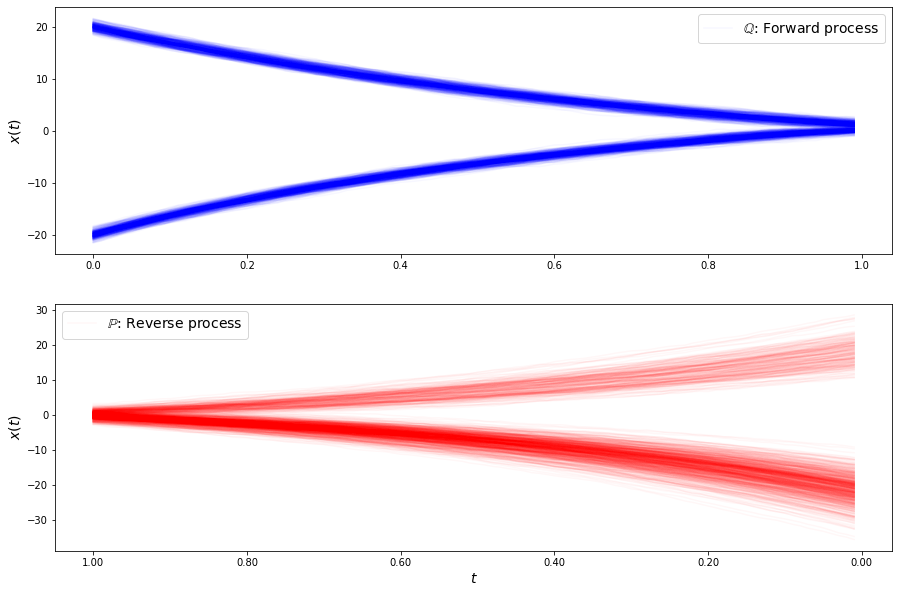

loss b 6.912423357103545
loss b 6.771643914155711
loss b 7.346847625704712
loss b 6.8000193865329495
loss b 7.211675442911252
loss b 7.067586668722818
loss b 6.883743370003645
loss b 6.781616938198744
loss b 6.564784659484063
loss b 7.082938231729021
loss b 6.758073511925719
loss b 6.6416119686561315
loss b 7.049145400621916
loss b 6.86535939312989
loss b 6.44321000809606
loss b 7.099424723072836
loss b 6.858566123835485
loss b 7.12883248976226
loss b 6.4919509439770176
loss b 6.874245295964142
loss b 7.014943771962834
loss b 6.573729191645748
loss b 6.607839605390545
loss b 6.733066032247795
loss b 6.96091576394286
loss b 6.639527892217253
loss b 6.880005382519253
loss b 7.24905532580424
loss b 6.517654304220995
loss b 6.572253470754837
loss f 2.710673896928006
loss f 2.741528520850721
loss f 2.708057782300576
loss f 2.7322584710191435
loss f 2.6618558168398208
loss f 2.77557043892961
loss f 2.719445343395365
loss f 2.7355548112584693
loss f 2.7130470476596167
loss f 2.748492506377052

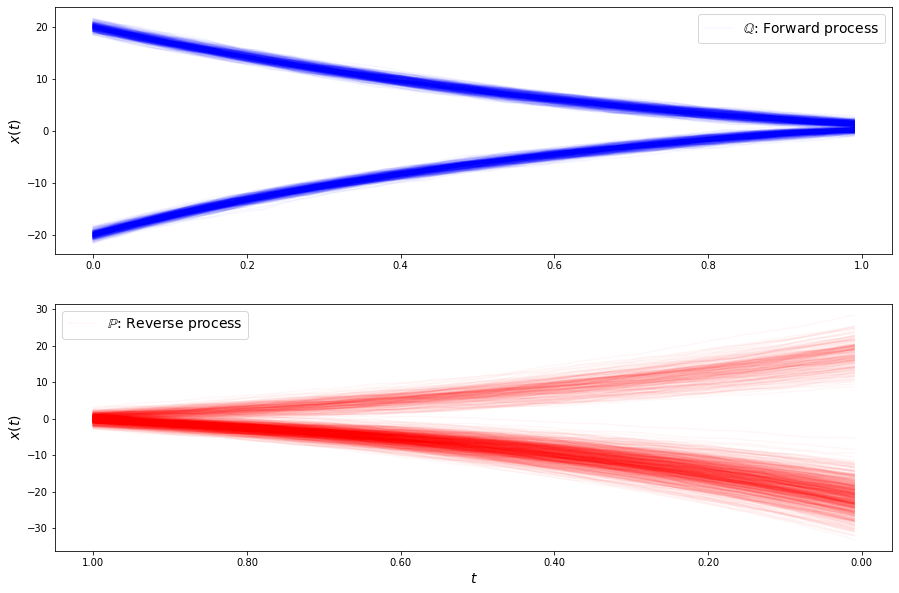

loss b 6.842666715258024
loss b 7.318770532584451
loss b 6.961316722436567
loss b 7.342117501800241
loss b 7.04226841148383
loss b 7.120764361949442
loss b 7.141911103938243
loss b 7.052826662768904
loss b 6.499820588406988
loss b 7.135569706414184
loss b 7.021531669296388
loss b 7.2579370825183185
loss b 7.248735330201392
loss b 6.9780989357655425
loss b 6.724409931159971
loss b 7.322107877758828
loss b 7.089750907677407
loss b 7.128238557488099
loss b 7.299949287970755
loss b 7.242044686563938
loss b 6.716769990578693
loss b 6.882122909103856
loss b 6.795413188084
loss b 6.628264273362885
loss b 7.267542041433876
loss b 7.069373466681863
loss b 7.124609627410197
loss b 6.853514773838294
loss b 7.62780629885396
loss b 7.123546471940229
loss f 2.7775069932388794
loss f 2.758993815754645
loss f 2.7374967887418427
loss f 2.794137473901905
loss f 2.7064720897020935
loss f 2.7378601512222978
loss f 2.732040314412092
loss f 2.754712292909162
loss f 2.72743817766297
loss f 2.796588185137901


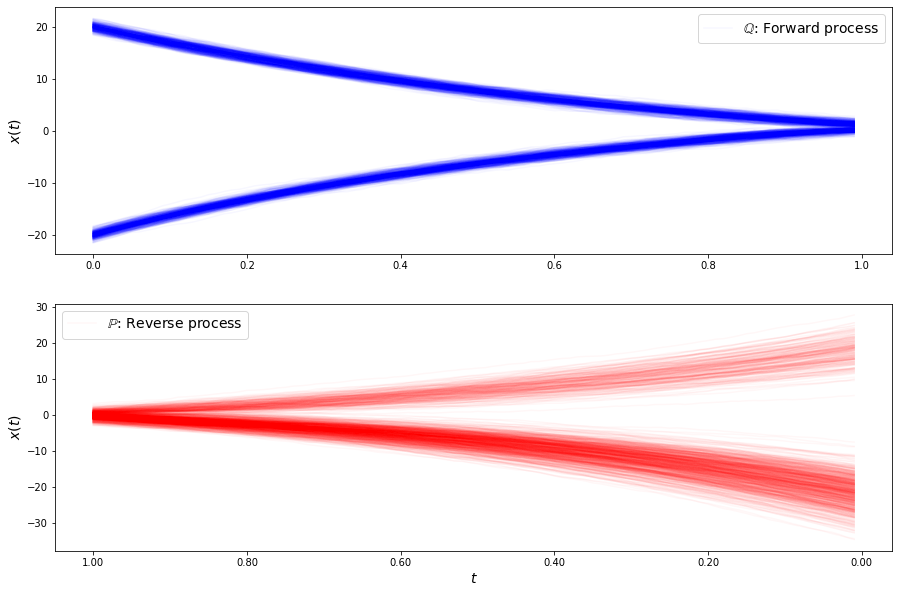

loss b 7.072309992836893
loss b 6.947424110280276
loss b 6.842285361013373
loss b 7.373631929370407
loss b 6.396764759495685
loss b 7.163935789919279
loss b 6.763049554016131
loss b 7.1374565539711785
loss b 7.391301507513841
loss b 7.236557892936598
loss b 6.682396936158849
loss b 6.999183784139842
loss b 6.833031488472764
loss b 7.380547616290633
loss b 7.075557129565485
loss b 7.023922348866078
loss b 7.244427897610035
loss b 7.170085838043379
loss b 7.127900638564754
loss b 7.311448038250912
loss b 6.922472189216406
loss b 7.399420952309167
loss b 7.195535336974654
loss b 7.335960523448542
loss b 7.345358192524615
loss b 7.050089523569889
loss b 7.21583610137713
loss b 7.117200826993986
loss b 6.770899360675044
loss b 6.841017805960424
loss f 2.735568977009075
loss f 2.722650869136262
loss f 2.6711746751535532
loss f 2.750800392213217
loss f 2.767125285148223
loss f 2.7685738841834646
loss f 2.7371891365187544
loss f 2.7331347672024195
loss f 2.6736312735747143
loss f 2.74257536837

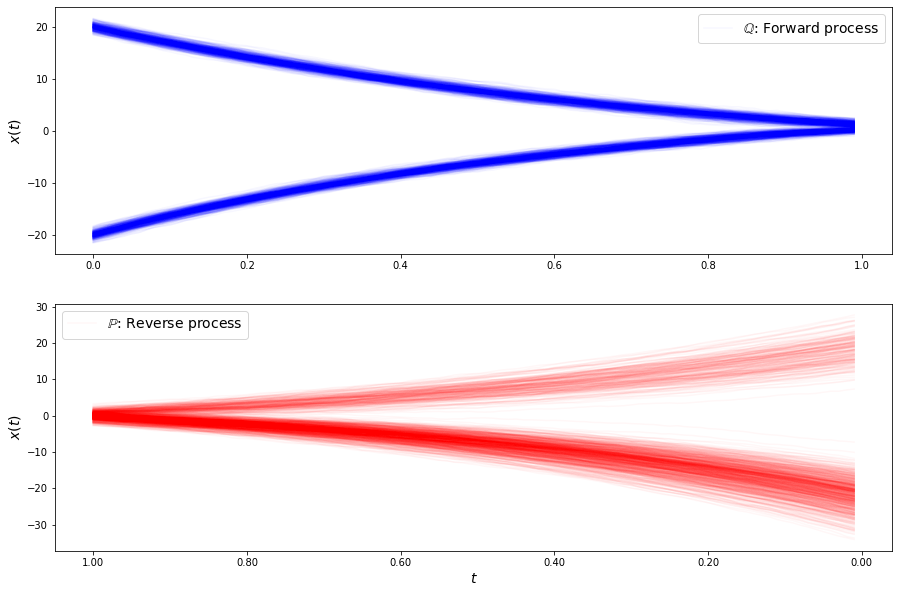

loss b 7.310265326741255
loss b 7.126941241448736
loss b 7.546712217655767
loss b 6.843876546559829
loss b 7.067331019609193
loss b 7.201613646623426
loss b 7.120442170125412
loss b 7.05347365658841
loss b 7.2471181685164225
loss b 7.268019394400617
loss b 7.500597013215402
loss b 7.341989688538479
loss b 7.147105522800362
loss b 7.2627519223832255
loss b 7.271140800308677
loss b 7.3277066368257255
loss b 7.363650377485918
loss b 7.346580641164553
loss b 7.36218240720439
loss b 7.03842777038264
loss b 7.012892822090846
loss b 7.389249950871657
loss b 7.25274389534744
loss b 7.321371306136592
loss b 7.046644882198441
loss b 7.435717855117658
loss b 7.4961703748968
loss b 6.80725729625969
loss b 7.8077052583771245
loss b 6.9471028342519086
loss f 2.6952801522341305
loss f 2.752029188264274
loss f 2.712201342674971
loss f 2.7375189205524246
loss f 2.6813094792928895
loss f 2.695238555306771
loss f 2.7868148774255403
loss f 2.7074799960814464
loss f 2.694674077416319
loss f 2.6950888981726

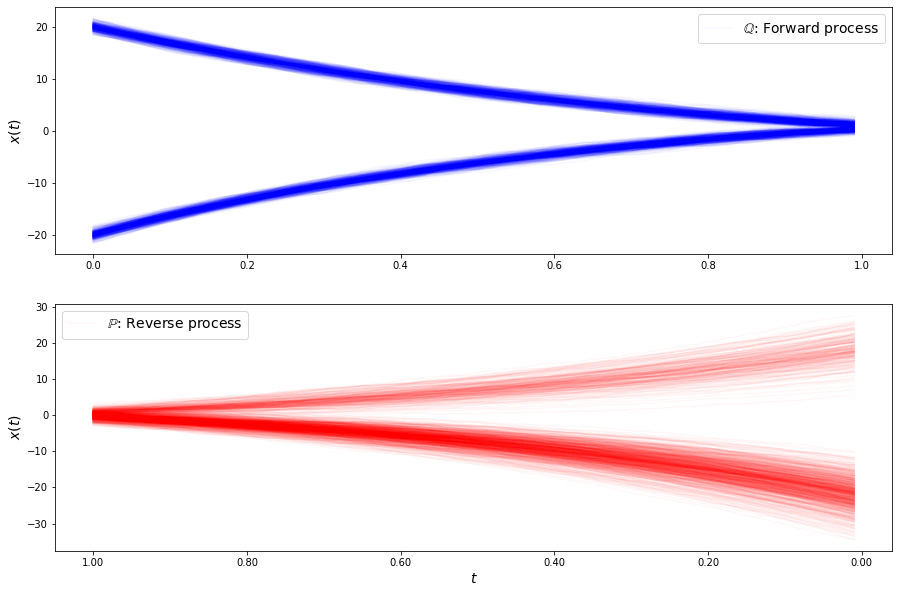

loss b 7.309766525349444
loss b 7.93772098385581
loss b 7.8072072231771665
loss b 7.687310656938893
loss b 7.29534753553948
loss b 7.41479663712644
loss b 7.376286834833265
loss b 6.967802369869637
loss b 7.345738711179877
loss b 7.278843655041049
loss b 7.609621423220394
loss b 7.46728502442923
loss b 7.100239625117252
loss b 7.259379537762644
loss b 6.9241759866522505
loss b 7.582792444442654
loss b 7.25122221252934
loss b 7.260003658677823
loss b 7.177361684296658
loss b 7.474132003584498
loss b 7.610624379086665
loss b 7.4153630406453095
loss b 7.582511130165677
loss b 6.963351648176123
loss b 7.276148215069009
loss b 7.822697094878833
loss b 7.685849019481079
loss b 7.3137233530213015
loss b 7.421059364627973
loss b 7.6880437722772275
loss f 2.7462630282339644
loss f 2.7192492662149417
loss f 2.7148003611860574
loss f 2.712904336813488
loss f 2.790085088245285
loss f 2.6962975024085463
loss f 2.7190996682539144
loss f 2.6906430284733163
loss f 2.7151551121199162
loss f 2.729773771

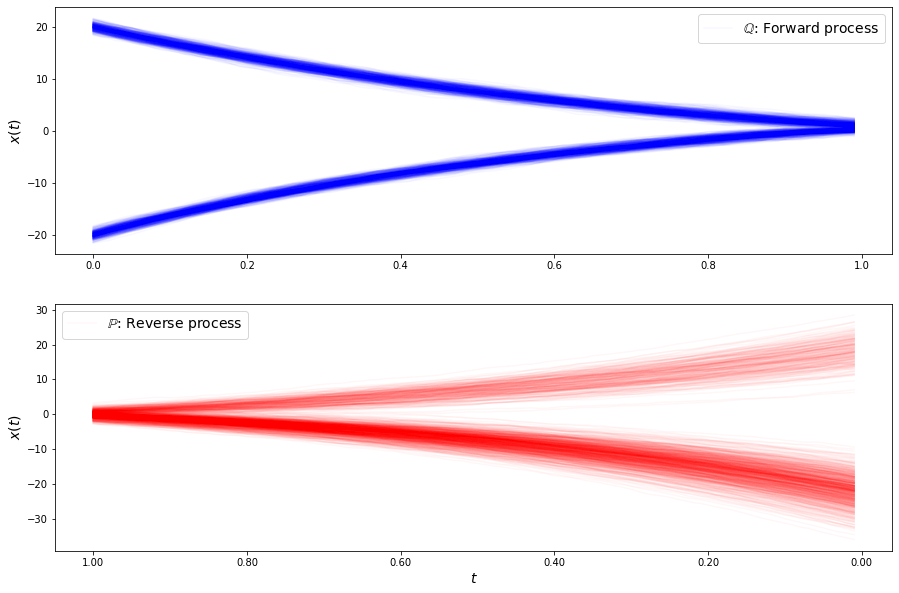

loss b 7.74506438794289
loss b 6.99140319414639
loss b 7.180125032077263
loss b 7.692462950650038
loss b 8.180467232601378
loss b 7.308383384512129
loss b 7.297117345693142
loss b 7.645448810930514
loss b 7.717081171104142
loss b 7.292440620165466
loss b 7.131555994981664
loss b 7.647742148933399
loss b 7.357509000715063
loss b 7.308775390332056
loss b 7.683222906518257
loss b 7.559928403714928
loss b 7.050697883214911
loss b 7.457610898429062
loss b 7.716090570394217
loss b 7.948810584187677
loss b 7.5524704880189395
loss b 7.105831828935553
loss b 7.337117486656747
loss b 7.575898655783196
loss b 7.450695720440657
loss b 7.481436830368134
loss b 7.880691103216433
loss b 7.074776387798937
loss b 6.710867448996654
loss b 7.0245387235600285
loss f 2.711513791180514
loss f 2.7173009963737087
loss f 2.7265047117356302
loss f 2.7357602331740942
loss f 2.6656467066430065
loss f 2.7079566178968135
loss f 2.6911685136943975
loss f 2.6778047811742174
loss f 2.666732190776407
loss f 2.694506924

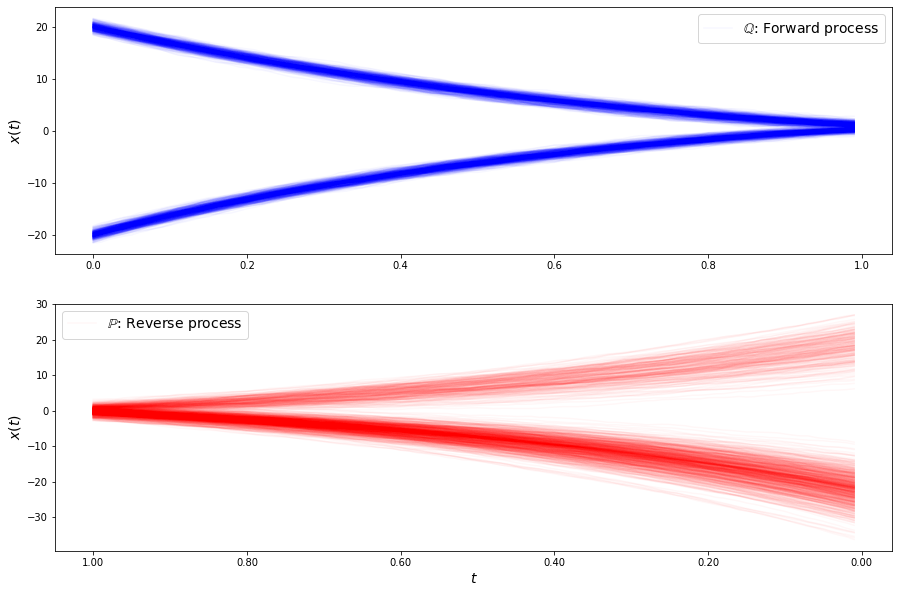

loss b 7.7161591794523945
loss b 6.952479919367844
loss b 7.374890802717947
loss b 7.298541246320033
loss b 7.235998126110137
loss b 7.656957658100618
loss b 7.42135613287092
loss b 7.313203951554406
loss b 7.993225596488947
loss b 7.360884256972388
loss b 7.130786370182192
loss b 7.321376491567616
loss b 7.621689919055735
loss b 7.452940547100079
loss b 7.585599844100117
loss b 7.800103894694034
loss b 7.02878948618366
loss b 8.031236612763452
loss b 7.378173330311854
loss b 7.775835299271856
loss b 7.639892914929989
loss b 7.201561004793376
loss b 7.820257031117874
loss b 7.7158870302354385
loss b 7.517871685456234
loss b 7.468974539099474
loss b 7.781836699623613
loss b 7.93907580920619
loss b 7.790999439388295
loss b 7.9717904236657
loss f 2.6781239105922734
loss f 2.6894432047641694
loss f 2.6910061020535276
loss f 2.6976920583902917
loss f 2.719353517112617
loss f 2.6922159512821553
loss f 2.630027101092555
loss f 2.6574557512568098
loss f 2.634230451304525
loss f 2.7430671972198

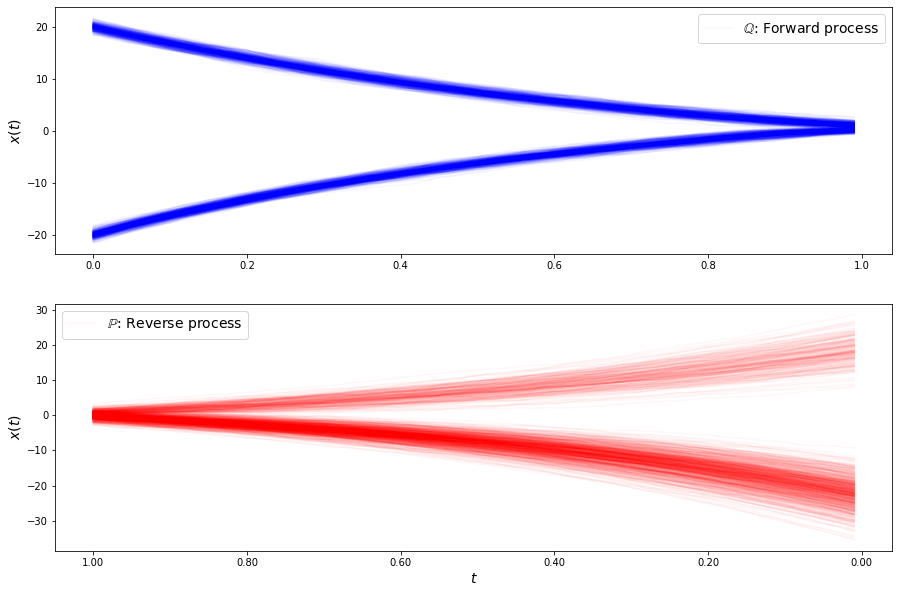

loss b 7.307314684702217
loss b 7.973587164177383
loss b 7.783284821650026
loss b 7.485507412731057
loss b 7.842986850245769
loss b 7.150869384759274
loss b 7.481475784463326
loss b 7.623733642847393
loss b 7.4276416727919
loss b 7.297018627734573
loss b 7.670023205872787
loss b 7.712559483535358
loss b 7.775558221448675
loss b 7.468522318177451
loss b 7.832282950099916
loss b 7.402745801850196
loss b 7.827565333777662
loss b 7.5708378266312835
loss b 8.12729518390212
loss b 7.198255691642046
loss b 7.77512054230685
loss b 7.550870940706759
loss b 7.971135952701759
loss b 7.769040088900944
loss b 7.433044814080883
loss b 7.5164021250990025
loss b 7.653369305907355
loss b 7.87000210107001
loss b 7.908511180643564
loss b 7.6335537047303035
loss f 2.6773296457969673
loss f 2.6459556156331634
loss f 2.635802866985458
loss f 2.687457003673655
loss f 2.672242326327942
loss f 2.678696625792757
loss f 2.664723788604809
loss f 2.6295270783492395
loss f 2.6760985746257737
loss f 2.68277642642112

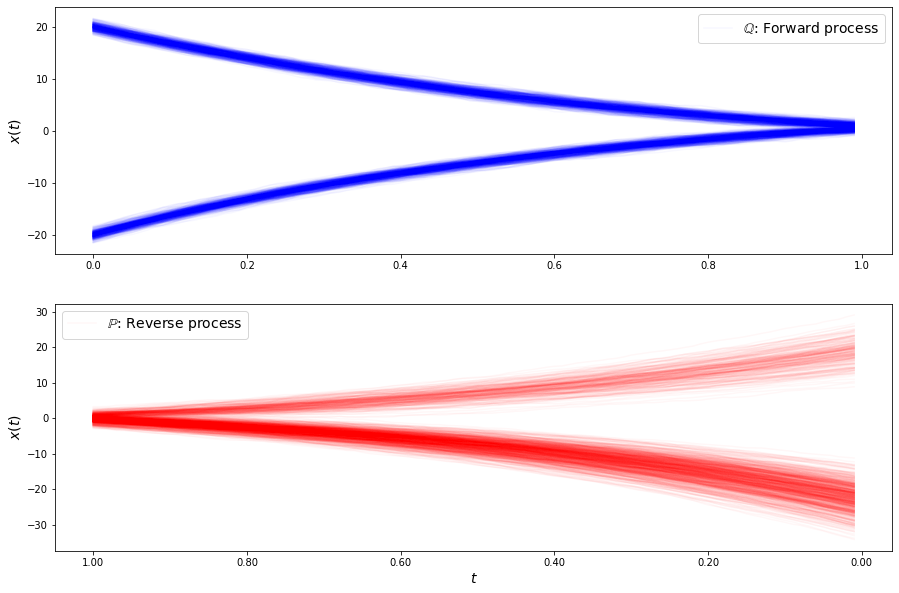

loss b 7.5919984173098864
loss b 8.005221251582089
loss b 7.404900710939525
loss b 7.576277801875666
loss b 7.533512323993491
loss b 7.591057291289735
loss b 7.943568724094682
loss b 8.111317814472327
loss b 7.98067710304519
loss b 8.046966288230035
loss b 7.704386581823607
loss b 7.6529923996788245
loss b 7.882808591051999
loss b 7.497590957624857
loss b 8.04102651366547
loss b 7.574522426960566
loss b 7.350164858508673
loss b 8.137125167140896
loss b 7.790751727878123
loss b 8.107824564195019
loss b 8.04630286325213
loss b 8.098815023975126
loss b 8.17647590875408
loss b 7.6609523581682675
loss b 7.9154378294799885
loss b 7.7389662697739405
loss b 7.527914403817012
loss b 7.670381375892588
loss b 7.588911447602016
loss b 7.715862993150473
loss f 2.6744250132552487
loss f 2.620914796448533
loss f 2.6715947666264803
loss f 2.676844992245184
loss f 2.65005061069383
loss f 2.6431931175029693
loss f 2.6379750388538086
loss f 2.6445112410049014
loss f 2.6257339075982498
loss f 2.6495727819

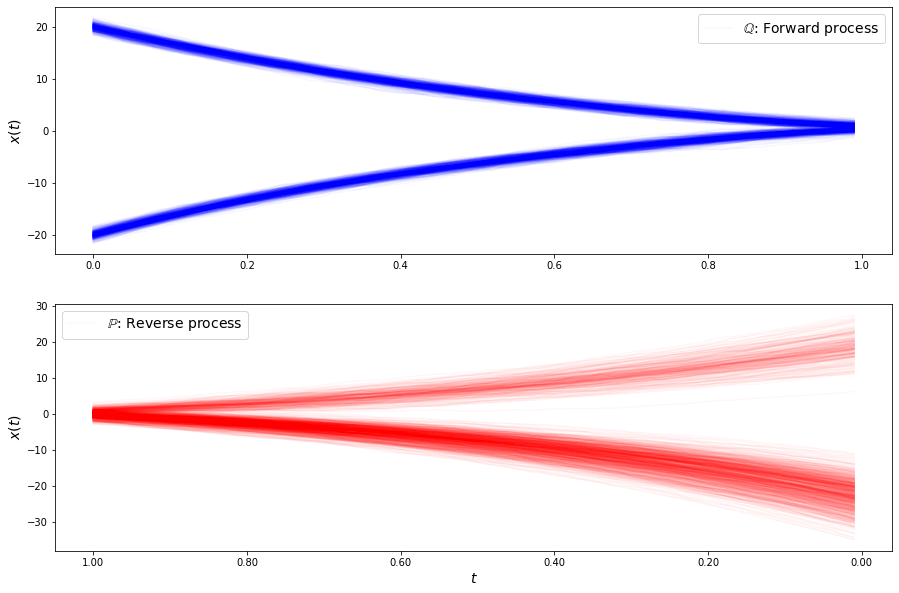

loss b 7.766489645271103
loss b 7.367693148974726
loss b 7.801901621825684
loss b 7.644413171318298
loss b 8.16990279743706
loss b 7.720771973069508
loss b 7.817104991123935
loss b 7.611125250115176
loss b 7.733028083374953
loss b 7.73599791131253
loss b 7.535265555538403
loss b 7.879620892543442
loss b 7.94073034597069
loss b 7.970091552458417
loss b 7.961538831965013
loss b 7.8033473391039205
loss b 8.222388785770194
loss b 7.553186072080962
loss b 7.595790965977394
loss b 8.125637418987388
loss b 8.112784946196388
loss b 7.630160251666977
loss b 7.72123171140914
loss b 8.141045399761621
loss b 7.356411082310973
loss b 7.918511499489532
loss b 7.864081400431254
loss b 7.956712263986827
loss b 8.159095814867507
loss b 7.673314856832541
loss f 2.6288615901616557
loss f 2.6362299849199626
loss f 2.643383240882987
loss f 2.6009903099338496
loss f 2.607693213322399
loss f 2.6211544380712835
loss f 2.626372922668897
loss f 2.634220524393407
loss f 2.5995639601798772
loss f 2.60170933990157

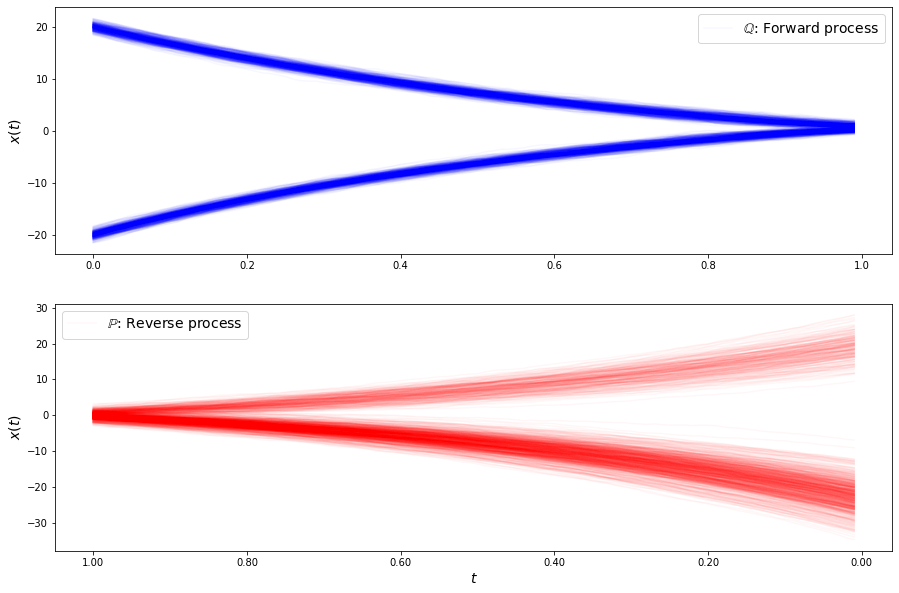

loss b 7.4516905136854605
loss b 7.4879835210311905
loss b 7.868764820326641
loss b 7.76102262228462
loss b 7.8856645438807
loss b 7.398783592175403
loss b 8.051945352107902
loss b 7.88460862947835
loss b 7.379373320476774
loss b 7.923746900771595
loss b 7.650909841795906
loss b 7.724944260731451
loss b 7.722732274321345
loss b 7.76940787220636
loss b 7.815983658309497
loss b 7.626167531849401
loss b 8.084918997138773
loss b 8.389092262790317
loss b 7.870445443936399
loss b 7.943276208429383
loss b 7.56662355112821
loss b 8.154936791988103
loss b 7.777921505992653
loss b 7.962016193397687
loss b 7.801596778532781
loss b 7.556471598622501
loss b 7.4075264976870745
loss b 7.690040470938755
loss b 7.73134093819205
loss b 7.755176459687524
loss f 2.6593273329543403
loss f 2.6185666682114945
loss f 2.651618704085545
loss f 2.5882839983486337
loss f 2.6033264697180067
loss f 2.687517397004605
loss f 2.638431830864098
loss f 2.5851084761974508
loss f 2.6200568244436
loss f 2.6177525113046736


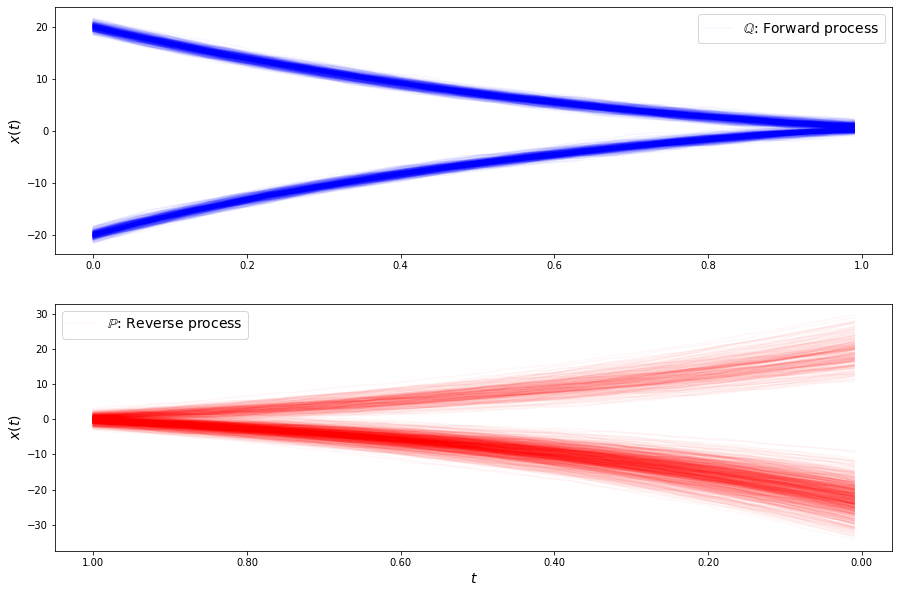

loss b 7.653471747449386
loss b 8.088465915007893
loss b 7.496551804979058
loss b 7.569732773489403
loss b 7.631323023862136
loss b 7.9185104307833605
loss b 7.892503009537117
loss b 8.502203163554444
loss b 8.205561728885339
loss b 8.219405247500577
loss b 7.589147561116974
loss b 7.71678047510643
loss b 7.828687558152952
loss b 8.082907753885312
loss b 8.137858005552454
loss b 7.444246959490509
loss b 7.9969749705262805
loss b 8.0799365762212
loss b 7.764623836379672
loss b 7.73426352367191
loss b 8.12810382561487
loss b 7.841562183554994
loss b 7.879413466494174
loss b 7.60426885408808
loss b 8.659335458804826
loss b 7.940122838770771
loss b 8.171014836969672
loss b 7.937138139488004
loss b 7.990519055619195
loss b 8.320673560944718
loss f 2.605144342510822
loss f 2.677951789306881
loss f 2.6413945765122637
loss f 2.65104957603241
loss f 2.633733195424537
loss f 2.6492274003852057
loss f 2.615083145362044
loss f 2.666896784757673
loss f 2.6458543259844363
loss f 2.6126573587608255
l

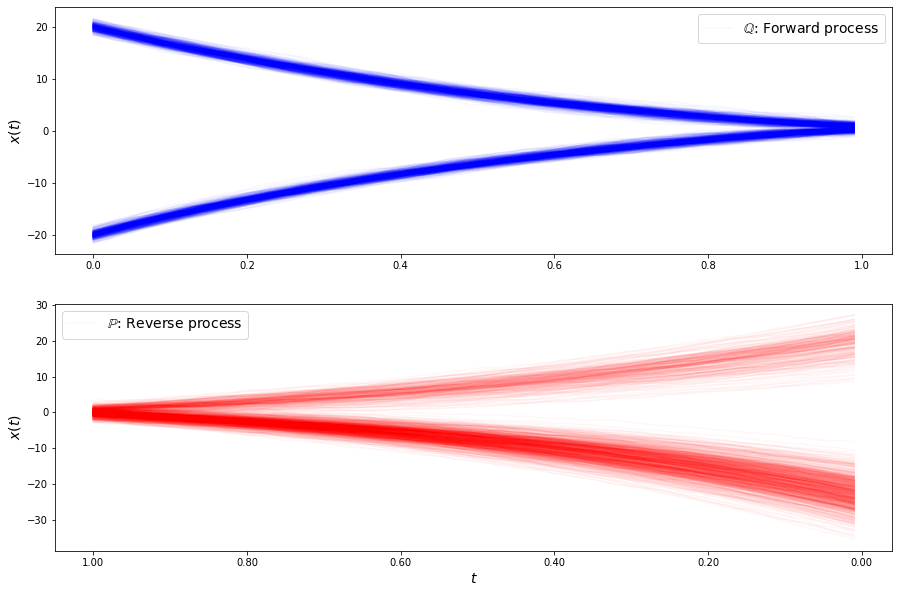

loss b 8.074191130948648
loss b 7.822520370616219
loss b 7.810168983136546
loss b 8.02835429153147
loss b 7.985957549643723
loss b 8.19950591910455
loss b 7.963141029443454
loss b 7.86036279432703
loss b 8.053011844073602
loss b 8.125525007857203
loss b 8.015249921112272
loss b 8.228368701342534
loss b 7.581384678324485
loss b 8.347436948564132
loss b 8.05256878685334
loss b 8.349905366557477
loss b 7.754961631314386
loss b 8.08053666745482
loss b 7.949567941336811
loss b 8.167343844912956
loss b 8.187190664594338
loss b 7.841371782284111
loss b 8.150153377068216
loss b 8.015115996308218
loss b 7.606756291718817
loss b 8.133913717466905
loss b 7.807491203145793
loss b 7.796163650895787
loss b 7.53843572394359
loss b 8.004462828839838
loss f 2.6476514795367683
loss f 2.644821549458853
loss f 2.65038035150301
loss f 2.622672252238806
loss f 2.6597807019814272
loss f 2.6167750072737377
loss f 2.6515675395239953
loss f 2.6269627463268708
loss f 2.6450483462211993
loss f 2.631587730857323
l

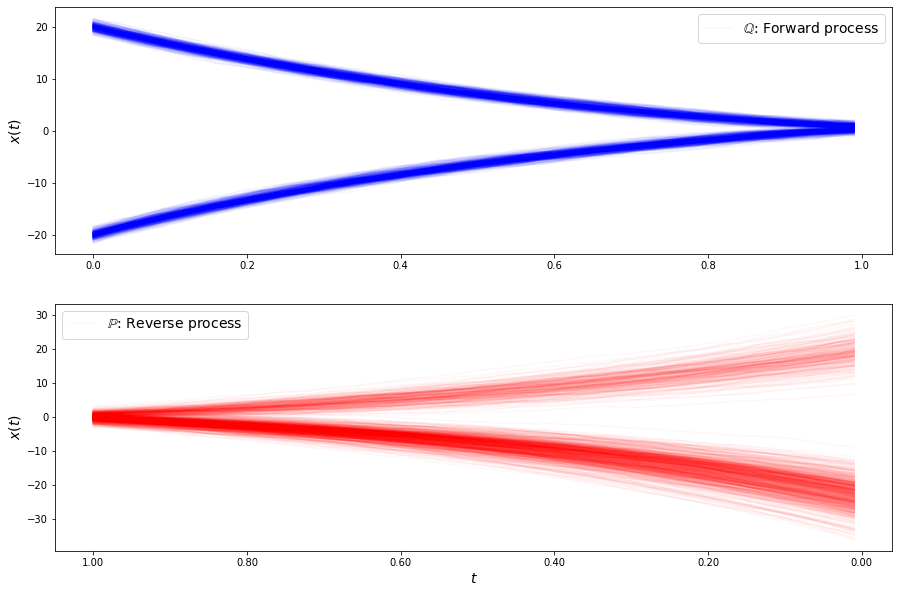

loss b 8.383062265284309
loss b 7.789634426753477
loss b 8.13936730773295
loss b 8.427005150863835
loss b 7.954834155503454
loss b 7.956664321704869
loss b 7.759561634340707
loss b 7.680216759778775
loss b 8.085969459229734
loss b 7.954492839072058
loss b 7.667038417213599
loss b 8.440873353910915
loss b 7.474277730538228
loss b 8.08332214775078
loss b 8.011394885244538
loss b 8.409658296622966
loss b 7.9437684432962135
loss b 8.200637936868533
loss b 7.9373344365848775
loss b 8.132359030407525
loss b 8.38464595257252
loss b 8.707038340972176
loss b 8.227402432741794
loss b 8.1006794390111
loss b 8.094763450772954
loss b 8.130414738281221
loss b 7.466283975781975
loss b 8.300289918612254
loss b 7.948275786862574
loss b 8.262057556612948
loss f 2.6166801405335876
loss f 2.6749350276808443
loss f 2.655521441848071
loss f 2.6499021099608235
loss f 2.6590569995738926
loss f 2.7038591429821
loss f 2.6699399579515526
loss f 2.6983670343636343
loss f 2.646274666261732
loss f 2.682263966627337

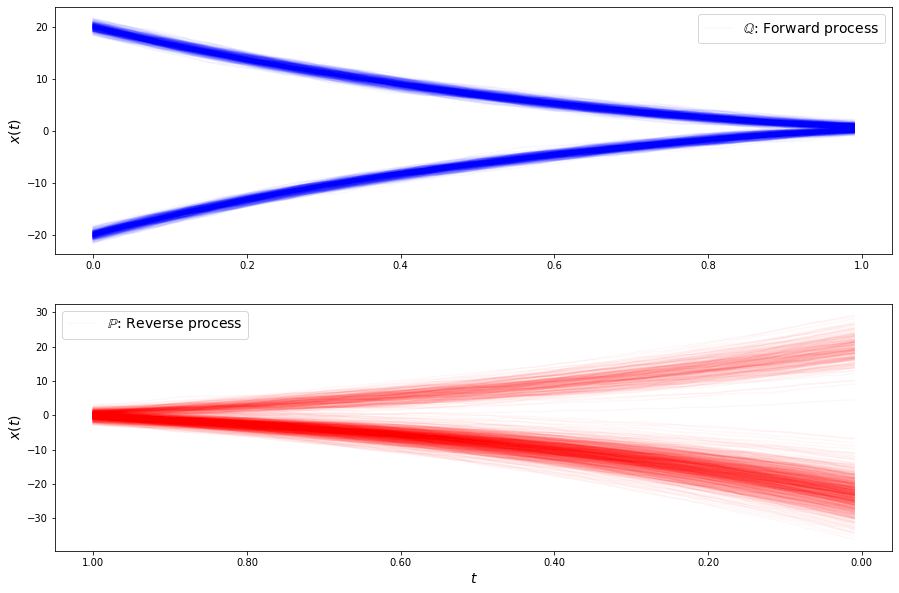

loss b 8.477172087266469
loss b 7.819618924510322
loss b 7.91170722681202
loss b 8.252926163460081
loss b 8.13814206632172
loss b 7.919620312487176
loss b 8.107506126743875
loss b 8.53869808056072
loss b 7.99336184509823
loss b 8.101459903742057
loss b 7.875066850235785
loss b 7.976631012732583
loss b 7.735692391116803
loss b 8.10154510483095
loss b 8.483300579423794
loss b 8.206171555860823
loss b 8.03821778609841
loss b 7.8454504252842
loss b 8.52506515278091
loss b 7.437552389053518
loss b 7.720387478913918
loss b 8.014275658821857
loss b 8.415138938138274
loss b 7.96475309970843
loss b 8.336460764967827
loss b 8.298110788914876
loss b 7.90227339738954
loss b 8.09785458635633
loss b 8.254421500746144
loss b 7.727383601479978
loss f 2.7014473676192323
loss f 2.6208157439003252
loss f 2.6689039809318897
loss f 2.668375243882118
loss f 2.6989893453986067
loss f 2.6800881221802118
loss f 2.6678275819259993
loss f 2.638287524352737
loss f 2.688648090030376
loss f 2.6671627271014464
loss 

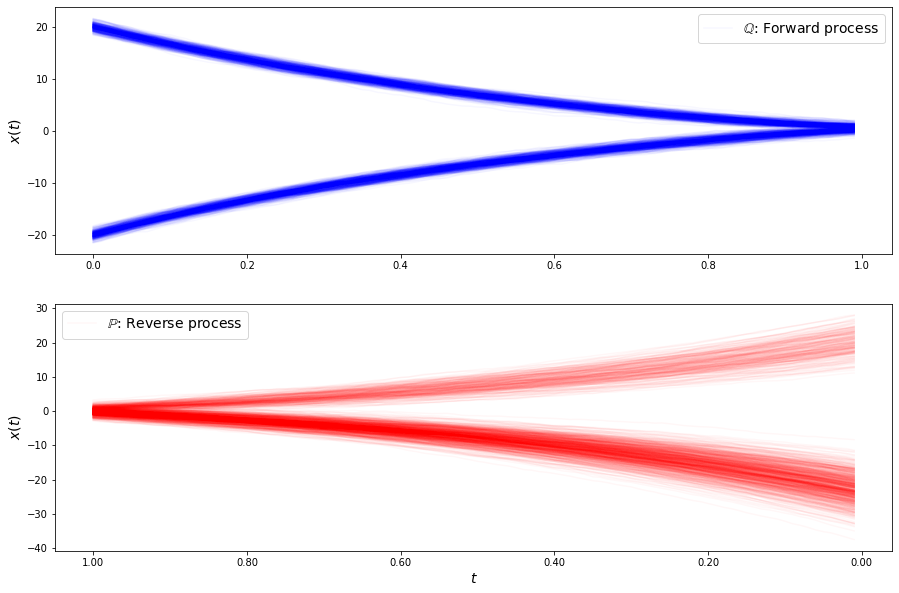

loss b 7.778068955922032
loss b 8.173145034206458
loss b 8.050415393899852
loss b 8.447330794215032
loss b 7.970027048312432
loss b 7.842588091295274
loss b 7.965388293207974
loss b 7.979666927719253
loss b 7.933737649307834
loss b 8.214182039136492
loss b 8.620980102112323
loss b 8.325253152295456
loss b 7.9432294188342
loss b 8.324314880871782
loss b 8.065620159294863
loss b 7.751829705218202
loss b 8.4247553294619
loss b 7.941025279177839
loss b 8.20922457449863
loss b 8.103497471888925
loss b 8.064785870151074
loss b 8.145137175303935
loss b 7.93055928899315
loss b 7.9704384509115345
loss b 7.826625046462446
loss b 8.30706544886587
loss b 8.270254136506834
loss b 8.112876427221735
loss b 7.8315298075885185
loss b 7.977671530830958
loss f 2.708938878562643
loss f 2.638039218863316
loss f 2.691558652231002
loss f 2.706995864777849
loss f 2.70203827578954
loss f 2.7231196143057668
loss f 2.6887656658348043
loss f 2.7292855285324857
loss f 2.68756310270969
loss f 2.694147665933054
loss

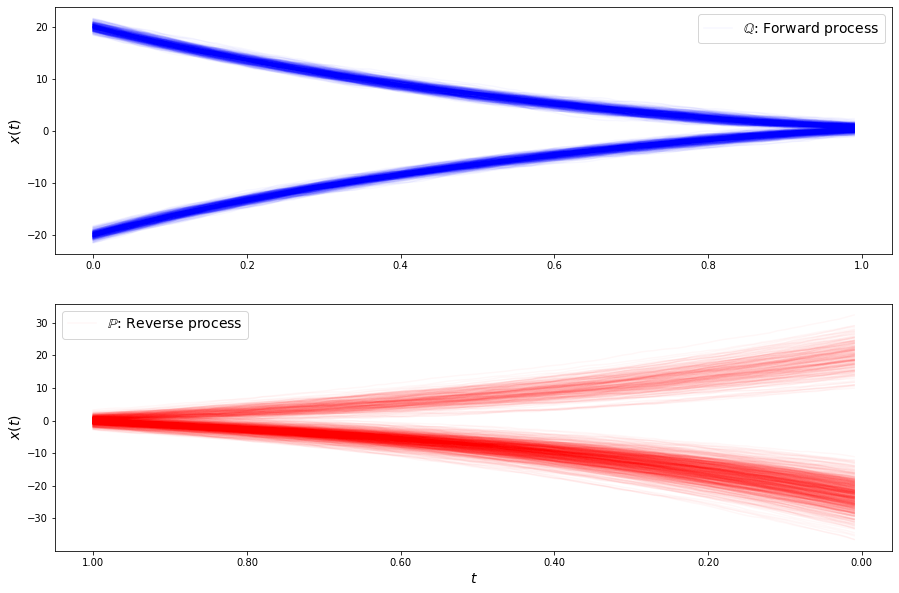

loss b 8.212364558134498
loss b 7.984596252467444
loss b 8.09103728947161
loss b 7.87592784437184
loss b 8.168131496791665
loss b 8.295353284955986
loss b 7.86396043923057
loss b 7.800369751834619
loss b 8.362656973622396
loss b 8.207528829559605
loss b 8.614406244274285
loss b 7.6912078733567935
loss b 8.124530998322
loss b 8.240154580240583
loss b 8.790776248465543
loss b 8.305975003414954
loss b 7.6700461460558165
loss b 8.107153019583945
loss b 7.846896030029884
loss b 8.26355050298777
loss b 8.152283451324294
loss b 8.02034606722283
loss b 8.088148929556626
loss b 8.167905528451936
loss b 8.072202056977035
loss b 7.996188515146332
loss b 8.070839317256242
loss b 7.907031570532864
loss b 8.431499094562678
loss b 8.202027028105672
loss f 2.6975010580075973
loss f 2.6991115654703073
loss f 2.740694565132046
loss f 2.73569775825207
loss f 2.703144208069152
loss f 2.6941216043345677
loss f 2.7233991319174735
loss f 2.7116743820659948
loss f 2.722731578401663
loss f 2.7133905921100587
l

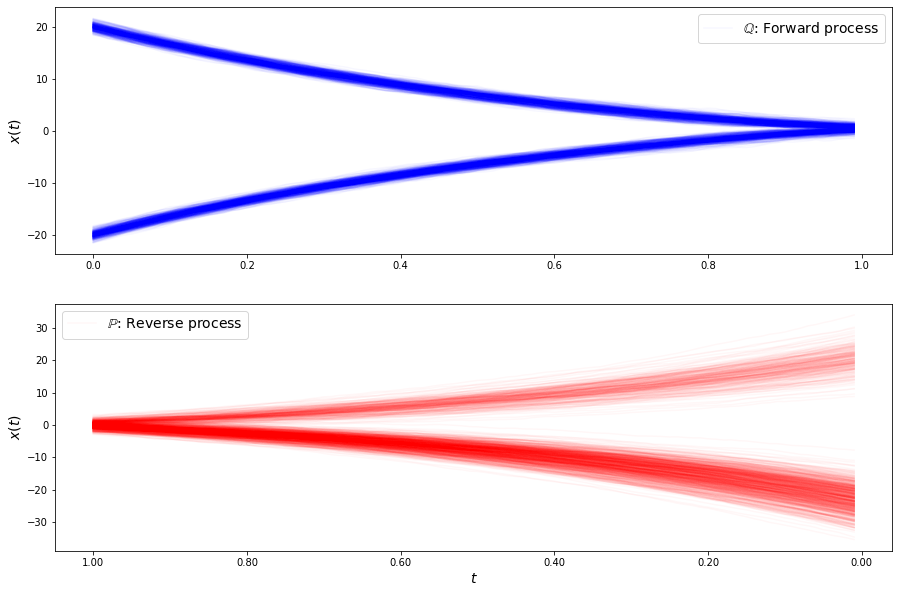

loss b 8.463761505642779
loss b 7.8900089467394405
loss b 8.14846746291318
loss b 8.311831912014977
loss b 8.397360523523586
loss b 8.601688142892394
loss b 8.120288861432378
loss b 8.331270873766332
loss b 8.09141170633608
loss b 8.402325422041953
loss b 8.123776856333128
loss b 7.8600804105494495
loss b 8.434755723224784
loss b 7.7606496939693885
loss b 7.948861475822578
loss b 8.502217533630354
loss b 7.9381219174352164
loss b 8.200860483039003
loss b 8.045774722817576
loss b 8.165999366912864
loss b 8.088953786620905
loss b 8.414541370908731
loss b 8.382363307553945
loss b 8.18458828576845
loss b 7.757597071712016
loss b 8.335954458617822
loss b 8.178085921297669
loss b 8.16561938567081
loss b 7.931465316741185
loss b 7.959221104026075
loss f 2.724006582405712
loss f 2.7363386294571987
loss f 2.7287911018137185
loss f 2.7164510619165307
loss f 2.7501140476101744
loss f 2.724849239104839
loss f 2.714263269373093
loss f 2.73067951432595
loss f 2.7202881242827144
loss f 2.692055421506

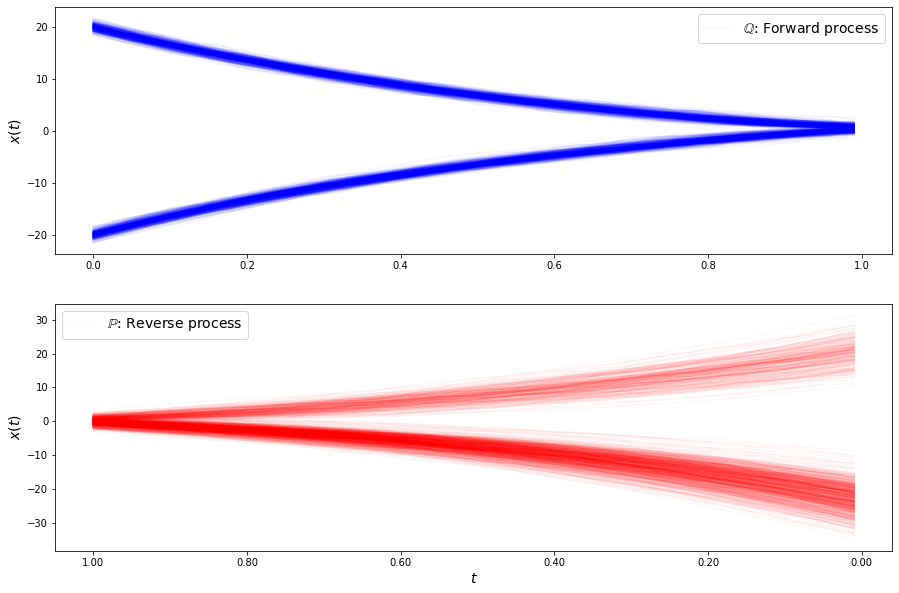

loss b 8.32321699094241
loss b 8.158750829149719
loss b 8.148333252020512
loss b 8.240281321042175
loss b 8.126244136693028
loss b 8.32701285735248
loss b 7.910498420660293
loss b 8.053680907933552
loss b 8.443174615916762
loss b 8.275677606927353
loss b 8.19193257919926
loss b 8.218892906482587
loss b 8.02377182622191
loss b 8.066895853476904
loss b 8.274285721369235
loss b 8.262216993866476
loss b 8.365781732409797
loss b 8.07516693512361
loss b 7.940329487638636
loss b 7.703593170210477
loss b 7.887911653518672
loss b 8.166041796634353
loss b 8.200617061626478
loss b 8.312594870466633
loss b 7.9853628713606195
loss b 8.185603183991315
loss b 7.986792809488498
loss b 8.055375565720777
loss b 8.467962582660132
loss b 7.735689814510511
loss f 2.7353787149756177
loss f 2.7321436326837025
loss f 2.7078429223039646
loss f 2.736173536271764
loss f 2.769226760577259
loss f 2.730157519544367
loss f 2.7496899929140395
loss f 2.737508387527134
loss f 2.710417616143365
loss f 2.7320360739088385

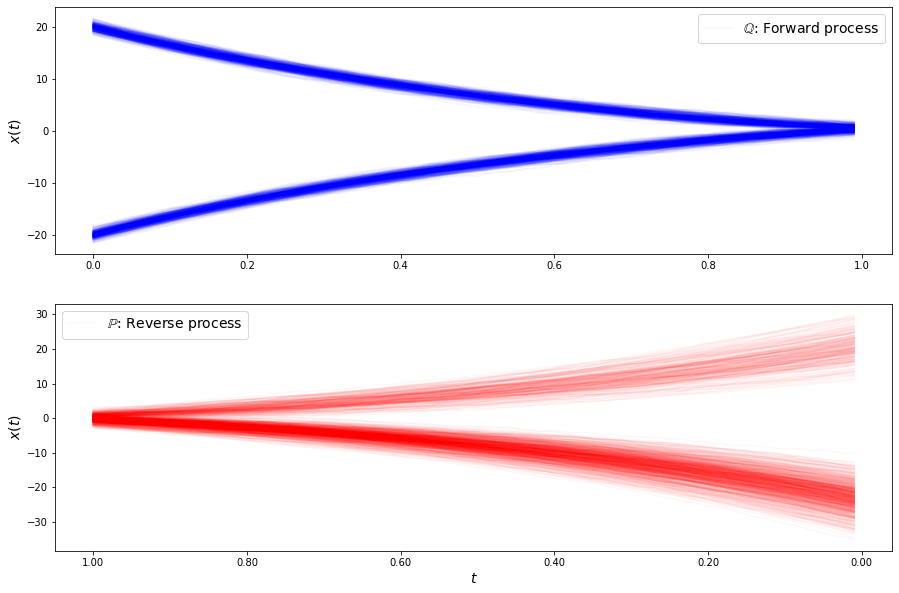

loss b 8.344096771719572
loss b 7.929097310413407
loss b 8.193317265811814
loss b 8.149432327592475
loss b 8.07982569093055
loss b 8.362720228288516
loss b 8.070676644404696
loss b 7.808796210712082
loss b 8.28140205010103
loss b 8.12369217362619
loss b 8.065634095352534
loss b 8.01948060469567
loss b 8.39670532455576
loss b 8.2713804185905
loss b 8.203526061509756
loss b 7.895841740330184
loss b 8.187533862675458
loss b 8.200152039335457
loss b 8.342884550724904
loss b 8.301600779164616
loss b 8.03438625950236
loss b 8.048114359663531
loss b 8.353071143512755
loss b 7.94942489536684
loss b 8.1045880019275
loss b 7.861166127368188
loss b 8.241492232016391
loss b 7.936348621595908
loss b 7.949537040249416
loss b 8.118922095947667
loss f 2.752254106239269
loss f 2.7570604800006144
loss f 2.718181339313292
loss f 2.744319327334848
loss f 2.7195849169790782
loss f 2.7620620894935732
loss f 2.7448977554042826
loss f 2.7363409254062474
loss f 2.7311393847661374
loss f 2.773718309213993
loss 

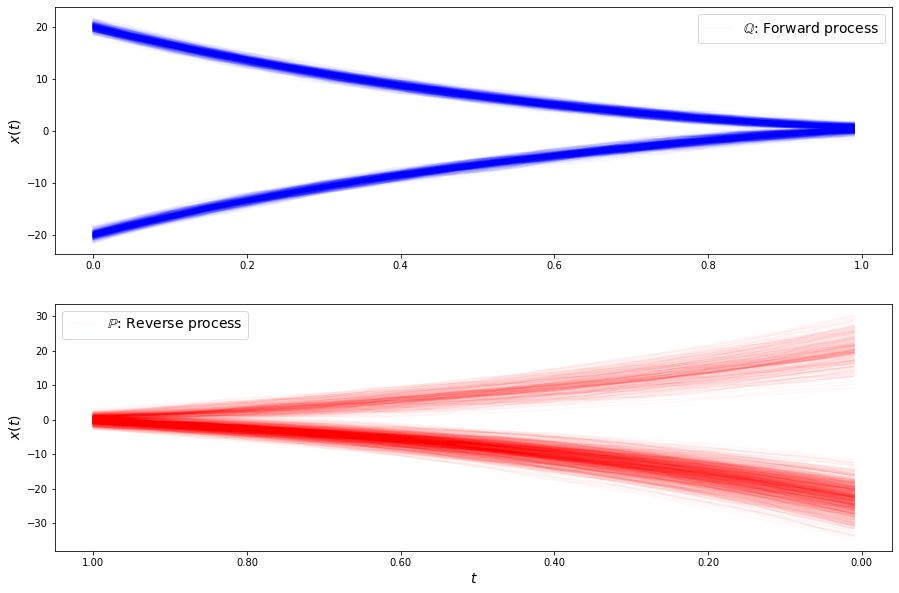

loss b 7.920111803381376
loss b 8.372489877013242
loss b 8.272703878751834
loss b 8.30640958957159
loss b 8.546350908655773
loss b 7.977367697771307
loss b 8.049376767853236
loss b 8.19214486614788
loss b 7.708692235351015
loss b 8.040186278941393
loss b 7.824595648301319
loss b 8.15788071995036
loss b 7.975635903859445
loss b 7.655157141795334
loss b 8.07882575428471
loss b 7.926367523895819
loss b 7.696596310915071
loss b 7.96767956166669
loss b 8.22156730400415
loss b 7.847809731131619
loss b 7.924964762732816
loss b 7.957128291451998
loss b 8.142537076005555
loss b 8.459191002918816
loss b 7.544922993268109
loss b 7.8213652993076295
loss b 8.055223288151804
loss b 7.875381268071367
loss b 8.43060663593835
loss b 8.369234360313905
loss f 2.718407294117014
loss f 2.7314499282476903
loss f 2.7599163617746325
loss f 2.748336843841802
loss f 2.7615186280265114
loss f 2.724243225538211
loss f 2.741268226976757
loss f 2.7235069183847798
loss f 2.7310311807877183
loss f 2.756429268250493
l

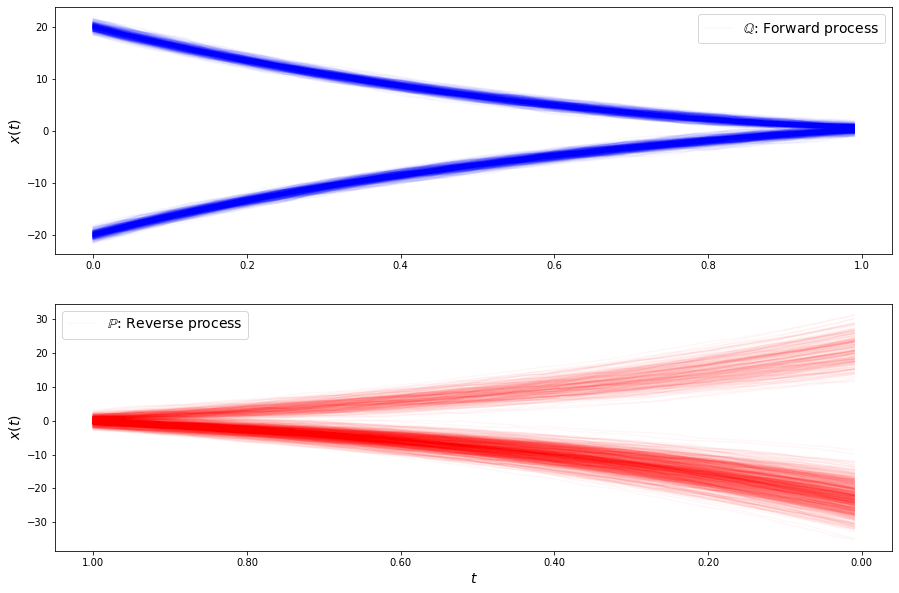

loss b 8.283606775743515
loss b 8.42260180553734
loss b 8.006965005040117
loss b 8.213865503274068
loss b 7.96780327286078
loss b 7.722018763405641
loss b 8.250680866803787
loss b 8.210366566615797
loss b 8.066579996408022
loss b 7.6081770889905584
loss b 8.372377868395152
loss b 8.196079147668241
loss b 7.841312575747876
loss b 8.197649766278452
loss b 7.898568847133256
loss b 8.160540054627406
loss b 8.011427278077624
loss b 8.227149608853326
loss b 7.9965240657759145
loss b 8.369803778475
loss b 7.676606997158428
loss b 8.097885756453419
loss b 8.06412247624214
loss b 7.760664863450429
loss b 7.979534008852824
loss b 8.168842383690425
loss b 7.999168520449522
loss b 7.580612742575512
loss b 7.842974692955829
loss b 7.6742345358369946
loss f 2.710430931600398
loss f 2.738041995833009
loss f 2.733804249138081
loss f 2.7117602898090802
loss f 2.7237325843719424
loss f 2.7298233991140193
loss f 2.727763788143508
loss f 2.786157777859546
loss f 2.736365365887469
loss f 2.7376896957819565

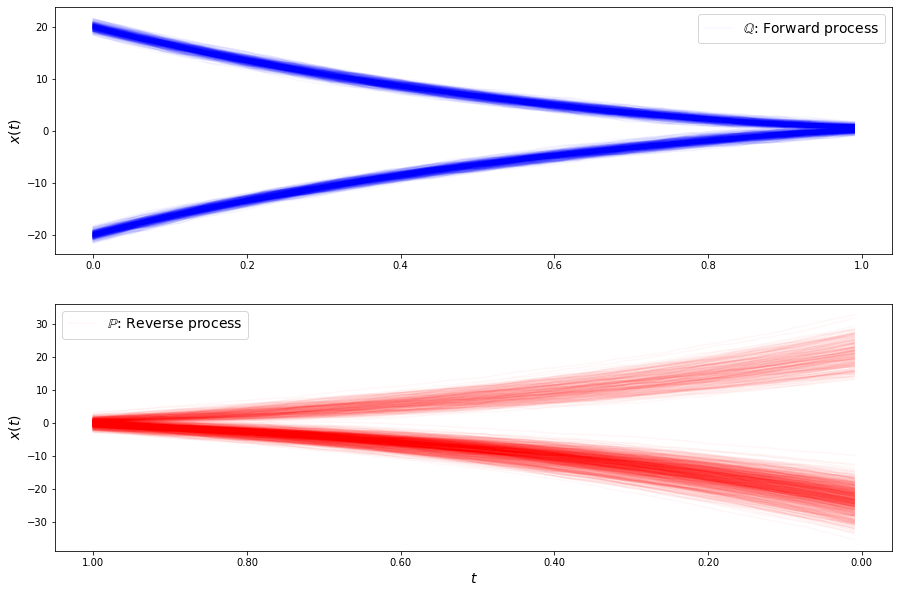

loss b 8.075665119373369
loss b 7.436881742530373
loss b 7.88683037939349
loss b 7.652635246993018
loss b 8.224155554514468
loss b 8.102333907889115
loss b 7.952883514812464
loss b 7.732999469703977
loss b 8.088085968244545
loss b 8.311498934402124
loss b 8.127033169269398
loss b 8.08682672564071
loss b 7.560245831045227
loss b 7.89230931806831
loss b 8.205517105286297
loss b 7.923911129933127
loss b 7.950187322974373
loss b 7.705238656260592
loss b 7.697293203788674
loss b 8.340914447453672
loss b 8.159032262805647
loss b 7.884457084852237
loss b 7.9499997824141975
loss b 7.60745831910498
loss b 7.811304824108631
loss b 8.26611270756045
loss b 8.057357569754323
loss b 8.074216904227473
loss b 8.114200721714287
loss b 7.784090077743796
loss f 2.6817108036251245
loss f 2.7297755569602713
loss f 2.7321615483343096
loss f 2.7229043225832563
loss f 2.6886241146272156
loss f 2.7212399563317615
loss f 2.7081595592004883
loss f 2.7057806847862045
loss f 2.734998783527206
loss f 2.704220120812

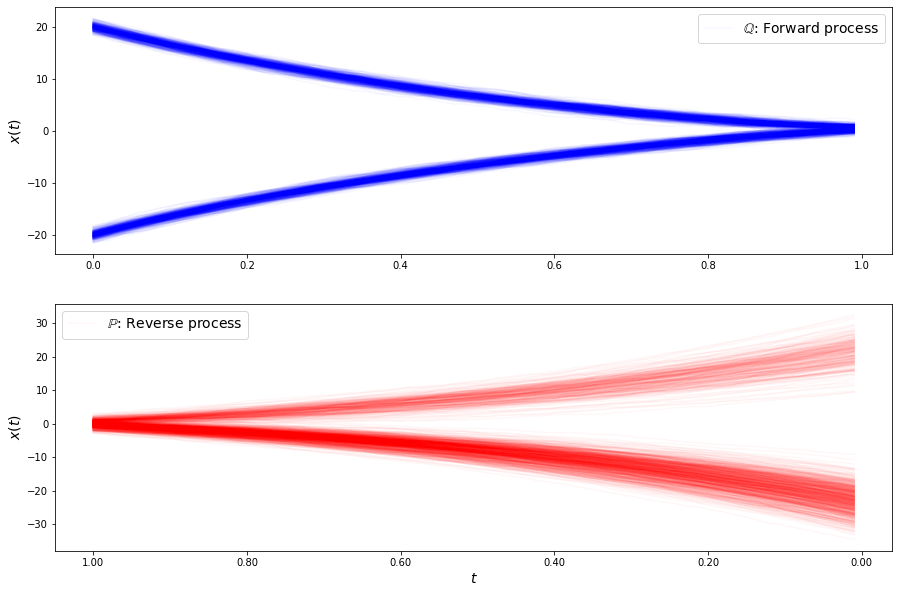

loss b 7.853634063464999
loss b 7.701071180871699
loss b 8.293693947842847
loss b 8.229684337207756
loss b 7.938074187323157
loss b 7.890501106555819
loss b 7.936029094373489
loss b 7.815859709547544
loss b 7.957294664355438
loss b 7.817195341421486
loss b 8.05766117770774
loss b 7.468499127863991
loss b 8.213548042957799
loss b 7.713829898821962
loss b 7.713632985452714
loss b 7.864176622443796
loss b 7.57118466890471
loss b 8.049272416109774
loss b 7.572413697390099
loss b 7.8278232950200115
loss b 7.726079899250061
loss b 8.395423165957496
loss b 8.005852892979123
loss b 7.6525214307070275
loss b 7.692960130957281
loss b 7.651786536394771
loss b 7.5985998893643645
loss b 8.377188264202799
loss b 7.798126049710054
loss b 7.939431644837691
loss f 2.6988764854731957
loss f 2.7246529406937228
loss f 2.7374724576123888
loss f 2.710020393876798
loss f 2.704306266002334
loss f 2.7071751549874086
loss f 2.695410889101127
loss f 2.69326128698171
loss f 2.652045688558952
loss f 2.692130739228

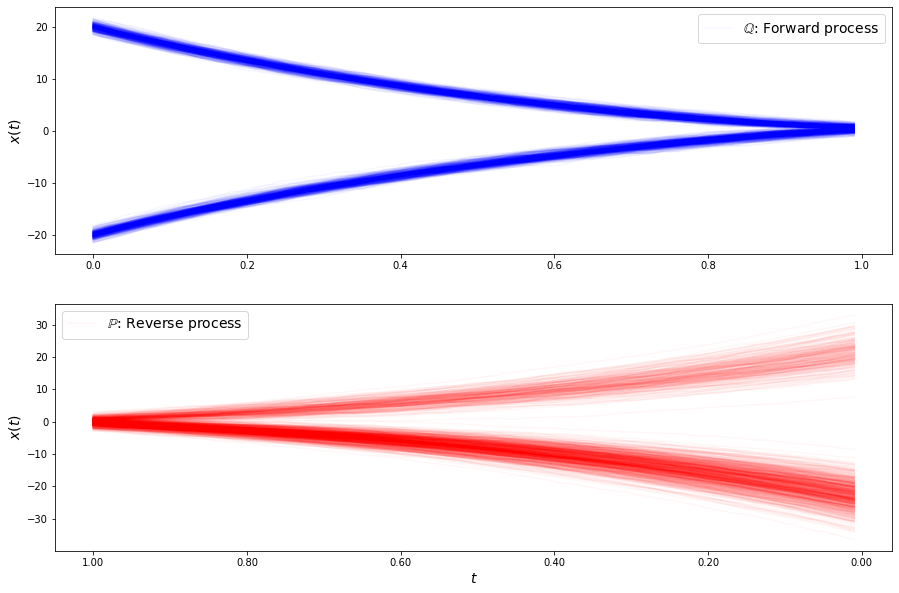

loss b 7.522786974746169
loss b 7.87057921811447
loss b 7.917632945489867
loss b 8.273052545226824
loss b 7.533403777781926
loss b 7.961610619795569
loss b 7.939688349676427
loss b 7.6935979252276585
loss b 7.699784257532648
loss b 7.724714375881379
loss b 8.184979173590037
loss b 8.013851668509659
loss b 7.926455567109821
loss b 7.285858907036054
loss b 7.484477319316058
loss b 7.386080957373191
loss b 7.724112785425866
loss b 7.499916298089345
loss b 7.137395104255346
loss b 7.859664239588601
loss b 7.615184016995204
loss b 7.817170490895987
loss b 7.326784071896686
loss b 8.113916689632878
loss b 7.736556094541225
loss b 7.947724820978901
loss b 8.087415282016178
loss b 7.829837360596711
loss b 7.4939028258189095
loss b 7.5763316260518865
loss f 2.6572536787343406
loss f 2.681496187230736
loss f 2.6651377292273444
loss f 2.644579583684133
loss f 2.653503141241246
loss f 2.680438333090961
loss f 2.67936549273843
loss f 2.6581264607179333
loss f 2.7055180036079993
loss f 2.63487277086

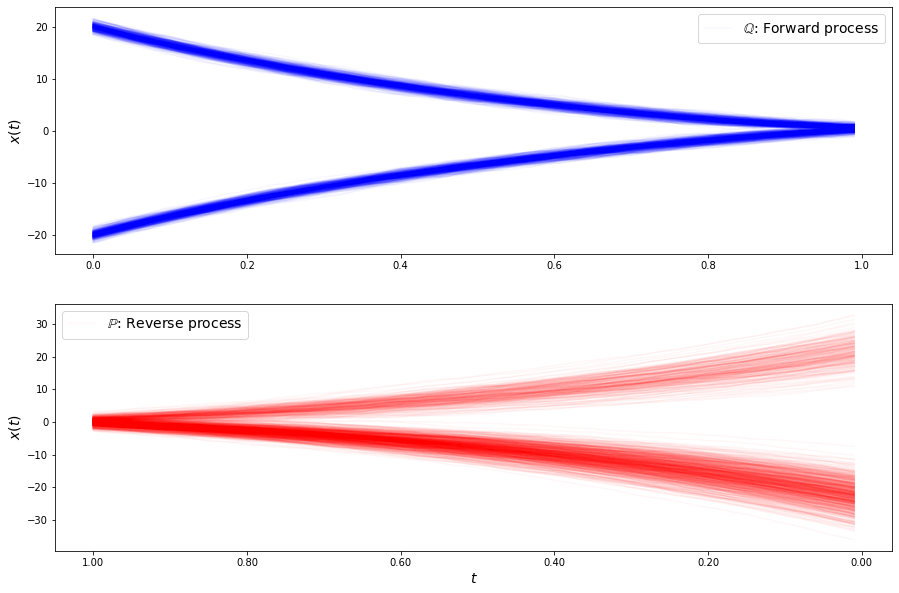

loss b 7.833889428746609
loss b 7.312609429181896
loss b 7.64843017219307
loss b 7.727486498631562
loss b 7.448538236936053
loss b 7.524912500128551
loss b 7.957960287441445
loss b 7.56158858555637
loss b 7.624012453592087
loss b 7.781617547379767
loss b 7.595749850079904
loss b 7.907908628480099
loss b 7.564213672661747
loss b 7.576024742395995
loss b 7.843801262381513
loss b 7.837891055736331
loss b 7.742979985323651
loss b 7.674590358137347
loss b 7.889564911892844
loss b 7.709803201123543
loss b 7.3756560223619445
loss b 7.527592235535683
loss b 7.36295222506588
loss b 7.519540864698612
loss b 7.509182486566896
loss b 7.238820639751729
loss b 7.631331940196013
loss b 7.866438781887736
loss b 7.365955000981273
loss b 7.817962978610669
loss f 2.626983446572648
loss f 2.669957486186939
loss f 2.670079260485816
loss f 2.6425770139371805
loss f 2.672353635587214
loss f 2.641205719738762
loss f 2.6506367938482978
loss f 2.6705413194212317
loss f 2.6679724864803647
loss f 2.66046996818438

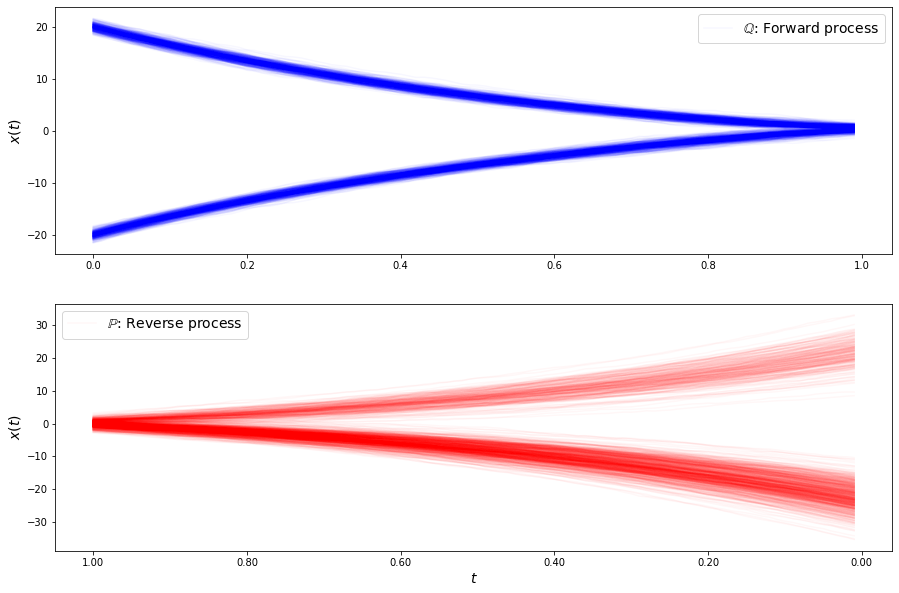

loss b 7.295434761016415
loss b 7.656798959104726
loss b 7.636045910869192
loss b 7.462672236527247
loss b 7.512181991870371
loss b 7.9197899729748835
loss b 7.960539392678424
loss b 7.574012039183498
loss b 7.598267138309071
loss b 7.05584507314509
loss b 7.858087816705709
loss b 7.193036479723899
loss b 7.797304344074468
loss b 7.999916621826438
loss b 7.606473599509073
loss b 7.5846019350616825
loss b 7.542119778539736
loss b 7.400481070124708
loss b 7.784178639620951
loss b 7.521744934392661
loss b 7.531720922476036
loss b 7.351005190784662
loss b 7.401179736944586
loss b 7.208817363361745
loss b 7.200196838111848
loss b 7.700928469977126
loss b 7.92537624191389
loss b 7.443616481998609
loss b 7.818320927731264
loss b 7.765237989389971
loss f 2.655891462104676
loss f 2.625887982704186
loss f 2.6424240450296987
loss f 2.6398074637796487
loss f 2.6468666863501658
loss f 2.6372616294715394
loss f 2.6393607467345688
loss f 2.6438571425590087
loss f 2.6544345184684484
loss f 2.656544578

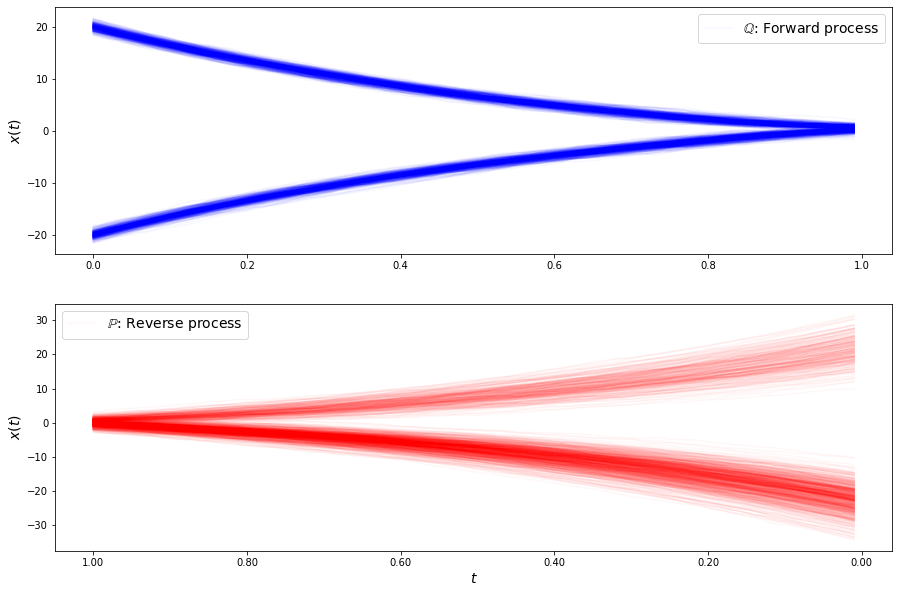

loss b 7.688822153478746
loss b 7.716823615591051
loss b 7.57586540891024
loss b 7.507348221423398
loss b 7.484973209550076
loss b 7.209307634383567
loss b 7.728111442623868
loss b 7.519417719301297
loss b 7.42652526485824
loss b 7.616390006181527
loss b 7.5009574693523655
loss b 7.511064315758659
loss b 7.382404087024298
loss b 7.535587504759629
loss b 7.200498769956534
loss b 7.621024815480448
loss b 7.652657201037455
loss b 7.935424379180559
loss b 7.303325953353896
loss b 7.261051948792202
loss b 7.524268580414862
loss b 7.579690785724031
loss b 7.018946342291319
loss b 7.790660490469821
loss b 7.977571028503869
loss b 7.394009087303547
loss b 7.875418225651709
loss b 7.7073551115558905
loss b 7.5478105134857945
loss b 7.508124873238059
loss f 2.6305118919666923
loss f 2.6113974134131297
loss f 2.608516691558268
loss f 2.638350929695562
loss f 2.6438655196844896
loss f 2.635953760058615
loss f 2.6347493304432463
loss f 2.6259167675924666
loss f 2.6379420379131724
loss f 2.648272929

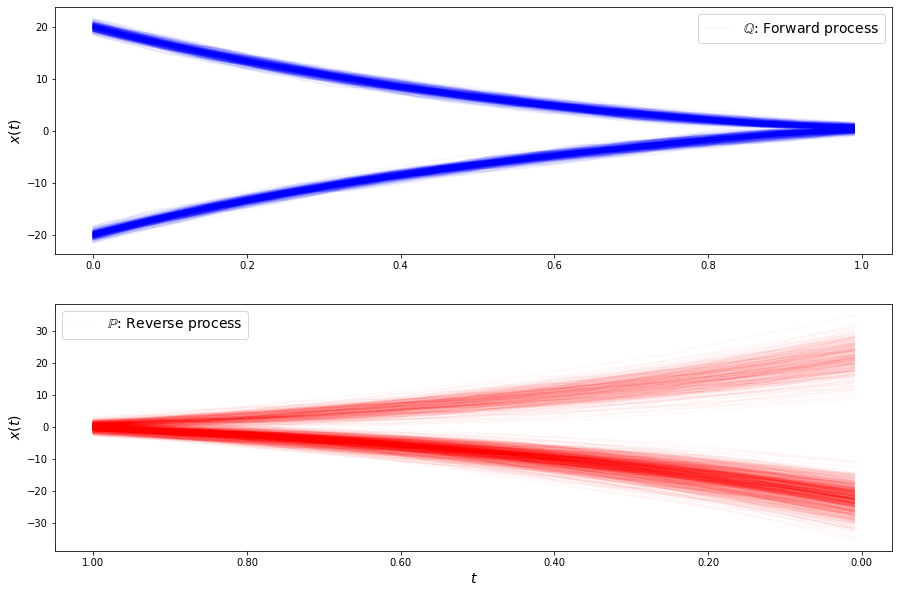

loss b 7.2928245435531105
loss b 7.601157756646736
loss b 7.209424103000444
loss b 7.375122397707204
loss b 7.251783660386175
loss b 7.431174519787141
loss b 7.188722807810707
loss b 7.356554493680197
loss b 7.923715917039332
loss b 7.71206402177989
loss b 7.391172670111907
loss b 7.346841361951753
loss b 7.547145189069396
loss b 7.539332431178457
loss b 7.229959537510087
loss b 7.151975501545581
loss b 7.619025936122592
loss b 7.467661276862657
loss b 7.492676612403349
loss b 6.978631267890235
loss b 7.439376097914749
loss b 7.548274998403485
loss b 7.647129347786128
loss b 7.537071124736254
loss b 7.472820778287461
loss b 7.625540477803891
loss b 7.260952124841762
loss b 7.451400334948369
loss b 7.196201537428698
loss b 7.188560836838151
loss f 2.6215577530779237
loss f 2.6398058953993564
loss f 2.6209487868614016
loss f 2.6205082628621925
loss f 2.620305584088922
loss f 2.6442146691038935
loss f 2.6296804224595838
loss f 2.615622913722403
loss f 2.6294332271914733
loss f 2.647325961

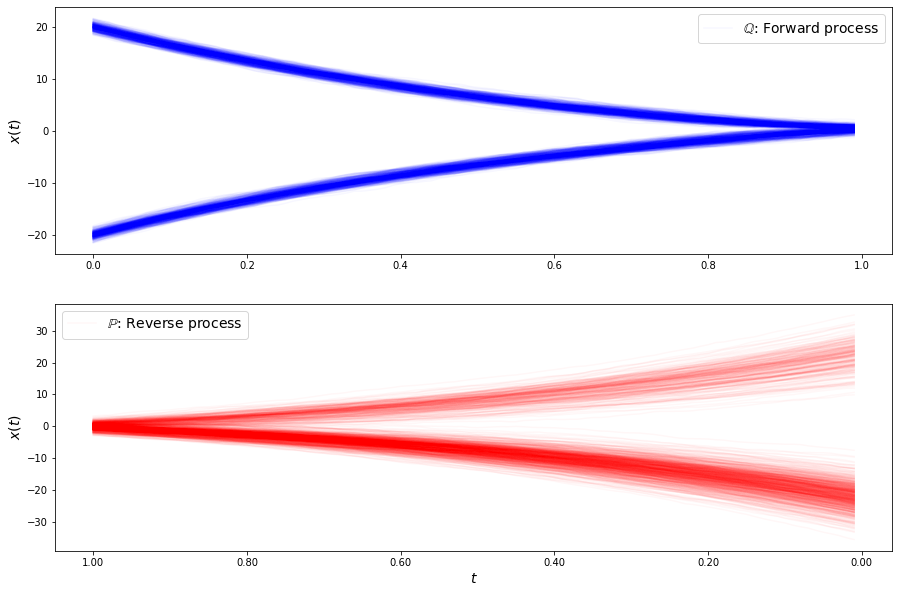

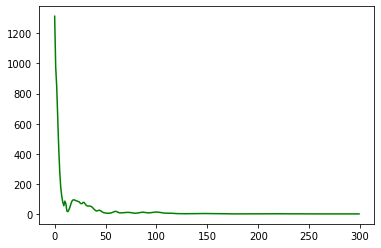

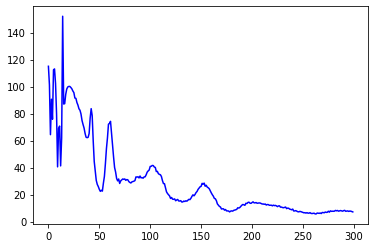

In [11]:
torch.autograd.set_detect_anomaly(True)
c.fit(300, 30, burn_iterations=0, plot=True)

In [ ]:
plt.plot(c.loss_f[10:])
plt.show()
plt.plot(c.loss_b[10:])

In [17]:
bb = lambda X: -c.b_backward(X)

t, Xts = c.sde_solver(
    c.b_forward.forward, c.sigma,
    c.X_0, c.dt,  c.number_time_steps, 0.0,
    c.theta_f, False, True
)
t_, Xts_ = c.sde_solver(
    bb, c.sigma, 
    c.X_1, c.dt, c.number_time_steps, 0.0, 
    c.theta_b, False, False
)

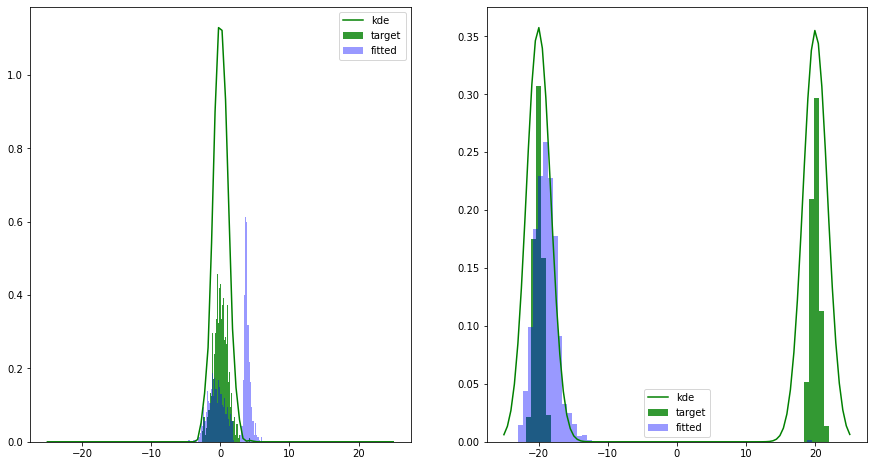

In [18]:
fig, axs = plt.subplots(1,2, figsize=(15, 8))
batch_terminal_empirical_f = next(c.data_stream(forward=True))
xx = torch.linspace(-25, 25).reshape(-1,1).cuda().double()

H = silvermans_rule(batch_terminal_empirical_f)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_f, H).detach().cpu().numpy())
axs[1].plot(xx.detach().cpu().numpy(), kd, label="kde", color="green")


bins = 60
axs[1].hist(( X1.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[1].hist(( Xts_[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");
axs[1].legend()




batch_terminal_empirical_b = next(c.data_stream(forward=False))
# xx = torch.linspace(-10, 10).reshape(-1,1).cuda().double()

Hb = silvermans_rule(batch_terminal_empirical_b)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_b, Hb).detach().cpu().numpy())
axs[0].plot(xx.detach().cpu().numpy(), kd, label="kde", color="green")


bins = 60
axs[0].hist(( X2.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[0].hist(( Xts[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");
axs[0].legend()

In [ ]:
def plot_trajectories(self, name):
        bb = lambda X: -self.b_backward(X)

        t, Xts = self.sde_solver(
            self.b_forward.forward, self.sigma,
            self.X_0, self.dt,  self.number_time_steps, 0.0,
            self.theta_f, False, True
        )
        t_, Xts_ = self.sde_solver(
            bb, self.sigma, 
            self.X_1, self.dt, self.number_time_steps, 0.0, 
            self.theta_b, False, False
        )
#         t = t / t.max()
#         t_ = t_ / t_.max()
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

       

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.03,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.03, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)
        
        tt = list(range(0, int(np.ceil(t_.max().item()))))
        print(t_)
        print(tt)
        axs[1].set_xticks(tt )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])
        plt.savefig(name)
        plt.show()    

In [ ]:
plot_trajectories(c, "__relu_20_20_20__succesfl_bimodal_trajectories.png")